In [1]:
# importar bibliotecas
import pandas as pd
from pandas.tseries.offsets import DateOffset
import numpy as np
import os
import matplotlib.pyplot as plt
%matplotlib inline
#from sklearn.metrics import mean_squared_error
from statsmodels.tools.eval_measures import rmse
from sklearn.preprocessing import MinMaxScaler
from keras.preprocessing.sequence import TimeseriesGenerator
from keras.callbacks import CSVLogger
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional

import time
import warnings
warnings.filterwarnings("ignore")

### Modelagem com a utilização do pacote embeding para Bi-direcional
##### 
Os humanos não começam a pensar do zero a cada segundo. Ao ler este ensaio, você entende cada palavra com base na sua compreensão das palavras anteriores. Você não joga tudo fora e começa a pensar do zero novamente. Seus pensamentos têm persistência.

As redes neurais tradicionais não podem fazer isso, e isso parece uma grande falha. Por exemplo, imagine que você queira classificar que tipo de evento está acontecendo em todos os momentos do filme. Não está claro como uma rede neural tradicional poderia usar seu raciocínio sobre eventos anteriores do filme para informar os posteriores.

Redes neurais recorrentes abordam esse problema. São redes com loops, permitindo que as informações persistam.

Em comparação com o LSTM, BLSTMou BiLSTMpossui duas redes, uma pastinformação de acesso na forwarddireção e outro acesso futurena reversedireção.

LSTMse suas variantes bidirecionais são populares porque tentaram aprender como e quando esquecer e quando não usar portas em sua arquitetura. Em RNNarquiteturas anteriores , o desaparecimento de gradientes era um grande problema e fazia com que essas redes não aprendessem muito.

Usando Bidirecional LSTMs, você alimenta o algoritmo de aprendizado com os dados originais uma vez do começo ao fim e uma vez do fim ao começo. Existem debates aqui, mas geralmente ele aprende mais rápido que a abordagem unidirecional, embora dependa da tarefa.


#### 1 - carregar base tratada

In [2]:
# Verifica a pasta corrente
pasta = os.getcwd()

In [3]:
pasta_resultados = os.path.join(pasta, "resultados1")
pasta_graficos = os.path.join(pasta, "graficos1")

In [ ]:
# Regex notation by "\s+". This means a single space, or multiple spaces are all to be treated as a single separator.
# df_dados = pd.read_csv('bltper_1x1.txt', skiprows=2, sep = '\s+')
df_dados = pd.read_csv(os.path.join(pasta, "dados") + "/" + 'bltper_1x1.txt', skiprows=2, sep = '\s+') 

In [ ]:
df_dados.head().append(df_dados.tail())

#### 2 - criar features, entre elas a logqx, que corresponde já convertido a escala logarítma da probabilidade de morte


In [ ]:
# Tratamento da idade 110+ para os anos.
# DataFrame.loc[condition, column_name] = new_value
df_dados.loc[(df_dados.Age == '110+'),'Age'] = 110

In [ ]:
# Criar a feature log qx
df_dados['logqx'] = np.log(df_dados['qx'])
# Aproveitar e corrigir a tipagem da feature Age
df_dados["Age"] = df_dados["Age"].astype(int)

In [ ]:
df_dados.head().append(df_dados.tail())

In [ ]:
df_dados.shape

#### 3 - Criar a feature tempo t, com base na feature ano, que corresponde ao elemento temporal da série

In [8]:
# Preparar dataset
#serie = {'t': ano, 'logqx_prob': logqx_prob}
df_lstm = pd.DataFrame(df_dados, columns=['Age','Year','logqx'])
df_lstm['t'] = pd.to_datetime(df_lstm['Year'], format='%Y')
#df_lstm.drop(['ano'], axis=1, inplace=True)
df_lstm.set_index('t', inplace=True)


In [9]:
#df_lstm[df_lstm['t'].dt.year == 1998]
df_lstm.head()

,idade,ano,logqx_prob
t,,,
1998-01-01,0,1998,-3.404001
1998-01-01,1,1998,-5.635576
1998-01-01,2,1998,-6.260610
1998-01-01,3,1998,-6.575794
1998-01-01,4,1998,-6.877119


In [10]:
df_lstm[df_lstm['Age']==0]

,idade,ano,logqx_prob
t,,,
1998-01-01,0,1998,-3.404001
1999-01-01,0,1999,-3.453017
2000-01-01,0,2000,-3.504227
2001-01-01,0,2001,-3.533587
2002-01-01,0,2002,-3.562423
2003-01-01,0,2003,-3.593575
2004-01-01,0,2004,-3.627600
2005-01-01,0,2005,-3.658573
2006-01-01,0,2006,-3.693268


#### 4 - Separar a base em base de treino e base de teste para cada idade x ao longo dos anos t, ou seja, para a idade 0, entre os anos 1998 a 2018, para a idade 1, no mesmo período e assim por diante.

##### Rotina LSTM, métricas e gráficos

Epoch 1/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0838 - mae: 0.2273
Epoch 2/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0322 - mae: 0.1743
Epoch 3/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0535 - mae: 0.2053
Epoch 4/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0422 - mae: 0.1913
Epoch 5/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0418 - mae: 0.1979
Epoch 6/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0419 - mae: 0.1734
Epoch 7/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0387 - mae: 0.1634
Epoch 8/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0376 - mae: 0.1868
Epoch 9/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0401 - mae: 0.1982
Epoch 10/1000
4/4 [==============================] - 0s 14ms/step - loss: 0.0353 - mae: 0.1851
Epoch 11/1000
4/4 [==============================] - 0s 13ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0489
Epoch 174/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0611
Epoch 175/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0491
Epoch 176/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0463
Epoch 177/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0513
Epoch 178/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0592
Epoch 179/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0547
Epoch 180/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0423
Epoch 181/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0660
Epoch 182/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0644
Epoch 183/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0481
Epoch 346/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0074 - mae: 0.0629
Epoch 347/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0646
Epoch 348/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0593
Epoch 349/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0493
Epoch 350/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0461
Epoch 351/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0394
Epoch 352/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0093 - mae: 0.0720
Epoch 353/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0551
Epoch 354/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0613
Epoch 355/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0473
Epoch 518/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0719
Epoch 519/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0072 - mae: 0.0597
Epoch 520/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0476
Epoch 521/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0498
Epoch 522/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0498
Epoch 523/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0606
Epoch 524/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0564
Epoch 525/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0522
Epoch 526/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0638
Epoch 527/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0566
Epoch 690/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0546
Epoch 691/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0411
Epoch 692/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0431
Epoch 693/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0489
Epoch 694/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0560
Epoch 695/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0509
Epoch 696/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0517
Epoch 697/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0462
Epoch 698/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0407
Epoch 699/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0246
Epoch 862/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0266
Epoch 863/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0282
Epoch 864/1000
4/4 [==============================] - 0s 16ms/step - loss: 0.0034 - mae: 0.0404
Epoch 865/1000
4/4 [==============================] - 0s 17ms/step - loss: 0.0014 - mae: 0.0274
Epoch 866/1000
4/4 [==============================] - 0s 14ms/step - loss: 0.0023 - mae: 0.0342
Epoch 867/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0021 - mae: 0.0331
Epoch 868/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0255
Epoch 869/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.3760e-04 - mae: 0.0200
Epoch 870/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8424e-04 - mae: 0.0196
Epoch 871/1000
4/4 [==============================] 

4/4 [==============================] - 0s 10ms/step - loss: 0.0279 - mae: 0.1007
Epoch 947/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0219 - mae: 0.1370
Epoch 948/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0079 - mae: 0.0655
Epoch 949/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0184 - mae: 0.1200
Epoch 950/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0122 - mae: 0.0992
Epoch 951/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0098 - mae: 0.0782
Epoch 952/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0082 - mae: 0.0735
Epoch 953/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0068 - mae: 0.0557
Epoch 954/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0057 - mae: 0.0587
Epoch 955/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0538
Epoch 956/1000
4/4 [==============================] - 0s 8ms/st

6/6 [==============================] - 0s 27ms/step - loss: 4.7752e-04 - mae: 0.0129
Epoch 115/1000
6/6 [==============================] - 0s 17ms/step - loss: 0.0015 - mae: 0.0306
Epoch 116/1000
6/6 [==============================] - 0s 17ms/step - loss: 0.0013 - mae: 0.0243
Epoch 117/1000
6/6 [==============================] - 0s 18ms/step - loss: 7.1978e-04 - mae: 0.0220
Epoch 118/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0012 - mae: 0.0222
Epoch 119/1000
6/6 [==============================] - 0s 13ms/step - loss: 8.8643e-04 - mae: 0.0254
Epoch 120/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.3470e-04 - mae: 0.0146
Epoch 121/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.5006e-04 - mae: 0.0192
Epoch 122/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.3570e-04 - mae: 0.0148
Epoch 123/1000
6/6 [==============================] - 0s 12ms/step - loss: 4.4300e-04 - mae: 0.0132
Epoch 124/1000
6/6 [=======

Epoch 280/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.1602e-04 - mae: 0.0152
Epoch 281/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1674e-04 - mae: 0.0127
Epoch 282/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.6420e-04 - mae: 0.0148
Epoch 283/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.9753e-04 - mae: 0.0183
Epoch 284/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.6811e-04 - mae: 0.0133
Epoch 285/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.2361e-04 - mae: 0.0151
Epoch 286/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2036e-04 - mae: 0.0138
Epoch 287/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0236
Epoch 288/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7042e-04 - mae: 0.0125
Epoch 289/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5910e-04 - mae: 0.0158
Epoch 2

Epoch 450/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3345e-04 - mae: 0.0204
Epoch 451/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9479e-04 - mae: 0.0168
Epoch 452/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.7176e-04 - mae: 0.0151
Epoch 453/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0015 - mae: 0.0255
Epoch 454/1000
6/6 [==============================] - 0s 12ms/step - loss: 8.7980e-04 - mae: 0.0183
Epoch 455/1000
6/6 [==============================] - 0s 14ms/step - loss: 4.4287e-04 - mae: 0.0153
Epoch 456/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.3846e-04 - mae: 0.0186
Epoch 457/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0214
Epoch 458/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.9178e-04 - mae: 0.0207
Epoch 459/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.8826e-04 - mae: 0.0194
Epoch 460/

6/6 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0483
Epoch 536/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0092 - mae: 0.0784
Epoch 537/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0562
Epoch 538/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0623
Epoch 539/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0315
Epoch 540/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0487
Epoch 541/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0368
Epoch 542/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0367
Epoch 543/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0546
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0403
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step

Epoch 706/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0515
Epoch 707/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0391
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0311
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0486
Epoch 710/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0426
Epoch 711/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0425
Epoch 712/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0457
Epoch 713/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0437
Epoch 714/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0480
Epoch 715/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0294
Epoch 716/1000
6/6 [=============================

6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0274
Epoch 793/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0298
Epoch 794/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0301
Epoch 795/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.9383e-04 - mae: 0.0216
Epoch 796/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0322
Epoch 797/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0348
Epoch 798/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0202 - mae: 0.0921
Epoch 799/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0152 - mae: 0.1038
Epoch 800/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0873
Epoch 801/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0754
Epoch 802/1000
6/6 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0657
Epoch 879/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0688
Epoch 880/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0078 - mae: 0.0668
Epoch 881/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0640
Epoch 882/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0086 - mae: 0.0614
Epoch 883/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0578
Epoch 884/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0086 - mae: 0.0626
Epoch 885/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0420
Epoch 886/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0384
Epoch 887/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0456
Epoch 888/1000
6/6 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0305 - mae: 0.1331
Epoch 51/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0294 - mae: 0.1520
Epoch 52/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0286 - mae: 0.1474
Epoch 53/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0266 - mae: 0.1477
Epoch 54/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0214 - mae: 0.1224
Epoch 55/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0292 - mae: 0.1160
Epoch 56/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0326 - mae: 0.1417
Epoch 57/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0365 - mae: 0.1645
Epoch 58/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0258 - mae: 0.1242
Epoch 59/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0308 - mae: 0.1389
Epoch 60/1000
4/4 [==============================] - 0s 7ms/step - loss: 0

4/4 [==============================] - 0s 7ms/step - loss: 0.0184 - mae: 0.1033
Epoch 223/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0158 - mae: 0.1015
Epoch 224/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0126 - mae: 0.0920
Epoch 225/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0179 - mae: 0.1166
Epoch 226/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0229 - mae: 0.1193
Epoch 227/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0221 - mae: 0.1045
Epoch 228/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0157 - mae: 0.1089
Epoch 229/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0148 - mae: 0.1011
Epoch 230/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0102 - mae: 0.0769
Epoch 231/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0192 - mae: 0.1187
Epoch 232/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0190 - mae: 0.0975
Epoch 395/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0087 - mae: 0.0670
Epoch 396/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0166 - mae: 0.1022
Epoch 397/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0081 - mae: 0.0645
Epoch 398/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0126 - mae: 0.0779
Epoch 399/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0128 - mae: 0.0692
Epoch 400/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0116 - mae: 0.0705
Epoch 401/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0119 - mae: 0.0787
Epoch 402/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0144 - mae: 0.0885
Epoch 403/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0141 - mae: 0.0850
Epoch 404/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0099 - mae: 0.0666
Epoch 567/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0538
Epoch 568/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0093 - mae: 0.0683
Epoch 569/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0110 - mae: 0.0723
Epoch 570/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0068 - mae: 0.0582
Epoch 571/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0487
Epoch 572/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0655
Epoch 573/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0072 - mae: 0.0538
Epoch 574/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0085 - mae: 0.0650
Epoch 575/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0126 - mae: 0.0758
Epoch 576/1000
4/4 [==============================] - 0s 10ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0613
Epoch 739/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0561
Epoch 740/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0068 - mae: 0.0547
Epoch 741/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0560
Epoch 742/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0516
Epoch 743/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0049 - mae: 0.0508
Epoch 744/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0050 - mae: 0.0515
Epoch 745/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0039 - mae: 0.0443
Epoch 746/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0403
Epoch 747/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0509
Epoch 748/1000
4/4 [==============================] - 0s 8ms/s

4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0375
Epoch 911/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0273
Epoch 912/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.2231e-04 - mae: 0.0188
Epoch 913/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0244
Epoch 914/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.5297e-04 - mae: 0.0166
Epoch 915/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0297
Epoch 916/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.3621e-04 - mae: 0.0220
Epoch 917/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5577e-04 - mae: 0.0207
Epoch 918/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.6022e-04 - mae: 0.0188
Epoch 919/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0433
Epoch 920/1000
4/4 [===================

6/6 [==============================] - 0s 9ms/step - loss: 0.0102 - mae: 0.0502
Epoch 81/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0132 - mae: 0.0656
Epoch 82/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0123 - mae: 0.0720
Epoch 83/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0069 - mae: 0.0516
Epoch 84/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0298
Epoch 85/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0370
Epoch 86/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0224
Epoch 87/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0027 - mae: 0.0346
Epoch 88/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0249
Epoch 89/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0395
Epoch 90/1000
6/6 [==============================] - 0s 10ms/step - loss

6/6 [==============================] - 0s 8ms/step - loss: 3.1789e-04 - mae: 0.0137
Epoch 250/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.3039e-04 - mae: 0.0194
Epoch 251/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.4043e-04 - mae: 0.0157
Epoch 252/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1123e-04 - mae: 0.0164
Epoch 253/1000
6/6 [==============================] - 0s 7ms/step - loss: 8.2877e-04 - mae: 0.0165
Epoch 254/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4204e-04 - mae: 0.0101
Epoch 255/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0323
Epoch 256/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0235
Epoch 257/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0207
Epoch 258/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5301e-04 - mae: 0.0144
Epoch 259/1000
6/6 [===============

6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0160
Epoch 418/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0218e-04 - mae: 0.0146
Epoch 419/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7163e-04 - mae: 0.0172
Epoch 420/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1055e-04 - mae: 0.0112
Epoch 421/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3996e-04 - mae: 0.0197
Epoch 422/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0651e-04 - mae: 0.0129
Epoch 423/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.3423e-05 - mae: 0.0066
Epoch 424/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0212
Epoch 425/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.7518e-04 - mae: 0.0169
Epoch 426/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5116e-04 - mae: 0.0098
Epoch 427/1000
6/6 [======

6/6 [==============================] - 0s 9ms/step - loss: 3.4398e-04 - mae: 0.0121
Epoch 501/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2214e-04 - mae: 0.0151
Epoch 502/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0273e-04 - mae: 0.0121
Epoch 503/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7526e-04 - mae: 0.0100
Epoch 504/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0709e-04 - mae: 0.0148
Epoch 505/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4935e-04 - mae: 0.0102
Epoch 506/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2575e-04 - mae: 0.0198
Epoch 507/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6104e-04 - mae: 0.0102
Epoch 508/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0309e-04 - mae: 0.0144
Epoch 509/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0350e-04 - mae: 0.0076
Epoch 510/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 0.0077 - mae: 0.0559
Epoch 670/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0532
Epoch 671/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0094 - mae: 0.0598
Epoch 672/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0081 - mae: 0.0621
Epoch 673/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0509
Epoch 674/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0451
Epoch 675/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0110 - mae: 0.0742
Epoch 676/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0235 - mae: 0.0987
Epoch 677/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0168 - mae: 0.0862
Epoch 678/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0165 - mae: 0.0871
Epoch 679/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0171 - mae: 0.0856
Epoch 842/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0102 - mae: 0.0649
Epoch 843/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0455
Epoch 844/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0505
Epoch 845/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0087 - mae: 0.0563
Epoch 846/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0456
Epoch 847/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0078 - mae: 0.0536
Epoch 848/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0410
Epoch 849/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0435
Epoch 850/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0083 - mae: 0.0527
Epoch 851/1000
6/6 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 8ms/step - loss: 0.0338 - mae: 0.1788
Epoch 14/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0282 - mae: 0.1564
Epoch 15/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0290 - mae: 0.1596
Epoch 16/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0313 - mae: 0.1615
Epoch 17/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0326 - mae: 0.1663
Epoch 18/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0369 - mae: 0.1709
Epoch 19/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0236 - mae: 0.1326
Epoch 20/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0395 - mae: 0.1760
Epoch 21/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0258 - mae: 0.1352
Epoch 22/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0270 - mae: 0.1411
Epoch 23/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0179 - mae: 0.1048
Epoch 187/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0126 - mae: 0.0891
Epoch 188/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0281 - mae: 0.1150
Epoch 189/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0201 - mae: 0.1055
Epoch 190/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0365 - mae: 0.1363
Epoch 191/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0230 - mae: 0.1350
Epoch 192/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0178 - mae: 0.1114
Epoch 193/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0130 - mae: 0.0823
Epoch 194/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0667
Epoch 195/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0170 - mae: 0.1037
Epoch 196/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0083 - mae: 0.0720
Epoch 359/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0586
Epoch 360/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0087 - mae: 0.0681
Epoch 361/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0610
Epoch 362/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0490
Epoch 363/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0118 - mae: 0.0726
Epoch 364/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0075 - mae: 0.0560
Epoch 365/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0048 - mae: 0.0495
Epoch 366/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0047 - mae: 0.0512
Epoch 367/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0069 - mae: 0.0650
Epoch 368/1000
4/4 [==============================] - 0s 11ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0340
Epoch 531/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0630
Epoch 532/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0605
Epoch 533/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0537
Epoch 534/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0448
Epoch 535/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0519
Epoch 536/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0567
Epoch 537/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0120 - mae: 0.0722
Epoch 538/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0404
Epoch 539/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0084 - mae: 0.0642
Epoch 540/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0513
Epoch 702/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0050 - mae: 0.0430
Epoch 703/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0373
Epoch 704/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0332
Epoch 705/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0248
Epoch 706/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0204
Epoch 707/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0256
Epoch 708/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0306
Epoch 709/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0297
Epoch 710/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0186
Epoch 711/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0240
Epoch 872/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0340
Epoch 873/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0233
Epoch 874/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0242
Epoch 875/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3179e-04 - mae: 0.0219
Epoch 876/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0250
Epoch 877/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6154e-04 - mae: 0.0192
Epoch 878/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0323
Epoch 879/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0279
Epoch 880/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.1410e-04 - mae: 0.0092
Epoch 881/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 1.7893e-04 - mae: 0.0121
Epoch 956/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.9267e-04 - mae: 0.0136
Epoch 957/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.7017e-04 - mae: 0.0123
Epoch 958/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0278
Epoch 959/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2203e-04 - mae: 0.0194
Epoch 960/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.3929e-04 - mae: 0.0210
Epoch 961/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0236
Epoch 962/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.3547e-04 - mae: 0.0181
Epoch 963/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0237
Epoch 964/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6191e-04 - mae: 0.0132
Epoch 965/1000
4/4 [=================

6/6 [==============================] - 0s 10ms/step - loss: 0.0049 - mae: 0.0507
Epoch 125/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0376
Epoch 126/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0268
Epoch 127/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0376   
Epoch 128/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0554
Epoch 129/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0417
Epoch 130/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0553
Epoch 131/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0370
Epoch 132/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0429
Epoch 133/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0353
Epoch 134/1000
6/6 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 11ms/step - loss: 0.0027 - mae: 0.0378
Epoch 211/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0030 - mae: 0.0344
Epoch 212/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0347
Epoch 213/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0099 - mae: 0.0477
Epoch 214/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0198 - mae: 0.0835
Epoch 215/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0334
Epoch 216/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0133 - mae: 0.0747
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0105 - mae: 0.0652
Epoch 218/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0120 - mae: 0.0724
Epoch 219/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0086 - mae: 0.0438
Epoch 220/1000
6/6 [==============================] - 0s 8ms/st

6/6 [==============================] - 0s 9ms/step - loss: 0.0077 - mae: 0.0390
Epoch 297/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0081 - mae: 0.0433
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0091 - mae: 0.0581
Epoch 299/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0533
Epoch 300/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0075 - mae: 0.0470
Epoch 301/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0364
Epoch 302/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0370
Epoch 303/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0432
Epoch 304/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0361
Epoch 305/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0308
Epoch 306/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0564
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0081 - mae: 0.0776
Epoch 466/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0126 - mae: 0.0851
Epoch 467/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0084 - mae: 0.0592
Epoch 468/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0672
Epoch 469/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0090 - mae: 0.0713
Epoch 470/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0592
Epoch 471/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0086 - mae: 0.0547
Epoch 472/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0074 - mae: 0.0731
Epoch 473/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0063 - mae: 0.0655
Epoch 474/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 10ms/step - loss: 4.1066e-04 - mae: 0.0123
Epoch 635/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0228
Epoch 636/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0586e-04 - mae: 0.0177
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0952e-04 - mae: 0.0142
Epoch 638/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0217
Epoch 639/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4003e-04 - mae: 0.0082
Epoch 640/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5230e-05 - mae: 0.0073
Epoch 641/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0248
Epoch 642/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7664e-04 - mae: 0.0186
Epoch 643/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8717e-04 - mae: 0.0144
Epoch 644/1000
6/6 [================

6/6 [==============================] - 0s 9ms/step - loss: 5.9275e-04 - mae: 0.0178
Epoch 803/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1726e-04 - mae: 0.0125
Epoch 804/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6014e-04 - mae: 0.0142
Epoch 805/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6948e-04 - mae: 0.0172
Epoch 806/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0651e-04 - mae: 0.0115
Epoch 807/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8651e-04 - mae: 0.0148
Epoch 808/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0200
Epoch 809/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4181e-04 - mae: 0.0091
Epoch 810/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6565e-04 - mae: 0.0120
Epoch 811/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4924e-05 - mae: 0.0081
Epoch 812/1000
6/6 [========

Epoch 967/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9844e-04 - mae: 0.0142
Epoch 968/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5495e-04 - mae: 0.0146
Epoch 969/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3301e-04 - mae: 0.0090
Epoch 970/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8945e-04 - mae: 0.0131
Epoch 971/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7711e-04 - mae: 0.0112
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0230
Epoch 973/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9449e-04 - mae: 0.0159
Epoch 974/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0234
Epoch 975/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2681e-04 - mae: 0.0198
Epoch 976/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0311e-04 - mae: 0.0160
Epoch 977/1000
6/

4/4 [==============================] - 0s 8ms/step - loss: 0.0077 - mae: 0.0697
Epoch 139/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0622
Epoch 140/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0567
Epoch 141/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0613
Epoch 142/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0062 - mae: 0.0619
Epoch 143/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0091 - mae: 0.0743
Epoch 144/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0492
Epoch 145/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0084 - mae: 0.0668
Epoch 146/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0579
Epoch 147/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0643
Epoch 148/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0449
Epoch 311/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0481
Epoch 312/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0636
Epoch 313/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0637
Epoch 314/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0535
Epoch 315/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0466
Epoch 316/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0481
Epoch 317/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0610
Epoch 318/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0564
Epoch 319/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0475
Epoch 320/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0624
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0475
Epoch 484/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0563
Epoch 485/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0047 - mae: 0.0525
Epoch 486/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0042 - mae: 0.0507
Epoch 487/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0045 - mae: 0.0488
Epoch 488/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0031 - mae: 0.0469
Epoch 489/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0049 - mae: 0.0496
Epoch 490/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0057 - mae: 0.0524
Epoch 491/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0036 - mae: 0.0466
Epoch 492/1000
4/4 [==============================] - 0s 9

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0198
Epoch 654/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0299
Epoch 655/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0272
Epoch 656/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.3507e-04 - mae: 0.0184
Epoch 657/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0315
Epoch 658/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0290
Epoch 659/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0018 - mae: 0.0342
Epoch 660/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0253
Epoch 661/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.8860e-04 - mae: 0.0220
Epoch 662/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9362e-04 - mae: 0.0213
Epoch 663/1000
4/4 [==============================] -

4/4 [==============================] - 0s 9ms/step - loss: 2.3531e-04 - mae: 0.0135
Epoch 820/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.4462e-04 - mae: 0.0099
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.3414e-04 - mae: 0.0140
Epoch 822/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.8112e-04 - mae: 0.0124
Epoch 823/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.0678e-04 - mae: 0.0125
Epoch 824/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.7755e-04 - mae: 0.0125
Epoch 825/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6956e-04 - mae: 0.0147
Epoch 826/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0273
Epoch 827/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.5002e-04 - mae: 0.0113
Epoch 828/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.4260e-04 - mae: 0.0142
Epoch 829/1000
4/4 [=========

4/4 [==============================] - 0s 8ms/step - loss: 1.3357e-04 - mae: 0.0097
Epoch 903/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6277e-04 - mae: 0.0156
Epoch 904/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.7609e-04 - mae: 0.0153
Epoch 905/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.5086e-04 - mae: 0.0086
Epoch 906/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.6723e-04 - mae: 0.0107
Epoch 907/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.7094e-04 - mae: 0.0093
Epoch 908/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.1189e-04 - mae: 0.0099
Epoch 909/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.4995e-04 - mae: 0.0128
Epoch 910/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.0849e-04 - mae: 0.0112
Epoch 911/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1498e-04 - mae: 0.0174
Epoch 912/1000
4/4 [=====

6/6 [==============================] - 0s 9ms/step - loss: 8.8666e-04 - mae: 0.0193
Epoch 70/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.3507e-04 - mae: 0.0193
Epoch 71/1000
6/6 [==============================] - 0s 12ms/step - loss: 6.4721e-04 - mae: 0.0172
Epoch 72/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.4237e-04 - mae: 0.0172
Epoch 73/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0013 - mae: 0.0205
Epoch 74/1000
6/6 [==============================] - 0s 13ms/step - loss: 8.2302e-04 - mae: 0.0234
Epoch 75/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2170e-04 - mae: 0.0154
Epoch 76/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1755e-04 - mae: 0.0108
Epoch 77/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0241e-04 - mae: 0.0116
Epoch 78/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2777e-04 - mae: 0.0169
Epoch 79/1000
6/6 [==============

6/6 [==============================] - 0s 9ms/step - loss: 9.2299e-05 - mae: 0.0085
Epoch 235/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.7782e-04 - mae: 0.0141
Epoch 236/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4075e-04 - mae: 0.0116
Epoch 237/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.5897e-04 - mae: 0.0104
Epoch 238/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7648e-04 - mae: 0.0104
Epoch 239/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7451e-05 - mae: 0.0079
Epoch 240/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2128e-04 - mae: 0.0083
Epoch 241/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0248e-04 - mae: 0.0090
Epoch 242/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3595e-04 - mae: 0.0078
Epoch 243/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9464e-05 - mae: 0.0076
Epoch 244/1000
6/6 [==

6/6 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0379
Epoch 401/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0328
Epoch 402/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0443
Epoch 403/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0462
Epoch 404/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0424
Epoch 405/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0406
Epoch 406/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0292
Epoch 407/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1936e-04 - mae: 0.0180
Epoch 408/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8648e-04 - mae: 0.0179
Epoch 409/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7873e-04 - mae: 0.0110
Epoch 410/1000
6/6 [==============================] -

6/6 [==============================] - 0s 10ms/step - loss: 1.9923e-04 - mae: 0.0103
Epoch 566/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.3745e-05 - mae: 0.0066
Epoch 567/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3343e-04 - mae: 0.0133
Epoch 568/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.4012e-04 - mae: 0.0108
Epoch 569/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0387e-04 - mae: 0.0126
Epoch 570/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6643e-04 - mae: 0.0122
Epoch 571/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2557e-04 - mae: 0.0085
Epoch 572/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.3955e-05 - mae: 0.0075
Epoch 573/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0362e-04 - mae: 0.0116
Epoch 574/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2644e-04 - mae: 0.0139
Epoch 575/1000
6/

6/6 [==============================] - 0s 13ms/step - loss: 0.0037 - mae: 0.0384
Epoch 731/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0409
Epoch 732/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0355
Epoch 733/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0370
Epoch 734/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0354
Epoch 735/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0327
Epoch 736/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0356
Epoch 737/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0269
Epoch 738/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0299
Epoch 739/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0294
Epoch 740/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 10ms/step - loss: 4.2631e-04 - mae: 0.0168
Epoch 898/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8805e-04 - mae: 0.0168
Epoch 899/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3589e-04 - mae: 0.0156
Epoch 900/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9738e-04 - mae: 0.0109
Epoch 901/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.2967e-04 - mae: 0.0142
Epoch 902/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.2394e-04 - mae: 0.0083
Epoch 903/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.1438e-04 - mae: 0.0155
Epoch 904/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.0359e-04 - mae: 0.0117
Epoch 905/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.0229e-04 - mae: 0.0143
Epoch 906/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3318e-04 - mae: 0.0111
Epoch 907/1000
6

4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0412
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0694
Epoch 67/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0504
Epoch 68/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0034 - mae: 0.0463
Epoch 69/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0485
Epoch 70/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0501
Epoch 71/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0533
Epoch 72/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0434
Epoch 73/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0043 - mae: 0.0575
Epoch 74/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0511
Epoch 75/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0460
Epoch 238/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0501
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0473
Epoch 240/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0456
Epoch 241/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0523
Epoch 242/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0491
Epoch 243/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0447
Epoch 244/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0421
Epoch 245/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0381
Epoch 246/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0422
Epoch 247/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0479
Epoch 410/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0332
Epoch 411/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0396
Epoch 412/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0300
Epoch 413/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0455
Epoch 414/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0415
Epoch 415/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0475
Epoch 416/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0415
Epoch 417/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0366
Epoch 418/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0443
Epoch 419/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 9.1559e-04 - mae: 0.0251
Epoch 581/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0276
Epoch 582/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1759e-04 - mae: 0.0202
Epoch 583/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.4921e-04 - mae: 0.0170
Epoch 584/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.2794e-04 - mae: 0.0206
Epoch 585/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0297
Epoch 586/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0258
Epoch 587/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0278
Epoch 588/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0385
Epoch 589/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0314
Epoch 590/1000
4/4 [=============================

4/4 [==============================] - 0s 9ms/step - loss: 1.2483e-04 - mae: 0.0098
Epoch 746/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.6019e-04 - mae: 0.0106
Epoch 747/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.8720e-04 - mae: 0.0163
Epoch 748/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.7449e-04 - mae: 0.0127
Epoch 749/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.3028e-04 - mae: 0.0144
Epoch 750/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.1912e-04 - mae: 0.0153
Epoch 751/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4611e-04 - mae: 0.0173
Epoch 752/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9891e-04 - mae: 0.0170
Epoch 753/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.4175e-04 - mae: 0.0095
Epoch 754/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.3787e-04 - mae: 0.0098
Epoch 755/1000
4/4 [=====

4/4 [==============================] - 0s 8ms/step - loss: 2.8267e-04 - mae: 0.0121
Epoch 911/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.0063e-04 - mae: 0.0181
Epoch 912/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.9473e-04 - mae: 0.0118
Epoch 913/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.8750e-04 - mae: 0.0184
Epoch 914/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.6123e-04 - mae: 0.0114
Epoch 915/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.6049e-04 - mae: 0.0110
Epoch 916/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.2897e-04 - mae: 0.0102
Epoch 917/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.2471e-04 - mae: 0.0174
Epoch 918/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.0197e-04 - mae: 0.0124
Epoch 919/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7254e-04 - mae: 0.0145
Epoch 920/1000
4/4 [=====

6/6 [==============================] - 0s 9ms/step - loss: 4.9325e-04 - mae: 0.0160
Epoch 78/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5282e-04 - mae: 0.0153
Epoch 79/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.4683e-04 - mae: 0.0172
Epoch 80/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2945e-04 - mae: 0.0097
Epoch 81/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2125e-04 - mae: 0.0112
Epoch 82/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3969e-04 - mae: 0.0087
Epoch 83/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7354e-04 - mae: 0.0123
Epoch 84/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9293e-04 - mae: 0.0105
Epoch 85/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0256
Epoch 86/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0229
Epoch 87/1000
6/6 [=======================

6/6 [==============================] - 0s 9ms/step - loss: 2.1696e-04 - mae: 0.0116
Epoch 243/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7086e-04 - mae: 0.0108
Epoch 244/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1186e-04 - mae: 0.0102
Epoch 245/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3755e-04 - mae: 0.0089
Epoch 246/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3589e-04 - mae: 0.0131
Epoch 247/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1734e-04 - mae: 0.0095
Epoch 248/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.6794e-04 - mae: 0.0174
Epoch 249/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.8881e-04 - mae: 0.0116
Epoch 250/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3300e-04 - mae: 0.0089
Epoch 251/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0110e-04 - mae: 0.0159
Epoch 252/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0290
Epoch 410/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.6595e-04 - mae: 0.0208
Epoch 411/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0019 - mae: 0.0291
Epoch 412/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0027 - mae: 0.0330  
Epoch 413/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0019 - mae: 0.0315
Epoch 414/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0022 - mae: 0.0304
Epoch 415/1000
6/6 [==============================] - 0s 14ms/step - loss: 0.0023 - mae: 0.0305
Epoch 416/1000
6/6 [==============================] - 0s 14ms/step - loss: 0.0013 - mae: 0.0247
Epoch 417/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0019 - mae: 0.0304
Epoch 418/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0011 - mae: 0.0230
Epoch 419/1000
6/6 [=============================

6/6 [==============================] - 0s 8ms/step - loss: 2.3964e-04 - mae: 0.0123
Epoch 578/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1053e-04 - mae: 0.0125
Epoch 579/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.0242e-04 - mae: 0.0087
Epoch 580/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.7529e-04 - mae: 0.0142
Epoch 581/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3453e-04 - mae: 0.0112
Epoch 582/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.5891e-04 - mae: 0.0093
Epoch 583/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.5944e-04 - mae: 0.0119
Epoch 584/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0415e-04 - mae: 0.0115
Epoch 585/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7820e-04 - mae: 0.0107
Epoch 586/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7418e-04 - mae: 0.0129
Epoch 587/1000
6/6 [=====

6/6 [==============================] - 0s 8ms/step - loss: 3.6183e-04 - mae: 0.0121
Epoch 743/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1335e-04 - mae: 0.0157
Epoch 744/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.7227e-04 - mae: 0.0155
Epoch 745/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3992e-04 - mae: 0.0104
Epoch 746/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1777e-04 - mae: 0.0141
Epoch 747/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0252
Epoch 748/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0345
Epoch 749/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0314
Epoch 750/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0388
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0503
Epoch 752/1000
6/6 [=========================

6/6 [==============================] - 0s 9ms/step - loss: 1.8762e-04 - mae: 0.0098
Epoch 826/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2451e-04 - mae: 0.0096
Epoch 827/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9257e-04 - mae: 0.0136
Epoch 828/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3460e-04 - mae: 0.0143
Epoch 829/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1583e-04 - mae: 0.0117
Epoch 830/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5041e-05 - mae: 0.0079
Epoch 831/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8760e-04 - mae: 0.0143
Epoch 832/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7187e-04 - mae: 0.0117
Epoch 833/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3977e-04 - mae: 0.0099
Epoch 834/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2836e-04 - mae: 0.0126
Epoch 835/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 1.6519e-04 - mae: 0.0106
Epoch 990/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8295e-04 - mae: 0.0115
Epoch 991/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1004e-04 - mae: 0.0139
Epoch 992/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7563e-04 - mae: 0.0103
Epoch 993/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.8462e-04 - mae: 0.0122
Epoch 994/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.6948e-04 - mae: 0.0087
Epoch 995/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.2102e-04 - mae: 0.0094
Epoch 996/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.0277e-04 - mae: 0.0102
Epoch 997/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.3786e-04 - mae: 0.0106
Epoch 998/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.5889e-04 - mae: 0.0100
Epoch 999/1000
6/6 

4/4 [==============================] - 0s 7ms/step - loss: 0.0039 - mae: 0.0545
Epoch 162/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0058 - mae: 0.0676
Epoch 163/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0374
Epoch 164/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0424
Epoch 165/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0027 - mae: 0.0463
Epoch 166/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0491
Epoch 167/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0030 - mae: 0.0406
Epoch 168/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0046 - mae: 0.0474
Epoch 169/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0559
Epoch 170/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0039 - mae: 0.0461
Epoch 171/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0478
Epoch 334/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0030 - mae: 0.0456
Epoch 335/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0403
Epoch 336/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0385
Epoch 337/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0033 - mae: 0.0445
Epoch 338/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0035 - mae: 0.0468
Epoch 339/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0447
Epoch 340/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0038 - mae: 0.0513
Epoch 341/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0042 - mae: 0.0483
Epoch 342/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0030 - mae: 0.0424
Epoch 343/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0478
Epoch 506/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0376
Epoch 507/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0468
Epoch 508/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0312
Epoch 509/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0420
Epoch 510/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0414
Epoch 511/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0282
Epoch 512/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0480
Epoch 513/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0353
Epoch 514/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0485
Epoch 515/1000
4/4 [==============================] - 0s 10ms/st

4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0314
Epoch 676/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0389
Epoch 677/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0479
Epoch 678/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0421
Epoch 679/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0513
Epoch 680/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0446
Epoch 681/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0036 - mae: 0.0475
Epoch 682/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0374
Epoch 683/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0457
Epoch 684/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0347
Epoch 685/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0353
Epoch 762/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0450
Epoch 763/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0475
Epoch 764/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0038 - mae: 0.0465
Epoch 765/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0024 - mae: 0.0351
Epoch 766/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0374
Epoch 767/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0039 - mae: 0.0494
Epoch 768/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0376
Epoch 769/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0036 - mae: 0.0496
Epoch 770/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0386
Epoch 771/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0478
Epoch 848/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0488
Epoch 849/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0311
Epoch 850/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0351
Epoch 851/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0012 - mae: 0.0321
Epoch 852/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0015 - mae: 0.0330
Epoch 853/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0013 - mae: 0.0300
Epoch 854/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0017 - mae: 0.0319
Epoch 855/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0418
Epoch 856/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0395
Epoch 857/1000
4/4 [==============================] - 0s 1

6/6 [==============================] - 0s 8ms/step - loss: 9.1820e-04 - mae: 0.0240
Epoch 17/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6796e-04 - mae: 0.0197
Epoch 18/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0279
Epoch 19/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.4669e-04 - mae: 0.0098
Epoch 20/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9345e-04 - mae: 0.0156
Epoch 21/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1431e-04 - mae: 0.0180
Epoch 22/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6477e-04 - mae: 0.0115
Epoch 23/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1866e-04 - mae: 0.0151
Epoch 24/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0293e-04 - mae: 0.0175
Epoch 25/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.9677e-04 - mae: 0.0196
Epoch 26/1000
6/6 [==================

Epoch 100/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0014 - mae: 0.0265
Epoch 101/1000
6/6 [==============================] - 0s 20ms/step - loss: 5.3526e-04 - mae: 0.0181
Epoch 102/1000
6/6 [==============================] - 0s 17ms/step - loss: 3.4565e-04 - mae: 0.0151
Epoch 103/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.9515e-04 - mae: 0.0148
Epoch 104/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.7774e-04 - mae: 0.0164
Epoch 105/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.9903e-04 - mae: 0.0178
Epoch 106/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.5121e-04 - mae: 0.0145
Epoch 107/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0013 - mae: 0.0268
Epoch 108/1000
6/6 [==============================] - 0s 13ms/step - loss: 5.0047e-04 - mae: 0.0182
Epoch 109/1000
6/6 [==============================] - 0s 12ms/step - loss: 9.6133e-04 - mae: 0.0216
Epoch 11

6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0296
Epoch 266/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0420
Epoch 267/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0293
Epoch 268/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0405
Epoch 269/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9352e-04 - mae: 0.0218
Epoch 270/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0230
Epoch 271/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9095e-04 - mae: 0.0212
Epoch 272/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0259
Epoch 273/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7997e-04 - mae: 0.0246
Epoch 274/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0283
Epoch 275/1000
6/6 [==============================] -

6/6 [==============================] - 0s 10ms/step - loss: 5.7762e-04 - mae: 0.0193
Epoch 432/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0610e-04 - mae: 0.0105
Epoch 433/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7535e-04 - mae: 0.0172
Epoch 434/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4497e-04 - mae: 0.0119
Epoch 435/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0698e-04 - mae: 0.0160
Epoch 436/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.5901e-04 - mae: 0.0102
Epoch 437/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4408e-04 - mae: 0.0105
Epoch 438/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.6482e-04 - mae: 0.0194
Epoch 439/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0243e-04 - mae: 0.0156
Epoch 440/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2223e-04 - mae: 0.0197
Epoch 441/1000
6/6 [==

6/6 [==============================] - 0s 12ms/step - loss: 4.7758e-04 - mae: 0.0160
Epoch 598/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8446e-04 - mae: 0.0143
Epoch 599/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8839e-04 - mae: 0.0122
Epoch 600/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6825e-04 - mae: 0.0129
Epoch 601/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6252e-04 - mae: 0.0100
Epoch 602/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5571e-04 - mae: 0.0150
Epoch 603/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0112e-04 - mae: 0.0174
Epoch 604/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.6784e-04 - mae: 0.0158
Epoch 605/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2649e-04 - mae: 0.0144
Epoch 606/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7136e-04 - mae: 0.0174
Epoch 607/1000
6/6 [===

Epoch 680/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9901e-04 - mae: 0.0177
Epoch 681/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4031e-04 - mae: 0.0162
Epoch 682/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0305
Epoch 683/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4664e-04 - mae: 0.0209
Epoch 684/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0238
Epoch 685/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3220e-04 - mae: 0.0158
Epoch 686/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0258
Epoch 687/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5215e-04 - mae: 0.0122
Epoch 688/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1989e-04 - mae: 0.0199
Epoch 689/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6973e-04 - mae: 0.0153
Epoch 690/1000
6/6 [==

6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0212
Epoch 846/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5934e-04 - mae: 0.0174
Epoch 847/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0265
Epoch 848/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5749e-04 - mae: 0.0242
Epoch 849/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0282
Epoch 850/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0903e-04 - mae: 0.0163
Epoch 851/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0314e-04 - mae: 0.0141
Epoch 852/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0921e-04 - mae: 0.0124
Epoch 853/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2101e-04 - mae: 0.0197
Epoch 854/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.5542e-04 - mae: 0.0101
Epoch 855/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 4.2668e-04 - mae: 0.0171
Epoch 929/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4796e-04 - mae: 0.0178
Epoch 930/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6740e-04 - mae: 0.0197
Epoch 931/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.3319e-04 - mae: 0.0203
Epoch 932/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.4411e-04 - mae: 0.0176
Epoch 933/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.1031e-04 - mae: 0.0209
Epoch 934/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1433e-04 - mae: 0.0083
Epoch 935/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6828e-04 - mae: 0.0194
Epoch 936/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9952e-04 - mae: 0.0157
Epoch 937/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9345e-04 - mae: 0.0154
Epoch 938/1000
6/6 [==

4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0334
Epoch 99/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0433
Epoch 100/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0322
Epoch 101/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0299
Epoch 102/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0380
Epoch 103/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0409
Epoch 104/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0384
Epoch 105/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0430
Epoch 106/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0297
Epoch 107/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0444
Epoch 108/1000
4/4 [==============================] - 0s 8ms/step 

4/4 [==============================] - 0s 11ms/step - loss: 0.0025 - mae: 0.0410
Epoch 271/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0031 - mae: 0.0468
Epoch 272/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0014 - mae: 0.0301
Epoch 273/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0019 - mae: 0.0365
Epoch 274/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0018 - mae: 0.0361
Epoch 275/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0291
Epoch 276/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0334
Epoch 277/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0398
Epoch 278/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0312
Epoch 279/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0358
Epoch 280/1000
4/4 [==============================] - 0s 8ms

4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0217
Epoch 357/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6700e-04 - mae: 0.0236
Epoch 358/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0363
Epoch 359/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0369
Epoch 360/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0332
Epoch 361/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0307
Epoch 362/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0328
Epoch 363/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0328
Epoch 364/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0288
Epoch 365/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0298
Epoch 366/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0348
Epoch 443/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0328
Epoch 444/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0364
Epoch 445/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0345
Epoch 446/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0316
Epoch 447/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0291
Epoch 448/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8358e-04 - mae: 0.0261
Epoch 449/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0312
Epoch 450/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0378
Epoch 451/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0328
Epoch 452/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0352
Epoch 529/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0383
Epoch 530/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0301
Epoch 531/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0406
Epoch 532/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0378
Epoch 533/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0326
Epoch 534/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7238e-04 - mae: 0.0227
Epoch 535/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0325
Epoch 536/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0359
Epoch 537/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0298
Epoch 538/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0298
Epoch 699/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0386
Epoch 700/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0405
Epoch 701/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.9724e-04 - mae: 0.0267
Epoch 702/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0292
Epoch 703/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0378
Epoch 704/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1837e-04 - mae: 0.0228
Epoch 705/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0305
Epoch 706/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8852e-04 - mae: 0.0228
Epoch 707/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0301
Epoch 708/1000
4/4 [==============================] -

4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0236
Epoch 869/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0321
Epoch 870/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0279
Epoch 871/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0288
Epoch 872/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6452e-04 - mae: 0.0261
Epoch 873/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0339
Epoch 874/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0281
Epoch 875/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0311
Epoch 876/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0346
Epoch 877/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0387
Epoch 878/1000
4/4 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0264
Epoch 39/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0261
Epoch 40/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0262
Epoch 41/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0336
Epoch 42/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0371
Epoch 43/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0314
Epoch 44/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0271
Epoch 45/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0312
Epoch 46/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0251
Epoch 47/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.1357e-04 - mae: 0.0238
Epoch 48/1000
6/6 [==============================] - 0s 8ms/step - los

6/6 [==============================] - 0s 10ms/step - loss: 5.0921e-04 - mae: 0.0177
Epoch 207/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4701e-04 - mae: 0.0203
Epoch 208/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0714e-04 - mae: 0.0198
Epoch 209/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2852e-04 - mae: 0.0132
Epoch 210/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0255
Epoch 211/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2733e-04 - mae: 0.0221
Epoch 212/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9790e-04 - mae: 0.0241
Epoch 213/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9042e-04 - mae: 0.0184
Epoch 214/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0272
Epoch 215/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.7963e-04 - mae: 0.0140
Epoch 216/1000
6/6 [===========

6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0283
Epoch 373/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0266
Epoch 374/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.4520e-04 - mae: 0.0220
Epoch 375/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9033e-04 - mae: 0.0163
Epoch 376/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5495e-04 - mae: 0.0185
Epoch 377/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.2978e-04 - mae: 0.0227
Epoch 378/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5008e-04 - mae: 0.0216
Epoch 379/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9432e-04 - mae: 0.0212
Epoch 380/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0086e-04 - mae: 0.0238
Epoch 381/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4862e-04 - mae: 0.0161
Epoch 382/1000
6/6 [============

6/6 [==============================] - 0s 9ms/step - loss: 7.2845e-04 - mae: 0.0219
Epoch 539/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6492e-04 - mae: 0.0130
Epoch 540/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6251e-04 - mae: 0.0146
Epoch 541/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9148e-04 - mae: 0.0142
Epoch 542/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4544e-04 - mae: 0.0123
Epoch 543/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3779e-04 - mae: 0.0124
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7170e-04 - mae: 0.0164
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0649e-04 - mae: 0.0144
Epoch 546/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4539e-04 - mae: 0.0141
Epoch 547/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0397e-04 - mae: 0.0169
Epoch 548/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 1.4267e-04 - mae: 0.0097
Epoch 705/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7086e-04 - mae: 0.0197
Epoch 706/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.4756e-04 - mae: 0.0178
Epoch 707/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3885e-04 - mae: 0.0190
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4261e-04 - mae: 0.0093
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1248e-04 - mae: 0.0203
Epoch 710/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0253
Epoch 711/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8682e-04 - mae: 0.0245
Epoch 712/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2652e-04 - mae: 0.0201
Epoch 713/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7241e-04 - mae: 0.0167
Epoch 714/1000
6/6 [========

6/6 [==============================] - 0s 9ms/step - loss: 3.3115e-04 - mae: 0.0147
Epoch 871/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2425e-04 - mae: 0.0091
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4408e-04 - mae: 0.0138
Epoch 873/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9547e-04 - mae: 0.0186
Epoch 874/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7910e-04 - mae: 0.0115
Epoch 875/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9068e-04 - mae: 0.0149
Epoch 876/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7493e-04 - mae: 0.0100
Epoch 877/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.9668e-04 - mae: 0.0138
Epoch 878/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.2437e-04 - mae: 0.0228
Epoch 879/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.9173e-04 - mae: 0.0134
Epoch 880/1000
6/6 [=

4/4 [==============================] - 0s 9ms/step - loss: 7.2885e-04 - mae: 0.0211
Epoch 37/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0353
Epoch 38/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.4227e-04 - mae: 0.0199
Epoch 39/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0375
Epoch 40/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0292
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0260
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0334
Epoch 43/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0358
Epoch 44/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0261
Epoch 45/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0337
Epoch 46/1000
4/4 [==============================] - 0s 8ms/step -

4/4 [==============================] - 0s 8ms/step - loss: 9.8492e-04 - mae: 0.0269
Epoch 206/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0383
Epoch 207/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1829e-04 - mae: 0.0195
Epoch 208/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.5502e-04 - mae: 0.0256
Epoch 209/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7628e-04 - mae: 0.0236
Epoch 210/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0306
Epoch 211/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0268
Epoch 212/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0304
Epoch 213/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0370
Epoch 214/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0268
Epoch 215/1000
4/4 [=============================

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0314
Epoch 374/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8087e-04 - mae: 0.0183
Epoch 375/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7242e-04 - mae: 0.0239
Epoch 376/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9244e-04 - mae: 0.0265
Epoch 377/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0299
Epoch 378/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2108e-04 - mae: 0.0244
Epoch 379/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0349
Epoch 380/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0287
Epoch 381/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.6429e-04 - mae: 0.0214
Epoch 382/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9119e-04 - mae: 0.0234
Epoch 383/1000
4/4 [=====================

4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0257
Epoch 458/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0300
Epoch 459/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.8764e-04 - mae: 0.0234
Epoch 460/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6175e-04 - mae: 0.0267
Epoch 461/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0329
Epoch 462/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4270e-04 - mae: 0.0240
Epoch 463/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.7311e-04 - mae: 0.0265
Epoch 464/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0271
Epoch 465/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0302
Epoch 466/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7070e-04 - mae: 0.0221
Epoch 467/1000
4/4 [=========================

4/4 [==============================] - 0s 8ms/step - loss: 9.8665e-04 - mae: 0.0246
Epoch 542/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.3367e-04 - mae: 0.0212
Epoch 543/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.5540e-04 - mae: 0.0229
Epoch 544/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2609e-04 - mae: 0.0259
Epoch 545/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0257
Epoch 546/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.2537e-04 - mae: 0.0256
Epoch 547/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4655e-04 - mae: 0.0236
Epoch 548/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.7799e-04 - mae: 0.0254
Epoch 549/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7196e-04 - mae: 0.0194
Epoch 550/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.9629e-04 - mae: 0.0285
Epoch 551/1000
4/4 [=========

Epoch 625/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0322
Epoch 626/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.3244e-04 - mae: 0.0250
Epoch 627/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0265
Epoch 628/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.0548e-04 - mae: 0.0178
Epoch 629/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0324
Epoch 630/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0281
Epoch 631/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0350
Epoch 632/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0259
Epoch 633/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0325
Epoch 634/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0322
Epoch 635/1000
4/4 [======================

4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0328
Epoch 792/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.9714e-04 - mae: 0.0202
Epoch 793/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.8223e-04 - mae: 0.0212
Epoch 794/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5628e-04 - mae: 0.0189
Epoch 795/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2808e-04 - mae: 0.0236
Epoch 796/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6341e-04 - mae: 0.0221
Epoch 797/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8608e-04 - mae: 0.0178
Epoch 798/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.5181e-04 - mae: 0.0260
Epoch 799/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4694e-04 - mae: 0.0224
Epoch 800/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6380e-04 - mae: 0.0224
Epoch 801/1000
4/4 [=========

4/4 [==============================] - 0s 8ms/step - loss: 5.7691e-04 - mae: 0.0201
Epoch 959/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.4348e-04 - mae: 0.0224
Epoch 960/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1164e-04 - mae: 0.0221
Epoch 961/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.7939e-04 - mae: 0.0255
Epoch 962/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0282
Epoch 963/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7089e-04 - mae: 0.0217
Epoch 964/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7384e-04 - mae: 0.0248
Epoch 965/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.3000e-04 - mae: 0.0246
Epoch 966/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9189e-04 - mae: 0.0191
Epoch 967/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6429e-04 - mae: 0.0211
Epoch 968/1000
4/4 [=========

6/6 [==============================] - 0s 9ms/step - loss: 7.4526e-04 - mae: 0.0221
Epoch 127/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0283
Epoch 128/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6505e-04 - mae: 0.0229
Epoch 129/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0279
Epoch 130/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0275
Epoch 131/1000
6/6 [==============================] - 0s 12ms/step - loss: 6.6279e-04 - mae: 0.0196
Epoch 132/1000
6/6 [==============================] - 0s 12ms/step - loss: 8.0755e-04 - mae: 0.0234
Epoch 133/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0011 - mae: 0.0281
Epoch 134/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0014 - mae: 0.0278
Epoch 135/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.6639e-04 - mae: 0.0218
Epoch 136/1000
6/6 [====================

6/6 [==============================] - 0s 9ms/step - loss: 7.5853e-04 - mae: 0.0233
Epoch 293/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3981e-04 - mae: 0.0202
Epoch 294/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1749e-04 - mae: 0.0171
Epoch 295/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3238e-04 - mae: 0.0202
Epoch 296/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9438e-04 - mae: 0.0207
Epoch 297/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4272e-04 - mae: 0.0178
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0281e-04 - mae: 0.0196
Epoch 299/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5955e-04 - mae: 0.0268
Epoch 300/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9886e-04 - mae: 0.0169
Epoch 301/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0309
Epoch 302/1000
6/6 [=========

6/6 [==============================] - 0s 10ms/step - loss: 9.8791e-04 - mae: 0.0263
Epoch 457/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8863e-04 - mae: 0.0234
Epoch 458/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.1140e-04 - mae: 0.0190
Epoch 459/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.7868e-04 - mae: 0.0239
Epoch 460/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3531e-04 - mae: 0.0227
Epoch 461/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7443e-04 - mae: 0.0159
Epoch 462/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1629e-04 - mae: 0.0155
Epoch 463/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9664e-04 - mae: 0.0162
Epoch 464/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3144e-04 - mae: 0.0180
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7328e-04 - mae: 0.0157
Epoch 466/1000
6/6 [

6/6 [==============================] - 0s 9ms/step - loss: 5.0792e-04 - mae: 0.0170
Epoch 540/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0295
Epoch 541/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0677e-04 - mae: 0.0252
Epoch 542/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3611e-04 - mae: 0.0212
Epoch 543/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9075e-04 - mae: 0.0237
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9237e-04 - mae: 0.0162
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9480e-04 - mae: 0.0174
Epoch 546/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4134e-04 - mae: 0.0249
Epoch 547/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6228e-04 - mae: 0.0133
Epoch 548/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8930e-04 - mae: 0.0207
Epoch 549/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 9.4937e-04 - mae: 0.0247
Epoch 623/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8603e-04 - mae: 0.0172
Epoch 624/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9317e-04 - mae: 0.0253
Epoch 625/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4762e-04 - mae: 0.0120
Epoch 626/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7095e-04 - mae: 0.0192
Epoch 627/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8612e-04 - mae: 0.0212
Epoch 628/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0244
Epoch 629/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5685e-04 - mae: 0.0258
Epoch 630/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0324
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7369e-04 - mae: 0.0205
Epoch 632/1000
6/6 [============

6/6 [==============================] - 0s 10ms/step - loss: 7.2647e-04 - mae: 0.0234
Epoch 787/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9775e-04 - mae: 0.0184
Epoch 788/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0207e-04 - mae: 0.0183
Epoch 789/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3897e-04 - mae: 0.0232
Epoch 790/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.8327e-04 - mae: 0.0160
Epoch 791/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5449e-04 - mae: 0.0196
Epoch 792/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.6698e-04 - mae: 0.0177
Epoch 793/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.6514e-04 - mae: 0.0203
Epoch 794/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.3920e-04 - mae: 0.0234
Epoch 795/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.5478e-04 - mae: 0.0181
Epoch 796/1000
6/6

6/6 [==============================] - 0s 9ms/step - loss: 9.5428e-04 - mae: 0.0251
Epoch 951/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3765e-04 - mae: 0.0167
Epoch 952/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0321
Epoch 953/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3068e-04 - mae: 0.0213
Epoch 954/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9467e-04 - mae: 0.0218
Epoch 955/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7318e-04 - mae: 0.0152
Epoch 956/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0931e-04 - mae: 0.0150
Epoch 957/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1150e-04 - mae: 0.0147
Epoch 958/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7991e-04 - mae: 0.0188
Epoch 959/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4067e-04 - mae: 0.0145
Epoch 960/1000
6/6 [========

4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0467
Epoch 35/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0324
Epoch 36/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0498
Epoch 37/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0315
Epoch 38/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0439
Epoch 39/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0392
Epoch 40/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0488
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0329
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0518
Epoch 43/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0428
Epoch 44/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

Epoch 206/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1471e-04 - mae: 0.0252
Epoch 207/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6745e-04 - mae: 0.0254
Epoch 208/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0305
Epoch 209/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1390e-04 - mae: 0.0240
Epoch 210/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0314
Epoch 211/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0413
Epoch 212/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.5909e-04 - mae: 0.0192
Epoch 213/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0295
Epoch 214/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0343
Epoch 215/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0345
Epoch 216/1000
4/4 [============

4/4 [==============================] - 0s 8ms/step - loss: 6.6676e-04 - mae: 0.0213
Epoch 292/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.0138e-04 - mae: 0.0251
Epoch 293/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0266
Epoch 294/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0291
Epoch 295/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0318
Epoch 296/1000
4/4 [==============================] - 0s 11ms/step - loss: 7.7731e-04 - mae: 0.0212
Epoch 297/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0299
Epoch 298/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0486
Epoch 299/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0383
Epoch 300/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0302
Epoch 301/1000
4/4 [===========================

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0292
Epoch 462/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.5763e-04 - mae: 0.0243
Epoch 463/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.9495e-04 - mae: 0.0248
Epoch 464/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0349
Epoch 465/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0397
Epoch 466/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.2829e-04 - mae: 0.0280
Epoch 467/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0340
Epoch 468/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0369
Epoch 469/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0400
Epoch 470/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0437
Epoch 471/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0286
Epoch 630/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2446e-04 - mae: 0.0226
Epoch 631/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6505e-04 - mae: 0.0220
Epoch 632/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4993e-04 - mae: 0.0236
Epoch 633/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.1904e-04 - mae: 0.0199
Epoch 634/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0251
Epoch 635/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.9265e-04 - mae: 0.0238
Epoch 636/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2910e-04 - mae: 0.0240
Epoch 637/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0283
Epoch 638/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2867e-04 - mae: 0.0236
Epoch 639/1000
4/4 [=================

4/4 [==============================] - 0s 9ms/step - loss: 5.5942e-04 - mae: 0.0174
Epoch 798/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.8697e-04 - mae: 0.0226
Epoch 799/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2119e-04 - mae: 0.0183
Epoch 800/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0271
Epoch 801/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1718e-04 - mae: 0.0237
Epoch 802/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.4761e-04 - mae: 0.0197
Epoch 803/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.8505e-04 - mae: 0.0286
Epoch 804/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1941e-04 - mae: 0.0223
Epoch 805/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2736e-04 - mae: 0.0233
Epoch 806/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.4712e-04 - mae: 0.0262
Epoch 807/1000
4/4 [=========

4/4 [==============================] - 0s 8ms/step - loss: 7.7056e-04 - mae: 0.0241
Epoch 965/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0294
Epoch 966/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4497e-04 - mae: 0.0229
Epoch 967/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0270
Epoch 968/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0278
Epoch 969/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9936e-04 - mae: 0.0167
Epoch 970/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0274
Epoch 971/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2535e-04 - mae: 0.0191
Epoch 972/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1405e-04 - mae: 0.0228
Epoch 973/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.8634e-04 - mae: 0.0278
Epoch 974/1000
4/4 [=====================

6/6 [==============================] - 0s 10ms/step - loss: 6.0491e-04 - mae: 0.0206
Epoch 135/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2674e-04 - mae: 0.0262
Epoch 136/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9477e-04 - mae: 0.0235
Epoch 137/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7665e-04 - mae: 0.0249
Epoch 138/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0339
Epoch 139/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3244e-04 - mae: 0.0248
Epoch 140/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0294
Epoch 141/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0941e-04 - mae: 0.0265
Epoch 142/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.9053e-04 - mae: 0.0250
Epoch 143/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1883e-04 - mae: 0.0263
Epoch 144/1000
6/6 [===========

6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0231
Epoch 303/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3208e-04 - mae: 0.0216
Epoch 304/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7192e-04 - mae: 0.0186
Epoch 305/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4126e-04 - mae: 0.0230
Epoch 306/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1058e-04 - mae: 0.0161
Epoch 307/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0334e-04 - mae: 0.0258
Epoch 308/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9283e-04 - mae: 0.0184
Epoch 309/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0282
Epoch 310/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0335
Epoch 311/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3955e-04 - mae: 0.0263
Epoch 312/1000
6/6 [=================

Epoch 386/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0871e-04 - mae: 0.0230
Epoch 387/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8369e-04 - mae: 0.0244
Epoch 388/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3102e-04 - mae: 0.0227
Epoch 389/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0297
Epoch 390/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7772e-04 - mae: 0.0195
Epoch 391/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0583e-04 - mae: 0.0200
Epoch 392/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6848e-04 - mae: 0.0212
Epoch 393/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0300
Epoch 394/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7486e-04 - mae: 0.0233
Epoch 395/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1173e-04 - mae: 0.0219
Epoch 396/1000
6/6

6/6 [==============================] - 0s 9ms/step - loss: 6.4803e-04 - mae: 0.0201
Epoch 553/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6682e-04 - mae: 0.0226
Epoch 554/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0265
Epoch 555/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0265
Epoch 556/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0281
Epoch 557/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0923e-04 - mae: 0.0168
Epoch 558/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7241e-04 - mae: 0.0176
Epoch 559/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3495e-04 - mae: 0.0244
Epoch 560/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0260
Epoch 561/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4723e-04 - mae: 0.0236
Epoch 562/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 6.3181e-04 - mae: 0.0205
Epoch 718/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1058e-04 - mae: 0.0234
Epoch 719/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0267
Epoch 720/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.0590e-04 - mae: 0.0203
Epoch 721/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0541e-04 - mae: 0.0233
Epoch 722/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4041e-04 - mae: 0.0229
Epoch 723/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0274
Epoch 724/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7651e-04 - mae: 0.0274
Epoch 725/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8069e-04 - mae: 0.0245
Epoch 726/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8309e-04 - mae: 0.0158
Epoch 727/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 6.8049e-04 - mae: 0.0206
Epoch 884/1000
6/6 [==============================] - 0s 13ms/step - loss: 9.3942e-04 - mae: 0.0280
Epoch 885/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0021 - mae: 0.0399
Epoch 886/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0013 - mae: 0.0305
Epoch 887/1000
6/6 [==============================] - 0s 13ms/step - loss: 7.1450e-04 - mae: 0.0219
Epoch 888/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0280
Epoch 889/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.9457e-04 - mae: 0.0179
Epoch 890/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0271
Epoch 891/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0332
Epoch 892/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0280
Epoch 893/1000
6/6 [======================

4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0430
Epoch 51/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0057 - mae: 0.0585
Epoch 52/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0497
Epoch 53/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0338
Epoch 54/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0034 - mae: 0.0451
Epoch 55/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0562
Epoch 56/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0529
Epoch 57/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0450
Epoch 58/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0027 - mae: 0.0425
Epoch 59/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0529
Epoch 60/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0356
Epoch 223/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0421
Epoch 224/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0321
Epoch 225/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0289
Epoch 226/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0306
Epoch 227/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0379
Epoch 228/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0461
Epoch 229/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0311
Epoch 230/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0384
Epoch 231/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0388
Epoch 232/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0376
Epoch 395/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7783e-04 - mae: 0.0268
Epoch 396/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0333
Epoch 397/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6335e-04 - mae: 0.0246
Epoch 398/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0332
Epoch 399/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0246
Epoch 400/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7364e-04 - mae: 0.0230
Epoch 401/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1874e-04 - mae: 0.0247
Epoch 402/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0279
Epoch 403/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0257
Epoch 404/1000
4/4 [=============================

4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0325
Epoch 480/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0345
Epoch 481/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1348e-04 - mae: 0.0210
Epoch 482/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0341
Epoch 483/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5447e-04 - mae: 0.0264
Epoch 484/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0322
Epoch 485/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.0032e-04 - mae: 0.0226
Epoch 486/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.9750e-04 - mae: 0.0227
Epoch 487/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2956e-04 - mae: 0.0256
Epoch 488/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0318
Epoch 489/1000
4/4 [========================

4/4 [==============================] - 0s 9ms/step - loss: 4.7315e-04 - mae: 0.0187
Epoch 645/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.6284e-04 - mae: 0.0167
Epoch 646/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.0810e-04 - mae: 0.0135
Epoch 647/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6252e-04 - mae: 0.0176
Epoch 648/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.9019e-04 - mae: 0.0128
Epoch 649/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.8476e-04 - mae: 0.0180
Epoch 650/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0693e-04 - mae: 0.0173
Epoch 651/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.5919e-04 - mae: 0.0184
Epoch 652/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.4520e-04 - mae: 0.0179
Epoch 653/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7393e-04 - mae: 0.0154
Epoch 654/1000
4/4 [=====

Epoch 727/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.0874e-04 - mae: 0.0098
Epoch 728/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.0557e-04 - mae: 0.0190
Epoch 729/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.9963e-04 - mae: 0.0172
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.4368e-04 - mae: 0.0137
Epoch 731/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7502e-04 - mae: 0.0168
Epoch 732/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.0958e-04 - mae: 0.0183
Epoch 733/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.1981e-04 - mae: 0.0268
Epoch 734/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.8538e-04 - mae: 0.0220
Epoch 735/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.4312e-04 - mae: 0.0181
Epoch 736/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.7620e-04 - mae: 0.0139
Epoch 737/

4/4 [==============================] - 0s 8ms/step - loss: 2.2769e-04 - mae: 0.0125
Epoch 892/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9176e-04 - mae: 0.0169
Epoch 893/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.4150e-04 - mae: 0.0134
Epoch 894/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.0679e-04 - mae: 0.0088
Epoch 895/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.0902e-04 - mae: 0.0089
Epoch 896/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.8769e-04 - mae: 0.0123
Epoch 897/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.8862e-04 - mae: 0.0120
Epoch 898/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4731e-05 - mae: 0.0072
Epoch 899/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.5847e-05 - mae: 0.0080
Epoch 900/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.3396e-04 - mae: 0.0101
Epoch 901/1000
4/4 [=====

6/6 [==============================] - 0s 9ms/step - loss: 7.2449e-04 - mae: 0.0225
Epoch 58/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0287
Epoch 59/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0390
Epoch 60/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5609e-04 - mae: 0.0273
Epoch 61/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0338
Epoch 62/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0292
Epoch 63/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0288
Epoch 64/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0335
Epoch 65/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4137e-04 - mae: 0.0266
Epoch 66/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0298
Epoch 67/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 9ms/step - loss: 5.8627e-04 - mae: 0.0189
Epoch 225/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4173e-04 - mae: 0.0250
Epoch 226/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9154e-04 - mae: 0.0238
Epoch 227/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7016e-04 - mae: 0.0235
Epoch 228/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4526e-04 - mae: 0.0247
Epoch 229/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0302e-04 - mae: 0.0242
Epoch 230/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1954e-04 - mae: 0.0231
Epoch 231/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0257
Epoch 232/1000
6/6 [==============================] - 0s 7ms/step - loss: 7.9379e-04 - mae: 0.0259
Epoch 233/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4142e-04 - mae: 0.0207
Epoch 234/1000
6/6 [=========

Epoch 390/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.0424e-04 - mae: 0.0119
Epoch 391/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.2791e-04 - mae: 0.0216
Epoch 392/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.8403e-04 - mae: 0.0166
Epoch 393/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.5659e-04 - mae: 0.0165
Epoch 394/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6404e-04 - mae: 0.0141
Epoch 395/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1844e-04 - mae: 0.0151
Epoch 396/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9985e-04 - mae: 0.0155
Epoch 397/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3594e-04 - mae: 0.0181
Epoch 398/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5691e-04 - mae: 0.0230
Epoch 399/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3438e-04 - mae: 0.0197
Epoch 

6/6 [==============================] - 0s 9ms/step - loss: 1.6862e-04 - mae: 0.0111
Epoch 555/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8979e-04 - mae: 0.0107
Epoch 556/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3799e-04 - mae: 0.0098
Epoch 557/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1268e-04 - mae: 0.0097
Epoch 558/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3159e-04 - mae: 0.0183
Epoch 559/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4122e-04 - mae: 0.0115
Epoch 560/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9425e-04 - mae: 0.0117
Epoch 561/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8281e-04 - mae: 0.0126
Epoch 562/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1313e-04 - mae: 0.0091
Epoch 563/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2698e-05 - mae: 0.0074
Epoch 564/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 1.4469e-04 - mae: 0.0096
Epoch 719/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0983e-04 - mae: 0.0106
Epoch 720/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5451e-04 - mae: 0.0103
Epoch 721/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3112e-04 - mae: 0.0090
Epoch 722/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3547e-04 - mae: 0.0082
Epoch 723/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5697e-04 - mae: 0.0132
Epoch 724/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7811e-04 - mae: 0.0111
Epoch 725/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9792e-04 - mae: 0.0108
Epoch 726/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7135e-04 - mae: 0.0087
Epoch 727/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1087e-04 - mae: 0.0170
Epoch 728/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 1.1217e-04 - mae: 0.0092
Epoch 883/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6554e-05 - mae: 0.0071
Epoch 884/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7749e-05 - mae: 0.0072
Epoch 885/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.1229e-05 - mae: 0.0077
Epoch 886/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7605e-04 - mae: 0.0130
Epoch 887/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.8208e-05 - mae: 0.0082
Epoch 888/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2425e-05 - mae: 0.0061
Epoch 889/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.3698e-04 - mae: 0.0090
Epoch 890/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.0048e-04 - mae: 0.0079
Epoch 891/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1272e-05 - mae: 0.0068
Epoch 892/1000
6/6 [=====

Epoch 965/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5416e-04 - mae: 0.0178
Epoch 966/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3018e-04 - mae: 0.0124
Epoch 967/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9242e-04 - mae: 0.0101
Epoch 968/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2104e-05 - mae: 0.0071
Epoch 969/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8361e-04 - mae: 0.0103
Epoch 970/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2532e-04 - mae: 0.0144
Epoch 971/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7006e-04 - mae: 0.0131
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1147e-04 - mae: 0.0150
Epoch 973/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4698e-04 - mae: 0.0189
Epoch 974/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5742e-04 - mae: 0.0120
Epoch 975/

4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0602
Epoch 137/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0592
Epoch 138/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0553
Epoch 139/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0582
Epoch 140/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0395
Epoch 141/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0511
Epoch 142/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0421
Epoch 143/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0393
Epoch 144/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0495
Epoch 145/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0540
Epoch 146/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0376
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0312
Epoch 309/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0254
Epoch 310/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0307
Epoch 311/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0327
Epoch 312/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1375e-04 - mae: 0.0187
Epoch 313/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0309
Epoch 314/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1959e-04 - mae: 0.0240
Epoch 315/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0325
Epoch 316/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0290
Epoch 317/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 9ms/step - loss: 2.8164e-04 - mae: 0.0116
Epoch 475/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.0019e-04 - mae: 0.0189
Epoch 476/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.9951e-04 - mae: 0.0232
Epoch 477/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5348e-04 - mae: 0.0210
Epoch 478/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.4642e-04 - mae: 0.0195
Epoch 479/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.8956e-04 - mae: 0.0211
Epoch 480/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3190e-04 - mae: 0.0255
Epoch 481/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6693e-04 - mae: 0.0262
Epoch 482/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.3194e-04 - mae: 0.0211
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.3131e-04 - mae: 0.0141
Epoch 484/1000
4/4 [=====

Epoch 557/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.4115e-04 - mae: 0.0165
Epoch 558/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.3495e-04 - mae: 0.0216
Epoch 559/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.5608e-04 - mae: 0.0247
Epoch 560/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7958e-04 - mae: 0.0173
Epoch 561/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6512e-04 - mae: 0.0156
Epoch 562/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9676e-04 - mae: 0.0167
Epoch 563/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1107e-04 - mae: 0.0178
Epoch 564/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.2033e-04 - mae: 0.0098
Epoch 565/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5060e-04 - mae: 0.0163
Epoch 566/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2042e-04 - mae: 0.0182
Epoch 567/

Epoch 722/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.8287e-05 - mae: 0.0072
Epoch 723/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.1305e-04 - mae: 0.0142
Epoch 724/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.4718e-04 - mae: 0.0131
Epoch 725/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7433e-04 - mae: 0.0205
Epoch 726/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.2894e-04 - mae: 0.0148
Epoch 727/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.6257e-04 - mae: 0.0161
Epoch 728/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.0474e-04 - mae: 0.0184
Epoch 729/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.2193e-04 - mae: 0.0111
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7308e-04 - mae: 0.0152
Epoch 731/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7333e-04 - mae: 0.0201
Epoch 732/

4/4 [==============================] - 0s 8ms/step - loss: 1.6022e-04 - mae: 0.0097
Epoch 887/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6664e-04 - mae: 0.0152
Epoch 888/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.2864e-04 - mae: 0.0090
Epoch 889/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0043e-05 - mae: 0.0057
Epoch 890/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.1727e-04 - mae: 0.0127
Epoch 891/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.6348e-04 - mae: 0.0116
Epoch 892/1000
4/4 [==============================] - 0s 12ms/step - loss: 3.0117e-04 - mae: 0.0156
Epoch 893/1000
4/4 [==============================] - 0s 11ms/step - loss: 2.4453e-04 - mae: 0.0132
Epoch 894/1000
4/4 [==============================] - 0s 11ms/step - loss: 1.3563e-04 - mae: 0.0092
Epoch 895/1000
4/4 [==============================] - 0s 12ms/step - loss: 3.7525e-04 - mae: 0.0117
Epoch 896/1000
4/4 [=

6/6 [==============================] - 0s 9ms/step - loss: 3.8764e-04 - mae: 0.0166
Epoch 52/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7814e-04 - mae: 0.0141
Epoch 53/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.4736e-04 - mae: 0.0146
Epoch 54/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.0753e-04 - mae: 0.0189
Epoch 55/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9693e-04 - mae: 0.0169
Epoch 56/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4668e-04 - mae: 0.0134
Epoch 57/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1562e-04 - mae: 0.0173
Epoch 58/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1139e-04 - mae: 0.0136
Epoch 59/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.4676e-04 - mae: 0.0207
Epoch 60/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5773e-04 - mae: 0.0261
Epoch 61/1000
6/6 [==============

6/6 [==============================] - 0s 9ms/step - loss: 1.9609e-04 - mae: 0.0130
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7142e-04 - mae: 0.0127
Epoch 218/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6492e-04 - mae: 0.0192
Epoch 219/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2222e-04 - mae: 0.0129
Epoch 220/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0210e-04 - mae: 0.0088
Epoch 221/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4665e-04 - mae: 0.0136
Epoch 222/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0238e-04 - mae: 0.0135
Epoch 223/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4934e-04 - mae: 0.0116
Epoch 224/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4766e-04 - mae: 0.0164
Epoch 225/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3366e-04 - mae: 0.0146
Epoch 226/1000
6/6 [==

6/6 [==============================] - 0s 8ms/step - loss: 6.5214e-04 - mae: 0.0213
Epoch 381/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3503e-04 - mae: 0.0131
Epoch 382/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1914e-04 - mae: 0.0147
Epoch 383/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3929e-04 - mae: 0.0129
Epoch 384/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5463e-04 - mae: 0.0109
Epoch 385/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2326e-04 - mae: 0.0093
Epoch 386/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1420e-04 - mae: 0.0146
Epoch 387/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6831e-04 - mae: 0.0154
Epoch 388/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6329e-04 - mae: 0.0104
Epoch 389/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5575e-04 - mae: 0.0178
Epoch 390/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 2.7753e-04 - mae: 0.0139
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3567e-04 - mae: 0.0092
Epoch 546/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6498e-04 - mae: 0.0164
Epoch 547/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2004e-04 - mae: 0.0120
Epoch 548/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6537e-05 - mae: 0.0059
Epoch 549/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4472e-04 - mae: 0.0099
Epoch 550/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7873e-04 - mae: 0.0170
Epoch 551/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8297e-04 - mae: 0.0120
Epoch 552/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8143e-04 - mae: 0.0131
Epoch 553/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6062e-04 - mae: 0.0128
Epoch 554/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 2.5589e-04 - mae: 0.0127
Epoch 709/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3109e-04 - mae: 0.0140
Epoch 710/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6197e-04 - mae: 0.0157
Epoch 711/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.5621e-04 - mae: 0.0099
Epoch 712/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0369e-04 - mae: 0.0121
Epoch 713/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7752e-04 - mae: 0.0130
Epoch 714/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.3589e-04 - mae: 0.0153
Epoch 715/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.4193e-04 - mae: 0.0097
Epoch 716/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.7574e-04 - mae: 0.0097
Epoch 717/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.4102e-04 - mae: 0.0128
Epoch 718/1000
6/

6/6 [==============================] - 0s 9ms/step - loss: 2.2252e-04 - mae: 0.0122
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6024e-04 - mae: 0.0097
Epoch 873/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5258e-04 - mae: 0.0110
Epoch 874/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1881e-04 - mae: 0.0118
Epoch 875/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1057e-04 - mae: 0.0116
Epoch 876/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3336e-04 - mae: 0.0162
Epoch 877/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1785e-04 - mae: 0.0090
Epoch 878/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.8095e-04 - mae: 0.0139
Epoch 879/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8456e-04 - mae: 0.0161
Epoch 880/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4741e-04 - mae: 0.0216
Epoch 881/1000
6/6 [====

4/4 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0727
Epoch 38/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0714
Epoch 39/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0617
Epoch 40/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0699
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0659
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0673
Epoch 43/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0569
Epoch 44/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0614
Epoch 45/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0654
Epoch 46/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0049 - mae: 0.0611
Epoch 47/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0483
Epoch 210/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0527
Epoch 211/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0499
Epoch 212/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0534
Epoch 213/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0429
Epoch 214/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0538
Epoch 215/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0564
Epoch 216/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0608
Epoch 217/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0495
Epoch 218/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0408
Epoch 219/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0315
Epoch 381/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1821e-04 - mae: 0.0200
Epoch 382/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0254
Epoch 383/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9495e-04 - mae: 0.0225
Epoch 384/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.5450e-04 - mae: 0.0203
Epoch 385/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0280
Epoch 386/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0262
Epoch 387/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.4163e-04 - mae: 0.0144
Epoch 388/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0285
Epoch 389/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6557e-04 - mae: 0.0262
Epoch 390/1000
4/4 [=========================

4/4 [==============================] - 0s 8ms/step - loss: 4.5428e-04 - mae: 0.0182
Epoch 546/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.8259e-04 - mae: 0.0141
Epoch 547/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.8669e-04 - mae: 0.0100
Epoch 548/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2078e-04 - mae: 0.0152
Epoch 549/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.7270e-04 - mae: 0.0104
Epoch 550/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.3988e-04 - mae: 0.0123
Epoch 551/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7991e-04 - mae: 0.0144
Epoch 552/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.3517e-04 - mae: 0.0119
Epoch 553/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.7252e-04 - mae: 0.0120
Epoch 554/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6996e-04 - mae: 0.0147
Epoch 555/1000
4/4 [=====

4/4 [==============================] - 0s 8ms/step - loss: 3.9513e-04 - mae: 0.0137
Epoch 710/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.6379e-04 - mae: 0.0095
Epoch 711/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6664e-05 - mae: 0.0068
Epoch 712/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6603e-04 - mae: 0.0130
Epoch 713/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.2266e-04 - mae: 0.0121
Epoch 714/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.2695e-04 - mae: 0.0082
Epoch 715/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6947e-05 - mae: 0.0074
Epoch 716/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.7239e-04 - mae: 0.0092
Epoch 717/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6041e-04 - mae: 0.0176
Epoch 718/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7346e-04 - mae: 0.0187
Epoch 719/1000
4/4 [=====

4/4 [==============================] - 0s 8ms/step - loss: 1.4568e-04 - mae: 0.0097
Epoch 874/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.3534e-04 - mae: 0.0122
Epoch 875/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.5753e-04 - mae: 0.0116
Epoch 876/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.1989e-04 - mae: 0.0093
Epoch 877/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4492e-05 - mae: 0.0071
Epoch 878/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.0893e-04 - mae: 0.0112
Epoch 879/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.4318e-04 - mae: 0.0095
Epoch 880/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2828e-05 - mae: 0.0067
Epoch 881/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.5374e-05 - mae: 0.0069
Epoch 882/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.3755e-04 - mae: 0.0098
Epoch 883/1000
4/4 [=====

6/6 [==============================] - 0s 9ms/step - loss: 3.9286e-04 - mae: 0.0174
Epoch 39/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8222e-04 - mae: 0.0141
Epoch 40/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6501e-04 - mae: 0.0210
Epoch 41/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2489e-04 - mae: 0.0138
Epoch 42/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.3964e-04 - mae: 0.0152
Epoch 43/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.4183e-04 - mae: 0.0174
Epoch 44/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1381e-04 - mae: 0.0129
Epoch 45/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4571e-04 - mae: 0.0126
Epoch 46/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4109e-04 - mae: 0.0152
Epoch 47/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8710e-04 - mae: 0.0117
Epoch 48/1000
6/6 [=============

6/6 [==============================] - 0s 11ms/step - loss: 3.8499e-04 - mae: 0.0156
Epoch 204/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2696e-04 - mae: 0.0093
Epoch 205/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1666e-04 - mae: 0.0169
Epoch 206/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8675e-04 - mae: 0.0158
Epoch 207/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8916e-04 - mae: 0.0190
Epoch 208/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.2669e-04 - mae: 0.0160
Epoch 209/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5957e-04 - mae: 0.0133
Epoch 210/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9010e-04 - mae: 0.0126
Epoch 211/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7313e-04 - mae: 0.0114
Epoch 212/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.2979e-04 - mae: 0.0092
Epoch 213/1000


6/6 [==============================] - 0s 9ms/step - loss: 1.3520e-04 - mae: 0.0088
Epoch 368/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9134e-04 - mae: 0.0137
Epoch 369/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3731e-04 - mae: 0.0096
Epoch 370/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7437e-04 - mae: 0.0136
Epoch 371/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2803e-04 - mae: 0.0131
Epoch 372/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7761e-04 - mae: 0.0145
Epoch 373/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0546e-04 - mae: 0.0108
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9444e-04 - mae: 0.0140
Epoch 375/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7281e-04 - mae: 0.0106
Epoch 376/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.1780e-05 - mae: 0.0077
Epoch 377/1000
6/6 [====

6/6 [==============================] - 0s 10ms/step - loss: 1.3882e-04 - mae: 0.0097
Epoch 531/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.3292e-04 - mae: 0.0099
Epoch 532/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7752e-04 - mae: 0.0106
Epoch 533/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0512e-04 - mae: 0.0141
Epoch 534/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9159e-04 - mae: 0.0121
Epoch 535/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.8040e-04 - mae: 0.0096
Epoch 536/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0904e-04 - mae: 0.0094
Epoch 537/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9134e-04 - mae: 0.0119
Epoch 538/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8349e-04 - mae: 0.0138
Epoch 539/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8510e-04 - mae: 0.0115
Epoch 540/1000
6/

6/6 [==============================] - 0s 9ms/step - loss: 1.4492e-04 - mae: 0.0100
Epoch 695/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8242e-04 - mae: 0.0150
Epoch 696/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8533e-04 - mae: 0.0119
Epoch 697/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8198e-04 - mae: 0.0105
Epoch 698/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4839e-05 - mae: 0.0058
Epoch 699/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1816e-04 - mae: 0.0115
Epoch 700/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3438e-04 - mae: 0.0084
Epoch 701/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9632e-05 - mae: 0.0066
Epoch 702/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8157e-04 - mae: 0.0101
Epoch 703/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1076e-05 - mae: 0.0081
Epoch 704/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 2.0028e-04 - mae: 0.0117
Epoch 859/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1157e-04 - mae: 0.0093
Epoch 860/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0436e-05 - mae: 0.0075
Epoch 861/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1899e-04 - mae: 0.0137
Epoch 862/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2474e-04 - mae: 0.0111
Epoch 863/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4534e-04 - mae: 0.0130
Epoch 864/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0475e-04 - mae: 0.0105
Epoch 865/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3875e-04 - mae: 0.0113
Epoch 866/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2208e-04 - mae: 0.0133
Epoch 867/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2169e-04 - mae: 0.0126
Epoch 868/1000
6/6 [=

4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0633
Epoch 23/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0664
Epoch 24/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0434
Epoch 25/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0490
Epoch 26/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0559
Epoch 27/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0673
Epoch 28/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0523
Epoch 29/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0637
Epoch 30/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0488
Epoch 31/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0486
Epoch 32/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0583
Epoch 196/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0048 - mae: 0.0586
Epoch 197/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0515
Epoch 198/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0683
Epoch 199/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0542
Epoch 200/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0516
Epoch 201/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0054 - mae: 0.0592
Epoch 202/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0448
Epoch 203/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0498
Epoch 204/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0558
Epoch 205/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0467
Epoch 368/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0563
Epoch 369/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0531
Epoch 370/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0502
Epoch 371/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0593
Epoch 372/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0482
Epoch 373/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0581
Epoch 374/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0624
Epoch 375/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0048 - mae: 0.0597
Epoch 376/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0054 - mae: 0.0577
Epoch 377/1000
4/4 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0491
Epoch 540/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0472
Epoch 541/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0486
Epoch 542/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0447
Epoch 543/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0593
Epoch 544/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0579
Epoch 545/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0500
Epoch 546/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0446
Epoch 547/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0454
Epoch 548/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0503
Epoch 549/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 11ms/step - loss: 1.2924e-04 - mae: 0.0088
Epoch 707/1000
4/4 [==============================] - 0s 11ms/step - loss: 5.3384e-04 - mae: 0.0165
Epoch 708/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.9762e-04 - mae: 0.0098
Epoch 709/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.8882e-04 - mae: 0.0166
Epoch 710/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.7541e-04 - mae: 0.0103
Epoch 711/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.3830e-04 - mae: 0.0168
Epoch 712/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.7884e-04 - mae: 0.0128
Epoch 713/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.2619e-04 - mae: 0.0124
Epoch 714/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.9487e-04 - mae: 0.0125
Epoch 715/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.9139e-04 - mae: 0.0157
Epoch 716/1000
4/

4/4 [==============================] - 0s 9ms/step - loss: 2.9433e-04 - mae: 0.0127
Epoch 871/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6708e-04 - mae: 0.0132
Epoch 872/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.8273e-04 - mae: 0.0104
Epoch 873/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.5076e-04 - mae: 0.0168
Epoch 874/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6524e-05 - mae: 0.0054
Epoch 875/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.8642e-04 - mae: 0.0095
Epoch 876/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6362e-05 - mae: 0.0040
Epoch 877/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.2335e-05 - mae: 0.0056
Epoch 878/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.8496e-04 - mae: 0.0126
Epoch 879/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.1374e-04 - mae: 0.0082
Epoch 880/1000
4/4 [=====

6/6 [==============================] - 0s 9ms/step - loss: 5.8927e-04 - mae: 0.0206
Epoch 37/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6965e-04 - mae: 0.0195
Epoch 38/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4552e-04 - mae: 0.0219
Epoch 39/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0309
Epoch 40/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3334e-04 - mae: 0.0238
Epoch 41/1000
6/6 [==============================] - 0s 12ms/step - loss: 4.5557e-04 - mae: 0.0187
Epoch 42/1000
6/6 [==============================] - 0s 12ms/step - loss: 9.1492e-04 - mae: 0.0261
Epoch 43/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0012 - mae: 0.0271
Epoch 44/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.9252e-04 - mae: 0.0208
Epoch 45/1000
6/6 [==============================] - 0s 14ms/step - loss: 0.0011 - mae: 0.0286
Epoch 46/1000
6/6 [======================

6/6 [==============================] - 0s 10ms/step - loss: 3.4786e-04 - mae: 0.0153
Epoch 202/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5737e-04 - mae: 0.0186
Epoch 203/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.6863e-04 - mae: 0.0191
Epoch 204/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6492e-04 - mae: 0.0157
Epoch 205/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0309
Epoch 206/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9688e-04 - mae: 0.0151
Epoch 207/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1129e-04 - mae: 0.0160
Epoch 208/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1353e-04 - mae: 0.0184
Epoch 209/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3393e-04 - mae: 0.0139
Epoch 210/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.9969e-04 - mae: 0.0187
Epoch 211/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 2.2151e-04 - mae: 0.0137
Epoch 366/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4772e-04 - mae: 0.0096
Epoch 367/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0906e-04 - mae: 0.0162
Epoch 368/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9308e-04 - mae: 0.0189
Epoch 369/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2574e-04 - mae: 0.0164
Epoch 370/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1024e-04 - mae: 0.0182
Epoch 371/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3178e-04 - mae: 0.0135
Epoch 372/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3315e-04 - mae: 0.0154
Epoch 373/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3849e-04 - mae: 0.0104
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0236e-04 - mae: 0.0176
Epoch 375/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 1.9424e-04 - mae: 0.0113
Epoch 530/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5960e-04 - mae: 0.0135
Epoch 531/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0381e-04 - mae: 0.0105
Epoch 532/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8752e-04 - mae: 0.0119
Epoch 533/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6980e-04 - mae: 0.0108
Epoch 534/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0362e-04 - mae: 0.0145
Epoch 535/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9863e-04 - mae: 0.0187
Epoch 536/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8395e-04 - mae: 0.0111
Epoch 537/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6678e-04 - mae: 0.0111
Epoch 538/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8445e-04 - mae: 0.0105
Epoch 539/1000
6/6 [=====

6/6 [==============================] - 0s 12ms/step - loss: 1.4001e-04 - mae: 0.0085
Epoch 694/1000
6/6 [==============================] - 0s 13ms/step - loss: 1.4208e-04 - mae: 0.0092
Epoch 695/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.6373e-04 - mae: 0.0136
Epoch 696/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.8323e-04 - mae: 0.0105
Epoch 697/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.4444e-04 - mae: 0.0096
Epoch 698/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.2645e-05 - mae: 0.0081
Epoch 699/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.3688e-04 - mae: 0.0099
Epoch 700/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9018e-04 - mae: 0.0126
Epoch 701/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1614e-04 - mae: 0.0091
Epoch 702/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3116e-04 - mae: 0.0102
Epoch 703/1000
6/6

Epoch 858/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1159e-04 - mae: 0.0094
Epoch 859/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3064e-04 - mae: 0.0114
Epoch 860/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8499e-04 - mae: 0.0115
Epoch 861/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8644e-04 - mae: 0.0114
Epoch 862/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6864e-04 - mae: 0.0103
Epoch 863/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1574e-04 - mae: 0.0201
Epoch 864/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1031e-04 - mae: 0.0200
Epoch 865/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.9359e-04 - mae: 0.0146
Epoch 866/1000
6/6 [==============================] - ETA: 0s - loss: 8.0765e-04 - mae: 0.023 - 0s 12ms/step - loss: 7.3425e-04 - mae: 0.0209
Epoch 867/1000
6/6 [==============================] - 0s 13ms/ste

Epoch 940/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1405e-04 - mae: 0.0090
Epoch 941/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2773e-04 - mae: 0.0094
Epoch 942/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0936e-05 - mae: 0.0064
Epoch 943/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.0584e-04 - mae: 0.0072
Epoch 944/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5201e-04 - mae: 0.0104
Epoch 945/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6681e-04 - mae: 0.0114
Epoch 946/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1046e-04 - mae: 0.0088
Epoch 947/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0790e-04 - mae: 0.0119
Epoch 948/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5192e-04 - mae: 0.0088
Epoch 949/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9380e-04 - mae: 0.0118
Epoc

4/4 [==============================] - 0s 9ms/step - loss: 0.0075 - mae: 0.0661
Epoch 111/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0495
Epoch 112/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0572
Epoch 113/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0672
Epoch 114/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0652
Epoch 115/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0565
Epoch 116/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0041 - mae: 0.0552
Epoch 117/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0480
Epoch 118/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0541
Epoch 119/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0052 - mae: 0.0632
Epoch 120/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0057 - mae: 0.0601
Epoch 197/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0530
Epoch 198/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0561
Epoch 199/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0622
Epoch 200/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0534
Epoch 201/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0580
Epoch 202/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0566
Epoch 203/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0634
Epoch 204/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0648
Epoch 205/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0616
Epoch 206/1000
4/4 [==============================] - 0s 8ms/step

Epoch 368/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0540
Epoch 369/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0618
Epoch 370/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0064 - mae: 0.0684
Epoch 371/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0618
Epoch 372/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0531
Epoch 373/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0558
Epoch 374/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0467
Epoch 375/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0698
Epoch 376/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0532
Epoch 377/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0569
Epoch 378/1000
4/4 [==============================

4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0482
Epoch 540/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0531
Epoch 541/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0597
Epoch 542/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0066 - mae: 0.0683
Epoch 543/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0050 - mae: 0.0570
Epoch 544/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0043 - mae: 0.0555
Epoch 545/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0564
Epoch 546/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0554
Epoch 547/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0040 - mae: 0.0539
Epoch 548/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0580
Epoch 549/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0641
Epoch 712/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0059 - mae: 0.0606
Epoch 713/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0055 - mae: 0.0608
Epoch 714/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0654
Epoch 715/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0520
Epoch 716/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0578
Epoch 717/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0508
Epoch 718/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0053 - mae: 0.0570
Epoch 719/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0048 - mae: 0.0546
Epoch 720/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0057 - mae: 0.0587
Epoch 721/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0333
Epoch 883/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8615e-04 - mae: 0.0191
Epoch 884/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6493e-04 - mae: 0.0189
Epoch 885/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2064e-04 - mae: 0.0224
Epoch 886/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.4237e-04 - mae: 0.0267
Epoch 887/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.2269e-04 - mae: 0.0258
Epoch 888/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.1891e-04 - mae: 0.0151
Epoch 889/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.3001e-04 - mae: 0.0229
Epoch 890/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0275
Epoch 891/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0318
Epoch 892/1000
4/4 [============

6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0309
Epoch 51/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0393
Epoch 52/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.7462e-04 - mae: 0.0218
Epoch 53/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0312
Epoch 54/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2458e-04 - mae: 0.0182
Epoch 55/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0296
Epoch 56/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9796e-04 - mae: 0.0208
Epoch 57/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0255
Epoch 58/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.5778e-04 - mae: 0.0261
Epoch 59/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0293
Epoch 60/1000
6/6 [==============================] - 0s 8m

Epoch 134/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1474e-04 - mae: 0.0203
Epoch 135/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7385e-04 - mae: 0.0199
Epoch 136/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0277
Epoch 137/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6882e-04 - mae: 0.0184
Epoch 138/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7710e-04 - mae: 0.0248
Epoch 139/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0097e-04 - mae: 0.0172
Epoch 140/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.8324e-04 - mae: 0.0159
Epoch 141/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.8063e-04 - mae: 0.0193
Epoch 142/1000
6/6 [==============================] - 0s 12ms/step - loss: 6.7630e-04 - mae: 0.0191
Epoch 143/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.7160e-04 - mae: 0.0223
Epoch 144/

6/6 [==============================] - 0s 9ms/step - loss: 3.9259e-04 - mae: 0.0164
Epoch 299/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3864e-04 - mae: 0.0168
Epoch 300/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6415e-04 - mae: 0.0145
Epoch 301/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5011e-04 - mae: 0.0160
Epoch 302/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.2636e-04 - mae: 0.0180
Epoch 303/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6888e-04 - mae: 0.0100
Epoch 304/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.9379e-04 - mae: 0.0168
Epoch 305/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4566e-04 - mae: 0.0195
Epoch 306/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4496e-04 - mae: 0.0150
Epoch 307/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8191e-04 - mae: 0.0156
Epoch 308/1000
6/6 [==

6/6 [==============================] - 0s 10ms/step - loss: 8.1032e-04 - mae: 0.0200
Epoch 463/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8381e-04 - mae: 0.0159
Epoch 464/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0893e-04 - mae: 0.0159
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3835e-04 - mae: 0.0123
Epoch 466/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1176e-04 - mae: 0.0155
Epoch 467/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9576e-04 - mae: 0.0204
Epoch 468/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2255e-04 - mae: 0.0197
Epoch 469/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2544e-04 - mae: 0.0206
Epoch 470/1000
6/6 [==============================] - ETA: 0s - loss: 4.2018e-04 - mae: 0.017 - 0s 9ms/step - loss: 4.2018e-04 - mae: 0.0175
Epoch 471/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.564

6/6 [==============================] - 0s 12ms/step - loss: 2.6211e-04 - mae: 0.0131
Epoch 626/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.7725e-04 - mae: 0.0144
Epoch 627/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.3519e-04 - mae: 0.0091
Epoch 628/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1063e-04 - mae: 0.0161
Epoch 629/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4349e-04 - mae: 0.0167
Epoch 630/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6866e-04 - mae: 0.0111
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4283e-04 - mae: 0.0122
Epoch 632/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.1832e-04 - mae: 0.0184
Epoch 633/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1487e-04 - mae: 0.0158
Epoch 634/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0262
Epoch 635/1000
6/6 [====

6/6 [==============================] - 0s 8ms/step - loss: 5.3535e-04 - mae: 0.0181
Epoch 790/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1076e-05 - mae: 0.0067
Epoch 791/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1307e-04 - mae: 0.0127
Epoch 792/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2271e-04 - mae: 0.0084
Epoch 793/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0689e-05 - mae: 0.0076
Epoch 794/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.0964e-04 - mae: 0.0084
Epoch 795/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2574e-05 - mae: 0.0073
Epoch 796/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0318e-04 - mae: 0.0112
Epoch 797/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8437e-04 - mae: 0.0113
Epoch 798/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8633e-04 - mae: 0.0112
Epoch 799/1000
6/6 [====

6/6 [==============================] - 0s 11ms/step - loss: 1.4111e-04 - mae: 0.0093
Epoch 954/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.8629e-04 - mae: 0.0112
Epoch 955/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4738e-05 - mae: 0.0080
Epoch 956/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3368e-04 - mae: 0.0182
Epoch 957/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0561e-04 - mae: 0.0142
Epoch 958/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4883e-04 - mae: 0.0098
Epoch 959/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0428e-05 - mae: 0.0070
Epoch 960/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.6617e-04 - mae: 0.0221
Epoch 961/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7268e-04 - mae: 0.0160
Epoch 962/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6525e-04 - mae: 0.0118
Epoch 963/1000
6/6 [===

Epoch 124/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0687
Epoch 125/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0688
Epoch 126/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0719
Epoch 127/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0057 - mae: 0.0672
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0075 - mae: 0.0722
Epoch 129/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0080 - mae: 0.0849
Epoch 130/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0046 - mae: 0.0583
Epoch 131/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0073 - mae: 0.0787
Epoch 132/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0057 - mae: 0.0701
Epoch 133/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0064 - mae: 0.0713
Epoch 134/1000
4/4 [=========================

4/4 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0728
Epoch 295/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0057 - mae: 0.0687
Epoch 296/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0065 - mae: 0.0712
Epoch 297/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0044 - mae: 0.0617
Epoch 298/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0039 - mae: 0.0559
Epoch 299/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0732
Epoch 300/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0071 - mae: 0.0781
Epoch 301/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0631
Epoch 302/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0055 - mae: 0.0644
Epoch 303/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0057 - mae: 0.0672
Epoch 304/1000
4/4 [==============================] - 0s 9

4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0558
Epoch 466/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0042 - mae: 0.0514
Epoch 467/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0476
Epoch 468/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0522
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0596
Epoch 470/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0038 - mae: 0.0490
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0465
Epoch 472/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0672
Epoch 473/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0609
Epoch 474/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0624
Epoch 475/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0246
Epoch 638/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0320
Epoch 639/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0331
Epoch 640/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0461
Epoch 641/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0365
Epoch 642/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0447
Epoch 643/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0379
Epoch 644/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0338
Epoch 645/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0375
Epoch 646/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0351
Epoch 647/1000
4/4 [==============================] - 0s 11ms/ste

Epoch 722/1000
4/4 [==============================] - 0s 13ms/step - loss: 3.2137e-04 - mae: 0.0166
Epoch 723/1000
4/4 [==============================] - 0s 16ms/step - loss: 0.0013 - mae: 0.0229
Epoch 724/1000
4/4 [==============================] - 0s 16ms/step - loss: 8.8628e-04 - mae: 0.0247
Epoch 725/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0016 - mae: 0.0312
Epoch 726/1000
4/4 [==============================] - 0s 14ms/step - loss: 6.6664e-04 - mae: 0.0181
Epoch 727/1000
4/4 [==============================] - 0s 11ms/step - loss: 7.2795e-04 - mae: 0.0190
Epoch 728/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0286
Epoch 729/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.9248e-04 - mae: 0.0232
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0343
Epoch 731/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.3106e-04 - mae: 0.0197
Epoch 732/1000
4/4

4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0291
Epoch 889/1000
4/4 [==============================] - 0s 12ms/step - loss: 6.6185e-04 - mae: 0.0199
Epoch 890/1000
4/4 [==============================] - 0s 14ms/step - loss: 2.6837e-04 - mae: 0.0145
Epoch 891/1000
4/4 [==============================] - 0s 13ms/step - loss: 4.1494e-04 - mae: 0.0185
Epoch 892/1000
4/4 [==============================] - 0s 13ms/step - loss: 7.1126e-04 - mae: 0.0207
Epoch 893/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2048e-04 - mae: 0.0182
Epoch 894/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8002e-04 - mae: 0.0227
Epoch 895/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.4763e-04 - mae: 0.0219
Epoch 896/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.3406e-04 - mae: 0.0236
Epoch 897/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8078e-04 - mae: 0.0184
Epoch 898/1000
4/4 [====

4/4 [==============================] - 0s 10ms/step - loss: 2.5038e-04 - mae: 0.0141
Epoch 972/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.9297e-04 - mae: 0.0148
Epoch 973/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.0819e-04 - mae: 0.0130
Epoch 974/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.9440e-04 - mae: 0.0158
Epoch 975/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.8471e-04 - mae: 0.0221
Epoch 976/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.9726e-04 - mae: 0.0159
Epoch 977/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9002e-04 - mae: 0.0166
Epoch 978/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.0276e-04 - mae: 0.0232
Epoch 979/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6557e-04 - mae: 0.0141
Epoch 980/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.8421e-04 - mae: 0.0216
Epoch 981/1000
4/4 [

6/6 [==============================] - 0s 9ms/step - loss: 7.1729e-04 - mae: 0.0234
Epoch 142/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2855e-04 - mae: 0.0285
Epoch 143/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.4881e-04 - mae: 0.0195
Epoch 144/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0314
Epoch 145/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0012 - mae: 0.0314
Epoch 146/1000
6/6 [==============================] - 0s 13ms/step - loss: 8.0385e-04 - mae: 0.0237
Epoch 147/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0014 - mae: 0.0311
Epoch 148/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7485e-04 - mae: 0.0236
Epoch 149/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6412e-04 - mae: 0.0200
Epoch 150/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3803e-04 - mae: 0.0211
Epoch 151/1000
6/6 [============

6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0314
Epoch 308/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.3624e-04 - mae: 0.0260
Epoch 309/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2508e-04 - mae: 0.0188
Epoch 310/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0638e-04 - mae: 0.0151
Epoch 311/1000
6/6 [==============================] - 0s 7ms/step - loss: 8.2790e-04 - mae: 0.0217
Epoch 312/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.8816e-04 - mae: 0.0214
Epoch 313/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.6106e-04 - mae: 0.0213
Epoch 314/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9806e-04 - mae: 0.0233
Epoch 315/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.8297e-04 - mae: 0.0189
Epoch 316/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.9682e-04 - mae: 0.0205
Epoch 317/1000
6/6 [=========

6/6 [==============================] - 0s 11ms/step - loss: 4.9494e-04 - mae: 0.0179
Epoch 474/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.2303e-04 - mae: 0.0189
Epoch 475/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.6507e-04 - mae: 0.0128
Epoch 476/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.9500e-04 - mae: 0.0196
Epoch 477/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.7586e-04 - mae: 0.0228
Epoch 478/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9856e-04 - mae: 0.0205
Epoch 479/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.4033e-04 - mae: 0.0173
Epoch 480/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7190e-04 - mae: 0.0200
Epoch 481/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1108e-04 - mae: 0.0219
Epoch 482/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.0374e-04 - mae: 0.0148
Epoch 483/1000
6/6 [=

Epoch 638/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.5811e-04 - mae: 0.0195
Epoch 639/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.2829e-04 - mae: 0.0212
Epoch 640/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.6509e-04 - mae: 0.0223
Epoch 641/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5588e-04 - mae: 0.0147
Epoch 642/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2611e-04 - mae: 0.0153
Epoch 643/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9005e-04 - mae: 0.0202
Epoch 644/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6063e-04 - mae: 0.0151
Epoch 645/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3486e-04 - mae: 0.0129
Epoch 646/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9506e-04 - mae: 0.0196
Epoch 647/1000
6/6 [==============================] - 0s 12ms/step - loss: 4.6175e-04 - mae: 0.0170
Epoch

6/6 [==============================] - 0s 9ms/step - loss: 2.2373e-04 - mae: 0.0115
Epoch 803/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7634e-04 - mae: 0.0142
Epoch 804/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5979e-04 - mae: 0.0128
Epoch 805/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1955e-04 - mae: 0.0160
Epoch 806/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7838e-04 - mae: 0.0218
Epoch 807/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5205e-04 - mae: 0.0149
Epoch 808/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5038e-04 - mae: 0.0177
Epoch 809/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.6201e-04 - mae: 0.0169
Epoch 810/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7449e-04 - mae: 0.0222
Epoch 811/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1526e-04 - mae: 0.0164
Epoch 812/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 3.4110e-04 - mae: 0.0160
Epoch 967/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9441e-04 - mae: 0.0110
Epoch 968/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7020e-04 - mae: 0.0123
Epoch 969/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9475e-04 - mae: 0.0141
Epoch 970/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0504e-04 - mae: 0.0152
Epoch 971/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1880e-04 - mae: 0.0128
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2807e-04 - mae: 0.0099
Epoch 973/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9973e-04 - mae: 0.0140
Epoch 974/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.3802e-04 - mae: 0.0210
Epoch 975/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0061e-04 - mae: 0.0148
Epoch 976/1000
6/6 [=====

4/4 [==============================] - 0s 8ms/step - loss: 0.0145 - mae: 0.1023
Epoch 138/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0213 - mae: 0.1300
Epoch 139/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0179 - mae: 0.1105
Epoch 140/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0138 - mae: 0.1041
Epoch 141/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0182 - mae: 0.1199
Epoch 142/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0154 - mae: 0.1162
Epoch 143/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0181 - mae: 0.1110
Epoch 144/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0118 - mae: 0.0914
Epoch 145/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0158 - mae: 0.0985
Epoch 146/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0129 - mae: 0.1003
Epoch 147/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0434
Epoch 310/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0558
Epoch 311/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0420
Epoch 312/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0308
Epoch 313/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0457
Epoch 314/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0523
Epoch 315/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0024 - mae: 0.0396
Epoch 316/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0427
Epoch 317/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7782e-04 - mae: 0.0255
Epoch 318/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0059 - mae: 0.0609
Epoch 319/1000
4/4 [==============================] - 0s 8m

Epoch 479/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0353
Epoch 480/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.1113e-04 - mae: 0.0270
Epoch 481/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0262
Epoch 482/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0338
Epoch 483/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9295e-04 - mae: 0.0212
Epoch 484/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0314
Epoch 485/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0357
Epoch 486/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0426
Epoch 487/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0293
Epoch 488/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0291
Epoch 489/1000
4/4 [===================

4/4 [==============================] - 0s 9ms/step - loss: 7.9667e-04 - mae: 0.0248
Epoch 648/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.9738e-04 - mae: 0.0152
Epoch 649/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8867e-04 - mae: 0.0205
Epoch 650/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0343
Epoch 651/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0313
Epoch 652/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0306
Epoch 653/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.8227e-04 - mae: 0.0118
Epoch 654/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0410
Epoch 655/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0159e-04 - mae: 0.0161
Epoch 656/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0273
Epoch 657/1000
4/4 [========================

4/4 [==============================] - 0s 8ms/step - loss: 2.1323e-04 - mae: 0.0117
Epoch 814/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.9171e-04 - mae: 0.0153
Epoch 815/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6890e-04 - mae: 0.0252
Epoch 816/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6470e-04 - mae: 0.0224
Epoch 817/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.8920e-04 - mae: 0.0120
Epoch 818/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.2507e-04 - mae: 0.0162
Epoch 819/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.3593e-05 - mae: 0.0087
Epoch 820/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0255
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.0277e-04 - mae: 0.0208
Epoch 822/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.3386e-04 - mae: 0.0095
Epoch 823/1000
4/4 [========

4/4 [==============================] - 0s 8ms/step - loss: 4.1143e-04 - mae: 0.0140
Epoch 897/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.6409e-04 - mae: 0.0100
Epoch 898/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.0694e-04 - mae: 0.0198
Epoch 899/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.1497e-04 - mae: 0.0178
Epoch 900/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.5080e-04 - mae: 0.0203
Epoch 901/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.4170e-05 - mae: 0.0060
Epoch 902/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.2281e-04 - mae: 0.0140
Epoch 903/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.6470e-04 - mae: 0.0185
Epoch 904/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.0622e-04 - mae: 0.0207
Epoch 905/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.1223e-04 - mae: 0.0133
Epoch 906/1000
4/4 [===

6/6 [==============================] - 0s 9ms/step - loss: 1.0981e-04 - mae: 0.0095
Epoch 62/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.4009e-04 - mae: 0.0196
Epoch 63/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8852e-04 - mae: 0.0224
Epoch 64/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.1294e-04 - mae: 0.0182
Epoch 65/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0176e-04 - mae: 0.0186
Epoch 66/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0297
Epoch 67/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0015 - mae: 0.0273  
Epoch 68/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0263
Epoch 69/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.6820e-04 - mae: 0.0259
Epoch 70/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.5234e-04 - mae: 0.0230
Epoch 71/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 9.1306e-04 - mae: 0.0251
Epoch 229/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3328e-04 - mae: 0.0191
Epoch 230/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.6491e-04 - mae: 0.0172
Epoch 231/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.0902e-04 - mae: 0.0169
Epoch 232/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.3017e-04 - mae: 0.0229
Epoch 233/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8205e-04 - mae: 0.0186
Epoch 234/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9447e-04 - mae: 0.0207
Epoch 235/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8588e-04 - mae: 0.0158
Epoch 236/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1609e-04 - mae: 0.0184
Epoch 237/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2968e-04 - mae: 0.0224
Epoch 238/1000
6/6 [=

6/6 [==============================] - 0s 8ms/step - loss: 3.5489e-04 - mae: 0.0158
Epoch 394/1000
6/6 [==============================] - 0s 7ms/step - loss: 3.1458e-04 - mae: 0.0127
Epoch 395/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.2854e-04 - mae: 0.0226
Epoch 396/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8156e-04 - mae: 0.0108
Epoch 397/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.0056e-04 - mae: 0.0153
Epoch 398/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3713e-04 - mae: 0.0123
Epoch 399/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.1419e-04 - mae: 0.0163
Epoch 400/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.8677e-04 - mae: 0.0158
Epoch 401/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4915e-04 - mae: 0.0143
Epoch 402/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.9823e-04 - mae: 0.0127
Epoch 403/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 5.6138e-04 - mae: 0.0211
Epoch 560/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2126e-04 - mae: 0.0180
Epoch 561/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2377e-04 - mae: 0.0126
Epoch 562/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4568e-04 - mae: 0.0138
Epoch 563/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9210e-04 - mae: 0.0167
Epoch 564/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7620e-04 - mae: 0.0195
Epoch 565/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.3825e-04 - mae: 0.0186
Epoch 566/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.3120e-04 - mae: 0.0163
Epoch 567/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.4439e-04 - mae: 0.0172
Epoch 568/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.9017e-04 - mae: 0.0147
Epoch 569/1000
6/6 [

6/6 [==============================] - 0s 8ms/step - loss: 1.5969e-04 - mae: 0.0102
Epoch 727/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8582e-04 - mae: 0.0130
Epoch 728/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9892e-04 - mae: 0.0183
Epoch 729/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7166e-04 - mae: 0.0147
Epoch 730/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2730e-04 - mae: 0.0186
Epoch 731/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6852e-04 - mae: 0.0144
Epoch 732/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.1048e-04 - mae: 0.0191
Epoch 733/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7359e-04 - mae: 0.0101
Epoch 734/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5717e-04 - mae: 0.0192
Epoch 735/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7455e-04 - mae: 0.0200
Epoch 736/1000
6/6 [====

6/6 [==============================] - 0s 8ms/step - loss: 3.5506e-04 - mae: 0.0161
Epoch 891/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0628e-04 - mae: 0.0158
Epoch 892/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6899e-04 - mae: 0.0146
Epoch 893/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0844e-04 - mae: 0.0118
Epoch 894/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8027e-04 - mae: 0.0110
Epoch 895/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2873e-04 - mae: 0.0147
Epoch 896/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6773e-04 - mae: 0.0150
Epoch 897/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6633e-04 - mae: 0.0173
Epoch 898/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.7311e-04 - mae: 0.0191
Epoch 899/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.5216e-04 - mae: 0.0096
Epoch 900/1000
6/6 [=====

4/4 [==============================] - 0s 7ms/step - loss: 0.0137 - mae: 0.0999
Epoch 58/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0160 - mae: 0.1022
Epoch 59/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0202 - mae: 0.1149
Epoch 60/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0201 - mae: 0.1184
Epoch 61/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0149 - mae: 0.1075
Epoch 62/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0191 - mae: 0.1147
Epoch 63/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0207 - mae: 0.1043
Epoch 64/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0198 - mae: 0.1117
Epoch 65/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0148 - mae: 0.0930
Epoch 66/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0217 - mae: 0.1241
Epoch 67/1000
4/4 [==============================] - 0s 7ms/step - loss: 0

4/4 [==============================] - 0s 10ms/step - loss: 0.0050 - mae: 0.0592
Epoch 230/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0071 - mae: 0.0717
Epoch 231/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0045 - mae: 0.0577
Epoch 232/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0053 - mae: 0.0615
Epoch 233/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0051 - mae: 0.0479
Epoch 234/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0486
Epoch 235/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0086 - mae: 0.0690
Epoch 236/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0646
Epoch 237/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0521
Epoch 238/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0445
Epoch 239/1000
4/4 [==============================] - 0s 12

Epoch 315/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0520
Epoch 316/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0340
Epoch 317/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0308
Epoch 318/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0517
Epoch 319/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0360
Epoch 320/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0520
Epoch 321/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.7157e-04 - mae: 0.0246
Epoch 322/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0041 - mae: 0.0450
Epoch 323/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0633
Epoch 324/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0347
Epoch 325/1000
4/4 [=========================

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0391
Epoch 486/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0011 - mae: 0.0246
Epoch 487/1000
4/4 [==============================] - 0s 16ms/step - loss: 0.0019 - mae: 0.0399
Epoch 488/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0015 - mae: 0.0321
Epoch 489/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0011 - mae: 0.0273
Epoch 490/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0023 - mae: 0.0313
Epoch 491/1000
4/4 [==============================] - 0s 12ms/step - loss: 9.4000e-04 - mae: 0.0264
Epoch 492/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0012 - mae: 0.0317
Epoch 493/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0429
Epoch 494/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0307
Epoch 495/1000
4/4 [==============================] - 

4/4 [==============================] - 0s 8ms/step - loss: 4.4777e-05 - mae: 0.0051
Epoch 653/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2132e-04 - mae: 0.0201
Epoch 654/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0233
Epoch 655/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6003e-04 - mae: 0.0253
Epoch 656/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2903e-04 - mae: 0.0132
Epoch 657/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.1470e-04 - mae: 0.0158
Epoch 658/1000
4/4 [==============================] - 0s 12ms/step - loss: 9.0237e-04 - mae: 0.0236
Epoch 659/1000
4/4 [==============================] - 0s 12ms/step - loss: 6.6717e-04 - mae: 0.0228
Epoch 660/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9709e-04 - mae: 0.0179
Epoch 661/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.5079e-04 - mae: 0.0171
Epoch 662/1000
4/4 [=======

4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0251
Epoch 819/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.4220e-04 - mae: 0.0195
Epoch 820/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0281
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.2995e-04 - mae: 0.0088
Epoch 822/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.4035e-04 - mae: 0.0146
Epoch 823/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.2552e-04 - mae: 0.0233
Epoch 824/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.5241e-04 - mae: 0.0234
Epoch 825/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.0422e-04 - mae: 0.0188
Epoch 826/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2303e-04 - mae: 0.0194
Epoch 827/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8570e-04 - mae: 0.0198
Epoch 828/1000
4/4 [=============

4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0332
Epoch 985/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.3738e-04 - mae: 0.0240
Epoch 986/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.3645e-04 - mae: 0.0142
Epoch 987/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9738e-04 - mae: 0.0127
Epoch 988/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.0629e-04 - mae: 0.0182
Epoch 989/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.3498e-04 - mae: 0.0174
Epoch 990/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4940e-04 - mae: 0.0233
Epoch 991/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6063e-04 - mae: 0.0240
Epoch 992/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0824e-04 - mae: 0.0153
Epoch 993/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1515e-04 - mae: 0.0236
Epoch 994/1000
4/4 [=========

6/6 [==============================] - 0s 10ms/step - loss: 3.9526e-04 - mae: 0.0175
Epoch 153/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.3290e-04 - mae: 0.0151
Epoch 154/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.3507e-04 - mae: 0.0160
Epoch 155/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1473e-04 - mae: 0.0193
Epoch 156/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4695e-04 - mae: 0.0167
Epoch 157/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7048e-04 - mae: 0.0167
Epoch 158/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6099e-04 - mae: 0.0156
Epoch 159/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3194e-04 - mae: 0.0156
Epoch 160/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8590e-04 - mae: 0.0176
Epoch 161/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6522e-04 - mae: 0.0126
Epoch 162/1000
6/6 [==

6/6 [==============================] - 0s 8ms/step - loss: 3.0697e-04 - mae: 0.0143
Epoch 319/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6776e-04 - mae: 0.0164
Epoch 320/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3255e-04 - mae: 0.0160
Epoch 321/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5594e-04 - mae: 0.0155
Epoch 322/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6778e-04 - mae: 0.0194
Epoch 323/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0356e-04 - mae: 0.0177
Epoch 324/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9020e-04 - mae: 0.0140
Epoch 325/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6989e-04 - mae: 0.0179
Epoch 326/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9840e-04 - mae: 0.0175
Epoch 327/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2597e-04 - mae: 0.0172
Epoch 328/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 4.9205e-04 - mae: 0.0196
Epoch 483/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.2001e-04 - mae: 0.0204
Epoch 484/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3007e-04 - mae: 0.0127
Epoch 485/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4299e-04 - mae: 0.0130
Epoch 486/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3262e-04 - mae: 0.0094
Epoch 487/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5545e-04 - mae: 0.0128
Epoch 488/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4924e-04 - mae: 0.0144
Epoch 489/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0234
Epoch 490/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2455e-04 - mae: 0.0125
Epoch 491/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1377e-04 - mae: 0.0217
Epoch 492/1000
6/6 [=========

6/6 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0310
Epoch 652/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0010 - mae: 0.0271
Epoch 653/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0022 - mae: 0.0329
Epoch 654/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0249
Epoch 655/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0022 - mae: 0.0349
Epoch 656/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0017 - mae: 0.0310
Epoch 657/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0030 - mae: 0.0436
Epoch 658/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0026 - mae: 0.0324
Epoch 659/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0054 - mae: 0.0507
Epoch 660/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0041 - mae: 0.0408
Epoch 661/1000
6/6 [==============================] - 0

6/6 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0488
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3606e-04 - mae: 0.0218
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0374
Epoch 824/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0246
Epoch 825/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0251
Epoch 826/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0291
Epoch 827/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8161e-04 - mae: 0.0223
Epoch 828/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7276e-04 - mae: 0.0194
Epoch 829/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.4406e-04 - mae: 0.0216
Epoch 830/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.3100e-04 - mae: 0.0265
Epoch 831/1000
6/6 [=========================

6/6 [==============================] - 0s 9ms/step - loss: 9.5410e-04 - mae: 0.0255
Epoch 990/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0257
Epoch 991/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5666e-04 - mae: 0.0218
Epoch 992/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0352
Epoch 993/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0352
Epoch 994/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0276
Epoch 995/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0272
Epoch 996/1000
6/6 [==============================] - ETA: 0s - loss: 9.0387e-04 - mae: 0.024 - 0s 10ms/step - loss: 9.0387e-04 - mae: 0.0243
Epoch 997/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7427e-04 - mae: 0.0230
Epoch 998/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5539e-04 - mae: 0.0163
Ep

4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0540
Epoch 162/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0342
Epoch 163/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0516
Epoch 164/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0105 - mae: 0.0854
Epoch 165/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0067 - mae: 0.0653
Epoch 166/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0226 - mae: 0.1263
Epoch 167/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0255 - mae: 0.1332
Epoch 168/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0504 - mae: 0.1867
Epoch 169/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0353 - mae: 0.1538
Epoch 170/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0170 - mae: 0.1060
Epoch 171/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 1.9336e-04 - mae: 0.0121
Epoch 333/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0349
Epoch 334/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.8469e-04 - mae: 0.0152
Epoch 335/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0435
Epoch 336/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0270
Epoch 337/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3353e-04 - mae: 0.0290
Epoch 338/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0401
Epoch 339/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0273
Epoch 340/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0279
Epoch 341/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3473e-04 - mae: 0.0277
Epoch 342/1000
4/4 [=============================

4/4 [==============================] - 0s 11ms/step - loss: 3.4616e-04 - mae: 0.0138
Epoch 502/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0455
Epoch 503/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.5032e-04 - mae: 0.0151
Epoch 504/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.6013e-04 - mae: 0.0193
Epoch 505/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0278
Epoch 506/1000
4/4 [==============================] - 0s 11ms/step - loss: 3.0438e-04 - mae: 0.0133
Epoch 507/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.8829e-04 - mae: 0.0191
Epoch 508/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.8050e-04 - mae: 0.0100
Epoch 509/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.3680e-04 - mae: 0.0180
Epoch 510/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.3280e-04 - mae: 0.0169
Epoch 511/1000
4/4 [======

4/4 [==============================] - 0s 7ms/step - loss: 8.2909e-04 - mae: 0.0249
Epoch 668/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2704e-04 - mae: 0.0167
Epoch 669/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.4027e-04 - mae: 0.0167
Epoch 670/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.2960e-04 - mae: 0.0145
Epoch 671/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.8216e-04 - mae: 0.0255
Epoch 672/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.1971e-04 - mae: 0.0202
Epoch 673/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.4382e-04 - mae: 0.0196
Epoch 674/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.7847e-04 - mae: 0.0230
Epoch 675/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.4853e-04 - mae: 0.0248
Epoch 676/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.8326e-04 - mae: 0.0137
Epoch 677/1000
4/4 [=====

4/4 [==============================] - 0s 7ms/step - loss: 5.7180e-04 - mae: 0.0173
Epoch 751/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.1676e-04 - mae: 0.0115
Epoch 752/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.2680e-04 - mae: 0.0162
Epoch 753/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.1391e-04 - mae: 0.0152
Epoch 754/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.4874e-04 - mae: 0.0123
Epoch 755/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.2679e-04 - mae: 0.0158
Epoch 756/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.8842e-04 - mae: 0.0112
Epoch 757/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.7788e-04 - mae: 0.0200
Epoch 758/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.1405e-04 - mae: 0.0127
Epoch 759/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.5950e-04 - mae: 0.0208
Epoch 760/1000
4/4 [=====

4/4 [==============================] - 0s 10ms/step - loss: 8.9021e-05 - mae: 0.0084
Epoch 834/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.7205e-04 - mae: 0.0130
Epoch 835/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.8046e-04 - mae: 0.0176
Epoch 836/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.6559e-04 - mae: 0.0101
Epoch 837/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.6766e-04 - mae: 0.0157
Epoch 838/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.6412e-04 - mae: 0.0213
Epoch 839/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.7839e-04 - mae: 0.0243
Epoch 840/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2561e-04 - mae: 0.0243
Epoch 841/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6548e-04 - mae: 0.0159
Epoch 842/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.1578e-04 - mae: 0.0241
Epoch 843/1000
4/4 [====

4/4 [==============================] - 0s 9ms/step - loss: 3.3253e-04 - mae: 0.0154
Epoch 999/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.9679e-04 - mae: 0.0112
Epoch 1000/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.3869e-04 - mae: 0.0125
rmse:  [0.04824198]
Epoch 1/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0141 - mae: 0.0760
Epoch 2/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0083 - mae: 0.0720
Epoch 3/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0648
Epoch 4/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0441
Epoch 5/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0431
Epoch 6/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0376
Epoch 7/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0321
Epoch 8/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 5.1491e-04 - mae: 0.0194
Epoch 166/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1349e-04 - mae: 0.0143
Epoch 167/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.7292e-04 - mae: 0.0181
Epoch 168/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0309
Epoch 169/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.5921e-04 - mae: 0.0234
Epoch 170/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8875e-04 - mae: 0.0119
Epoch 171/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1222e-04 - mae: 0.0151
Epoch 172/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9177e-04 - mae: 0.0218
Epoch 173/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4766e-04 - mae: 0.0160
Epoch 174/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2187e-04 - mae: 0.0145
Epoch 175/1000
6/6 [======

6/6 [==============================] - 0s 9ms/step - loss: 2.1336e-04 - mae: 0.0119
Epoch 330/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3399e-04 - mae: 0.0147
Epoch 331/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.9976e-04 - mae: 0.0156
Epoch 332/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.4763e-04 - mae: 0.0168
Epoch 333/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.3934e-04 - mae: 0.0194
Epoch 334/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9534e-04 - mae: 0.0226
Epoch 335/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3068e-04 - mae: 0.0172
Epoch 336/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7132e-04 - mae: 0.0181
Epoch 337/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5451e-04 - mae: 0.0148
Epoch 338/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.2863e-04 - mae: 0.0217
Epoch 339/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 1.2945e-04 - mae: 0.0091
Epoch 494/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1336e-04 - mae: 0.0121
Epoch 495/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2314e-04 - mae: 0.0151
Epoch 496/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.5207e-04 - mae: 0.0109
Epoch 497/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8202e-04 - mae: 0.0141
Epoch 498/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2881e-04 - mae: 0.0150
Epoch 499/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.7300e-04 - mae: 0.0117
Epoch 500/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.5787e-04 - mae: 0.0130
Epoch 501/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.8447e-04 - mae: 0.0171
Epoch 502/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.0424e-04 - mae: 0.0172
Epoch 503/1000
6/6 [=

6/6 [==============================] - 0s 7ms/step - loss: 0.0017 - mae: 0.0335
Epoch 576/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1071e-04 - mae: 0.0186
Epoch 577/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.0155e-04 - mae: 0.0215
Epoch 578/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0024 - mae: 0.0379
Epoch 579/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0353 - mae: 0.0948
Epoch 580/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0308 - mae: 0.1338
Epoch 581/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0320 - mae: 0.1518
Epoch 582/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0212 - mae: 0.1245
Epoch 583/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0207 - mae: 0.1065
Epoch 584/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0143 - mae: 0.0888
Epoch 585/1000
6/6 [==============================] - 0s

6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0244
Epoch 744/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8012e-04 - mae: 0.0191
Epoch 745/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0333
Epoch 746/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1214e-04 - mae: 0.0141
Epoch 747/1000
6/6 [==============================] - 0s 7ms/step - loss: 3.0896e-04 - mae: 0.0132
Epoch 748/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3832e-04 - mae: 0.0153
Epoch 749/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4900e-04 - mae: 0.0144
Epoch 750/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0011 - mae: 0.0205
Epoch 751/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.3574e-04 - mae: 0.0165
Epoch 752/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.3808e-04 - mae: 0.0100
Epoch 753/1000
6/6 [=================

6/6 [==============================] - 0s 11ms/step - loss: 1.4873e-04 - mae: 0.0092
Epoch 909/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.2203e-04 - mae: 0.0109
Epoch 910/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8026e-04 - mae: 0.0182
Epoch 911/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2665e-04 - mae: 0.0132
Epoch 912/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1229e-04 - mae: 0.0139
Epoch 913/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.8535e-04 - mae: 0.0148
Epoch 914/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.9497e-04 - mae: 0.0125
Epoch 915/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.7771e-04 - mae: 0.0083
Epoch 916/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.8657e-04 - mae: 0.0160
Epoch 917/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.4524e-04 - mae: 0.0148
Epoch 918/1000
6/6 

4/4 [==============================] - 0s 8ms/step - loss: 0.0158 - mae: 0.1055
Epoch 77/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0206 - mae: 0.1279
Epoch 78/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0135 - mae: 0.0753
Epoch 79/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0177 - mae: 0.1115
Epoch 80/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0204 - mae: 0.1161
Epoch 81/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0168 - mae: 0.1049
Epoch 82/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0195 - mae: 0.1122
Epoch 83/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0182 - mae: 0.1186
Epoch 84/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0150 - mae: 0.0950
Epoch 85/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0168 - mae: 0.1047
Epoch 86/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 7ms/step - loss: 0.0079 - mae: 0.0764
Epoch 249/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0437
Epoch 250/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0660
Epoch 251/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0077 - mae: 0.0540
Epoch 252/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0107 - mae: 0.0827
Epoch 253/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0094 - mae: 0.0838
Epoch 254/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0079 - mae: 0.0676
Epoch 255/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0085 - mae: 0.0891
Epoch 256/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0440
Epoch 257/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0092 - mae: 0.0799
Epoch 258/1000
4/4 [==============================] - 0s 7ms/s

4/4 [==============================] - 0s 11ms/step - loss: 0.0022 - mae: 0.0353
Epoch 420/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0065 - mae: 0.0542
Epoch 421/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0438
Epoch 422/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0432
Epoch 423/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0070 - mae: 0.0754
Epoch 424/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0046 - mae: 0.0631
Epoch 425/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0049 - mae: 0.0626
Epoch 426/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0397
Epoch 427/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0076 - mae: 0.0700
Epoch 428/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0023 - mae: 0.0363
Epoch 429/1000
4/4 [==============================] - 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0317
Epoch 505/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7056e-04 - mae: 0.0287
Epoch 506/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2362e-04 - mae: 0.0231
Epoch 507/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.5564e-04 - mae: 0.0249
Epoch 508/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0310
Epoch 509/1000
4/4 [==============================] - 0s 11ms/step - loss: 5.4589e-04 - mae: 0.0201
Epoch 510/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0014 - mae: 0.0331
Epoch 511/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0013 - mae: 0.0303
Epoch 512/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0011 - mae: 0.0283
Epoch 513/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.1820e-04 - mae: 0.0255
Epoch 514/1000
4/4 [===================

4/4 [==============================] - 0s 9ms/step - loss: 8.4495e-04 - mae: 0.0242
Epoch 671/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0260
Epoch 672/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.6614e-04 - mae: 0.0202
Epoch 673/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0254
Epoch 674/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0267
Epoch 675/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0279
Epoch 676/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.1543e-04 - mae: 0.0193
Epoch 677/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2558e-04 - mae: 0.0192
Epoch 678/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0326
Epoch 679/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.6887e-04 - mae: 0.0126
Epoch 680/1000
4/4 [=========================

4/4 [==============================] - 0s 7ms/step - loss: 0.0011 - mae: 0.0299
Epoch 837/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.8517e-04 - mae: 0.0150
Epoch 838/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0026 - mae: 0.0310
Epoch 839/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.8625e-04 - mae: 0.0185
Epoch 840/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.2314e-04 - mae: 0.0208
Epoch 841/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0401
Epoch 842/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.3775e-04 - mae: 0.0152
Epoch 843/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.9201e-04 - mae: 0.0154
Epoch 844/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.9325e-04 - mae: 0.0128
Epoch 845/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0307
Epoch 846/1000
4/4 [=====================

4/4 [==============================] - 0s 9ms/step - loss: 4.2210e-04 - mae: 0.0149
Epoch 920/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.5598e-04 - mae: 0.0211
Epoch 921/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.6808e-04 - mae: 0.0218
Epoch 922/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.8509e-04 - mae: 0.0223
Epoch 923/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.3881e-04 - mae: 0.0188
Epoch 924/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.6969e-04 - mae: 0.0152
Epoch 925/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0011 - mae: 0.0257
Epoch 926/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.4317e-04 - mae: 0.0226
Epoch 927/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.7925e-04 - mae: 0.0099
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.6446e-04 - mae: 0.0104
Epoch 929/1000
4/4 [=========

6/6 [==============================] - 0s 9ms/step - loss: 4.6707e-04 - mae: 0.0171
Epoch 86/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7677e-04 - mae: 0.0100
Epoch 87/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6410e-04 - mae: 0.0139
Epoch 88/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9960e-04 - mae: 0.0167
Epoch 89/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8595e-04 - mae: 0.0156
Epoch 90/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.3057e-04 - mae: 0.0168
Epoch 91/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.5638e-04 - mae: 0.0119
Epoch 92/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.9934e-04 - mae: 0.0192
Epoch 93/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.3100e-04 - mae: 0.0197
Epoch 94/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.0423e-04 - mae: 0.0167
Epoch 95/1000
6/6 [========

6/6 [==============================] - 0s 11ms/step - loss: 2.0195e-04 - mae: 0.0102
Epoch 250/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1033e-04 - mae: 0.0136
Epoch 251/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0278e-04 - mae: 0.0162
Epoch 252/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.1542e-04 - mae: 0.0198
Epoch 253/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1140e-04 - mae: 0.0144
Epoch 254/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.0610e-04 - mae: 0.0155
Epoch 255/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.7336e-04 - mae: 0.0210
Epoch 256/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7981e-04 - mae: 0.0134
Epoch 257/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.7563e-04 - mae: 0.0165
Epoch 258/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.1546e-04 - mae: 0.0202
Epoch 259/1000
6/6 [

6/6 [==============================] - 0s 9ms/step - loss: 3.4419e-04 - mae: 0.0156
Epoch 414/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.6351e-04 - mae: 0.0143
Epoch 415/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.6201e-04 - mae: 0.0196
Epoch 416/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4845e-04 - mae: 0.0252
Epoch 417/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.6767e-04 - mae: 0.0147
Epoch 418/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.1172e-04 - mae: 0.0199
Epoch 419/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0281
Epoch 420/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6568e-04 - mae: 0.0255
Epoch 421/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.9948e-04 - mae: 0.0190
Epoch 422/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.5460e-04 - mae: 0.0212
Epoch 423/1000
6/6 [==

6/6 [==============================] - 0s 9ms/step - loss: 4.8266e-04 - mae: 0.0165
Epoch 578/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0394e-04 - mae: 0.0135
Epoch 579/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7179e-04 - mae: 0.0140
Epoch 580/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9166e-04 - mae: 0.0112
Epoch 581/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9137e-04 - mae: 0.0102
Epoch 582/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.6431e-04 - mae: 0.0110
Epoch 583/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.1733e-04 - mae: 0.0196
Epoch 584/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5133e-04 - mae: 0.0132
Epoch 585/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4337e-04 - mae: 0.0128
Epoch 586/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3132e-04 - mae: 0.0226
Epoch 587/1000
6/6

6/6 [==============================] - 0s 10ms/step - loss: 1.2204e-04 - mae: 0.0100
Epoch 742/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.9214e-04 - mae: 0.0188
Epoch 743/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.7200e-04 - mae: 0.0105
Epoch 744/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.9011e-04 - mae: 0.0173
Epoch 745/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.4963e-04 - mae: 0.0105
Epoch 746/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4518e-04 - mae: 0.0117
Epoch 747/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.5782e-04 - mae: 0.0127
Epoch 748/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.9525e-04 - mae: 0.0168
Epoch 749/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.7417e-04 - mae: 0.0120
Epoch 750/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.7641e-04 - mae: 0.0121
Epoch 751/1000


6/6 [==============================] - 0s 9ms/step - loss: 4.0102e-04 - mae: 0.0162
Epoch 906/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4218e-04 - mae: 0.0126
Epoch 907/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4809e-04 - mae: 0.0195
Epoch 908/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3314e-04 - mae: 0.0099
Epoch 909/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1818e-04 - mae: 0.0127
Epoch 910/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5144e-04 - mae: 0.0120
Epoch 911/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0316e-04 - mae: 0.0144
Epoch 912/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2465e-05 - mae: 0.0082
Epoch 913/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4108e-04 - mae: 0.0125
Epoch 914/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2330e-04 - mae: 0.0152
Epoch 915/1000
6/6 [====

4/4 [==============================] - 0s 9ms/step - loss: 0.0175 - mae: 0.1145
Epoch 74/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0138 - mae: 0.1010
Epoch 75/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0134 - mae: 0.0920
Epoch 76/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0141 - mae: 0.1023
Epoch 77/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0175 - mae: 0.1139
Epoch 78/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0100 - mae: 0.0886
Epoch 79/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0155 - mae: 0.1045
Epoch 80/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0139 - mae: 0.0959
Epoch 81/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0150 - mae: 0.1125
Epoch 82/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0160 - mae: 0.1038
Epoch 83/1000
4/4 [==============================] - 0s 9ms/step - loss

4/4 [==============================] - 0s 7ms/step - loss: 0.0048 - mae: 0.0554
Epoch 246/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0406
Epoch 247/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0037 - mae: 0.0494
Epoch 248/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0047 - mae: 0.0540
Epoch 249/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0428
Epoch 250/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0018 - mae: 0.0337
Epoch 251/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0275
Epoch 252/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0279
Epoch 253/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.2618e-04 - mae: 0.0235
Epoch 254/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0318
Epoch 255/1000
4/4 [==============================] - 0s 7ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0271
Epoch 331/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1340e-04 - mae: 0.0151
Epoch 332/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.8054e-04 - mae: 0.0203
Epoch 333/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0262
Epoch 334/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0034 - mae: 0.0332
Epoch 335/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.9574e-04 - mae: 0.0225
Epoch 336/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.2941e-04 - mae: 0.0127
Epoch 337/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4630e-04 - mae: 0.0193
Epoch 338/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2665e-04 - mae: 0.0208
Epoch 339/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.4523e-04 - mae: 0.0142
Epoch 340/1000
4/4 [================

4/4 [==============================] - 0s 10ms/step - loss: 5.4266e-04 - mae: 0.0180
Epoch 496/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.5960e-04 - mae: 0.0094
Epoch 497/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0274
Epoch 498/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.8251e-04 - mae: 0.0213
Epoch 499/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.8409e-04 - mae: 0.0116
Epoch 500/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.6892e-04 - mae: 0.0248
Epoch 501/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.4881e-04 - mae: 0.0171
Epoch 502/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.3496e-04 - mae: 0.0213
Epoch 503/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.8440e-04 - mae: 0.0109
Epoch 504/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9128e-04 - mae: 0.0159
Epoch 505/1000
4/4 [========

4/4 [==============================] - 0s 7ms/step - loss: 1.6845e-04 - mae: 0.0118
Epoch 662/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.0817e-04 - mae: 0.0089
Epoch 663/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.3418e-04 - mae: 0.0122
Epoch 664/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6704e-04 - mae: 0.0131
Epoch 665/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.1167e-04 - mae: 0.0226
Epoch 666/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.6482e-04 - mae: 0.0253
Epoch 667/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.4729e-04 - mae: 0.0136
Epoch 668/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0290
Epoch 669/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.5752e-04 - mae: 0.0190
Epoch 670/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.9950e-04 - mae: 0.0203
Epoch 671/1000
4/4 [=========

4/4 [==============================] - 0s 8ms/step - loss: 7.7385e-04 - mae: 0.0219
Epoch 745/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.6549e-04 - mae: 0.0113
Epoch 746/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.1266e-04 - mae: 0.0172
Epoch 747/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.0492e-04 - mae: 0.0132
Epoch 748/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6399e-04 - mae: 0.0182
Epoch 749/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.3837e-04 - mae: 0.0169
Epoch 750/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.0594e-04 - mae: 0.0178
Epoch 751/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7128e-04 - mae: 0.0146
Epoch 752/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.8202e-04 - mae: 0.0111
Epoch 753/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.4180e-04 - mae: 0.0149
Epoch 754/1000
4/4 [=====

Epoch 827/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.6960e-04 - mae: 0.0155
Epoch 828/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.1577e-04 - mae: 0.0147
Epoch 829/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.7161e-04 - mae: 0.0166
Epoch 830/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.9580e-04 - mae: 0.0209
Epoch 831/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.0399e-04 - mae: 0.0169
Epoch 832/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.6592e-04 - mae: 0.0147
Epoch 833/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5602e-05 - mae: 0.0077
Epoch 834/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6595e-04 - mae: 0.0164
Epoch 835/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.7571e-04 - mae: 0.0157
Epoch 836/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6003e-04 - mae: 0.0135
Epoch 8

4/4 [==============================] - 0s 8ms/step - loss: 2.1989e-04 - mae: 0.0115
Epoch 992/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6839e-04 - mae: 0.0137
Epoch 993/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.1524e-04 - mae: 0.0152
Epoch 994/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.7727e-04 - mae: 0.0105
Epoch 995/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7605e-04 - mae: 0.0163
Epoch 996/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8314e-04 - mae: 0.0192
Epoch 997/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9837e-04 - mae: 0.0166
Epoch 998/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8409e-04 - mae: 0.0182
Epoch 999/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9779e-04 - mae: 0.0153
Epoch 1000/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.4766e-04 - mae: 0.0150
rmse:  [0.04121446]
Epoc

6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0335
Epoch 159/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6328e-04 - mae: 0.0137
Epoch 160/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3327e-04 - mae: 0.0096
Epoch 161/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5163e-04 - mae: 0.0209
Epoch 162/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8588e-04 - mae: 0.0122
Epoch 163/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0278
Epoch 164/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1317e-04 - mae: 0.0125
Epoch 165/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3862e-04 - mae: 0.0119
Epoch 166/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9938e-04 - mae: 0.0131
Epoch 167/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2326e-04 - mae: 0.0139
Epoch 168/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 2.1634e-04 - mae: 0.0124
Epoch 323/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1674e-04 - mae: 0.0114
Epoch 324/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1834e-04 - mae: 0.0140
Epoch 325/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.0114e-04 - mae: 0.0092
Epoch 326/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2839e-04 - mae: 0.0109
Epoch 327/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.4930e-04 - mae: 0.0135
Epoch 328/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3944e-04 - mae: 0.0132
Epoch 329/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.2974e-04 - mae: 0.0092
Epoch 330/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8092e-04 - mae: 0.0209
Epoch 331/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2334e-04 - mae: 0.0089
Epoch 332/1000
6/

6/6 [==============================] - 0s 9ms/step - loss: 3.8442e-04 - mae: 0.0140
Epoch 486/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0660e-04 - mae: 0.0163
Epoch 487/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0910e-04 - mae: 0.0090
Epoch 488/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2521e-04 - mae: 0.0156
Epoch 489/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6522e-04 - mae: 0.0120
Epoch 490/1000
6/6 [==============================] - ETA: 0s - loss: 2.7094e-04 - mae: 0.014 - 0s 11ms/step - loss: 2.7094e-04 - mae: 0.0147
Epoch 491/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5035e-04 - mae: 0.0131
Epoch 492/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.0409e-04 - mae: 0.0084
Epoch 493/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2974e-04 - mae: 0.0089
Epoch 494/1000
6/6 [==============================] - 0s 10ms/step - loss: 

6/6 [==============================] - 0s 9ms/step - loss: 4.7671e-04 - mae: 0.0183
Epoch 649/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2808e-04 - mae: 0.0107
Epoch 650/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0276e-04 - mae: 0.0197
Epoch 651/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0448
Epoch 652/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0313 - mae: 0.1238
Epoch 653/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0147 - mae: 0.1029
Epoch 654/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0510
Epoch 655/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0698
Epoch 656/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0514
Epoch 657/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0518
Epoch 658/1000
6/6 [==============================] -

6/6 [==============================] - 0s 11ms/step - loss: 1.3003e-04 - mae: 0.0091
Epoch 814/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2789e-04 - mae: 0.0126
Epoch 815/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2420e-04 - mae: 0.0099
Epoch 816/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6925e-04 - mae: 0.0135
Epoch 817/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7603e-04 - mae: 0.0125
Epoch 818/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8371e-04 - mae: 0.0076
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5103e-05 - mae: 0.0066
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2675e-04 - mae: 0.0102
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1232e-05 - mae: 0.0081
Epoch 822/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1152e-04 - mae: 0.0123
Epoch 823/1000
6/6 [==

6/6 [==============================] - 0s 9ms/step - loss: 1.1387e-04 - mae: 0.0092
Epoch 978/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4262e-04 - mae: 0.0136
Epoch 979/1000
6/6 [==============================] - ETA: 0s - loss: 4.4897e-04 - mae: 0.016 - 0s 10ms/step - loss: 4.4897e-04 - mae: 0.0161
Epoch 980/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.1082e-04 - mae: 0.0070
Epoch 981/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.3480e-05 - mae: 0.0076
Epoch 982/1000
6/6 [==============================] - 0s 12ms/step - loss: 8.1009e-05 - mae: 0.0072
Epoch 983/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.1769e-04 - mae: 0.0127
Epoch 984/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1690e-04 - mae: 0.0122
Epoch 985/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5838e-04 - mae: 0.0136
Epoch 986/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.

4/4 [==============================] - 0s 9ms/step - loss: 0.0169 - mae: 0.1177
Epoch 63/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0168 - mae: 0.1110
Epoch 64/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0156 - mae: 0.1069
Epoch 65/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0173 - mae: 0.1195
Epoch 66/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0153 - mae: 0.1099
Epoch 67/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0142 - mae: 0.1042
Epoch 68/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0159 - mae: 0.1072
Epoch 69/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0167 - mae: 0.1067
Epoch 70/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0148 - mae: 0.1064
Epoch 71/1000
4/4 [==============================] - 0s 17ms/step - loss: 0.0137 - mae: 0.0954
Epoch 72/1000
4/4 [==============================] - 0s 13ms/step -

4/4 [==============================] - 0s 11ms/step - loss: 0.0030 - mae: 0.0473
Epoch 233/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0311
Epoch 234/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0017 - mae: 0.0344
Epoch 235/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.0511e-04 - mae: 0.0206
Epoch 236/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9848e-04 - mae: 0.0265
Epoch 237/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0254
Epoch 238/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0297
Epoch 239/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0355
Epoch 240/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0327
Epoch 241/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0274
Epoch 242/1000
4/4 [==============================] 

4/4 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0233
Epoch 400/1000
4/4 [==============================] - 0s 20ms/step - loss: 4.8113e-04 - mae: 0.0172
Epoch 401/1000
4/4 [==============================] - 0s 22ms/step - loss: 2.5604e-04 - mae: 0.0140
Epoch 402/1000
4/4 [==============================] - 0s 12ms/step - loss: 6.7654e-04 - mae: 0.0216
Epoch 403/1000
4/4 [==============================] - 0s 11ms/step - loss: 5.5310e-04 - mae: 0.0218
Epoch 404/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.0086e-04 - mae: 0.0175
Epoch 405/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0269
Epoch 406/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.1721e-04 - mae: 0.0090
Epoch 407/1000
4/4 [==============================] - 0s 11ms/step - loss: 6.2044e-04 - mae: 0.0203
Epoch 408/1000
4/4 [==============================] - 0s 11ms/step - loss: 4.9044e-04 - mae: 0.0213
Epoch 409/1000
4/4 [=====

4/4 [==============================] - 0s 10ms/step - loss: 8.9168e-04 - mae: 0.0238
Epoch 564/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.8893e-04 - mae: 0.0165
Epoch 565/1000
4/4 [==============================] - 0s 11ms/step - loss: 8.3061e-04 - mae: 0.0227
Epoch 566/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.7874e-04 - mae: 0.0106
Epoch 567/1000
4/4 [==============================] - 0s 11ms/step - loss: 5.4314e-04 - mae: 0.0197
Epoch 568/1000
4/4 [==============================] - 0s 11ms/step - loss: 1.9023e-04 - mae: 0.0121
Epoch 569/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.1551e-04 - mae: 0.0133
Epoch 570/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.9354e-04 - mae: 0.0119
Epoch 571/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.6248e-04 - mae: 0.0107
Epoch 572/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.2840e-04 - mae: 0.0179
Epoch 573/1000


4/4 [==============================] - 0s 8ms/step - loss: 3.7706e-04 - mae: 0.0154
Epoch 728/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.3514e-04 - mae: 0.0089
Epoch 729/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.4623e-04 - mae: 0.0105
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.5776e-04 - mae: 0.0148
Epoch 731/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.3724e-04 - mae: 0.0146
Epoch 732/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0296
Epoch 733/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.5320e-04 - mae: 0.0102
Epoch 734/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0939e-04 - mae: 0.0175
Epoch 735/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.0573e-04 - mae: 0.0149
Epoch 736/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.2409e-04 - mae: 0.0085
Epoch 737/1000
4/4 [=========

4/4 [==============================] - 0s 8ms/step - loss: 2.0963e-04 - mae: 0.0119
Epoch 892/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8780e-04 - mae: 0.0127
Epoch 893/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6872e-04 - mae: 0.0174
Epoch 894/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.6727e-04 - mae: 0.0163
Epoch 895/1000
4/4 [==============================] - 0s 11ms/step - loss: 4.5358e-04 - mae: 0.0182
Epoch 896/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.1051e-04 - mae: 0.0123
Epoch 897/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.9756e-04 - mae: 0.0177
Epoch 898/1000
4/4 [==============================] - 0s 11ms/step - loss: 2.0938e-04 - mae: 0.0117
Epoch 899/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.6292e-04 - mae: 0.0158
Epoch 900/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.6574e-04 - mae: 0.0162
Epoch 901/1000
4/4 [

6/6 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0606
Epoch 59/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0534
Epoch 60/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0038 - mae: 0.0486
Epoch 61/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0397
Epoch 62/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0394
Epoch 63/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0462
Epoch 64/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0443
Epoch 65/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0420    
Epoch 66/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0519
Epoch 67/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0058 - mae: 0.0549
Epoch 68/1000
6/6 [==============================] - 0s 9ms/step - l

6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0347
Epoch 145/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0262
Epoch 146/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0258
Epoch 147/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0277
Epoch 148/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0244
Epoch 149/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0351
Epoch 150/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0295
Epoch 151/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0245
Epoch 152/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0582
Epoch 153/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0306
Epoch 154/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 14ms/step - loss: 0.0017 - mae: 0.0259
Epoch 312/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.9763e-04 - mae: 0.0171
Epoch 313/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0011 - mae: 0.0229  
Epoch 314/1000
6/6 [==============================] - 0s 13ms/step - loss: 5.1694e-04 - mae: 0.0155
Epoch 315/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0012 - mae: 0.0206
Epoch 316/1000
6/6 [==============================] - 0s 13ms/step - loss: 9.8718e-04 - mae: 0.0203
Epoch 317/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0010 - mae: 0.0228  
Epoch 318/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.5228e-04 - mae: 0.0174
Epoch 319/1000
6/6 [==============================] - 0s 13ms/step - loss: 9.5899e-04 - mae: 0.0226
Epoch 320/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.8757e-04 - mae: 0.0168
Epoch 321/1000
6/6 [=======

6/6 [==============================] - 0s 17ms/step - loss: 1.9506e-04 - mae: 0.0117
Epoch 476/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.0154e-04 - mae: 0.0159
Epoch 477/1000
6/6 [==============================] - 0s 15ms/step - loss: 3.9458e-04 - mae: 0.0159
Epoch 478/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2342e-04 - mae: 0.0130
Epoch 479/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.1942e-04 - mae: 0.0140
Epoch 480/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7085e-04 - mae: 0.0186
Epoch 481/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.3855e-04 - mae: 0.0182
Epoch 482/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.7896e-04 - mae: 0.0197
Epoch 483/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.2389e-04 - mae: 0.0205
Epoch 484/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0701e-04 - mae: 0.0134
Epoch 485/1000


6/6 [==============================] - 0s 12ms/step - loss: 9.6338e-04 - mae: 0.0202
Epoch 639/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8320e-04 - mae: 0.0114
Epoch 640/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.6988e-04 - mae: 0.0150
Epoch 641/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3771e-04 - mae: 0.0120
Epoch 642/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.7079e-04 - mae: 0.0170
Epoch 643/1000
6/6 [==============================] - 0s 13ms/step - loss: 1.7857e-04 - mae: 0.0092
Epoch 644/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.4097e-04 - mae: 0.0170
Epoch 645/1000
6/6 [==============================] - 0s 12ms/step - loss: 8.1383e-05 - mae: 0.0080
Epoch 646/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.7202e-04 - mae: 0.0145
Epoch 647/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.8222e-04 - mae: 0.0115
Epoch 648/1000


6/6 [==============================] - 0s 11ms/step - loss: 2.9596e-04 - mae: 0.0140
Epoch 802/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2228e-04 - mae: 0.0110
Epoch 803/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.5834e-04 - mae: 0.0156
Epoch 804/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.5901e-04 - mae: 0.0106
Epoch 805/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.9021e-04 - mae: 0.0104
Epoch 806/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2246e-04 - mae: 0.0113
Epoch 807/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6065e-04 - mae: 0.0126
Epoch 808/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3553e-04 - mae: 0.0113
Epoch 809/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5638e-04 - mae: 0.0152
Epoch 810/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.0291e-04 - mae: 0.0087
Epoch 811/1000


6/6 [==============================] - 0s 11ms/step - loss: 7.5503e-05 - mae: 0.0069
Epoch 884/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.9094e-04 - mae: 0.0132
Epoch 885/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.5424e-04 - mae: 0.0123
Epoch 886/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.1460e-04 - mae: 0.0089
Epoch 887/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.9028e-04 - mae: 0.0105
Epoch 888/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.5543e-04 - mae: 0.0096
Epoch 889/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.0161e-04 - mae: 0.0111
Epoch 890/1000
6/6 [==============================] - 0s 12ms/step - loss: 9.5783e-05 - mae: 0.0079
Epoch 891/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.5571e-04 - mae: 0.0088
Epoch 892/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.1731e-04 - mae: 0.0130
Epoch 893/1000


6/6 [==============================] - 0s 13ms/step - loss: 5.3020e-04 - mae: 0.0172
Epoch 966/1000
6/6 [==============================] - 0s 13ms/step - loss: 1.4738e-04 - mae: 0.0091
Epoch 967/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.5801e-04 - mae: 0.0132
Epoch 968/1000
6/6 [==============================] - 0s 13ms/step - loss: 1.5541e-04 - mae: 0.0111
Epoch 969/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.3142e-04 - mae: 0.0135
Epoch 970/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.1864e-04 - mae: 0.0127
Epoch 971/1000
6/6 [==============================] - 0s 14ms/step - loss: 2.0856e-04 - mae: 0.0127
Epoch 972/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.6171e-04 - mae: 0.0164
Epoch 973/1000
6/6 [==============================] - 0s 14ms/step - loss: 2.0065e-04 - mae: 0.0113
Epoch 974/1000
6/6 [==============================] - 0s 13ms/step - loss: 1.3083e-04 - mae: 0.0089
Epoch 975/1000


4/4 [==============================] - 0s 10ms/step - loss: 0.0140 - mae: 0.0933
Epoch 136/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0119 - mae: 0.0889
Epoch 137/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0133 - mae: 0.1024
Epoch 138/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0164 - mae: 0.1084
Epoch 139/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0078 - mae: 0.0782
Epoch 140/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0098 - mae: 0.0825
Epoch 141/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0122 - mae: 0.0934
Epoch 142/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0146 - mae: 0.1054
Epoch 143/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0097 - mae: 0.0819
Epoch 144/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0075 - mae: 0.0758
Epoch 145/1000
4/4 [==============================] - 0s 1

4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0364
Epoch 306/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0403
Epoch 307/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0258
Epoch 308/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0328
Epoch 309/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0275
Epoch 310/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0322
Epoch 311/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0300
Epoch 312/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.0177e-04 - mae: 0.0216
Epoch 313/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0301
Epoch 314/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0013 - mae: 0.0298
Epoch 315/1000
4/4 [==============================]

4/4 [==============================] - 0s 11ms/step - loss: 1.2461e-04 - mae: 0.0097
Epoch 471/1000
4/4 [==============================] - 0s 11ms/step - loss: 8.4991e-04 - mae: 0.0215
Epoch 472/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0011 - mae: 0.0217
Epoch 473/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0325
Epoch 474/1000
4/4 [==============================] - 0s 11ms/step - loss: 3.9582e-04 - mae: 0.0173
Epoch 475/1000
4/4 [==============================] - 0s 11ms/step - loss: 2.4693e-04 - mae: 0.0133
Epoch 476/1000
4/4 [==============================] - 0s 12ms/step - loss: 5.2306e-04 - mae: 0.0198
Epoch 477/1000
4/4 [==============================] - 0s 14ms/step - loss: 1.9606e-04 - mae: 0.0112
Epoch 478/1000
4/4 [==============================] - 0s 15ms/step - loss: 0.0010 - mae: 0.0186
Epoch 479/1000
4/4 [==============================] - 0s 11ms/step - loss: 5.8871e-04 - mae: 0.0194
Epoch 480/1000
4/4 [=======

4/4 [==============================] - 0s 12ms/step - loss: 3.3364e-04 - mae: 0.0142
Epoch 635/1000
4/4 [==============================] - 0s 12ms/step - loss: 3.0926e-04 - mae: 0.0144
Epoch 636/1000
4/4 [==============================] - 0s 11ms/step - loss: 3.9045e-04 - mae: 0.0162
Epoch 637/1000
4/4 [==============================] - 0s 12ms/step - loss: 5.1526e-04 - mae: 0.0183
Epoch 638/1000
4/4 [==============================] - 0s 13ms/step - loss: 3.6783e-04 - mae: 0.0176
Epoch 639/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.3000e-04 - mae: 0.0184
Epoch 640/1000
4/4 [==============================] - 0s 11ms/step - loss: 8.2709e-05 - mae: 0.0070
Epoch 641/1000
4/4 [==============================] - 0s 11ms/step - loss: 4.3767e-04 - mae: 0.0189
Epoch 642/1000
4/4 [==============================] - 0s 11ms/step - loss: 4.3954e-04 - mae: 0.0155
Epoch 643/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.9435e-04 - mae: 0.0132
Epoch 644/1000


4/4 [==============================] - 0s 9ms/step - loss: 3.1099e-04 - mae: 0.0150
Epoch 799/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.6031e-04 - mae: 0.0143
Epoch 800/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.9817e-04 - mae: 0.0106
Epoch 801/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.0210e-04 - mae: 0.0154
Epoch 802/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.8508e-04 - mae: 0.0196
Epoch 803/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.1308e-04 - mae: 0.0180
Epoch 804/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.4684e-04 - mae: 0.0126
Epoch 805/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.9619e-04 - mae: 0.0201
Epoch 806/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.0730e-04 - mae: 0.0247
Epoch 807/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.0064e-04 - mae: 0.0121
Epoch 808/1000
4/4 [==

4/4 [==============================] - 0s 10ms/step - loss: 5.0016e-04 - mae: 0.0173
Epoch 963/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.2767e-04 - mae: 0.0087
Epoch 964/1000
4/4 [==============================] - 0s 11ms/step - loss: 2.2968e-04 - mae: 0.0110
Epoch 965/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.2637e-04 - mae: 0.0083
Epoch 966/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.4481e-04 - mae: 0.0143
Epoch 967/1000
4/4 [==============================] - 0s 12ms/step - loss: 3.4338e-04 - mae: 0.0122
Epoch 968/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.6784e-04 - mae: 0.0112
Epoch 969/1000
4/4 [==============================] - 0s 11ms/step - loss: 2.6743e-04 - mae: 0.0108
Epoch 970/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.9000e-04 - mae: 0.0178
Epoch 971/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.0594e-04 - mae: 0.0102
Epoch 972/1000
4/

6/6 [==============================] - 0s 19ms/step - loss: 0.0042 - mae: 0.0413
Epoch 132/1000
6/6 [==============================] - 0s 18ms/step - loss: 0.0023 - mae: 0.0328
Epoch 133/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0022 - mae: 0.0334
Epoch 134/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0020 - mae: 0.0356
Epoch 135/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0015 - mae: 0.0326
Epoch 136/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0019 - mae: 0.0319
Epoch 137/1000
6/6 [==============================] - 0s 16ms/step - loss: 0.0023 - mae: 0.0365
Epoch 138/1000
6/6 [==============================] - 0s 20ms/step - loss: 8.9077e-04 - mae: 0.0206
Epoch 139/1000
6/6 [==============================] - 0s 16ms/step - loss: 0.0033 - mae: 0.0443
Epoch 140/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0021 - mae: 0.0340
Epoch 141/1000
6/6 [==============================]

6/6 [==============================] - 0s 9ms/step - loss: 2.8892e-04 - mae: 0.0125
Epoch 300/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9434e-04 - mae: 0.0190
Epoch 301/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5835e-04 - mae: 0.0175
Epoch 302/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0229
Epoch 303/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7147e-04 - mae: 0.0166
Epoch 304/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9644e-04 - mae: 0.0142
Epoch 305/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.7949e-04 - mae: 0.0182
Epoch 306/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7238e-04 - mae: 0.0145
Epoch 307/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.7740e-04 - mae: 0.0181
Epoch 308/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0017 - mae: 0.0281
Epoch 309/1000
6/6 [========

6/6 [==============================] - 0s 13ms/step - loss: 4.6488e-04 - mae: 0.0186
Epoch 464/1000
6/6 [==============================] - 0s 14ms/step - loss: 3.6057e-04 - mae: 0.0156
Epoch 465/1000
6/6 [==============================] - 0s 13ms/step - loss: 5.6482e-04 - mae: 0.0156
Epoch 466/1000
6/6 [==============================] - 0s 14ms/step - loss: 4.6387e-04 - mae: 0.0173
Epoch 467/1000
6/6 [==============================] - 0s 14ms/step - loss: 6.7605e-04 - mae: 0.0244
Epoch 468/1000
6/6 [==============================] - 0s 22ms/step - loss: 4.9457e-04 - mae: 0.0199
Epoch 469/1000
6/6 [==============================] - 0s 23ms/step - loss: 3.4626e-04 - mae: 0.0153
Epoch 470/1000
6/6 [==============================] - 0s 16ms/step - loss: 2.6108e-04 - mae: 0.0116
Epoch 471/1000
6/6 [==============================] - 0s 14ms/step - loss: 3.4105e-04 - mae: 0.0149
Epoch 472/1000
6/6 [==============================] - 0s 15ms/step - loss: 3.4753e-04 - mae: 0.0119
Epoch 473/1000


6/6 [==============================] - 0s 12ms/step - loss: 6.9178e-04 - mae: 0.0237
Epoch 628/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.6079e-04 - mae: 0.0104
Epoch 629/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.4826e-04 - mae: 0.0196
Epoch 630/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2483e-04 - mae: 0.0128
Epoch 631/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.7100e-04 - mae: 0.0109
Epoch 632/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.3944e-04 - mae: 0.0173
Epoch 633/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2190e-04 - mae: 0.0119
Epoch 634/1000
6/6 [==============================] - ETA: 0s - loss: 3.5896e-04 - mae: 0.015 - 0s 11ms/step - loss: 3.5896e-04 - mae: 0.0155
Epoch 635/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3114e-04 - mae: 0.0146
Epoch 636/1000
6/6 [==============================] - 0s 10ms/step - loss

6/6 [==============================] - 0s 12ms/step - loss: 5.5557e-04 - mae: 0.0211
Epoch 791/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4806e-04 - mae: 0.0137
Epoch 792/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8444e-04 - mae: 0.0163
Epoch 793/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5707e-04 - mae: 0.0191
Epoch 794/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.7728e-04 - mae: 0.0180
Epoch 795/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2705e-04 - mae: 0.0208
Epoch 796/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8385e-04 - mae: 0.0224
Epoch 797/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.8275e-04 - mae: 0.0203
Epoch 798/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6220e-04 - mae: 0.0192
Epoch 799/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2005e-04 - mae: 0.0155
Epoch 800/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 4.4170e-04 - mae: 0.0171
Epoch 955/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2515e-04 - mae: 0.0225
Epoch 956/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5944e-04 - mae: 0.0158
Epoch 957/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4315e-04 - mae: 0.0134
Epoch 958/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6779e-04 - mae: 0.0172
Epoch 959/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.4634e-04 - mae: 0.0097
Epoch 960/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8065e-04 - mae: 0.0151
Epoch 961/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3933e-04 - mae: 0.0158
Epoch 962/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4965e-04 - mae: 0.0202
Epoch 963/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5395e-04 - mae: 0.0154
Epoch 964/1000
6/6 [====

4/4 [==============================] - 0s 12ms/step - loss: 0.0121 - mae: 0.0945
Epoch 124/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0087 - mae: 0.0825
Epoch 125/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0077 - mae: 0.0751
Epoch 126/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0081 - mae: 0.0767
Epoch 127/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0087 - mae: 0.0803
Epoch 128/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0092 - mae: 0.0818
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0081 - mae: 0.0790
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0108 - mae: 0.0907
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0102 - mae: 0.0872
Epoch 132/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0118 - mae: 0.0940
Epoch 133/1000
4/4 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 12ms/step - loss: 0.0032 - mae: 0.0402
Epoch 294/1000
4/4 [==============================] - 0s 15ms/step - loss: 0.0063 - mae: 0.0587
Epoch 295/1000
4/4 [==============================] - 0s 15ms/step - loss: 0.0058 - mae: 0.0588
Epoch 296/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0048 - mae: 0.0470
Epoch 297/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0055 - mae: 0.0600
Epoch 298/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0043 - mae: 0.0470
Epoch 299/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0027 - mae: 0.0413
Epoch 300/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0502
Epoch 301/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0061 - mae: 0.0649
Epoch 302/1000
4/4 [==============================] - 0s 14ms/step - loss: 0.0038 - mae: 0.0426
Epoch 303/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 9ms/step - loss: 3.5608e-04 - mae: 0.0176
Epoch 462/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.4318e-04 - mae: 0.0212
Epoch 463/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.0494e-04 - mae: 0.0118
Epoch 464/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.8950e-04 - mae: 0.0106
Epoch 465/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.3831e-04 - mae: 0.0171
Epoch 466/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.9737e-04 - mae: 0.0143
Epoch 467/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.8114e-04 - mae: 0.0171
Epoch 468/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.5508e-04 - mae: 0.0216
Epoch 469/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0288
Epoch 470/1000
4/4 [==============================] - 0s 12ms/step - loss: 1.5302e-04 - mae: 0.0101
Epoch 471/1000
4/4 [=======

4/4 [==============================] - 0s 11ms/step - loss: 4.2187e-04 - mae: 0.0167
Epoch 626/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.3657e-04 - mae: 0.0124
Epoch 627/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2223e-04 - mae: 0.0235
Epoch 628/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.9009e-04 - mae: 0.0229
Epoch 629/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.4933e-04 - mae: 0.0123
Epoch 630/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.7216e-04 - mae: 0.0161
Epoch 631/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2415e-04 - mae: 0.0204
Epoch 632/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.9098e-04 - mae: 0.0151
Epoch 633/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.9107e-04 - mae: 0.0109
Epoch 634/1000
4/4 [==============================] - 0s 12ms/step - loss: 2.3758e-04 - mae: 0.0115
Epoch 635/1000
4/4 

4/4 [==============================] - 0s 8ms/step - loss: 4.5220e-04 - mae: 0.0173
Epoch 790/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.6857e-04 - mae: 0.0105
Epoch 791/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.4482e-04 - mae: 0.0237
Epoch 792/1000
4/4 [==============================] - 0s 11ms/step - loss: 3.4052e-04 - mae: 0.0143
Epoch 793/1000
4/4 [==============================] - 0s 10ms/step - loss: 1.3992e-04 - mae: 0.0104
Epoch 794/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.3377e-04 - mae: 0.0174
Epoch 795/1000
4/4 [==============================] - 0s 11ms/step - loss: 8.2204e-05 - mae: 0.0084
Epoch 796/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.4993e-04 - mae: 0.0131
Epoch 797/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.5445e-04 - mae: 0.0145
Epoch 798/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.8116e-04 - mae: 0.0204
Epoch 799/1000
4/4 

4/4 [==============================] - 0s 10ms/step - loss: 1.6512e-04 - mae: 0.0112
Epoch 954/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.0181e-05 - mae: 0.0072
Epoch 955/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.2907e-04 - mae: 0.0131
Epoch 956/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.1314e-04 - mae: 0.0077
Epoch 957/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9051e-05 - mae: 0.0065
Epoch 958/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.7325e-04 - mae: 0.0217
Epoch 959/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0407e-04 - mae: 0.0152
Epoch 960/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5360e-05 - mae: 0.0071
Epoch 961/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.7579e-04 - mae: 0.0122
Epoch 962/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.7123e-04 - mae: 0.0105
Epoch 963/1000
4/4 [===

6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0472
Epoch 124/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0596
Epoch 125/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0077 - mae: 0.0569
Epoch 126/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0502
Epoch 127/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0410
Epoch 128/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0535
Epoch 129/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0381
Epoch 130/1000
6/6 [==============================] - ETA: 0s - loss: 0.0025 - mae: 0.034 - 0s 9ms/step - loss: 0.0025 - mae: 0.0347
Epoch 131/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0319
Epoch 132/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0274
Epoch 133/1000
6/6 [=======

6/6 [==============================] - 0s 9ms/step - loss: 5.5447e-04 - mae: 0.0181
Epoch 209/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0259
Epoch 210/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0277
Epoch 211/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8526e-04 - mae: 0.0140
Epoch 212/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0205
Epoch 213/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0274
Epoch 214/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0237
Epoch 215/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0263
Epoch 216/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.8860e-04 - mae: 0.0188
Epoch 217/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0259
Epoch 218/1000
6/6 [==============================] 

6/6 [==============================] - 0s 9ms/step - loss: 8.7199e-04 - mae: 0.0249
Epoch 375/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.7898e-04 - mae: 0.0097
Epoch 376/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1597e-04 - mae: 0.0146
Epoch 377/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.6563e-04 - mae: 0.0234
Epoch 378/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4466e-04 - mae: 0.0189
Epoch 379/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0396e-04 - mae: 0.0258
Epoch 380/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0180
Epoch 381/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.3037e-04 - mae: 0.0165
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3301e-04 - mae: 0.0158
Epoch 383/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4950e-04 - mae: 0.0132
Epoch 384/1000
6/6 [=======

6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0247
Epoch 458/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3424e-04 - mae: 0.0214
Epoch 459/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.4689e-04 - mae: 0.0253
Epoch 460/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0275
Epoch 461/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8086e-04 - mae: 0.0194
Epoch 462/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2453e-04 - mae: 0.0169
Epoch 463/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.4086e-04 - mae: 0.0221
Epoch 464/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.0738e-04 - mae: 0.0182
Epoch 465/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0313
Epoch 466/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.6122e-04 - mae: 0.0233
Epoch 467/1000
6/6 [============

6/6 [==============================] - 0s 8ms/step - loss: 4.0576e-04 - mae: 0.0160
Epoch 622/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6327e-04 - mae: 0.0175
Epoch 623/1000
6/6 [==============================] - 0s 7ms/step - loss: 5.0031e-04 - mae: 0.0191
Epoch 624/1000
6/6 [==============================] - 0s 7ms/step - loss: 5.2346e-04 - mae: 0.0194
Epoch 625/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.8957e-04 - mae: 0.0181
Epoch 626/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.2779e-04 - mae: 0.0144
Epoch 627/1000
6/6 [==============================] - 0s 7ms/step - loss: 7.3058e-04 - mae: 0.0206
Epoch 628/1000
6/6 [==============================] - 0s 7ms/step - loss: 3.0708e-04 - mae: 0.0126
Epoch 629/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0194e-04 - mae: 0.0176
Epoch 630/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0464e-04 - mae: 0.0155
Epoch 631/1000
6/6 [===

Epoch 704/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.3762e-04 - mae: 0.0105
Epoch 705/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.0627e-04 - mae: 0.0176
Epoch 706/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6992e-04 - mae: 0.0163
Epoch 707/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8540e-04 - mae: 0.0106
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1922e-04 - mae: 0.0146
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1486e-04 - mae: 0.0162
Epoch 710/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2537e-04 - mae: 0.0121
Epoch 711/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.7198e-04 - mae: 0.0109
Epoch 712/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9478e-04 - mae: 0.0192
Epoch 713/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9084e-04 - mae: 0.0106
Epoch 71

6/6 [==============================] - 0s 10ms/step - loss: 1.7189e-04 - mae: 0.0118
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7521e-04 - mae: 0.0146
Epoch 873/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2156e-04 - mae: 0.0107
Epoch 874/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0178e-04 - mae: 0.0143
Epoch 875/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5379e-04 - mae: 0.0147
Epoch 876/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3624e-04 - mae: 0.0172
Epoch 877/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3875e-04 - mae: 0.0153
Epoch 878/1000
6/6 [==============================] - ETA: 0s - loss: 8.5065e-05 - mae: 0.007 - 0s 11ms/step - loss: 8.5065e-05 - mae: 0.0079
Epoch 879/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.6590e-04 - mae: 0.0150
Epoch 880/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8

Epoch 953/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0671e-04 - mae: 0.0123
Epoch 954/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.5223e-04 - mae: 0.0108
Epoch 955/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8841e-04 - mae: 0.0138
Epoch 956/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4751e-04 - mae: 0.0156
Epoch 957/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7951e-04 - mae: 0.0151
Epoch 958/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.5954e-04 - mae: 0.0180
Epoch 959/1000
6/6 [==============================] - 0s 15ms/step - loss: 4.0757e-04 - mae: 0.0154
Epoch 960/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.5699e-04 - mae: 0.0114
Epoch 961/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1086e-04 - mae: 0.0097
Epoch 962/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4083e-04 - mae: 0.0087
Ep

4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0688
Epoch 125/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0060 - mae: 0.0701
Epoch 126/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0075 - mae: 0.0749
Epoch 127/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0051 - mae: 0.0622
Epoch 128/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0064 - mae: 0.0673
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0719
Epoch 130/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0066 - mae: 0.0670
Epoch 131/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0065 - mae: 0.0664
Epoch 132/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0074 - mae: 0.0728
Epoch 133/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0064 - mae: 0.0722
Epoch 134/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0392
Epoch 297/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0468
Epoch 298/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0055 - mae: 0.0588
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0657
Epoch 300/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0411
Epoch 301/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0057 - mae: 0.0602
Epoch 302/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0045 - mae: 0.0566
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0619
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0572
Epoch 305/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0042 - mae: 0.0430
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0305
Epoch 467/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.7260e-04 - mae: 0.0110
Epoch 468/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.6641e-04 - mae: 0.0214
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0233
Epoch 470/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.9673e-04 - mae: 0.0122
Epoch 471/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.0307e-04 - mae: 0.0275
Epoch 472/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.3374e-04 - mae: 0.0182
Epoch 473/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0310
Epoch 474/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4965e-04 - mae: 0.0245
Epoch 475/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0263
Epoch 476/1000
4/4 [=====================

4/4 [==============================] - 0s 9ms/step - loss: 2.6480e-04 - mae: 0.0144
Epoch 633/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.2152e-04 - mae: 0.0094
Epoch 634/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.9474e-04 - mae: 0.0131
Epoch 635/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.3182e-04 - mae: 0.0134
Epoch 636/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.4017e-04 - mae: 0.0084
Epoch 637/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.6735e-04 - mae: 0.0180
Epoch 638/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.5170e-04 - mae: 0.0093
Epoch 639/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.8657e-04 - mae: 0.0149
Epoch 640/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.5866e-04 - mae: 0.0105
Epoch 641/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.2313e-04 - mae: 0.0213
Epoch 642/1000
4/4 [===

4/4 [==============================] - 0s 10ms/step - loss: 4.3452e-04 - mae: 0.0157
Epoch 797/1000
4/4 [==============================] - 0s 11ms/step - loss: 3.4048e-04 - mae: 0.0145
Epoch 798/1000
4/4 [==============================] - 0s 11ms/step - loss: 2.8342e-04 - mae: 0.0142
Epoch 799/1000
4/4 [==============================] - 0s 16ms/step - loss: 2.6541e-04 - mae: 0.0120
Epoch 800/1000
4/4 [==============================] - 0s 12ms/step - loss: 9.2799e-05 - mae: 0.0085
Epoch 801/1000
4/4 [==============================] - 0s 13ms/step - loss: 4.1215e-04 - mae: 0.0174
Epoch 802/1000
4/4 [==============================] - 0s 12ms/step - loss: 1.8263e-04 - mae: 0.0110
Epoch 803/1000
4/4 [==============================] - 0s 13ms/step - loss: 1.8085e-04 - mae: 0.0122
Epoch 804/1000
4/4 [==============================] - 0s 12ms/step - loss: 4.6776e-04 - mae: 0.0147
Epoch 805/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.0673e-04 - mae: 0.0144
Epoch 806/1000


4/4 [==============================] - 0s 7ms/step - loss: 1.6252e-04 - mae: 0.0104
Epoch 961/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.0961e-04 - mae: 0.0090
Epoch 962/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.5429e-04 - mae: 0.0200
Epoch 963/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.1422e-04 - mae: 0.0169
Epoch 964/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.3255e-04 - mae: 0.0191
Epoch 965/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.6860e-04 - mae: 0.0111
Epoch 966/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2364e-04 - mae: 0.0184
Epoch 967/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.7281e-04 - mae: 0.0117
Epoch 968/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.3108e-04 - mae: 0.0137
Epoch 969/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.0755e-04 - mae: 0.0108
Epoch 970/1000
4/4 [=====

6/6 [==============================] - 0s 8ms/step - loss: 5.4146e-04 - mae: 0.0162
Epoch 45/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0341
Epoch 46/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2316e-04 - mae: 0.0206
Epoch 47/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7396e-04 - mae: 0.0218
Epoch 48/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5420e-04 - mae: 0.0148
Epoch 49/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.0787e-04 - mae: 0.0245
Epoch 50/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4619e-04 - mae: 0.0129
Epoch 51/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0255
Epoch 52/1000
6/6 [==============================] - 0s 7ms/step - loss: 1.0384e-04 - mae: 0.0078
Epoch 53/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3939e-04 - mae: 0.0206
Epoch 54/1000
6/6 [=======================

6/6 [==============================] - 0s 9ms/step - loss: 2.2463e-04 - mae: 0.0117
Epoch 210/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1084e-04 - mae: 0.0134
Epoch 211/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7040e-04 - mae: 0.0157
Epoch 212/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.3732e-04 - mae: 0.0093
Epoch 213/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1321e-04 - mae: 0.0160
Epoch 214/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.3241e-04 - mae: 0.0221
Epoch 215/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.1974e-04 - mae: 0.0101
Epoch 216/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.2167e-04 - mae: 0.0163
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4307e-04 - mae: 0.0136
Epoch 218/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.5094e-04 - mae: 0.0189
Epoch 219/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 1.8320e-04 - mae: 0.0108
Epoch 373/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5942e-04 - mae: 0.0145
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8565e-04 - mae: 0.0139
Epoch 375/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5654e-04 - mae: 0.0101
Epoch 376/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.3630e-04 - mae: 0.0093
Epoch 377/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2585e-04 - mae: 0.0127
Epoch 378/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9687e-04 - mae: 0.0177
Epoch 379/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4319e-04 - mae: 0.0091
Epoch 380/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0053e-04 - mae: 0.0200
Epoch 381/1000
6/6 [==============================] - 0s 7ms/step - loss: 3.6009e-04 - mae: 0.0161
Epoch 382/1000
6/6 [=====

6/6 [==============================] - 0s 8ms/step - loss: 1.9970e-04 - mae: 0.0115
Epoch 537/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.2726e-04 - mae: 0.0099
Epoch 538/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.9351e-04 - mae: 0.0126
Epoch 539/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5271e-04 - mae: 0.0107
Epoch 540/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.5505e-04 - mae: 0.0125
Epoch 541/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.8545e-04 - mae: 0.0191
Epoch 542/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3514e-04 - mae: 0.0148
Epoch 543/1000
6/6 [==============================] - 0s 7ms/step - loss: 3.8837e-04 - mae: 0.0163
Epoch 544/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.9803e-04 - mae: 0.0195
Epoch 545/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.6925e-04 - mae: 0.0178
Epoch 546/1000
6/6 [=====

6/6 [==============================] - 0s 16ms/step - loss: 3.9994e-04 - mae: 0.0162
Epoch 701/1000
6/6 [==============================] - 0s 15ms/step - loss: 8.2387e-05 - mae: 0.0066
Epoch 702/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.6778e-04 - mae: 0.0177
Epoch 703/1000
6/6 [==============================] - 0s 15ms/step - loss: 1.6505e-04 - mae: 0.0112
Epoch 704/1000
6/6 [==============================] - 0s 16ms/step - loss: 2.3630e-04 - mae: 0.0121
Epoch 705/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.0309e-04 - mae: 0.0130
Epoch 706/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.6292e-04 - mae: 0.0155
Epoch 707/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.8700e-04 - mae: 0.0161
Epoch 708/1000
6/6 [==============================] - 0s 17ms/step - loss: 3.4911e-04 - mae: 0.0135
Epoch 709/1000
6/6 [==============================] - 0s 16ms/step - loss: 1.9377e-04 - mae: 0.0122
Epoch 710/1000


6/6 [==============================] - 0s 7ms/step - loss: 9.8259e-05 - mae: 0.0078
Epoch 865/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0150e-04 - mae: 0.0117
Epoch 866/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0837e-05 - mae: 0.0078
Epoch 867/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8200e-04 - mae: 0.0108
Epoch 868/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0058e-04 - mae: 0.0113
Epoch 869/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7399e-04 - mae: 0.0106
Epoch 870/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8815e-04 - mae: 0.0098
Epoch 871/1000
6/6 [==============================] - 0s 7ms/step - loss: 2.2190e-04 - mae: 0.0130
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2850e-04 - mae: 0.0134
Epoch 873/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4975e-04 - mae: 0.0130
Epoch 874/1000
6/6 [=====

4/4 [==============================] - 0s 11ms/step - loss: 0.0059 - mae: 0.0636
Epoch 31/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0048 - mae: 0.0602
Epoch 32/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0048 - mae: 0.0588
Epoch 33/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0056 - mae: 0.0629
Epoch 34/1000
4/4 [==============================] - 0s 15ms/step - loss: 0.0091 - mae: 0.0838
Epoch 35/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0051 - mae: 0.0636
Epoch 36/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0048 - mae: 0.0603
Epoch 37/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0058 - mae: 0.0680
Epoch 38/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0047 - mae: 0.0581
Epoch 39/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0056 - mae: 0.0641
Epoch 40/1000
4/4 [==============================] - 0s 11ms/ste

4/4 [==============================] - 0s 11ms/step - loss: 0.0042 - mae: 0.0517
Epoch 202/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0044 - mae: 0.0548
Epoch 203/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0052 - mae: 0.0607
Epoch 204/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0046 - mae: 0.0604
Epoch 205/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0540
Epoch 206/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0554
Epoch 207/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0567
Epoch 208/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0518
Epoch 209/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0044 - mae: 0.0520
Epoch 210/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0578
Epoch 211/1000
4/4 [==============================] - 0s 10ms

4/4 [==============================] - 0s 7ms/step - loss: 0.0049 - mae: 0.0533
Epoch 288/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0502
Epoch 289/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0044 - mae: 0.0580
Epoch 290/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0043 - mae: 0.0543
Epoch 291/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0545
Epoch 292/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0034 - mae: 0.0524
Epoch 293/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0055 - mae: 0.0642
Epoch 294/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0468
Epoch 295/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0023 - mae: 0.0420
Epoch 296/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0053 - mae: 0.0583
Epoch 297/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0387
Epoch 460/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0037 - mae: 0.0387
Epoch 461/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0040 - mae: 0.0476
Epoch 462/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0018 - mae: 0.0337
Epoch 463/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0026 - mae: 0.0366
Epoch 464/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0038 - mae: 0.0413
Epoch 465/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0408
Epoch 466/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0029 - mae: 0.0396
Epoch 467/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0031 - mae: 0.0493
Epoch 468/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0032 - mae: 0.0437
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.0029 - mae: 0.0403
Epoch 632/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0324
Epoch 633/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0417
Epoch 634/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0328
Epoch 635/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0333
Epoch 636/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0457
Epoch 637/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0396
Epoch 638/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0411
Epoch 639/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0548
Epoch 640/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0033 - mae: 0.0477
Epoch 641/1000
4/4 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0270
Epoch 800/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7528e-04 - mae: 0.0169
Epoch 801/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7710e-04 - mae: 0.0222
Epoch 802/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.3434e-04 - mae: 0.0236
Epoch 803/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.6373e-04 - mae: 0.0123
Epoch 804/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2281e-04 - mae: 0.0164
Epoch 805/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.2234e-04 - mae: 0.0092
Epoch 806/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.5125e-04 - mae: 0.0111
Epoch 807/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.5627e-04 - mae: 0.0151
Epoch 808/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2508e-04 - mae: 0.0159
Epoch 809/1000
4/4 [=========

4/4 [==============================] - 0s 8ms/step - loss: 2.6800e-04 - mae: 0.0149
Epoch 964/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.3567e-04 - mae: 0.0158
Epoch 965/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0020e-04 - mae: 0.0161
Epoch 966/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.5708e-04 - mae: 0.0098
Epoch 967/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.8252e-04 - mae: 0.0112
Epoch 968/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.5438e-04 - mae: 0.0144
Epoch 969/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.7733e-04 - mae: 0.0106
Epoch 970/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5746e-05 - mae: 0.0078
Epoch 971/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.5721e-04 - mae: 0.0111
Epoch 972/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2970e-05 - mae: 0.0078
Epoch 973/1000
4/4 [=====

6/6 [==============================] - 0s 7ms/step - loss: 5.6631e-04 - mae: 0.0186
Epoch 130/1000
6/6 [==============================] - 0s 7ms/step - loss: 6.7342e-04 - mae: 0.0206
Epoch 131/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.4720e-04 - mae: 0.0218
Epoch 132/1000
6/6 [==============================] - 0s 7ms/step - loss: 5.3088e-04 - mae: 0.0193
Epoch 133/1000
6/6 [==============================] - 0s 7ms/step - loss: 7.6829e-04 - mae: 0.0245
Epoch 134/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.3492e-04 - mae: 0.0173
Epoch 135/1000
6/6 [==============================] - 0s 7ms/step - loss: 5.7443e-04 - mae: 0.0190
Epoch 136/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.7240e-04 - mae: 0.0182
Epoch 137/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.5750e-04 - mae: 0.0227
Epoch 138/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0349
Epoch 139/1000
6/6 [=========

6/6 [==============================] - 0s 8ms/step - loss: 3.7125e-04 - mae: 0.0152
Epoch 213/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8682e-04 - mae: 0.0106
Epoch 214/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4912e-04 - mae: 0.0110
Epoch 215/1000
6/6 [==============================] - 0s 7ms/step - loss: 5.9976e-04 - mae: 0.0185
Epoch 216/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.8195e-04 - mae: 0.0209
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5949e-04 - mae: 0.0154
Epoch 218/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5758e-04 - mae: 0.0146
Epoch 219/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.1366e-04 - mae: 0.0172
Epoch 220/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1740e-04 - mae: 0.0175
Epoch 221/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.5200e-04 - mae: 0.0204
Epoch 222/1000
6/6 [=====

6/6 [==============================] - 0s 8ms/step - loss: 1.2114e-04 - mae: 0.0084
Epoch 377/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.1039e-04 - mae: 0.0192
Epoch 378/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7010e-04 - mae: 0.0141
Epoch 379/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.5941e-04 - mae: 0.0190
Epoch 380/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5511e-04 - mae: 0.0158
Epoch 381/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0301e-04 - mae: 0.0171
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9672e-04 - mae: 0.0226
Epoch 383/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0843e-04 - mae: 0.0134
Epoch 384/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.8522e-04 - mae: 0.0164
Epoch 385/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0264e-04 - mae: 0.0117
Epoch 386/1000
6/6 [=

6/6 [==============================] - 0s 8ms/step - loss: 2.5942e-04 - mae: 0.0147
Epoch 541/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.0128e-04 - mae: 0.0079
Epoch 542/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2435e-04 - mae: 0.0189
Epoch 543/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.2771e-04 - mae: 0.0092
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4127e-04 - mae: 0.0256
Epoch 545/1000
6/6 [==============================] - 0s 7ms/step - loss: 7.2863e-04 - mae: 0.0211
Epoch 546/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6500e-04 - mae: 0.0136
Epoch 547/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4917e-04 - mae: 0.0117
Epoch 548/1000
6/6 [==============================] - 0s 7ms/step - loss: 3.5448e-04 - mae: 0.0143
Epoch 549/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.0274e-04 - mae: 0.0085
Epoch 550/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 3.0042e-04 - mae: 0.0115
Epoch 705/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8756e-04 - mae: 0.0139
Epoch 706/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1245e-04 - mae: 0.0152
Epoch 707/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4917e-04 - mae: 0.0128
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4056e-04 - mae: 0.0092
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7874e-04 - mae: 0.0147
Epoch 710/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0052e-05 - mae: 0.0075
Epoch 711/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8102e-04 - mae: 0.0143
Epoch 712/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3828e-04 - mae: 0.0127
Epoch 713/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4777e-04 - mae: 0.0223
Epoch 714/1000
6/6 [===

6/6 [==============================] - 0s 8ms/step - loss: 2.8600e-04 - mae: 0.0138
Epoch 869/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3646e-04 - mae: 0.0141
Epoch 870/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1288e-04 - mae: 0.0083
Epoch 871/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.1225e-04 - mae: 0.0089
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7671e-05 - mae: 0.0067
Epoch 873/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0150e-04 - mae: 0.0122
Epoch 874/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4597e-05 - mae: 0.0070
Epoch 875/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9300e-04 - mae: 0.0123
Epoch 876/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9129e-04 - mae: 0.0122
Epoch 877/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1580e-04 - mae: 0.0086
Epoch 878/1000
6/6 [==

6/6 [==============================] - 0s 8ms/step - loss: 2.5423e-04 - mae: 0.0119
Epoch 951/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.3328e-04 - mae: 0.0102
Epoch 952/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7565e-04 - mae: 0.0139
Epoch 953/1000
6/6 [==============================] - 0s 7ms/step - loss: 2.9338e-04 - mae: 0.0129
Epoch 954/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.2448e-04 - mae: 0.0162
Epoch 955/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3914e-04 - mae: 0.0079
Epoch 956/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8181e-04 - mae: 0.0109
Epoch 957/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.6302e-05 - mae: 0.0077
Epoch 958/1000
6/6 [==============================] - 0s 7ms/step - loss: 1.2509e-04 - mae: 0.0099
Epoch 959/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.9149e-04 - mae: 0.0100
Epoch 960/1000
6/6 [=====

4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0462
Epoch 122/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0535
Epoch 123/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0541
Epoch 124/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0487
Epoch 125/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0343
Epoch 126/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0572
Epoch 127/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0535
Epoch 128/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0578
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0538
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0392
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0411
Epoch 293/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0377
Epoch 294/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0378
Epoch 295/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0021 - mae: 0.0377
Epoch 296/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0021 - mae: 0.0375
Epoch 297/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0407
Epoch 298/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0023 - mae: 0.0354
Epoch 299/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0503
Epoch 300/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0361
Epoch 301/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0420
Epoch 302/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0302
Epoch 464/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0319
Epoch 465/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0331
Epoch 466/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0283
Epoch 467/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0276
Epoch 468/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0442
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0322
Epoch 470/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0397
Epoch 471/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0335
Epoch 472/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0314
Epoch 473/1000
4/4 [==============================] - 0s 7ms/ste

4/4 [==============================] - 0s 7ms/step - loss: 0.0017 - mae: 0.0345
Epoch 635/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0260
Epoch 636/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0300
Epoch 637/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0439
Epoch 638/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0030 - mae: 0.0383
Epoch 639/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0383
Epoch 640/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0390
Epoch 641/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.1998e-04 - mae: 0.0254
Epoch 642/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0288
Epoch 643/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0017 - mae: 0.0316
Epoch 644/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0335
Epoch 807/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0314
Epoch 808/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0355
Epoch 809/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0322
Epoch 810/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0315
Epoch 811/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0324
Epoch 812/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0279
Epoch 813/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0323
Epoch 814/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0320
Epoch 815/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0354
Epoch 816/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 9.7049e-04 - mae: 0.0259
Epoch 978/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0361
Epoch 979/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0359
Epoch 980/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.8866e-04 - mae: 0.0291
Epoch 981/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0416
Epoch 982/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0244
Epoch 983/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0249
Epoch 984/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0013 - mae: 0.0290
Epoch 985/1000
4/4 [==============================] - 0s 11ms/step - loss: 5.7587e-04 - mae: 0.0198
Epoch 986/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0015 - mae: 0.0302
Epoch 987/1000
4/4 [==========================

6/6 [==============================] - 0s 10ms/step - loss: 3.3078e-04 - mae: 0.0147
Epoch 145/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.0051e-04 - mae: 0.0157
Epoch 146/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.1149e-04 - mae: 0.0147
Epoch 147/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0424e-04 - mae: 0.0210
Epoch 148/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4695e-04 - mae: 0.0179
Epoch 149/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0260
Epoch 150/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6479e-04 - mae: 0.0112
Epoch 151/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.3498e-04 - mae: 0.0236
Epoch 152/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.9362e-04 - mae: 0.0184
Epoch 153/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0304
Epoch 154/1000
6/6 [=========

6/6 [==============================] - 0s 10ms/step - loss: 4.4308e-04 - mae: 0.0171
Epoch 309/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7513e-04 - mae: 0.0190
Epoch 310/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6856e-04 - mae: 0.0117
Epoch 311/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.8503e-04 - mae: 0.0104
Epoch 312/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.3684e-05 - mae: 0.0086
Epoch 313/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2849e-04 - mae: 0.0119
Epoch 314/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.7042e-05 - mae: 0.0060
Epoch 315/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3675e-04 - mae: 0.0108
Epoch 316/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3808e-04 - mae: 0.0138
Epoch 317/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6605e-04 - mae: 0.0157
Epoch 318/1000
6/6

6/6 [==============================] - 0s 12ms/step - loss: 3.3859e-04 - mae: 0.0171
Epoch 473/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.8708e-04 - mae: 0.0110
Epoch 474/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8928e-04 - mae: 0.0191
Epoch 475/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9735e-04 - mae: 0.0134
Epoch 476/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7715e-04 - mae: 0.0194
Epoch 477/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.5164e-04 - mae: 0.0181
Epoch 478/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0022 - mae: 0.0303
Epoch 479/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.1089e-04 - mae: 0.0151
Epoch 480/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.2066e-04 - mae: 0.0169
Epoch 481/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.0165e-04 - mae: 0.0155
Epoch 482/1000
6/6 

6/6 [==============================] - 0s 9ms/step - loss: 6.0655e-04 - mae: 0.0191
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7826e-04 - mae: 0.0117
Epoch 638/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.8819e-05 - mae: 0.0078
Epoch 639/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1036e-04 - mae: 0.0106
Epoch 640/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.2918e-04 - mae: 0.0137
Epoch 641/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.3870e-04 - mae: 0.0155
Epoch 642/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.3943e-04 - mae: 0.0129
Epoch 643/1000
6/6 [==============================] - 0s 13ms/step - loss: 1.9670e-04 - mae: 0.0117
Epoch 644/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.9754e-04 - mae: 0.0135
Epoch 645/1000
6/6 [==============================] - 0s 13ms/step - loss: 1.7692e-04 - mae: 0.0102
Epoch 646/1000
6/6

6/6 [==============================] - 0s 8ms/step - loss: 3.1761e-04 - mae: 0.0140
Epoch 801/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.1038e-04 - mae: 0.0185
Epoch 802/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7352e-04 - mae: 0.0160
Epoch 803/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3658e-04 - mae: 0.0155
Epoch 804/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.3131e-04 - mae: 0.0120
Epoch 805/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.6093e-05 - mae: 0.0073
Epoch 806/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.5237e-04 - mae: 0.0103
Epoch 807/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2359e-04 - mae: 0.0135
Epoch 808/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8386e-04 - mae: 0.0142
Epoch 809/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.4889e-04 - mae: 0.0176
Epoch 810/1000
6/6 

6/6 [==============================] - 0s 8ms/step - loss: 1.6718e-04 - mae: 0.0106
Epoch 965/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2780e-05 - mae: 0.0067
Epoch 966/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9760e-04 - mae: 0.0131
Epoch 967/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.2370e-04 - mae: 0.0090
Epoch 968/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9933e-04 - mae: 0.0160
Epoch 969/1000
6/6 [==============================] - 0s 7ms/step - loss: 4.3730e-04 - mae: 0.0180
Epoch 970/1000
6/6 [==============================] - 0s 7ms/step - loss: 2.5337e-04 - mae: 0.0105
Epoch 971/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0976e-04 - mae: 0.0115
Epoch 972/1000
6/6 [==============================] - 0s 7ms/step - loss: 1.8989e-04 - mae: 0.0110
Epoch 973/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.2208e-04 - mae: 0.0085
Epoch 974/1000
6/6 [=====

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0287
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0343
Epoch 136/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0424
Epoch 137/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0342
Epoch 138/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0354
Epoch 139/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0322
Epoch 140/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0375
Epoch 141/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0421
Epoch 142/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0315
Epoch 143/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0299
Epoch 144/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0349
Epoch 306/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7538e-04 - mae: 0.0237
Epoch 307/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0239
Epoch 308/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0309
Epoch 309/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0290
Epoch 310/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0403
Epoch 311/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0342
Epoch 312/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0352
Epoch 313/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0266
Epoch 314/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0308
Epoch 315/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 12ms/step - loss: 0.0022 - mae: 0.0400
Epoch 477/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0019 - mae: 0.0325
Epoch 478/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0016 - mae: 0.0282
Epoch 479/1000
4/4 [==============================] - 0s 14ms/step - loss: 0.0012 - mae: 0.0262
Epoch 480/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0015 - mae: 0.0288
Epoch 481/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0017 - mae: 0.0291
Epoch 482/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0019 - mae: 0.0353
Epoch 483/1000
4/4 [==============================] - 0s 16ms/step - loss: 0.0016 - mae: 0.0325
Epoch 484/1000
4/4 [==============================] - 0s 15ms/step - loss: 0.0016 - mae: 0.0306
Epoch 485/1000
4/4 [==============================] - 0s 16ms/step - loss: 0.0024 - mae: 0.0385
Epoch 486/1000
4/4 [==============================] - 0

4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0245
Epoch 647/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0221
Epoch 648/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0304
Epoch 649/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0278
Epoch 650/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0339
Epoch 651/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0291
Epoch 652/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0306
Epoch 653/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0278   
Epoch 654/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0286
Epoch 655/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0305
Epoch 656/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 7ms/step - loss: 0.0010 - mae: 0.0229
Epoch 817/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0288
Epoch 818/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0010 - mae: 0.0243
Epoch 819/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0346
Epoch 820/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0264
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0354
Epoch 822/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0275
Epoch 823/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0270
Epoch 824/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0302
Epoch 825/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0177e-04 - mae: 0.0210
Epoch 826/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 9ms/step - loss: 7.8691e-04 - mae: 0.0218
Epoch 987/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0260
Epoch 988/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0238
Epoch 989/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.5834e-04 - mae: 0.0238
Epoch 990/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0231
Epoch 991/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0221
Epoch 992/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0235
Epoch 993/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7055e-04 - mae: 0.0238
Epoch 994/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1109e-04 - mae: 0.0179
Epoch 995/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0279
Epoch 996/1000
4/4 [=============================

6/6 [==============================] - 0s 11ms/step - loss: 5.8128e-04 - mae: 0.0180
Epoch 72/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5666e-04 - mae: 0.0150
Epoch 73/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6941e-04 - mae: 0.0195
Epoch 74/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0216
Epoch 75/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.5653e-04 - mae: 0.0123
Epoch 76/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1483e-04 - mae: 0.0152
Epoch 77/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0240
Epoch 78/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0010 - mae: 0.0262
Epoch 79/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7683e-04 - mae: 0.0192
Epoch 80/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.3208e-04 - mae: 0.0178
Epoch 81/1000
6/6 [======================

6/6 [==============================] - 0s 8ms/step - loss: 4.9691e-04 - mae: 0.0175
Epoch 239/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.1774e-04 - mae: 0.0223
Epoch 240/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.6095e-04 - mae: 0.0196
Epoch 241/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7671e-04 - mae: 0.0200
Epoch 242/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9666e-04 - mae: 0.0212
Epoch 243/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0426e-04 - mae: 0.0180
Epoch 244/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.2046e-04 - mae: 0.0141
Epoch 245/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0200
Epoch 246/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0322e-04 - mae: 0.0168
Epoch 247/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.9127e-04 - mae: 0.0201
Epoch 248/1000
6/6 [========

6/6 [==============================] - 0s 10ms/step - loss: 7.2858e-04 - mae: 0.0231
Epoch 405/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0304
Epoch 406/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1815e-04 - mae: 0.0202
Epoch 407/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0269
Epoch 408/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5883e-04 - mae: 0.0183
Epoch 409/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0428e-04 - mae: 0.0169
Epoch 410/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0241
Epoch 411/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8816e-04 - mae: 0.0209
Epoch 412/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0221
Epoch 413/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1655e-04 - mae: 0.0187
Epoch 414/1000
6/6 [====================

6/6 [==============================] - 0s 8ms/step - loss: 5.1663e-04 - mae: 0.0172
Epoch 571/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1210e-04 - mae: 0.0210
Epoch 572/1000
6/6 [==============================] - 0s 7ms/step - loss: 6.3667e-04 - mae: 0.0165
Epoch 573/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7370e-04 - mae: 0.0210
Epoch 574/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7434e-04 - mae: 0.0193
Epoch 575/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.0040e-04 - mae: 0.0190
Epoch 576/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0241
Epoch 577/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6324e-04 - mae: 0.0202
Epoch 578/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4579e-04 - mae: 0.0204
Epoch 579/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4211e-04 - mae: 0.0206
Epoch 580/1000
6/6 [=========

6/6 [==============================] - 0s 11ms/step - loss: 8.9977e-04 - mae: 0.0212
Epoch 735/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4667e-04 - mae: 0.0145
Epoch 736/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3743e-04 - mae: 0.0153
Epoch 737/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0991e-04 - mae: 0.0148
Epoch 738/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.3086e-04 - mae: 0.0201
Epoch 739/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.4304e-04 - mae: 0.0209
Epoch 740/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5747e-04 - mae: 0.0167
Epoch 741/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.8239e-04 - mae: 0.0144
Epoch 742/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.0273e-04 - mae: 0.0194
Epoch 743/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7045e-04 - mae: 0.0178
Epoch 744/1000


6/6 [==============================] - 0s 11ms/step - loss: 4.1930e-04 - mae: 0.0144
Epoch 900/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0301
Epoch 901/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8232e-04 - mae: 0.0226
Epoch 902/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0010 - mae: 0.0288
Epoch 903/1000
6/6 [==============================] - 0s 12ms/step - loss: 4.6343e-04 - mae: 0.0191
Epoch 904/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.1846e-04 - mae: 0.0172
Epoch 905/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.9216e-04 - mae: 0.0164
Epoch 906/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.8317e-04 - mae: 0.0206
Epoch 907/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.4720e-04 - mae: 0.0189
Epoch 908/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.9731e-04 - mae: 0.0199
Epoch 909/1000
6/6 [===

4/4 [==============================] - 0s 7ms/step - loss: 0.0026 - mae: 0.0461
Epoch 67/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0292
Epoch 68/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0310
Epoch 69/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.0870e-04 - mae: 0.0232
Epoch 70/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0292
Epoch 71/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0287
Epoch 72/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0357
Epoch 73/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0031 - mae: 0.0476
Epoch 74/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0366
Epoch 75/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0399
Epoch 76/1000
4/4 [==============================] - 0s 8ms/step - los

4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0296
Epoch 153/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.8196e-04 - mae: 0.0218
Epoch 154/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0254
Epoch 155/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0356
Epoch 156/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0357
Epoch 157/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0364
Epoch 158/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0426
Epoch 159/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0316
Epoch 160/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0255
Epoch 161/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.9117e-04 - mae: 0.0250
Epoch 162/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 7ms/step - loss: 4.8607e-04 - mae: 0.0197
Epoch 323/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0265
Epoch 324/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0010 - mae: 0.0233
Epoch 325/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0017 - mae: 0.0288
Epoch 326/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0312
Epoch 327/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.0736e-04 - mae: 0.0251
Epoch 328/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0368
Epoch 329/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.8231e-04 - mae: 0.0279
Epoch 330/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.8090e-04 - mae: 0.0202
Epoch 331/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0292
Epoch 332/1000
4/4 [=============================

4/4 [==============================] - 0s 10ms/step - loss: 3.7552e-04 - mae: 0.0148
Epoch 492/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0290
Epoch 493/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1657e-04 - mae: 0.0223
Epoch 494/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0305
Epoch 495/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0386
Epoch 496/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.3338e-04 - mae: 0.0254
Epoch 497/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7418e-04 - mae: 0.0251
Epoch 498/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0245
Epoch 499/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0309
Epoch 500/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0307
Epoch 501/1000
4/4 [===========================

4/4 [==============================] - 0s 9ms/step - loss: 6.7467e-04 - mae: 0.0200
Epoch 662/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0298
Epoch 663/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0297
Epoch 664/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7183e-04 - mae: 0.0234
Epoch 665/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0260
Epoch 666/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0303
Epoch 667/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.0028e-04 - mae: 0.0222
Epoch 668/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0272
Epoch 669/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0226
Epoch 670/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8659e-04 - mae: 0.0227
Epoch 671/1000
4/4 [=============================

4/4 [==============================] - 0s 10ms/step - loss: 7.1965e-04 - mae: 0.0209
Epoch 830/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.1758e-04 - mae: 0.0223
Epoch 831/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.2551e-04 - mae: 0.0227
Epoch 832/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0267
Epoch 833/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0261
Epoch 834/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0281
Epoch 835/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0273
Epoch 836/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.0682e-04 - mae: 0.0218
Epoch 837/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.0822e-04 - mae: 0.0219
Epoch 838/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0285
Epoch 839/1000
4/4 [====================

Epoch 996/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.7926e-04 - mae: 0.0228
Epoch 997/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2025e-04 - mae: 0.0186
Epoch 998/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0256
Epoch 999/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0286
Epoch 1000/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.2742e-04 - mae: 0.0264
rmse:  [0.20550658]
Epoch 1/1000
6/6 [==============================] - 0s 15ms/step - loss: 0.0024 - mae: 0.0384
Epoch 2/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0023 - mae: 0.0366
Epoch 3/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0018 - mae: 0.0351
Epoch 4/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0288
Epoch 5/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0405
Epoch 6/1000
6/6 [====

6/6 [==============================] - 0s 11ms/step - loss: 8.5843e-04 - mae: 0.0204
Epoch 163/1000
6/6 [==============================] - 0s 13ms/step - loss: 5.9334e-04 - mae: 0.0193
Epoch 164/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.6746e-04 - mae: 0.0223
Epoch 165/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.1661e-04 - mae: 0.0171
Epoch 166/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.3998e-04 - mae: 0.0251
Epoch 167/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7816e-04 - mae: 0.0207
Epoch 168/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0265
Epoch 169/1000
6/6 [==============================] - 0s 12ms/step - loss: 8.0255e-04 - mae: 0.0233
Epoch 170/1000
6/6 [==============================] - 0s 13ms/step - loss: 7.0099e-04 - mae: 0.0215
Epoch 171/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.8620e-04 - mae: 0.0220
Epoch 172/1000
6/6 

6/6 [==============================] - 0s 11ms/step - loss: 6.3033e-04 - mae: 0.0184
Epoch 328/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.0400e-04 - mae: 0.0113
Epoch 329/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0011 - mae: 0.0238
Epoch 330/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.1048e-04 - mae: 0.0185
Epoch 331/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.0826e-04 - mae: 0.0193
Epoch 332/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.6437e-04 - mae: 0.0175
Epoch 333/1000
6/6 [==============================] - 0s 13ms/step - loss: 7.2503e-04 - mae: 0.0184
Epoch 334/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.6996e-04 - mae: 0.0170
Epoch 335/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.7592e-04 - mae: 0.0119
Epoch 336/1000
6/6 [==============================] - 0s 13ms/step - loss: 9.0832e-04 - mae: 0.0235
Epoch 337/1000
6/6 

6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0257
Epoch 493/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.5903e-04 - mae: 0.0183
Epoch 494/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.9142e-04 - mae: 0.0119
Epoch 495/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0258
Epoch 496/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7411e-04 - mae: 0.0201
Epoch 497/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0259
Epoch 498/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.7471e-04 - mae: 0.0213
Epoch 499/1000
6/6 [==============================] - 0s 7ms/step - loss: 5.0288e-04 - mae: 0.0149
Epoch 500/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.5992e-04 - mae: 0.0198
Epoch 501/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.4670e-04 - mae: 0.0174
Epoch 502/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 4.9920e-04 - mae: 0.0150
Epoch 659/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0735e-04 - mae: 0.0218
Epoch 660/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3088e-04 - mae: 0.0097
Epoch 661/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.1118e-04 - mae: 0.0178
Epoch 662/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.2520e-04 - mae: 0.0188
Epoch 663/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6734e-04 - mae: 0.0190
Epoch 664/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0919e-04 - mae: 0.0142
Epoch 665/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.3431e-04 - mae: 0.0235
Epoch 666/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.0204e-04 - mae: 0.0173
Epoch 667/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0265
Epoch 668/1000
6/6 [==

6/6 [==============================] - 0s 10ms/step - loss: 7.2417e-04 - mae: 0.0204
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2121e-04 - mae: 0.0187
Epoch 824/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6727e-04 - mae: 0.0135
Epoch 825/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9488e-04 - mae: 0.0158
Epoch 826/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0263
Epoch 827/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7308e-04 - mae: 0.0230
Epoch 828/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0096e-04 - mae: 0.0206
Epoch 829/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0070e-04 - mae: 0.0258
Epoch 830/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4670e-04 - mae: 0.0133
Epoch 831/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4890e-04 - mae: 0.0215
Epoch 832/1000
6/6 [========

6/6 [==============================] - 0s 8ms/step - loss: 5.4642e-04 - mae: 0.0182
Epoch 906/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.4417e-04 - mae: 0.0212
Epoch 907/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5597e-04 - mae: 0.0223
Epoch 908/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.4650e-04 - mae: 0.0223
Epoch 909/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.0322e-04 - mae: 0.0204
Epoch 910/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3465e-04 - mae: 0.0152
Epoch 911/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6809e-04 - mae: 0.0155
Epoch 912/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9864e-04 - mae: 0.0142
Epoch 913/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6316e-04 - mae: 0.0206
Epoch 914/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3882e-04 - mae: 0.0119
Epoch 915/1000
6/6 [=====

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0283
Epoch 73/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8711e-04 - mae: 0.0241
Epoch 74/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0327
Epoch 75/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0273
Epoch 76/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0288
Epoch 77/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.8673e-04 - mae: 0.0259
Epoch 78/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0274
Epoch 79/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0420
Epoch 80/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.2365e-04 - mae: 0.0215
Epoch 81/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0318
Epoch 82/1000
4/4 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0283
Epoch 158/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.8216e-04 - mae: 0.0158
Epoch 159/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.0218e-04 - mae: 0.0177
Epoch 160/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0262
Epoch 161/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.8543e-04 - mae: 0.0269
Epoch 162/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1908e-04 - mae: 0.0205
Epoch 163/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4256e-04 - mae: 0.0224
Epoch 164/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0309
Epoch 165/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0266
Epoch 166/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5746e-04 - mae: 0.0184
Epoch 167/1000
4/4 [=====================

4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0278
Epoch 327/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.5728e-04 - mae: 0.0194
Epoch 328/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0281
Epoch 329/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.9115e-04 - mae: 0.0236
Epoch 330/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0252
Epoch 331/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0292
Epoch 332/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.1631e-04 - mae: 0.0244
Epoch 333/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0311
Epoch 334/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0321
Epoch 335/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0311
Epoch 336/1000
4/4 [==============================] -

4/4 [==============================] - 0s 9ms/step - loss: 9.4305e-04 - mae: 0.0249
Epoch 495/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3132e-04 - mae: 0.0250
Epoch 496/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9588e-04 - mae: 0.0225
Epoch 497/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.2817e-04 - mae: 0.0248
Epoch 498/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9793e-04 - mae: 0.0270
Epoch 499/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0240
Epoch 500/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0254
Epoch 501/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.3371e-04 - mae: 0.0238
Epoch 502/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2241e-04 - mae: 0.0237
Epoch 503/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.9050e-04 - mae: 0.0222
Epoch 504/1000
4/4 [=============

4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0307
Epoch 663/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0241
Epoch 664/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0011 - mae: 0.0262
Epoch 665/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9866e-04 - mae: 0.0219
Epoch 666/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.3844e-04 - mae: 0.0192
Epoch 667/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7431e-04 - mae: 0.0218
Epoch 668/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.1659e-04 - mae: 0.0209
Epoch 669/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0310
Epoch 670/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.4405e-04 - mae: 0.0220
Epoch 671/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.6647e-04 - mae: 0.0259
Epoch 672/1000
4/4 [=====================

4/4 [==============================] - 0s 10ms/step - loss: 9.7641e-04 - mae: 0.0260
Epoch 747/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0267
Epoch 748/1000
4/4 [==============================] - 0s 11ms/step - loss: 7.7405e-04 - mae: 0.0226
Epoch 749/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.3927e-04 - mae: 0.0208
Epoch 750/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.5541e-04 - mae: 0.0206
Epoch 751/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0253
Epoch 752/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0278
Epoch 753/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.3698e-04 - mae: 0.0242
Epoch 754/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0277
Epoch 755/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0298
Epoch 756/1000
4/4 [================

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0260
Epoch 915/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1318e-04 - mae: 0.0195
Epoch 916/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6731e-04 - mae: 0.0238
Epoch 917/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0290
Epoch 918/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.1370e-04 - mae: 0.0187
Epoch 919/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.1851e-04 - mae: 0.0251
Epoch 920/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7257e-04 - mae: 0.0246
Epoch 921/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1827e-04 - mae: 0.0234
Epoch 922/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.4212e-04 - mae: 0.0240
Epoch 923/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2905e-04 - mae: 0.0193
Epoch 924/1000
4/4 [=============

6/6 [==============================] - 0s 12ms/step - loss: 0.0011 - mae: 0.0280
Epoch 82/1000
6/6 [==============================] - 0s 13ms/step - loss: 9.0599e-04 - mae: 0.0231
Epoch 83/1000
6/6 [==============================] - 0s 12ms/step - loss: 8.0588e-04 - mae: 0.0216
Epoch 84/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.3061e-04 - mae: 0.0164
Epoch 85/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8680e-04 - mae: 0.0206
Epoch 86/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2930e-04 - mae: 0.0117
Epoch 87/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.9707e-04 - mae: 0.0174
Epoch 88/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.7964e-04 - mae: 0.0173
Epoch 89/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.6293e-04 - mae: 0.0206
Epoch 90/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.1119e-04 - mae: 0.0163
Epoch 91/1000
6/6 [=========

6/6 [==============================] - 0s 10ms/step - loss: 5.4879e-04 - mae: 0.0193
Epoch 247/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4281e-04 - mae: 0.0202
Epoch 248/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6831e-04 - mae: 0.0209
Epoch 249/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.3570e-04 - mae: 0.0183
Epoch 250/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.6091e-04 - mae: 0.0222
Epoch 251/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0260
Epoch 252/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.6547e-04 - mae: 0.0176
Epoch 253/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9888e-04 - mae: 0.0131
Epoch 254/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1792e-04 - mae: 0.0158
Epoch 255/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.7939e-04 - mae: 0.0235
Epoch 256/1000
6/6 [=

6/6 [==============================] - 0s 10ms/step - loss: 5.8725e-04 - mae: 0.0172
Epoch 330/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.2381e-04 - mae: 0.0218
Epoch 331/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0201
Epoch 332/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.1627e-04 - mae: 0.0169
Epoch 333/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7287e-04 - mae: 0.0140
Epoch 334/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6762e-04 - mae: 0.0151
Epoch 335/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.0946e-04 - mae: 0.0138
Epoch 336/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.7885e-04 - mae: 0.0136
Epoch 337/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0110e-04 - mae: 0.0209
Epoch 338/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0866e-04 - mae: 0.0171
Epoch 339/1000
6/6 [=====

6/6 [==============================] - 0s 13ms/step - loss: 7.8870e-04 - mae: 0.0241
Epoch 494/1000
6/6 [==============================] - 0s 14ms/step - loss: 5.6371e-04 - mae: 0.0188
Epoch 495/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.0291e-04 - mae: 0.0177
Epoch 496/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.0270e-04 - mae: 0.0156
Epoch 497/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.6348e-04 - mae: 0.0135
Epoch 498/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.9338e-04 - mae: 0.0203
Epoch 499/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.1527e-04 - mae: 0.0218
Epoch 500/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.6132e-04 - mae: 0.0184
Epoch 501/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.9594e-04 - mae: 0.0176
Epoch 502/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.7448e-04 - mae: 0.0163
Epoch 503/1000


6/6 [==============================] - 0s 14ms/step - loss: 5.4692e-04 - mae: 0.0194
Epoch 658/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.9608e-04 - mae: 0.0170
Epoch 659/1000
6/6 [==============================] - 0s 12ms/step - loss: 5.6149e-04 - mae: 0.0171
Epoch 660/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.8627e-04 - mae: 0.0134
Epoch 661/1000
6/6 [==============================] - 0s 12ms/step - loss: 9.3955e-04 - mae: 0.0223
Epoch 662/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.2508e-04 - mae: 0.0173
Epoch 663/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.2724e-04 - mae: 0.0175
Epoch 664/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.8912e-04 - mae: 0.0198
Epoch 665/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.0071e-04 - mae: 0.0191
Epoch 666/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3800e-04 - mae: 0.0208
Epoch 667/1000
6

6/6 [==============================] - 0s 10ms/step - loss: 4.8784e-04 - mae: 0.0177
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5091e-04 - mae: 0.0125
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2454e-04 - mae: 0.0162
Epoch 824/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5391e-04 - mae: 0.0261
Epoch 825/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0885e-04 - mae: 0.0259
Epoch 826/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.3818e-04 - mae: 0.0252
Epoch 827/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0208e-04 - mae: 0.0166
Epoch 828/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.6984e-04 - mae: 0.0195
Epoch 829/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7557e-04 - mae: 0.0209
Epoch 830/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.3869e-04 - mae: 0.0222
Epoch 831/1000
6/6 [====

Epoch 986/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3247e-04 - mae: 0.0174
Epoch 987/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8100e-04 - mae: 0.0181
Epoch 988/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0157e-04 - mae: 0.0149
Epoch 989/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8435e-04 - mae: 0.0140
Epoch 990/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0109e-04 - mae: 0.0141
Epoch 991/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0290e-04 - mae: 0.0117
Epoch 992/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8209e-04 - mae: 0.0195
Epoch 993/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8104e-04 - mae: 0.0209
Epoch 994/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3391e-04 - mae: 0.0161
Epoch 995/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7193e-04 - mae: 0.0131
Epoch 996/

4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0289
Epoch 156/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0300
Epoch 157/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.0978e-04 - mae: 0.0241
Epoch 158/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.7275e-04 - mae: 0.0228
Epoch 159/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0331
Epoch 160/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.2546e-04 - mae: 0.0136
Epoch 161/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0011 - mae: 0.0295
Epoch 162/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.3451e-04 - mae: 0.0253
Epoch 163/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0292
Epoch 164/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.7699e-04 - mae: 0.0212
Epoch 165/1000
4/4 [=========================

4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0269
Epoch 324/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0278
Epoch 325/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.4324e-04 - mae: 0.0140
Epoch 326/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5464e-04 - mae: 0.0222
Epoch 327/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7421e-04 - mae: 0.0219
Epoch 328/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0262
Epoch 329/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.1545e-04 - mae: 0.0254
Epoch 330/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0275
Epoch 331/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.5339e-04 - mae: 0.0244
Epoch 332/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3290e-04 - mae: 0.0265
Epoch 333/1000
4/4 [=====================

4/4 [==============================] - 0s 11ms/step - loss: 8.2101e-04 - mae: 0.0242
Epoch 491/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.8180e-04 - mae: 0.0251
Epoch 492/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0253
Epoch 493/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.6153e-04 - mae: 0.0244
Epoch 494/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.1962e-04 - mae: 0.0218
Epoch 495/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.5945e-04 - mae: 0.0276
Epoch 496/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.5310e-04 - mae: 0.0249
Epoch 497/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.9863e-04 - mae: 0.0226
Epoch 498/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0307
Epoch 499/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0299
Epoch 500/1000
4/4 [===========

4/4 [==============================] - 0s 9ms/step - loss: 9.7674e-04 - mae: 0.0262
Epoch 657/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0414e-04 - mae: 0.0217
Epoch 658/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1380e-04 - mae: 0.0243
Epoch 659/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6227e-04 - mae: 0.0205
Epoch 660/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0255
Epoch 661/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.9226e-04 - mae: 0.0189
Epoch 662/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0273
Epoch 663/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.2568e-04 - mae: 0.0216
Epoch 664/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0307
Epoch 665/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.6210e-04 - mae: 0.0172
Epoch 666/1000
4/4 [================

4/4 [==============================] - 0s 10ms/step - loss: 9.6597e-04 - mae: 0.0264
Epoch 823/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.7278e-04 - mae: 0.0202
Epoch 824/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.4798e-04 - mae: 0.0220
Epoch 825/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.4206e-04 - mae: 0.0230
Epoch 826/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.5974e-04 - mae: 0.0198
Epoch 827/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.2309e-04 - mae: 0.0241
Epoch 828/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.9257e-04 - mae: 0.0205
Epoch 829/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2924e-04 - mae: 0.0214
Epoch 830/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5925e-04 - mae: 0.0241
Epoch 831/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8299e-04 - mae: 0.0185
Epoch 832/1000
4/4 [

4/4 [==============================] - 0s 10ms/step - loss: 6.6477e-04 - mae: 0.0198
Epoch 989/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.9723e-04 - mae: 0.0218
Epoch 990/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.2516e-04 - mae: 0.0245
Epoch 991/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.3580e-04 - mae: 0.0242
Epoch 992/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.8928e-04 - mae: 0.0211
Epoch 993/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.5689e-04 - mae: 0.0233
Epoch 994/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.3986e-04 - mae: 0.0210
Epoch 995/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4523e-04 - mae: 0.0231
Epoch 996/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6229e-04 - mae: 0.0208
Epoch 997/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4091e-04 - mae: 0.0252
Epoch 998/1000
4/4 [

6/6 [==============================] - 0s 10ms/step - loss: 9.0455e-04 - mae: 0.0227
Epoch 73/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9329e-04 - mae: 0.0198
Epoch 74/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2302e-04 - mae: 0.0139
Epoch 75/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8682e-04 - mae: 0.0143
Epoch 76/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4190e-04 - mae: 0.0238
Epoch 77/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.1835e-04 - mae: 0.0218
Epoch 78/1000
6/6 [==============================] - 0s 13ms/step - loss: 5.9538e-04 - mae: 0.0150
Epoch 79/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.5562e-04 - mae: 0.0234
Epoch 80/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.0572e-04 - mae: 0.0159
Epoch 81/1000
6/6 [==============================] - 0s 17ms/step - loss: 0.0012 - mae: 0.0276
Epoch 82/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 3.1901e-04 - mae: 0.0119
Epoch 156/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3090e-04 - mae: 0.0168
Epoch 157/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6162e-04 - mae: 0.0140
Epoch 158/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3852e-04 - mae: 0.0189
Epoch 159/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8232e-04 - mae: 0.0127
Epoch 160/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.7783e-04 - mae: 0.0160
Epoch 161/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1478e-04 - mae: 0.0140
Epoch 162/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7368e-04 - mae: 0.0181
Epoch 163/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1495e-04 - mae: 0.0166
Epoch 164/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.3602e-04 - mae: 0.0200
Epoch 165/1000
6/6 [=====

Epoch 238/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9465e-04 - mae: 0.0159
Epoch 239/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1437e-04 - mae: 0.0184
Epoch 240/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7631e-04 - mae: 0.0231
Epoch 241/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.4748e-04 - mae: 0.0209
Epoch 242/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5100e-04 - mae: 0.0213
Epoch 243/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1030e-04 - mae: 0.0174
Epoch 244/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6056e-04 - mae: 0.0190
Epoch 245/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.4701e-04 - mae: 0.0209
Epoch 246/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1042e-04 - mae: 0.0197
Epoch 247/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.8636e-04 - mae: 0.0175
Epoch 248/

6/6 [==============================] - 0s 10ms/step - loss: 3.9496e-04 - mae: 0.0137
Epoch 403/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3290e-04 - mae: 0.0170
Epoch 404/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4212e-04 - mae: 0.0150
Epoch 405/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6041e-04 - mae: 0.0182
Epoch 406/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.6966e-04 - mae: 0.0246
Epoch 407/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6569e-04 - mae: 0.0198
Epoch 408/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.5603e-04 - mae: 0.0170
Epoch 409/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8604e-04 - mae: 0.0221
Epoch 410/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1565e-04 - mae: 0.0221
Epoch 411/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4454e-04 - mae: 0.0169
Epoch 412/1000
6/6 [===

6/6 [==============================] - 0s 10ms/step - loss: 5.2260e-04 - mae: 0.0207
Epoch 567/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.2197e-04 - mae: 0.0168
Epoch 568/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.7164e-04 - mae: 0.0112
Epoch 569/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.0735e-04 - mae: 0.0168
Epoch 570/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7442e-04 - mae: 0.0128
Epoch 571/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6248e-04 - mae: 0.0160
Epoch 572/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.4065e-04 - mae: 0.0126
Epoch 573/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8870e-04 - mae: 0.0188
Epoch 574/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.9992e-04 - mae: 0.0160
Epoch 575/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.5366e-04 - mae: 0.0189
Epoch 576/1000


6/6 [==============================] - 0s 11ms/step - loss: 3.4304e-04 - mae: 0.0142
Epoch 731/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7849e-04 - mae: 0.0125
Epoch 732/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.5311e-04 - mae: 0.0197
Epoch 733/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3505e-04 - mae: 0.0167
Epoch 734/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1215e-04 - mae: 0.0135
Epoch 735/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4227e-04 - mae: 0.0153
Epoch 736/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2993e-04 - mae: 0.0183
Epoch 737/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0519e-04 - mae: 0.0122
Epoch 738/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5946e-04 - mae: 0.0147
Epoch 739/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4619e-04 - mae: 0.0172
Epoch 740/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 6.4691e-04 - mae: 0.0190
Epoch 813/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0699e-04 - mae: 0.0171
Epoch 814/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2395e-04 - mae: 0.0163
Epoch 815/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6551e-04 - mae: 0.0166
Epoch 816/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6342e-04 - mae: 0.0124
Epoch 817/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.2536e-04 - mae: 0.0182
Epoch 818/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6274e-04 - mae: 0.0100
Epoch 819/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7728e-04 - mae: 0.0171
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9581e-04 - mae: 0.0170
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0359e-04 - mae: 0.0153
Epoch 822/1000
6/6 [==

Epoch 977/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7495e-04 - mae: 0.0187
Epoch 978/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2584e-04 - mae: 0.0166
Epoch 979/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2945e-04 - mae: 0.0122
Epoch 980/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3416e-04 - mae: 0.0128
Epoch 981/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.4100e-04 - mae: 0.0178
Epoch 982/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9597e-04 - mae: 0.0154
Epoch 983/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.9879e-04 - mae: 0.0188
Epoch 984/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0338e-04 - mae: 0.0146
Epoch 985/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4238e-04 - mae: 0.0153
Epoch 986/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2848e-04 - mae: 0.0106
Epoch 987/

Epoch 62/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0260
Epoch 63/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9602e-04 - mae: 0.0253
Epoch 64/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0277
Epoch 65/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0289
Epoch 66/1000
4/4 [==============================] - 0s 18ms/step - loss: 0.0012 - mae: 0.0276
Epoch 67/1000
4/4 [==============================] - 0s 16ms/step - loss: 0.0012 - mae: 0.0257
Epoch 68/1000
4/4 [==============================] - 0s 12ms/step - loss: 4.4013e-04 - mae: 0.0185
Epoch 69/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0015 - mae: 0.0301
Epoch 70/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.9529e-04 - mae: 0.0203
Epoch 71/1000
4/4 [==============================] - 0s 15ms/step - loss: 0.0021 - mae: 0.0364
Epoch 72/1000
4/4 [=====================

4/4 [==============================] - 0s 11ms/step - loss: 7.7052e-04 - mae: 0.0206
Epoch 230/1000
4/4 [==============================] - 0s 11ms/step - loss: 7.4626e-04 - mae: 0.0242
Epoch 231/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0280
Epoch 232/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7364e-04 - mae: 0.0208
Epoch 233/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6568e-04 - mae: 0.0160
Epoch 234/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0010 - mae: 0.0264
Epoch 235/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.0643e-04 - mae: 0.0176
Epoch 236/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2455e-04 - mae: 0.0251
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0318
Epoch 238/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.6616e-04 - mae: 0.0190
Epoch 239/1000
4/4 [===============

4/4 [==============================] - 0s 16ms/step - loss: 0.0011 - mae: 0.0237
Epoch 314/1000
4/4 [==============================] - 0s 13ms/step - loss: 7.3043e-04 - mae: 0.0232
Epoch 315/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.4023e-04 - mae: 0.0243
Epoch 316/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0313
Epoch 317/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.5953e-04 - mae: 0.0239
Epoch 318/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0402
Epoch 319/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0351
Epoch 320/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0367
Epoch 321/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0234
Epoch 322/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.3423e-04 - mae: 0.0167
Epoch 323/1000
4/4 [=======================

4/4 [==============================] - 0s 9ms/step - loss: 7.5371e-04 - mae: 0.0218
Epoch 480/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.9984e-04 - mae: 0.0244
Epoch 481/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2766e-04 - mae: 0.0202
Epoch 482/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.9062e-04 - mae: 0.0199
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.8872e-04 - mae: 0.0247
Epoch 484/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1685e-04 - mae: 0.0249
Epoch 485/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1836e-04 - mae: 0.0177
Epoch 486/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0243
Epoch 487/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.4216e-04 - mae: 0.0182
Epoch 488/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.8846e-04 - mae: 0.0209
Epoch 489/1000
4/4 [=========

4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0259
Epoch 646/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.4475e-04 - mae: 0.0216
Epoch 647/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1461e-04 - mae: 0.0208
Epoch 648/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.9906e-04 - mae: 0.0205
Epoch 649/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.7292e-04 - mae: 0.0179
Epoch 650/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.2542e-04 - mae: 0.0176
Epoch 651/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.9209e-04 - mae: 0.0242
Epoch 652/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0293
Epoch 653/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0821e-04 - mae: 0.0212
Epoch 654/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.1561e-04 - mae: 0.0230
Epoch 655/1000
4/4 [============

4/4 [==============================] - 0s 8ms/step - loss: 6.1166e-04 - mae: 0.0196
Epoch 812/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0259
Epoch 813/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.8994e-04 - mae: 0.0219
Epoch 814/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.0786e-04 - mae: 0.0235
Epoch 815/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0045e-04 - mae: 0.0235
Epoch 816/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.2692e-04 - mae: 0.0183
Epoch 817/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.6334e-04 - mae: 0.0251
Epoch 818/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.6334e-04 - mae: 0.0177
Epoch 819/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0279
Epoch 820/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.2859e-04 - mae: 0.0228
Epoch 821/1000
4/4 [==========

4/4 [==============================] - 0s 10ms/step - loss: 7.4735e-04 - mae: 0.0218
Epoch 978/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.5233e-04 - mae: 0.0234
Epoch 979/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.3794e-04 - mae: 0.0184
Epoch 980/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0288
Epoch 981/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.9218e-04 - mae: 0.0201
Epoch 982/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6660e-04 - mae: 0.0251
Epoch 983/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.0145e-04 - mae: 0.0208
Epoch 984/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.7896e-04 - mae: 0.0218
Epoch 985/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0093e-04 - mae: 0.0221
Epoch 986/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1121e-04 - mae: 0.0184
Epoch 987/1000
4/4 [========

6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0204
Epoch 61/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9214e-04 - mae: 0.0180
Epoch 62/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7810e-04 - mae: 0.0252
Epoch 63/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0705e-04 - mae: 0.0269
Epoch 64/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8257e-04 - mae: 0.0229
Epoch 65/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4202e-04 - mae: 0.0162
Epoch 66/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0226
Epoch 67/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2615e-04 - mae: 0.0204
Epoch 68/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.1964e-04 - mae: 0.0143
Epoch 69/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.0124e-04 - mae: 0.0195
Epoch 70/1000
6/6 [=====================

6/6 [==============================] - 0s 8ms/step - loss: 8.5727e-04 - mae: 0.0229
Epoch 227/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2596e-04 - mae: 0.0227
Epoch 228/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.6764e-04 - mae: 0.0192
Epoch 229/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.2882e-04 - mae: 0.0170
Epoch 230/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.0024e-04 - mae: 0.0207
Epoch 231/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.6736e-04 - mae: 0.0187
Epoch 232/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0804e-04 - mae: 0.0191
Epoch 233/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.9181e-04 - mae: 0.0196
Epoch 234/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0046e-04 - mae: 0.0120
Epoch 235/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0505e-04 - mae: 0.0235
Epoch 236/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 4.5912e-04 - mae: 0.0157
Epoch 310/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7266e-04 - mae: 0.0177
Epoch 311/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.5970e-04 - mae: 0.0181
Epoch 312/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0240
Epoch 313/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9394e-04 - mae: 0.0139
Epoch 314/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3595e-04 - mae: 0.0161
Epoch 315/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.5656e-04 - mae: 0.0160
Epoch 316/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.9654e-04 - mae: 0.0241
Epoch 317/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.3758e-04 - mae: 0.0177
Epoch 318/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3159e-04 - mae: 0.0173
Epoch 319/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 3.8949e-04 - mae: 0.0156
Epoch 474/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0247
Epoch 475/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6230e-04 - mae: 0.0118
Epoch 476/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2734e-04 - mae: 0.0153
Epoch 477/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.9566e-04 - mae: 0.0137
Epoch 478/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7335e-04 - mae: 0.0138
Epoch 479/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.9361e-04 - mae: 0.0158
Epoch 480/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6318e-04 - mae: 0.0164
Epoch 481/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8550e-04 - mae: 0.0130
Epoch 482/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8639e-04 - mae: 0.0205
Epoch 483/1000
6/6 [=====

6/6 [==============================] - 0s 8ms/step - loss: 4.6183e-04 - mae: 0.0160
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5107e-04 - mae: 0.0160
Epoch 638/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1683e-04 - mae: 0.0150
Epoch 639/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9114e-04 - mae: 0.0220
Epoch 640/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6985e-04 - mae: 0.0151
Epoch 641/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6405e-04 - mae: 0.0169
Epoch 642/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4717e-04 - mae: 0.0129
Epoch 643/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.8609e-04 - mae: 0.0202
Epoch 644/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.5695e-04 - mae: 0.0181
Epoch 645/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0207e-04 - mae: 0.0157
Epoch 646/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 4.7666e-04 - mae: 0.0192
Epoch 801/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9491e-04 - mae: 0.0182
Epoch 802/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1447e-04 - mae: 0.0212
Epoch 803/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2431e-04 - mae: 0.0151
Epoch 804/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8434e-04 - mae: 0.0134
Epoch 805/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4853e-04 - mae: 0.0192
Epoch 806/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1468e-04 - mae: 0.0137
Epoch 807/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9633e-04 - mae: 0.0162
Epoch 808/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0843e-04 - mae: 0.0183
Epoch 809/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4374e-04 - mae: 0.0141
Epoch 810/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 5.0485e-04 - mae: 0.0179
Epoch 965/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0775e-04 - mae: 0.0123
Epoch 966/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9864e-04 - mae: 0.0167
Epoch 967/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3919e-04 - mae: 0.0141
Epoch 968/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7672e-04 - mae: 0.0128
Epoch 969/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5706e-04 - mae: 0.0162
Epoch 970/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9771e-04 - mae: 0.0164
Epoch 971/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9353e-04 - mae: 0.0155
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0892e-04 - mae: 0.0125
Epoch 973/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6394e-04 - mae: 0.0136
Epoch 974/1000
6/6 [=====

4/4 [==============================] - 0s 8ms/step - loss: 6.9837e-04 - mae: 0.0198
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0340
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0659e-04 - mae: 0.0169
Epoch 136/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0299
Epoch 137/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.5396e-04 - mae: 0.0208
Epoch 138/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0316
Epoch 139/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0320
Epoch 140/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0294
Epoch 141/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8895e-04 - mae: 0.0218
Epoch 142/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4292e-04 - mae: 0.0226
Epoch 143/1000
4/4 [=========================

4/4 [==============================] - 0s 8ms/step - loss: 4.0253e-04 - mae: 0.0193
Epoch 301/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6898e-04 - mae: 0.0219
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.0306e-04 - mae: 0.0173
Epoch 303/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.0526e-04 - mae: 0.0251
Epoch 304/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0296
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2588e-04 - mae: 0.0241
Epoch 306/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.6925e-04 - mae: 0.0187
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0293
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1127e-04 - mae: 0.0219
Epoch 309/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0264
Epoch 310/1000
4/4 [=================

4/4 [==============================] - 0s 10ms/step - loss: 7.6521e-04 - mae: 0.0252
Epoch 467/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2463e-04 - mae: 0.0214
Epoch 468/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.2095e-04 - mae: 0.0180
Epoch 469/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0023e-04 - mae: 0.0223
Epoch 470/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.2840e-04 - mae: 0.0160
Epoch 471/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.3541e-04 - mae: 0.0206
Epoch 472/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.9915e-04 - mae: 0.0149
Epoch 473/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0258
Epoch 474/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.5600e-04 - mae: 0.0214
Epoch 475/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.8771e-04 - mae: 0.0176
Epoch 476/1000
4/4 [========

4/4 [==============================] - 0s 9ms/step - loss: 6.2651e-04 - mae: 0.0242
Epoch 633/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.4501e-04 - mae: 0.0151
Epoch 634/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6840e-04 - mae: 0.0239
Epoch 635/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.0203e-04 - mae: 0.0193
Epoch 636/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.9988e-04 - mae: 0.0201
Epoch 637/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.8808e-04 - mae: 0.0255
Epoch 638/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.6109e-04 - mae: 0.0271
Epoch 639/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.3120e-04 - mae: 0.0208
Epoch 640/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.9291e-04 - mae: 0.0194
Epoch 641/1000
4/4 [==============================] - 0s 11ms/step - loss: 6.6413e-04 - mae: 0.0212
Epoch 642/1000
4/4 [

Epoch 797/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.4860e-04 - mae: 0.0254
Epoch 798/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6069e-04 - mae: 0.0236
Epoch 799/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.9167e-04 - mae: 0.0196
Epoch 800/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.5137e-04 - mae: 0.0153
Epoch 801/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.9312e-04 - mae: 0.0169
Epoch 802/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7972e-04 - mae: 0.0260
Epoch 803/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1317e-04 - mae: 0.0188
Epoch 804/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.7365e-04 - mae: 0.0201
Epoch 805/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.7556e-04 - mae: 0.0169
Epoch 806/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.3244e-04 - mae: 0.0185
Epoch 

Epoch 880/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9953e-04 - mae: 0.0234
Epoch 881/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.5966e-04 - mae: 0.0270
Epoch 882/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6795e-04 - mae: 0.0209
Epoch 883/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.6939e-04 - mae: 0.0196
Epoch 884/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.0732e-04 - mae: 0.0174
Epoch 885/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.0723e-04 - mae: 0.0210
Epoch 886/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.1032e-04 - mae: 0.0185
Epoch 887/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6428e-04 - mae: 0.0236
Epoch 888/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8409e-04 - mae: 0.0174
Epoch 889/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8444e-04 - mae: 0.0222
Epoch 890/

Epoch 46/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2538e-04 - mae: 0.0232
Epoch 47/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6669e-04 - mae: 0.0198
Epoch 48/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.7949e-04 - mae: 0.0147
Epoch 49/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0282
Epoch 50/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0738e-04 - mae: 0.0181
Epoch 51/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2277e-04 - mae: 0.0206
Epoch 52/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4384e-04 - mae: 0.0202
Epoch 53/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0270
Epoch 54/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4934e-04 - mae: 0.0152
Epoch 55/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0993e-04 - mae: 0.0250
Epoch 56/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 8.5716e-04 - mae: 0.0212
Epoch 212/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2907e-04 - mae: 0.0116
Epoch 213/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8585e-04 - mae: 0.0203
Epoch 214/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7983e-04 - mae: 0.0164
Epoch 215/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.9268e-04 - mae: 0.0165
Epoch 216/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5753e-04 - mae: 0.0182
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3476e-04 - mae: 0.0201
Epoch 218/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5055e-04 - mae: 0.0149
Epoch 219/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3206e-04 - mae: 0.0176
Epoch 220/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.9914e-04 - mae: 0.0178
Epoch 221/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 4.6696e-04 - mae: 0.0180
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4376e-04 - mae: 0.0238
Epoch 375/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9314e-04 - mae: 0.0240
Epoch 376/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9430e-04 - mae: 0.0149
Epoch 377/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4956e-04 - mae: 0.0139
Epoch 378/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5423e-04 - mae: 0.0180
Epoch 379/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7120e-04 - mae: 0.0179
Epoch 380/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4680e-04 - mae: 0.0119
Epoch 381/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9481e-04 - mae: 0.0124
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2030e-04 - mae: 0.0174
Epoch 383/1000
6/6 [==

6/6 [==============================] - 0s 11ms/step - loss: 7.3849e-04 - mae: 0.0221
Epoch 538/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2380e-04 - mae: 0.0098
Epoch 539/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0221e-04 - mae: 0.0151
Epoch 540/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9512e-04 - mae: 0.0115
Epoch 541/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0000e-04 - mae: 0.0155
Epoch 542/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7976e-04 - mae: 0.0171
Epoch 543/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3489e-04 - mae: 0.0203
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5899e-04 - mae: 0.0241
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4923e-04 - mae: 0.0150
Epoch 546/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6614e-04 - mae: 0.0133
Epoch 547/1000
6/6 [=

6/6 [==============================] - 0s 10ms/step - loss: 5.5549e-04 - mae: 0.0197
Epoch 702/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.2941e-04 - mae: 0.0130
Epoch 703/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9723e-04 - mae: 0.0134
Epoch 704/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0551e-04 - mae: 0.0159
Epoch 705/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5189e-04 - mae: 0.0133
Epoch 706/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9079e-04 - mae: 0.0118
Epoch 707/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.3072e-04 - mae: 0.0164
Epoch 708/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7756e-04 - mae: 0.0189
Epoch 709/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.9689e-04 - mae: 0.0191
Epoch 710/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.1888e-04 - mae: 0.0190
Epoch 711/1000
6/6

6/6 [==============================] - 0s 10ms/step - loss: 1.3695e-04 - mae: 0.0094
Epoch 866/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9248e-04 - mae: 0.0117
Epoch 867/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0208e-04 - mae: 0.0119
Epoch 868/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2878e-04 - mae: 0.0147
Epoch 869/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7940e-04 - mae: 0.0115
Epoch 870/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8423e-04 - mae: 0.0119
Epoch 871/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.7685e-04 - mae: 0.0150
Epoch 872/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4996e-04 - mae: 0.0132
Epoch 873/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0164e-04 - mae: 0.0099
Epoch 874/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.6923e-04 - mae: 0.0159
Epoch 875/1000
6/6 

4/4 [==============================] - 0s 9ms/step - loss: 8.0847e-04 - mae: 0.0185
Epoch 32/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.0452e-04 - mae: 0.0169
Epoch 33/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.4683e-04 - mae: 0.0203
Epoch 34/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0265
Epoch 35/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0280
Epoch 36/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0431
Epoch 37/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0265
Epoch 38/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0251
Epoch 39/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4732e-04 - mae: 0.0240
Epoch 40/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.7886e-04 - mae: 0.0186
Epoch 41/1000
4/4 [==============================] - 0

Epoch 116/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.2275e-04 - mae: 0.0172
Epoch 117/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0299
Epoch 118/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8277e-04 - mae: 0.0174
Epoch 119/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.1542e-04 - mae: 0.0141
Epoch 120/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2447e-04 - mae: 0.0184
Epoch 121/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1008e-04 - mae: 0.0223
Epoch 122/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9936e-04 - mae: 0.0220
Epoch 123/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6071e-04 - mae: 0.0258
Epoch 124/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0020e-04 - mae: 0.0188
Epoch 125/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.9807e-04 - mae: 0.0199
Epoch 126/1000

4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0284
Epoch 284/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.2008e-04 - mae: 0.0086
Epoch 285/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0316
Epoch 286/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.5144e-04 - mae: 0.0136
Epoch 287/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2621e-04 - mae: 0.0265
Epoch 288/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0666e-04 - mae: 0.0239
Epoch 289/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.4304e-04 - mae: 0.0153
Epoch 290/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2044e-04 - mae: 0.0141
Epoch 291/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0253
Epoch 292/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.3047e-04 - mae: 0.0237
Epoch 293/1000
4/4 [=================

4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0248
Epoch 450/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0998e-04 - mae: 0.0181
Epoch 451/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4660e-04 - mae: 0.0180
Epoch 452/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2829e-04 - mae: 0.0191
Epoch 453/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4685e-04 - mae: 0.0201
Epoch 454/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.1404e-04 - mae: 0.0116
Epoch 455/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0289
Epoch 456/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.3746e-04 - mae: 0.0164
Epoch 457/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.5503e-04 - mae: 0.0204
Epoch 458/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.6143e-04 - mae: 0.0226
Epoch 459/1000
4/4 [=============

4/4 [==============================] - 0s 9ms/step - loss: 4.1383e-04 - mae: 0.0179
Epoch 616/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1061e-04 - mae: 0.0195
Epoch 617/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.5875e-04 - mae: 0.0143
Epoch 618/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0244
Epoch 619/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.5220e-04 - mae: 0.0251
Epoch 620/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.9201e-04 - mae: 0.0149
Epoch 621/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.7987e-04 - mae: 0.0177
Epoch 622/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1447e-04 - mae: 0.0226
Epoch 623/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.8341e-04 - mae: 0.0136
Epoch 624/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.3916e-04 - mae: 0.0238
Epoch 625/1000
4/4 [=========

4/4 [==============================] - 0s 8ms/step - loss: 6.1277e-04 - mae: 0.0223
Epoch 782/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7363e-04 - mae: 0.0199
Epoch 783/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2497e-04 - mae: 0.0256
Epoch 784/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5722e-04 - mae: 0.0212
Epoch 785/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6654e-04 - mae: 0.0249
Epoch 786/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.8141e-04 - mae: 0.0182
Epoch 787/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7778e-04 - mae: 0.0160
Epoch 788/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.0146e-04 - mae: 0.0235
Epoch 789/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7877e-04 - mae: 0.0190
Epoch 790/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.8473e-04 - mae: 0.0190
Epoch 791/1000
4/4 [=====

4/4 [==============================] - 0s 8ms/step - loss: 2.7245e-04 - mae: 0.0134
Epoch 865/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9882e-04 - mae: 0.0208
Epoch 866/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8996e-04 - mae: 0.0231
Epoch 867/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.5504e-04 - mae: 0.0215
Epoch 868/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.8708e-04 - mae: 0.0150
Epoch 869/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.0501e-04 - mae: 0.0161
Epoch 870/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0296
Epoch 871/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.2351e-04 - mae: 0.0192
Epoch 872/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.2299e-04 - mae: 0.0196
Epoch 873/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.8909e-04 - mae: 0.0194
Epoch 874/1000
4/4 [========

4/4 [==============================] - 0s 9ms/step - loss: 5.5513e-04 - mae: 0.0197
Epoch 948/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.4377e-04 - mae: 0.0253
Epoch 949/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.2912e-04 - mae: 0.0145
Epoch 950/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0273
Epoch 951/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2817e-04 - mae: 0.0181
Epoch 952/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.3933e-04 - mae: 0.0186
Epoch 953/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7162e-04 - mae: 0.0200
Epoch 954/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.1232e-04 - mae: 0.0192
Epoch 955/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.1262e-04 - mae: 0.0179
Epoch 956/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.7372e-04 - mae: 0.0170
Epoch 957/1000
4/4 [=========

6/6 [==============================] - 0s 9ms/step - loss: 3.6531e-04 - mae: 0.0166
Epoch 113/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6572e-04 - mae: 0.0157
Epoch 114/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.3791e-04 - mae: 0.0194
Epoch 115/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.0097e-04 - mae: 0.0118
Epoch 116/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.7799e-04 - mae: 0.0150
Epoch 117/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9705e-04 - mae: 0.0119
Epoch 118/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9150e-04 - mae: 0.0193
Epoch 119/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1395e-04 - mae: 0.0199
Epoch 120/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1425e-04 - mae: 0.0172
Epoch 121/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1626e-04 - mae: 0.0174
Epoch 122/1000
6/6 [==

Epoch 277/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4425e-04 - mae: 0.0180
Epoch 278/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6859e-04 - mae: 0.0136
Epoch 279/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.2461e-04 - mae: 0.0090
Epoch 280/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.3133e-04 - mae: 0.0209
Epoch 281/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.6007e-04 - mae: 0.0172
Epoch 282/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8059e-04 - mae: 0.0101
Epoch 283/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.8088e-04 - mae: 0.0223
Epoch 284/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8346e-04 - mae: 0.0118
Epoch 285/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5452e-04 - mae: 0.0171
Epoch 286/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7348e-04 - mae: 0.0167
Epoch 287/

6/6 [==============================] - 0s 9ms/step - loss: 6.9384e-04 - mae: 0.0218
Epoch 442/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6045e-04 - mae: 0.0120
Epoch 443/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8566e-04 - mae: 0.0151
Epoch 444/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1037e-04 - mae: 0.0145
Epoch 445/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3189e-04 - mae: 0.0137
Epoch 446/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0611e-04 - mae: 0.0149
Epoch 447/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3514e-04 - mae: 0.0173
Epoch 448/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1330e-04 - mae: 0.0149
Epoch 449/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5291e-04 - mae: 0.0160
Epoch 450/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1845e-04 - mae: 0.0127
Epoch 451/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 6.3599e-04 - mae: 0.0206
Epoch 606/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7208e-04 - mae: 0.0164
Epoch 607/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3547e-04 - mae: 0.0141
Epoch 608/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7734e-04 - mae: 0.0146
Epoch 609/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8168e-04 - mae: 0.0160
Epoch 610/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3102e-04 - mae: 0.0092
Epoch 611/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9908e-04 - mae: 0.0106
Epoch 612/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4760e-04 - mae: 0.0097
Epoch 613/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5935e-04 - mae: 0.0098
Epoch 614/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6251e-04 - mae: 0.0149
Epoch 615/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 4.9030e-04 - mae: 0.0182
Epoch 770/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0371e-04 - mae: 0.0198
Epoch 771/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4196e-04 - mae: 0.0172
Epoch 772/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1389e-04 - mae: 0.0188
Epoch 773/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3909e-04 - mae: 0.0134
Epoch 774/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6589e-04 - mae: 0.0148
Epoch 775/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2824e-04 - mae: 0.0149
Epoch 776/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1290e-04 - mae: 0.0134
Epoch 777/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2933e-04 - mae: 0.0093
Epoch 778/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6594e-04 - mae: 0.0160
Epoch 779/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 2.3131e-04 - mae: 0.0113
Epoch 934/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5745e-04 - mae: 0.0157
Epoch 935/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.2995e-04 - mae: 0.0143
Epoch 936/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5985e-04 - mae: 0.0131
Epoch 937/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.9008e-04 - mae: 0.0175
Epoch 938/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3338e-04 - mae: 0.0161
Epoch 939/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2712e-04 - mae: 0.0117
Epoch 940/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6970e-04 - mae: 0.0144
Epoch 941/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7286e-04 - mae: 0.0138
Epoch 942/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1159e-04 - mae: 0.0151
Epoch 943/1000
6

4/4 [==============================] - 0s 7ms/step - loss: 9.9350e-04 - mae: 0.0280
Epoch 102/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0236
Epoch 103/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0265
Epoch 104/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0213
Epoch 105/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0277
Epoch 106/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5064e-04 - mae: 0.0265
Epoch 107/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.8091e-04 - mae: 0.0251
Epoch 108/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.2747e-04 - mae: 0.0164
Epoch 109/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0017 - mae: 0.0336
Epoch 110/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0336
Epoch 111/1000
4/4 [=============================

Epoch 269/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.5075e-04 - mae: 0.0183
Epoch 270/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.3400e-04 - mae: 0.0223
Epoch 271/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.5258e-04 - mae: 0.0162
Epoch 272/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0262
Epoch 273/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8374e-04 - mae: 0.0203
Epoch 274/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0295
Epoch 275/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0347
Epoch 276/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.8851e-04 - mae: 0.0257
Epoch 277/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1726e-04 - mae: 0.0221
Epoch 278/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0354
Epoch 279/1000
4/4 [======

4/4 [==============================] - 0s 8ms/step - loss: 6.0249e-04 - mae: 0.0186
Epoch 436/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.4672e-04 - mae: 0.0192
Epoch 437/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.4782e-04 - mae: 0.0144
Epoch 438/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.4028e-04 - mae: 0.0171
Epoch 439/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.4861e-04 - mae: 0.0111
Epoch 440/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2916e-04 - mae: 0.0157
Epoch 441/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.8004e-04 - mae: 0.0142
Epoch 442/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.5375e-04 - mae: 0.0127
Epoch 443/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.8942e-04 - mae: 0.0141
Epoch 444/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5012e-04 - mae: 0.0196
Epoch 445/1000
4/4 [=====

4/4 [==============================] - 0s 9ms/step - loss: 2.0403e-04 - mae: 0.0118
Epoch 600/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.5910e-04 - mae: 0.0173
Epoch 601/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.8777e-04 - mae: 0.0174
Epoch 602/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.1248e-04 - mae: 0.0249
Epoch 603/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.4870e-04 - mae: 0.0149
Epoch 604/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0332
Epoch 605/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.5870e-04 - mae: 0.0171
Epoch 606/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0307
Epoch 607/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.3343e-04 - mae: 0.0175
Epoch 608/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0246
Epoch 609/1000
4/4 [============

4/4 [==============================] - 0s 9ms/step - loss: 1.3847e-04 - mae: 0.0111
Epoch 764/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.0879e-04 - mae: 0.0133
Epoch 765/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8425e-04 - mae: 0.0195
Epoch 766/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0892e-04 - mae: 0.0197
Epoch 767/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.6275e-04 - mae: 0.0192
Epoch 768/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9572e-04 - mae: 0.0164
Epoch 769/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0265
Epoch 770/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.3589e-04 - mae: 0.0201
Epoch 771/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.3515e-04 - mae: 0.0159
Epoch 772/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.6677e-04 - mae: 0.0165
Epoch 773/1000
4/4 [=========

4/4 [==============================] - 0s 8ms/step - loss: 3.0046e-04 - mae: 0.0145
Epoch 847/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7282e-04 - mae: 0.0170
Epoch 848/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6401e-04 - mae: 0.0161
Epoch 849/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.4819e-04 - mae: 0.0158
Epoch 850/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.1791e-04 - mae: 0.0156
Epoch 851/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.7831e-04 - mae: 0.0144
Epoch 852/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.4882e-04 - mae: 0.0169
Epoch 853/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.8017e-04 - mae: 0.0160
Epoch 854/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.1539e-04 - mae: 0.0141
Epoch 855/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.2499e-04 - mae: 0.0195
Epoch 856/1000
4/4 [=====

6/6 [==============================] - 0s 8ms/step - loss: 3.9175e-04 - mae: 0.0145
Epoch 12/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9267e-04 - mae: 0.0191
Epoch 13/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.0054e-04 - mae: 0.0191
Epoch 14/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0230
Epoch 15/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5342e-04 - mae: 0.0132
Epoch 16/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3792e-04 - mae: 0.0214
Epoch 17/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.1957e-04 - mae: 0.0225
Epoch 18/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0338
Epoch 19/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1660e-04 - mae: 0.0196
Epoch 20/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6611e-04 - mae: 0.0173
Epoch 21/1000
6/6 [=======================

Epoch 95/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5294e-04 - mae: 0.0177
Epoch 96/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8778e-04 - mae: 0.0228
Epoch 97/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2406e-04 - mae: 0.0252
Epoch 98/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3542e-04 - mae: 0.0156
Epoch 99/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4650e-04 - mae: 0.0118
Epoch 100/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2185e-04 - mae: 0.0180
Epoch 101/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8509e-04 - mae: 0.0134
Epoch 102/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.2319e-04 - mae: 0.0158
Epoch 103/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5598e-04 - mae: 0.0149
Epoch 104/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.1769e-04 - mae: 0.0219
Epoch 105/1

6/6 [==============================] - 0s 9ms/step - loss: 4.4035e-04 - mae: 0.0158
Epoch 260/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7069e-04 - mae: 0.0108
Epoch 261/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2794e-04 - mae: 0.0119
Epoch 262/1000
6/6 [==============================] - 0s 14ms/step - loss: 3.5808e-04 - mae: 0.0129
Epoch 263/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.6992e-04 - mae: 0.0111
Epoch 264/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8986e-04 - mae: 0.0150
Epoch 265/1000
6/6 [==============================] - 0s 13ms/step - loss: 5.3702e-04 - mae: 0.0186
Epoch 266/1000
6/6 [==============================] - 0s 13ms/step - loss: 6.7811e-04 - mae: 0.0207
Epoch 267/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.3975e-04 - mae: 0.0136
Epoch 268/1000
6/6 [==============================] - 0s 13ms/step - loss: 4.3614e-04 - mae: 0.0167
Epoch 269/1000
6/

6/6 [==============================] - 0s 9ms/step - loss: 2.5325e-04 - mae: 0.0121
Epoch 424/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2298e-04 - mae: 0.0155
Epoch 425/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6786e-04 - mae: 0.0130
Epoch 426/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.1574e-04 - mae: 0.0195
Epoch 427/1000
6/6 [==============================] - 0s 13ms/step - loss: 3.9936e-04 - mae: 0.0138
Epoch 428/1000
6/6 [==============================] - 0s 13ms/step - loss: 2.5202e-04 - mae: 0.0133
Epoch 429/1000
6/6 [==============================] - 0s 14ms/step - loss: 4.4980e-04 - mae: 0.0178
Epoch 430/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0012 - mae: 0.0252
Epoch 431/1000
6/6 [==============================] - 0s 14ms/step - loss: 6.4637e-04 - mae: 0.0215
Epoch 432/1000
6/6 [==============================] - 0s 13ms/step - loss: 5.7231e-04 - mae: 0.0195
Epoch 433/1000
6/6 [==

6/6 [==============================] - 0s 10ms/step - loss: 4.0717e-04 - mae: 0.0165
Epoch 588/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6788e-04 - mae: 0.0147
Epoch 589/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.1338e-04 - mae: 0.0197
Epoch 590/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.0530e-04 - mae: 0.0197
Epoch 591/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8594e-04 - mae: 0.0155
Epoch 592/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4554e-04 - mae: 0.0162
Epoch 593/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.5590e-04 - mae: 0.0103
Epoch 594/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7668e-04 - mae: 0.0108
Epoch 595/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3341e-04 - mae: 0.0136
Epoch 596/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.4099e-04 - mae: 0.0109
Epoch 597/1000
6

6/6 [==============================] - 0s 9ms/step - loss: 6.8633e-04 - mae: 0.0188
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6756e-04 - mae: 0.0185
Epoch 753/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8576e-04 - mae: 0.0161
Epoch 754/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3939e-04 - mae: 0.0115
Epoch 755/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6409e-04 - mae: 0.0131
Epoch 756/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3535e-04 - mae: 0.0180
Epoch 757/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4864e-04 - mae: 0.0146
Epoch 758/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2448e-04 - mae: 0.0180
Epoch 759/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2123e-04 - mae: 0.0154
Epoch 760/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4234e-05 - mae: 0.0063
Epoch 761/1000
6/6 [====

6/6 [==============================] - 0s 10ms/step - loss: 2.3569e-04 - mae: 0.0108
Epoch 916/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.4889e-04 - mae: 0.0096
Epoch 917/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.6046e-04 - mae: 0.0116
Epoch 918/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6107e-04 - mae: 0.0186
Epoch 919/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5309e-04 - mae: 0.0130
Epoch 920/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2460e-04 - mae: 0.0199
Epoch 921/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7308e-04 - mae: 0.0175
Epoch 922/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9398e-04 - mae: 0.0186
Epoch 923/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0694e-04 - mae: 0.0156
Epoch 924/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4401e-04 - mae: 0.0181
Epoch 925/1000
6/6 

4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0278
Epoch 84/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0297
Epoch 85/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.9244e-04 - mae: 0.0185
Epoch 86/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4929e-04 - mae: 0.0268
Epoch 87/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0327
Epoch 88/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0273
Epoch 89/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.8413e-04 - mae: 0.0218
Epoch 90/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.8422e-04 - mae: 0.0176
Epoch 91/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0250
Epoch 92/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0292
Epoch 93/1000
4/4 [==============================] - 0s 9m

4/4 [==============================] - 0s 8ms/step - loss: 7.5476e-04 - mae: 0.0213
Epoch 252/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.1267e-04 - mae: 0.0091
Epoch 253/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.2184e-04 - mae: 0.0128
Epoch 254/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.4874e-04 - mae: 0.0232
Epoch 255/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.8566e-04 - mae: 0.0153
Epoch 256/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0226
Epoch 257/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.0125e-04 - mae: 0.0182
Epoch 258/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0285
Epoch 259/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0241
Epoch 260/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2380e-04 - mae: 0.0194
Epoch 261/1000
4/4 [================

4/4 [==============================] - 0s 8ms/step - loss: 7.2595e-04 - mae: 0.0188
Epoch 418/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2768e-04 - mae: 0.0136
Epoch 419/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.3778e-04 - mae: 0.0153
Epoch 420/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.0119e-04 - mae: 0.0142
Epoch 421/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.0023e-04 - mae: 0.0202
Epoch 422/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7771e-04 - mae: 0.0209
Epoch 423/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8232e-04 - mae: 0.0190
Epoch 424/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9844e-04 - mae: 0.0177
Epoch 425/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.4376e-04 - mae: 0.0195
Epoch 426/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0191
Epoch 427/1000
4/4 [=========

4/4 [==============================] - 0s 10ms/step - loss: 2.6232e-04 - mae: 0.0143
Epoch 583/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.4449e-04 - mae: 0.0194
Epoch 584/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.5117e-04 - mae: 0.0176
Epoch 585/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.2472e-04 - mae: 0.0117
Epoch 586/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.5137e-04 - mae: 0.0189
Epoch 587/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0272
Epoch 588/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.2870e-04 - mae: 0.0112
Epoch 589/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.7641e-04 - mae: 0.0228
Epoch 590/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.8011e-04 - mae: 0.0215
Epoch 591/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.1542e-04 - mae: 0.0119
Epoch 592/1000
4/4 [========

4/4 [==============================] - 0s 8ms/step - loss: 4.5238e-04 - mae: 0.0170
Epoch 749/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.5655e-04 - mae: 0.0188
Epoch 750/1000
4/4 [==============================] - 0s 9ms/step - loss: 1.8048e-04 - mae: 0.0111
Epoch 751/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.8044e-04 - mae: 0.0167
Epoch 752/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.5119e-04 - mae: 0.0136
Epoch 753/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.6059e-04 - mae: 0.0132
Epoch 754/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7829e-04 - mae: 0.0245
Epoch 755/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.1910e-04 - mae: 0.0096
Epoch 756/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.5298e-04 - mae: 0.0144
Epoch 757/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2070e-04 - mae: 0.0167
Epoch 758/1000
4/4 [=====

4/4 [==============================] - 0s 9ms/step - loss: 3.8011e-04 - mae: 0.0147
Epoch 832/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.2487e-04 - mae: 0.0203
Epoch 833/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.3201e-04 - mae: 0.0184
Epoch 834/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.1074e-04 - mae: 0.0189
Epoch 835/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.3446e-04 - mae: 0.0193
Epoch 836/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3463e-04 - mae: 0.0258
Epoch 837/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.0718e-04 - mae: 0.0173
Epoch 838/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.3902e-04 - mae: 0.0227
Epoch 839/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.3347e-04 - mae: 0.0166
Epoch 840/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8620e-04 - mae: 0.0137
Epoch 841/1000
4/4 [=====

4/4 [==============================] - 0s 8ms/step - loss: 4.9336e-04 - mae: 0.0198
Epoch 915/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6538e-04 - mae: 0.0199
Epoch 916/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0148e-04 - mae: 0.0200
Epoch 917/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7506e-04 - mae: 0.0217
Epoch 918/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0284
Epoch 919/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.0454e-04 - mae: 0.0225
Epoch 920/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0247
Epoch 921/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0317
Epoch 922/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.0353e-04 - mae: 0.0196
Epoch 923/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.2781e-04 - mae: 0.0196
Epoch 924/1000
4/4 [=================

6/6 [==============================] - 0s 9ms/step - loss: 4.8101e-04 - mae: 0.0166
Epoch 82/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9478e-04 - mae: 0.0129
Epoch 83/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2098e-04 - mae: 0.0149
Epoch 84/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3153e-04 - mae: 0.0159
Epoch 85/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0256
Epoch 86/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9255e-04 - mae: 0.0164
Epoch 87/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9987e-04 - mae: 0.0175
Epoch 88/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8141e-04 - mae: 0.0144
Epoch 89/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8740e-04 - mae: 0.0165
Epoch 90/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.7931e-04 - mae: 0.0181
Epoch 91/1000
6/6 [=================

Epoch 163/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0343
Epoch 164/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0013 - mae: 0.0298
Epoch 165/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.4301e-04 - mae: 0.0165
Epoch 166/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.0747e-04 - mae: 0.0171
Epoch 167/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6263e-04 - mae: 0.0160
Epoch 168/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5112e-04 - mae: 0.0180
Epoch 169/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0206e-04 - mae: 0.0191
Epoch 170/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0958e-04 - mae: 0.0115
Epoch 171/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.8387e-04 - mae: 0.0167
Epoch 172/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8073e-04 - mae: 0.0188
Epoch 173/1

Epoch 328/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2394e-04 - mae: 0.0124
Epoch 329/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4366e-04 - mae: 0.0133
Epoch 330/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8295e-04 - mae: 0.0161
Epoch 331/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.7926e-04 - mae: 0.0114
Epoch 332/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3918e-04 - mae: 0.0145
Epoch 333/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.0602e-04 - mae: 0.0084
Epoch 334/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7373e-04 - mae: 0.0143
Epoch 335/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8446e-04 - mae: 0.0146
Epoch 336/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2479e-04 - mae: 0.0101
Epoch 337/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3591e-04 - mae: 0.0119
Epoch 33

6/6 [==============================] - 0s 10ms/step - loss: 4.9946e-04 - mae: 0.0181
Epoch 493/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0083e-04 - mae: 0.0094
Epoch 494/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2321e-04 - mae: 0.0152
Epoch 495/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2477e-04 - mae: 0.0218
Epoch 496/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.7946e-04 - mae: 0.0123
Epoch 497/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.2635e-04 - mae: 0.0139
Epoch 498/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.1151e-04 - mae: 0.0151
Epoch 499/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3227e-04 - mae: 0.0122
Epoch 500/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9538e-04 - mae: 0.0127
Epoch 501/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2312e-04 - mae: 0.0136
Epoch 502/1000
6/6

6/6 [==============================] - 0s 9ms/step - loss: 3.0810e-04 - mae: 0.0157
Epoch 657/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5207e-04 - mae: 0.0127
Epoch 658/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2029e-04 - mae: 0.0201
Epoch 659/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.5601e-04 - mae: 0.0125
Epoch 660/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1148e-04 - mae: 0.0124
Epoch 661/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0251
Epoch 662/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0234
Epoch 663/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1993e-04 - mae: 0.0242
Epoch 664/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4973e-04 - mae: 0.0213
Epoch 665/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.4496e-04 - mae: 0.0166
Epoch 666/1000
6/6 [============

6/6 [==============================] - 0s 10ms/step - loss: 1.6330e-04 - mae: 0.0096
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5377e-04 - mae: 0.0120
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8127e-04 - mae: 0.0154
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1208e-04 - mae: 0.0188
Epoch 824/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8264e-04 - mae: 0.0142
Epoch 825/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4939e-04 - mae: 0.0080
Epoch 826/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5391e-04 - mae: 0.0114
Epoch 827/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5517e-04 - mae: 0.0194
Epoch 828/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8219e-04 - mae: 0.0155
Epoch 829/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9072e-04 - mae: 0.0111
Epoch 830/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 2.5884e-04 - mae: 0.0121
Epoch 985/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8868e-04 - mae: 0.0140
Epoch 986/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6861e-04 - mae: 0.0160
Epoch 987/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4034e-04 - mae: 0.0109
Epoch 988/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9461e-04 - mae: 0.0116
Epoch 989/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2041e-04 - mae: 0.0119
Epoch 990/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4332e-04 - mae: 0.0113
Epoch 991/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6284e-04 - mae: 0.0137
Epoch 992/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4584e-04 - mae: 0.0189
Epoch 993/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9581e-04 - mae: 0.0211
Epoch 994/1000
6/6 [=====

4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0366
Epoch 155/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0010 - mae: 0.0241
Epoch 156/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.2680e-04 - mae: 0.0194
Epoch 157/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8580e-04 - mae: 0.0150
Epoch 158/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.9127e-04 - mae: 0.0128
Epoch 159/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0238
Epoch 160/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.5257e-04 - mae: 0.0195
Epoch 161/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5729e-04 - mae: 0.0189
Epoch 162/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6641e-04 - mae: 0.0178
Epoch 163/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0232
Epoch 164/1000
4/4 [=====================

4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0278
Epoch 323/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4705e-04 - mae: 0.0242
Epoch 324/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.9900e-04 - mae: 0.0143
Epoch 325/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.8985e-04 - mae: 0.0229
Epoch 326/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.5478e-04 - mae: 0.0158
Epoch 327/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.8613e-04 - mae: 0.0139
Epoch 328/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.0554e-04 - mae: 0.0154
Epoch 329/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.2621e-04 - mae: 0.0130
Epoch 330/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5348e-04 - mae: 0.0197
Epoch 331/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0240
Epoch 332/1000
4/4 [=============

4/4 [==============================] - 0s 9ms/step - loss: 9.0208e-04 - mae: 0.0211
Epoch 489/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.5240e-04 - mae: 0.0222
Epoch 490/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0314
Epoch 491/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5797e-04 - mae: 0.0155
Epoch 492/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5567e-04 - mae: 0.0235
Epoch 493/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4604e-04 - mae: 0.0200
Epoch 494/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.7735e-04 - mae: 0.0168
Epoch 495/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.9337e-04 - mae: 0.0151
Epoch 496/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0341
Epoch 497/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0341
Epoch 498/1000
4/4 [=================

4/4 [==============================] - 0s 9ms/step - loss: 6.2749e-04 - mae: 0.0203
Epoch 573/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.9529e-04 - mae: 0.0260
Epoch 574/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.4282e-04 - mae: 0.0122
Epoch 575/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.0571e-04 - mae: 0.0213
Epoch 576/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.2240e-04 - mae: 0.0150
Epoch 577/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.7449e-04 - mae: 0.0123
Epoch 578/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0256
Epoch 579/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.7749e-04 - mae: 0.0205
Epoch 580/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.5789e-04 - mae: 0.0098
Epoch 581/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.9177e-04 - mae: 0.0208
Epoch 582/1000
4/4 [======

4/4 [==============================] - 0s 12ms/step - loss: 8.6215e-04 - mae: 0.0224
Epoch 739/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.2635e-04 - mae: 0.0169
Epoch 740/1000
4/4 [==============================] - 0s 11ms/step - loss: 6.0154e-04 - mae: 0.0182
Epoch 741/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.0758e-04 - mae: 0.0204
Epoch 742/1000
4/4 [==============================] - 0s 10ms/step - loss: 3.6473e-04 - mae: 0.0156
Epoch 743/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.9433e-04 - mae: 0.0125
Epoch 744/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.6168e-04 - mae: 0.0128
Epoch 745/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.9858e-04 - mae: 0.0138
Epoch 746/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.2609e-04 - mae: 0.0177
Epoch 747/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0120e-04 - mae: 0.0173
Epoch 748/1000
4/4 [

4/4 [==============================] - 0s 8ms/step - loss: 3.7412e-04 - mae: 0.0174
Epoch 905/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7727e-04 - mae: 0.0207
Epoch 906/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.7705e-04 - mae: 0.0134
Epoch 907/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.9296e-04 - mae: 0.0137
Epoch 908/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0272
Epoch 909/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6715e-04 - mae: 0.0199
Epoch 910/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.8408e-04 - mae: 0.0220
Epoch 911/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1564e-04 - mae: 0.0214
Epoch 912/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.0038e-04 - mae: 0.0178
Epoch 913/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0278
Epoch 914/1000
4/4 [=============

6/6 [==============================] - 0s 9ms/step - loss: 7.2389e-04 - mae: 0.0236
Epoch 71/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5214e-04 - mae: 0.0191
Epoch 72/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0260
Epoch 73/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1363e-04 - mae: 0.0106
Epoch 74/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1096e-04 - mae: 0.0138
Epoch 75/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6646e-04 - mae: 0.0149
Epoch 76/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7641e-04 - mae: 0.0253
Epoch 77/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1450e-04 - mae: 0.0171
Epoch 78/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4968e-04 - mae: 0.0127
Epoch 79/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5598e-04 - mae: 0.0221
Epoch 80/1000
6/6 [===================

Epoch 236/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3106e-04 - mae: 0.0144
Epoch 237/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6825e-04 - mae: 0.0169
Epoch 238/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0071e-04 - mae: 0.0159
Epoch 239/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0236
Epoch 240/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4922e-04 - mae: 0.0255
Epoch 241/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9919e-04 - mae: 0.0164
Epoch 242/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7873e-04 - mae: 0.0184
Epoch 243/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8007e-04 - mae: 0.0223
Epoch 244/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7328e-04 - mae: 0.0210
Epoch 245/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3848e-04 - mae: 0.0160
Epoch 246/1000

6/6 [==============================] - 0s 10ms/step - loss: 4.6108e-04 - mae: 0.0125
Epoch 401/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9113e-04 - mae: 0.0191
Epoch 402/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1791e-04 - mae: 0.0199
Epoch 403/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.8301e-04 - mae: 0.0153
Epoch 404/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.4079e-04 - mae: 0.0152
Epoch 405/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7608e-04 - mae: 0.0199
Epoch 406/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3682e-04 - mae: 0.0129
Epoch 407/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0017e-04 - mae: 0.0110
Epoch 408/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1231e-04 - mae: 0.0165
Epoch 409/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8523e-04 - mae: 0.0174
Epoch 410/1000
6/6 [

6/6 [==============================] - 0s 9ms/step - loss: 2.7041e-04 - mae: 0.0137
Epoch 566/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4107e-04 - mae: 0.0230
Epoch 567/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7667e-04 - mae: 0.0179
Epoch 568/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1754e-04 - mae: 0.0237
Epoch 569/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7934e-04 - mae: 0.0186
Epoch 570/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0031e-04 - mae: 0.0095
Epoch 571/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0346e-04 - mae: 0.0196
Epoch 572/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0612e-04 - mae: 0.0173
Epoch 573/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1771e-04 - mae: 0.0126
Epoch 574/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.5663e-04 - mae: 0.0101
Epoch 575/1000
6/6 [==

6/6 [==============================] - 0s 10ms/step - loss: 3.6873e-04 - mae: 0.0136
Epoch 730/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.6738e-04 - mae: 0.0151
Epoch 731/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0269
Epoch 732/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5523e-04 - mae: 0.0115
Epoch 733/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0268e-04 - mae: 0.0227
Epoch 734/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2469e-04 - mae: 0.0168
Epoch 735/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2223e-04 - mae: 0.0148
Epoch 736/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8218e-04 - mae: 0.0111
Epoch 737/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6759e-04 - mae: 0.0121
Epoch 738/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0928e-04 - mae: 0.0133
Epoch 739/1000
6/6 [=====

Epoch 812/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0644e-04 - mae: 0.0148
Epoch 813/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8889e-04 - mae: 0.0137
Epoch 814/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7902e-04 - mae: 0.0131
Epoch 815/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9249e-04 - mae: 0.0121
Epoch 816/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0146e-04 - mae: 0.0136
Epoch 817/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9248e-04 - mae: 0.0122
Epoch 818/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5702e-04 - mae: 0.0135
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8598e-04 - mae: 0.0148
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0820e-04 - mae: 0.0147
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7704e-04 - mae: 0.0154
Epoch 822

Epoch 894/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4656e-04 - mae: 0.0149
Epoch 895/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5317e-04 - mae: 0.0171
Epoch 896/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0183e-04 - mae: 0.0137
Epoch 897/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4562e-04 - mae: 0.0115
Epoch 898/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6530e-04 - mae: 0.0119
Epoch 899/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7304e-04 - mae: 0.0136
Epoch 900/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9213e-04 - mae: 0.0175
Epoch 901/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5522e-04 - mae: 0.0089
Epoch 902/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8000e-04 - mae: 0.0110
Epoch 903/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.4048e-04 - mae: 0.0117
Epoch 9

4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0476
Epoch 63/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0303
Epoch 64/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0032 - mae: 0.0369
Epoch 65/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0443
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0317
Epoch 67/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0448
Epoch 68/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0421
Epoch 69/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0403
Epoch 70/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0476
Epoch 71/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0392
Epoch 72/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0336
Epoch 234/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0486
Epoch 235/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0372
Epoch 236/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0333
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0209
Epoch 238/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.2048e-04 - mae: 0.0231
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0307
Epoch 240/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0379
Epoch 241/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.9418e-04 - mae: 0.0197
Epoch 242/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.4008e-04 - mae: 0.0178
Epoch 243/1000
4/4 [==============================] -

Epoch 402/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6919e-04 - mae: 0.0235
Epoch 403/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.0155e-04 - mae: 0.0265
Epoch 404/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.3850e-04 - mae: 0.0177
Epoch 405/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9347e-04 - mae: 0.0252
Epoch 406/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0248
Epoch 407/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.7545e-04 - mae: 0.0198
Epoch 408/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0266
Epoch 409/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.7947e-04 - mae: 0.0247
Epoch 410/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.8176e-04 - mae: 0.0272
Epoch 411/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0231
Epoch 412/1000
4/4 [

4/4 [==============================] - 0s 9ms/step - loss: 4.5078e-04 - mae: 0.0152
Epoch 571/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6270e-04 - mae: 0.0225
Epoch 572/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.9451e-04 - mae: 0.0160
Epoch 573/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2591e-04 - mae: 0.0235
Epoch 574/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0286
Epoch 575/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.3908e-04 - mae: 0.0225
Epoch 576/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0408
Epoch 577/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.7799e-04 - mae: 0.0218
Epoch 578/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0330
Epoch 579/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0341
Epoch 580/1000
4/4 [=====================

4/4 [==============================] - 0s 9ms/step - loss: 6.7973e-04 - mae: 0.0198
Epoch 738/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0267
Epoch 739/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.0259e-04 - mae: 0.0189
Epoch 740/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.5171e-04 - mae: 0.0207
Epoch 741/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.3759e-04 - mae: 0.0147
Epoch 742/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.3899e-04 - mae: 0.0182
Epoch 743/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7697e-04 - mae: 0.0203
Epoch 744/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0285
Epoch 745/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9550e-04 - mae: 0.0220
Epoch 746/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0243
Epoch 747/1000
4/4 [================

4/4 [==============================] - 0s 8ms/step - loss: 4.8733e-04 - mae: 0.0141
Epoch 906/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.7094e-04 - mae: 0.0143
Epoch 907/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0276
Epoch 908/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.8888e-04 - mae: 0.0137
Epoch 909/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6173e-04 - mae: 0.0239
Epoch 910/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.0396e-04 - mae: 0.0229
Epoch 911/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3704e-04 - mae: 0.0243
Epoch 912/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2321e-04 - mae: 0.0238
Epoch 913/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0235
Epoch 914/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.5605e-04 - mae: 0.0197
Epoch 915/1000
4/4 [=============

Epoch 72/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2653e-04 - mae: 0.0187
Epoch 73/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0246
Epoch 74/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0249
Epoch 75/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9344e-04 - mae: 0.0176
Epoch 76/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.4547e-04 - mae: 0.0164
Epoch 77/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3364e-04 - mae: 0.0148
Epoch 78/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5858e-04 - mae: 0.0164
Epoch 79/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5620e-04 - mae: 0.0138
Epoch 80/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1178e-04 - mae: 0.0159
Epoch 81/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2220e-04 - mae: 0.0140
Epoch 82/1000
6/6 [==

6/6 [==============================] - 0s 10ms/step - loss: 5.9394e-04 - mae: 0.0168
Epoch 239/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.8378e-04 - mae: 0.0224
Epoch 240/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0300
Epoch 241/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.8797e-04 - mae: 0.0251
Epoch 242/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0234
Epoch 243/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0334
Epoch 244/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7274e-04 - mae: 0.0232
Epoch 245/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0317
Epoch 246/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5766e-04 - mae: 0.0262
Epoch 247/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8745e-04 - mae: 0.0177
Epoch 248/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 5.6424e-04 - mae: 0.0161
Epoch 405/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9633e-04 - mae: 0.0153
Epoch 406/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2000e-04 - mae: 0.0129
Epoch 407/1000
6/6 [==============================] - ETA: 0s - loss: 4.9646e-04 - mae: 0.017 - 0s 10ms/step - loss: 4.9646e-04 - mae: 0.0172
Epoch 408/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7372e-04 - mae: 0.0127
Epoch 409/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.9210e-04 - mae: 0.0195
Epoch 410/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0234
Epoch 411/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0242
Epoch 412/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0304
Epoch 413/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9801e-04 - m

6/6 [==============================] - 0s 9ms/step - loss: 5.8988e-04 - mae: 0.0209
Epoch 569/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5888e-04 - mae: 0.0164
Epoch 570/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0489e-04 - mae: 0.0150
Epoch 571/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.9416e-04 - mae: 0.0242
Epoch 572/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.7627e-04 - mae: 0.0200
Epoch 573/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9025e-04 - mae: 0.0188
Epoch 574/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7423e-04 - mae: 0.0185
Epoch 575/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4097e-04 - mae: 0.0248
Epoch 576/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.1490e-04 - mae: 0.0242
Epoch 577/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.1061e-04 - mae: 0.0235
Epoch 578/1000
6/6 [====

6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0201
Epoch 735/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.8415e-04 - mae: 0.0201
Epoch 736/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9680e-04 - mae: 0.0160
Epoch 737/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9463e-04 - mae: 0.0161
Epoch 738/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1673e-04 - mae: 0.0177
Epoch 739/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0218
Epoch 740/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8177e-04 - mae: 0.0234
Epoch 741/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2702e-04 - mae: 0.0150
Epoch 742/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8772e-04 - mae: 0.0201
Epoch 743/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8881e-04 - mae: 0.0191
Epoch 744/1000
6/6 [===========

6/6 [==============================] - 0s 11ms/step - loss: 5.0674e-04 - mae: 0.0160
Epoch 818/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.1819e-04 - mae: 0.0173
Epoch 819/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.4722e-04 - mae: 0.0198
Epoch 820/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.0748e-04 - mae: 0.0182
Epoch 821/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8565e-04 - mae: 0.0143
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4649e-04 - mae: 0.0213
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5972e-04 - mae: 0.0170
Epoch 824/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6941e-04 - mae: 0.0177
Epoch 825/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5793e-04 - mae: 0.0209
Epoch 826/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9017e-04 - mae: 0.0122
Epoch 827/1000
6/6 [

6/6 [==============================] - 0s 9ms/step - loss: 9.0781e-04 - mae: 0.0240
Epoch 982/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5738e-04 - mae: 0.0252
Epoch 983/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6929e-04 - mae: 0.0237
Epoch 984/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4529e-04 - mae: 0.0192
Epoch 985/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6503e-04 - mae: 0.0171
Epoch 986/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0274
Epoch 987/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6269e-04 - mae: 0.0182
Epoch 988/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0307
Epoch 989/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.9615e-04 - mae: 0.0226
Epoch 990/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.4801e-04 - mae: 0.0246
Epoch 991/1000
6/6 [=========

4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0351
Epoch 154/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0322
Epoch 155/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.7634e-04 - mae: 0.0226
Epoch 156/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0356
Epoch 157/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0372
Epoch 158/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0332
Epoch 159/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0406
Epoch 160/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0513
Epoch 161/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0351
Epoch 162/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0367
Epoch 163/1000
4/4 [==============================] - 0s 7ms/

4/4 [==============================] - 0s 8ms/step - loss: 6.0268e-04 - mae: 0.0138
Epoch 324/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0400
Epoch 325/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0331
Epoch 326/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0313
Epoch 327/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2228e-04 - mae: 0.0251
Epoch 328/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0383
Epoch 329/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0280
Epoch 330/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0334
Epoch 331/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0308
Epoch 332/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0352
Epoch 333/1000
4/4 [==============================] - 0s 

Epoch 493/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0284
Epoch 494/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0323
Epoch 495/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.0406e-04 - mae: 0.0219
Epoch 496/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0307e-04 - mae: 0.0212
Epoch 497/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0224
Epoch 498/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0313
Epoch 499/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0241
Epoch 500/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.6888e-04 - mae: 0.0149
Epoch 501/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0212
Epoch 502/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0274
Epoch 503/1000
4/4 [==============

4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0293
Epoch 662/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0303
Epoch 663/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0260
Epoch 664/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.5780e-04 - mae: 0.0219
Epoch 665/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0333
Epoch 666/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0323
Epoch 667/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.5429e-04 - mae: 0.0199
Epoch 668/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.9351e-04 - mae: 0.0148
Epoch 669/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0307
Epoch 670/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0259
Epoch 671/1000
4/4 [=============================

4/4 [==============================] - 0s 9ms/step - loss: 5.5358e-04 - mae: 0.0165
Epoch 830/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0250
Epoch 831/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0290
Epoch 832/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0237
Epoch 833/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0337
Epoch 834/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0466
Epoch 835/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0289
Epoch 836/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0329
Epoch 837/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0289
Epoch 838/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0250
Epoch 839/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 9ms/step - loss: 8.5371e-04 - mae: 0.0213
Epoch 998/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5541e-04 - mae: 0.0230
Epoch 999/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.5655e-04 - mae: 0.0142
Epoch 1000/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0324
rmse:  [0.11519252]
Epoch 1/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0419
Epoch 2/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0419
Epoch 3/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0317
Epoch 4/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3533e-04 - mae: 0.0203
Epoch 5/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5034e-04 - mae: 0.0234
Epoch 6/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5724e-04 - mae: 0.0257
Epoch 7/1000
6/6 [=============

Epoch 165/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0231
Epoch 166/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2093e-04 - mae: 0.0154
Epoch 167/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5200e-04 - mae: 0.0224
Epoch 168/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4924e-04 - mae: 0.0203
Epoch 169/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0682e-04 - mae: 0.0147
Epoch 170/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.1226e-04 - mae: 0.0184
Epoch 171/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3726e-04 - mae: 0.0180
Epoch 172/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8788e-04 - mae: 0.0127
Epoch 173/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0236
Epoch 174/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.8380e-04 - mae: 0.0131
Epoch 175/1000
6/6

6/6 [==============================] - 0s 11ms/step - loss: 3.4623e-04 - mae: 0.0140
Epoch 330/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.1298e-04 - mae: 0.0129
Epoch 331/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.0883e-04 - mae: 0.0149
Epoch 332/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3617e-04 - mae: 0.0128
Epoch 333/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5631e-05 - mae: 0.0074
Epoch 334/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5718e-04 - mae: 0.0178
Epoch 335/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0262
Epoch 336/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0272
Epoch 337/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0226
Epoch 338/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0296
Epoch 339/1000
6/6 [================

6/6 [==============================] - 0s 9ms/step - loss: 6.9545e-04 - mae: 0.0207
Epoch 494/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0049e-04 - mae: 0.0140
Epoch 495/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8898e-04 - mae: 0.0132
Epoch 496/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3724e-04 - mae: 0.0155
Epoch 497/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.4803e-04 - mae: 0.0133
Epoch 498/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5058e-04 - mae: 0.0126
Epoch 499/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4540e-04 - mae: 0.0117
Epoch 500/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9548e-04 - mae: 0.0106
Epoch 501/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0491e-04 - mae: 0.0105
Epoch 502/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2483e-04 - mae: 0.0081
Epoch 503/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 2.5164e-04 - mae: 0.0097
Epoch 658/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0454e-04 - mae: 0.0105
Epoch 659/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8942e-04 - mae: 0.0142
Epoch 660/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6088e-04 - mae: 0.0129
Epoch 661/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5281e-04 - mae: 0.0132
Epoch 662/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5522e-04 - mae: 0.0106
Epoch 663/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2703e-04 - mae: 0.0157
Epoch 664/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2090e-04 - mae: 0.0089
Epoch 665/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7555e-04 - mae: 0.0101
Epoch 666/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.9566e-04 - mae: 0.0166
Epoch 667/1000
6/6 [===

6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0196
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0327
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0739e-04 - mae: 0.0233
Epoch 824/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0310
Epoch 825/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4974e-04 - mae: 0.0167
Epoch 826/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0331
Epoch 827/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0809e-04 - mae: 0.0147
Epoch 828/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0349
Epoch 829/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0262
Epoch 830/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2352e-04 - mae: 0.0179
Epoch 831/1000
6/6 [===========================

6/6 [==============================] - 0s 9ms/step - loss: 3.9975e-04 - mae: 0.0151
Epoch 905/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6460e-04 - mae: 0.0155
Epoch 906/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.3116e-05 - mae: 0.0075
Epoch 907/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.3253e-04 - mae: 0.0089
Epoch 908/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0899e-05 - mae: 0.0050
Epoch 909/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.6711e-04 - mae: 0.0089
Epoch 910/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5032e-04 - mae: 0.0123
Epoch 911/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6015e-04 - mae: 0.0177
Epoch 912/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3973e-04 - mae: 0.0092
Epoch 913/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4483e-04 - mae: 0.0128
Epoch 914/1000
6/6 [

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0288
Epoch 73/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0323
Epoch 74/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.3786e-04 - mae: 0.0215
Epoch 75/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0277
Epoch 76/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0446
Epoch 77/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0337
Epoch 78/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0359
Epoch 79/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0406
Epoch 80/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0306
Epoch 81/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0368
Epoch 82/1000
4/4 [==============================] - 0s 7ms/step - los

4/4 [==============================] - 0s 8ms/step - loss: 8.7103e-04 - mae: 0.0225
Epoch 244/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.3427e-04 - mae: 0.0231
Epoch 245/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0258
Epoch 246/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0303
Epoch 247/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9086e-04 - mae: 0.0217
Epoch 248/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0323
Epoch 249/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0322
Epoch 250/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0391
Epoch 251/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0252
Epoch 252/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0351
Epoch 253/1000
4/4 [==============================] -

4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0339
Epoch 414/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0362
Epoch 415/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0390
Epoch 416/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0329
Epoch 417/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0271
Epoch 418/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0477
Epoch 419/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0320
Epoch 420/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0413
Epoch 421/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0279
Epoch 422/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0247
Epoch 423/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0216
Epoch 584/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.1683e-04 - mae: 0.0237
Epoch 585/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.4715e-04 - mae: 0.0215
Epoch 586/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0285
Epoch 587/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0309
Epoch 588/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0296
Epoch 589/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0280
Epoch 590/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0285
Epoch 591/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0240
Epoch 592/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0266
Epoch 593/1000
4/4 [==============================] - 0

4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0278
Epoch 754/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0236
Epoch 755/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0329
Epoch 756/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0281
Epoch 757/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0285
Epoch 758/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0265
Epoch 759/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0282
Epoch 760/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0323
Epoch 761/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0218
Epoch 762/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0192
Epoch 763/1000
4/4 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0252
Epoch 924/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0231
Epoch 925/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5580e-04 - mae: 0.0187
Epoch 926/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6930e-04 - mae: 0.0220
Epoch 927/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0298
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0095e-04 - mae: 0.0224
Epoch 929/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0291
Epoch 930/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0267
Epoch 931/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0393
Epoch 932/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0305
Epoch 933/1000
4/4 [==============================] -

6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0285
Epoch 9/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3847e-04 - mae: 0.0225
Epoch 10/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0355
Epoch 11/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0251
Epoch 12/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0255
Epoch 13/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0329
Epoch 14/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0314
Epoch 15/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.4489e-04 - mae: 0.0246
Epoch 16/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4174e-04 - mae: 0.0215
Epoch 17/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.3749e-04 - mae: 0.0195
Epoch 18/1000
6/6 [==============================] - 0s 10

6/6 [==============================] - 0s 9ms/step - loss: 7.7729e-04 - mae: 0.0221
Epoch 176/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6506e-04 - mae: 0.0152
Epoch 177/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9497e-04 - mae: 0.0145
Epoch 178/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5880e-04 - mae: 0.0185
Epoch 179/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9426e-04 - mae: 0.0122
Epoch 180/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4409e-04 - mae: 0.0183
Epoch 181/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.3263e-04 - mae: 0.0164
Epoch 182/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.5569e-04 - mae: 0.0214
Epoch 183/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.2630e-04 - mae: 0.0175
Epoch 184/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.3261e-04 - mae: 0.0195
Epoch 185/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 8.0713e-04 - mae: 0.0219
Epoch 342/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1464e-04 - mae: 0.0158
Epoch 343/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3652e-04 - mae: 0.0123
Epoch 344/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9927e-04 - mae: 0.0117
Epoch 345/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7590e-04 - mae: 0.0184
Epoch 346/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6619e-04 - mae: 0.0140
Epoch 347/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0261
Epoch 348/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0326
Epoch 349/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.7424e-04 - mae: 0.0217
Epoch 350/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.6366e-04 - mae: 0.0202
Epoch 351/1000
6/6 [==========

6/6 [==============================] - 0s 9ms/step - loss: 1.9853e-04 - mae: 0.0114
Epoch 506/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5259e-04 - mae: 0.0144
Epoch 507/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2524e-04 - mae: 0.0165
Epoch 508/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8024e-04 - mae: 0.0127
Epoch 509/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1218e-04 - mae: 0.0141
Epoch 510/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7560e-04 - mae: 0.0096
Epoch 511/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0993e-04 - mae: 0.0086
Epoch 512/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4938e-04 - mae: 0.0113
Epoch 513/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2372e-04 - mae: 0.0151
Epoch 514/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1437e-04 - mae: 0.0087
Epoch 515/1000
6/6 [=====

6/6 [==============================] - 0s 11ms/step - loss: 1.7755e-04 - mae: 0.0104
Epoch 671/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8878e-04 - mae: 0.0120
Epoch 672/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6112e-04 - mae: 0.0110
Epoch 673/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6141e-04 - mae: 0.0132
Epoch 674/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0352e-05 - mae: 0.0075
Epoch 675/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0337e-04 - mae: 0.0097
Epoch 676/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4069e-04 - mae: 0.0083
Epoch 677/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3318e-04 - mae: 0.0097
Epoch 678/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9388e-05 - mae: 0.0078
Epoch 679/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4903e-04 - mae: 0.0093
Epoch 680/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 2.4691e-04 - mae: 0.0135
Epoch 835/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8298e-05 - mae: 0.0084
Epoch 836/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8825e-04 - mae: 0.0109
Epoch 837/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0286e-04 - mae: 0.0084
Epoch 838/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7497e-05 - mae: 0.0048
Epoch 839/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.0134e-05 - mae: 0.0066
Epoch 840/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7515e-04 - mae: 0.0110
Epoch 841/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.4192e-04 - mae: 0.0148
Epoch 842/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2467e-04 - mae: 0.0147
Epoch 843/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.9098e-04 - mae: 0.0167
Epoch 844/1000
6/6 [=

6/6 [==============================] - 0s 10ms/step - loss: 3.5691e-04 - mae: 0.0146
Epoch 999/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3978e-04 - mae: 0.0155
Epoch 1000/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3162e-04 - mae: 0.0106
Epoch 1/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0457 - mae: 0.1802
Epoch 2/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0213 - mae: 0.1382
Epoch 3/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0264 - mae: 0.1447
Epoch 4/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0140 - mae: 0.1112
Epoch 5/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0201 - mae: 0.1226
Epoch 6/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0211 - mae: 0.1299
Epoch 7/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0166 - mae: 0.1244
Epoch 8/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0470
Epoch 172/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0423
Epoch 173/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0360
Epoch 174/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0363
Epoch 175/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0549
Epoch 176/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0355
Epoch 177/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0548
Epoch 178/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0392
Epoch 179/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0376
Epoch 180/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0434
Epoch 181/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 9.5032e-04 - mae: 0.0225
Epoch 344/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0236
Epoch 345/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0317
Epoch 346/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0318
Epoch 347/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0516
Epoch 348/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0386
Epoch 349/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0467
Epoch 350/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0441
Epoch 351/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0361
Epoch 352/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0298
Epoch 353/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0260
Epoch 430/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0300
Epoch 431/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0352
Epoch 432/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0278
Epoch 433/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0250
Epoch 434/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0248
Epoch 435/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0266
Epoch 436/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0357
Epoch 437/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.1072e-04 - mae: 0.0236
Epoch 438/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0225
Epoch 439/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0299
Epoch 600/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0421
Epoch 601/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0226
Epoch 602/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0286
Epoch 603/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0257
Epoch 604/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0254
Epoch 605/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0328
Epoch 606/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0287
Epoch 607/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0339
Epoch 608/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0331
Epoch 609/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 8.1932e-04 - mae: 0.0236
Epoch 770/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.1215e-04 - mae: 0.0182
Epoch 771/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0284    
Epoch 772/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0342
Epoch 773/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0406
Epoch 774/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8442e-04 - mae: 0.0227
Epoch 775/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0333
Epoch 776/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0332
Epoch 777/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0270
Epoch 778/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.2839e-04 - mae: 0.0183
Epoch 779/1000
4/4 [=========================

4/4 [==============================] - 0s 8ms/step - loss: 7.8992e-04 - mae: 0.0203
Epoch 940/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0265
Epoch 941/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0284
Epoch 942/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.4339e-04 - mae: 0.0184
Epoch 943/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0290
Epoch 944/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0247
Epoch 945/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0246
Epoch 946/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0320
Epoch 947/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0244
Epoch 948/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.0715e-04 - mae: 0.0183
Epoch 949/1000
4/4 [==============================] -

Epoch 108/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0225
Epoch 109/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8658e-04 - mae: 0.0177
Epoch 110/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.8255e-04 - mae: 0.0233
Epoch 111/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.9643e-04 - mae: 0.0197
Epoch 112/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0228
Epoch 113/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0253
Epoch 114/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.8752e-04 - mae: 0.0143
Epoch 115/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.0329e-04 - mae: 0.0135
Epoch 116/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.5817e-04 - mae: 0.0150
Epoch 117/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0218
Epoch 118/1000
6/6 

Epoch 192/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9336e-04 - mae: 0.0178
Epoch 193/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9403e-04 - mae: 0.0224
Epoch 194/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0423e-04 - mae: 0.0213
Epoch 195/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7989e-04 - mae: 0.0182
Epoch 196/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9039e-04 - mae: 0.0207
Epoch 197/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3041e-04 - mae: 0.0220
Epoch 198/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4382e-04 - mae: 0.0189
Epoch 199/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0233
Epoch 200/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1684e-04 - mae: 0.0176
Epoch 201/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2624e-04 - mae: 0.0121
Epoch 202/1000

6/6 [==============================] - 0s 10ms/step - loss: 8.4261e-04 - mae: 0.0167
Epoch 359/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.6678e-04 - mae: 0.0185
Epoch 360/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9774e-04 - mae: 0.0149
Epoch 361/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6232e-04 - mae: 0.0192
Epoch 362/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6960e-04 - mae: 0.0150
Epoch 363/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8452e-04 - mae: 0.0161
Epoch 364/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6220e-04 - mae: 0.0179
Epoch 365/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0413e-04 - mae: 0.0169
Epoch 366/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1089e-04 - mae: 0.0148
Epoch 367/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8611e-04 - mae: 0.0174
Epoch 368/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 2.7428e-04 - mae: 0.0133
Epoch 442/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3392e-04 - mae: 0.0148
Epoch 443/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7385e-04 - mae: 0.0183
Epoch 444/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0734e-04 - mae: 0.0117
Epoch 445/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6742e-04 - mae: 0.0191
Epoch 446/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5556e-04 - mae: 0.0118
Epoch 447/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8015e-04 - mae: 0.0109
Epoch 448/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3741e-04 - mae: 0.0110
Epoch 449/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0192
Epoch 450/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0335
Epoch 451/1000
6/6 [===========

6/6 [==============================] - 0s 9ms/step - loss: 4.8685e-04 - mae: 0.0136
Epoch 525/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9283e-05 - mae: 0.0076
Epoch 526/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1972e-04 - mae: 0.0077
Epoch 527/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.2977e-04 - mae: 0.0165
Epoch 528/1000
6/6 [==============================] - 0s 12ms/step - loss: 6.4933e-04 - mae: 0.0191
Epoch 529/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.4842e-04 - mae: 0.0153
Epoch 530/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.8401e-04 - mae: 0.0178
Epoch 531/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7296e-04 - mae: 0.0121
Epoch 532/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9610e-04 - mae: 0.0128
Epoch 533/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0575e-04 - mae: 0.0113
Epoch 534/1000
6/6 [

Epoch 689/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8449e-04 - mae: 0.0134
Epoch 690/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3356e-04 - mae: 0.0115
Epoch 691/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1312e-04 - mae: 0.0106
Epoch 692/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0163e-04 - mae: 0.0156
Epoch 693/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1437e-04 - mae: 0.0155
Epoch 694/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9445e-04 - mae: 0.0185
Epoch 695/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0006e-04 - mae: 0.0153
Epoch 696/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1977e-04 - mae: 0.0244
Epoch 697/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0209
Epoch 698/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0504
Epoch 699/1000
6/6

6/6 [==============================] - 0s 8ms/step - loss: 8.0532e-04 - mae: 0.0187
Epoch 854/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.2081e-04 - mae: 0.0141
Epoch 855/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0250
Epoch 856/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0605
Epoch 857/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0255
Epoch 858/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0419
Epoch 859/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0276
Epoch 860/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0208
Epoch 861/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0342
Epoch 862/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0288
Epoch 863/1000
6/6 [==============================] - 

4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0478
Epoch 21/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0468
Epoch 22/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0551
Epoch 23/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0519
Epoch 24/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0350
Epoch 25/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0671
Epoch 26/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0384
Epoch 27/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0055 - mae: 0.0596
Epoch 28/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0440
Epoch 29/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0095 - mae: 0.0803
Epoch 30/1000
4/4 [==============================] - 0s 9ms/step - los

4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0537
Epoch 108/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0335
Epoch 109/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0324
Epoch 110/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0313
Epoch 111/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0332
Epoch 112/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0511
Epoch 113/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0328
Epoch 114/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0456
Epoch 115/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0400
Epoch 116/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0324
Epoch 117/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0321
Epoch 280/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0264
Epoch 281/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0327
Epoch 282/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0385
Epoch 283/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0441
Epoch 284/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0428
Epoch 285/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0461
Epoch 286/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0592
Epoch 287/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0559
Epoch 288/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0390
Epoch 289/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0316
Epoch 452/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0361
Epoch 453/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0418
Epoch 454/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0351
Epoch 455/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0323
Epoch 456/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0490
Epoch 457/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0451
Epoch 458/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0384
Epoch 459/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0358
Epoch 460/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0366
Epoch 461/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0344
Epoch 623/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.5298e-04 - mae: 0.0234
Epoch 624/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0362
Epoch 625/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0499
Epoch 626/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0304
Epoch 627/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0429
Epoch 628/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0413
Epoch 629/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0358
Epoch 630/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0368
Epoch 631/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0331
Epoch 632/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0294
Epoch 793/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0415
Epoch 794/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0383
Epoch 795/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0384
Epoch 796/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0380
Epoch 797/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0254
Epoch 798/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0365
Epoch 799/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0310
Epoch 800/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0252
Epoch 801/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0390
Epoch 802/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0376
Epoch 963/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0327
Epoch 964/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0246
Epoch 965/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0278
Epoch 966/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0387
Epoch 967/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0346
Epoch 968/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0413
Epoch 969/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0278
Epoch 970/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0299
Epoch 971/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0320
Epoch 972/1000
4/4 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0272
Epoch 132/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.3343e-04 - mae: 0.0203
Epoch 133/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.9468e-04 - mae: 0.0199
Epoch 134/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.0802e-04 - mae: 0.0203
Epoch 135/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.2147e-04 - mae: 0.0212
Epoch 136/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.4198e-04 - mae: 0.0198
Epoch 137/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7406e-04 - mae: 0.0147
Epoch 138/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0240
Epoch 139/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0009e-04 - mae: 0.0173
Epoch 140/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0289
Epoch 141/1000
6/6 [==========

6/6 [==============================] - 0s 10ms/step - loss: 5.2079e-04 - mae: 0.0154
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3955e-04 - mae: 0.0174
Epoch 299/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2221e-04 - mae: 0.0113
Epoch 300/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2233e-04 - mae: 0.0240
Epoch 301/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0193
Epoch 302/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0342
Epoch 303/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0471e-04 - mae: 0.0262
Epoch 304/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0396
Epoch 305/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0309
Epoch 306/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0027 - mae: 0.0352
Epoch 307/1000
6/6 [=======================

6/6 [==============================] - 0s 9ms/step - loss: 4.5801e-04 - mae: 0.0173
Epoch 462/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2042e-04 - mae: 0.0163
Epoch 463/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1917e-04 - mae: 0.0141
Epoch 464/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8558e-04 - mae: 0.0142
Epoch 465/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.8842e-04 - mae: 0.0181
Epoch 466/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.1581e-04 - mae: 0.0213
Epoch 467/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0673e-04 - mae: 0.0178
Epoch 468/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.9008e-04 - mae: 0.0230
Epoch 469/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3033e-04 - mae: 0.0211
Epoch 470/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6929e-04 - mae: 0.0098
Epoch 471/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0298
Epoch 626/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4750e-04 - mae: 0.0182
Epoch 627/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2527e-04 - mae: 0.0118
Epoch 628/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5819e-04 - mae: 0.0163
Epoch 629/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0310e-04 - mae: 0.0118
Epoch 630/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0657e-04 - mae: 0.0118
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6330e-04 - mae: 0.0179
Epoch 632/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3441e-04 - mae: 0.0143
Epoch 633/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.3755e-04 - mae: 0.0153
Epoch 634/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2430e-04 - mae: 0.0092
Epoch 635/1000
6/6 [========

6/6 [==============================] - 0s 9ms/step - loss: 2.6732e-04 - mae: 0.0125
Epoch 709/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0202
Epoch 710/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.8412e-04 - mae: 0.0167
Epoch 711/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5283e-04 - mae: 0.0146
Epoch 712/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3496e-04 - mae: 0.0135
Epoch 713/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3262e-04 - mae: 0.0113
Epoch 714/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.7912e-04 - mae: 0.0160
Epoch 715/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8353e-04 - mae: 0.0173
Epoch 716/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9853e-04 - mae: 0.0125
Epoch 717/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6289e-04 - mae: 0.0212
Epoch 718/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 3.1721e-04 - mae: 0.0135
Epoch 874/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9554e-04 - mae: 0.0146
Epoch 875/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1886e-04 - mae: 0.0104
Epoch 876/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9204e-05 - mae: 0.0087
Epoch 877/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5618e-04 - mae: 0.0113
Epoch 878/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1758e-04 - mae: 0.0145
Epoch 879/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5364e-04 - mae: 0.0106
Epoch 880/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2161e-04 - mae: 0.0194
Epoch 881/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5685e-04 - mae: 0.0095
Epoch 882/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4696e-04 - mae: 0.0163
Epoch 883/1000
6/6 [===

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0391
Epoch 40/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0636
Epoch 41/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0534
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0276
Epoch 43/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0521
Epoch 44/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0090 - mae: 0.0729
Epoch 45/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0467
Epoch 46/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0320
Epoch 47/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0503
Epoch 48/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0497
Epoch 49/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0525
Epoch 212/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0346
Epoch 213/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0378
Epoch 214/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0452
Epoch 215/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0292
Epoch 216/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0315
Epoch 217/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0376
Epoch 218/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0458
Epoch 219/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0484
Epoch 220/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0366
Epoch 221/1000
4/4 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 14ms/step - loss: 9.3785e-04 - mae: 0.0245
Epoch 298/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0022 - mae: 0.0390
Epoch 299/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0369
Epoch 300/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0391
Epoch 301/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0018 - mae: 0.0327
Epoch 302/1000
4/4 [==============================] - 0s 14ms/step - loss: 0.0020 - mae: 0.0361
Epoch 303/1000
4/4 [==============================] - 0s 14ms/step - loss: 0.0025 - mae: 0.0347
Epoch 304/1000
4/4 [==============================] - 0s 14ms/step - loss: 0.0028 - mae: 0.0389
Epoch 305/1000
4/4 [==============================] - 0s 16ms/step - loss: 0.0039 - mae: 0.0472
Epoch 306/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0013 - mae: 0.0266
Epoch 307/1000
4/4 [==============================]

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0297
Epoch 468/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0318
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0302
Epoch 470/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0394
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0280
Epoch 472/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0312
Epoch 473/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0374
Epoch 474/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0375
Epoch 475/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0337
Epoch 476/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0292
Epoch 477/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0319
Epoch 554/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0304
Epoch 555/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0285
Epoch 556/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0349
Epoch 557/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0313
Epoch 558/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.1677e-04 - mae: 0.0151
Epoch 559/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0262
Epoch 560/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0348
Epoch 561/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6811e-04 - mae: 0.0237
Epoch 562/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0402
Epoch 563/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0318
Epoch 640/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0331
Epoch 641/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0319
Epoch 642/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0346
Epoch 643/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0395
Epoch 644/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0371
Epoch 645/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0224
Epoch 646/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0202
Epoch 647/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0336
Epoch 648/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0245
Epoch 649/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0383
Epoch 726/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0315
Epoch 727/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0310
Epoch 728/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0365
Epoch 729/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0222
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0275
Epoch 731/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0280
Epoch 732/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0235
Epoch 733/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0281
Epoch 734/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0225
Epoch 735/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0263
Epoch 896/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0232
Epoch 897/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0307
Epoch 898/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0282
Epoch 899/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0228
Epoch 900/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.4233e-04 - mae: 0.0204
Epoch 901/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.7410e-04 - mae: 0.0248
Epoch 902/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.7324e-04 - mae: 0.0188
Epoch 903/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.6647e-04 - mae: 0.0210
Epoch 904/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0252
Epoch 905/1000
4/4 [===========================

6/6 [==============================] - 0s 9ms/step - loss: 9.3342e-04 - mae: 0.0217
Epoch 64/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0193
Epoch 65/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6653e-04 - mae: 0.0173
Epoch 66/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.1888e-04 - mae: 0.0220
Epoch 67/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9547e-04 - mae: 0.0168
Epoch 68/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0461e-04 - mae: 0.0174
Epoch 69/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9585e-04 - mae: 0.0223
Epoch 70/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0235
Epoch 71/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0332
Epoch 72/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0260
Epoch 73/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 1.9841e-04 - mae: 0.0100
Epoch 230/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6759e-04 - mae: 0.0150
Epoch 231/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9119e-04 - mae: 0.0094
Epoch 232/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1728e-04 - mae: 0.0183
Epoch 233/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1568e-04 - mae: 0.0148
Epoch 234/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.4227e-04 - mae: 0.0105
Epoch 235/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6745e-04 - mae: 0.0108
Epoch 236/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3603e-04 - mae: 0.0139
Epoch 237/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2243e-04 - mae: 0.0108
Epoch 238/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5291e-04 - mae: 0.0139
Epoch 239/1000
6/6 [==

6/6 [==============================] - 0s 13ms/step - loss: 2.0327e-04 - mae: 0.0122
Epoch 395/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.4021e-04 - mae: 0.0126
Epoch 396/1000
6/6 [==============================] - 0s 12ms/step - loss: 2.4408e-04 - mae: 0.0115
Epoch 397/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.4758e-04 - mae: 0.0209
Epoch 398/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0014 - mae: 0.0279
Epoch 399/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.0811e-04 - mae: 0.0221
Epoch 400/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0057 - mae: 0.0427
Epoch 401/1000
6/6 [==============================] - 0s 15ms/step - loss: 5.5387e-04 - mae: 0.0199
Epoch 402/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0014 - mae: 0.0318
Epoch 403/1000
6/6 [==============================] - 0s 12ms/step - loss: 8.4755e-04 - mae: 0.0245
Epoch 404/1000
6/6 [=======

6/6 [==============================] - 0s 12ms/step - loss: 4.8877e-04 - mae: 0.0181
Epoch 559/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.8069e-04 - mae: 0.0154
Epoch 560/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4371e-04 - mae: 0.0153
Epoch 561/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.3225e-04 - mae: 0.0151
Epoch 562/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1880e-04 - mae: 0.0137
Epoch 563/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1255e-04 - mae: 0.0135
Epoch 564/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.4262e-04 - mae: 0.0095
Epoch 565/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0012e-04 - mae: 0.0114
Epoch 566/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.1805e-04 - mae: 0.0112
Epoch 567/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7343e-04 - mae: 0.0127
Epoch 568/1000


Epoch 640/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.6088e-04 - mae: 0.0176
Epoch 641/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0401e-04 - mae: 0.0123
Epoch 642/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7197e-04 - mae: 0.0207
Epoch 643/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0042e-04 - mae: 0.0110
Epoch 644/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8590e-04 - mae: 0.0141
Epoch 645/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0141e-04 - mae: 0.0119
Epoch 646/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4585e-04 - mae: 0.0138
Epoch 647/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7969e-04 - mae: 0.0112
Epoch 648/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9009e-04 - mae: 0.0108
Epoch 649/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5301e-04 - mae: 0.0088
Epoch 6

6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0277
Epoch 806/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9372e-04 - mae: 0.0149
Epoch 807/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6852e-04 - mae: 0.0114
Epoch 808/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.9682e-04 - mae: 0.0107
Epoch 809/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.3880e-04 - mae: 0.0088
Epoch 810/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7427e-04 - mae: 0.0128
Epoch 811/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0450e-04 - mae: 0.0122
Epoch 812/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7550e-04 - mae: 0.0107
Epoch 813/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2142e-05 - mae: 0.0065
Epoch 814/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.5197e-04 - mae: 0.0092
Epoch 815/1000
6/6 [======

6/6 [==============================] - 0s 10ms/step - loss: 1.6745e-04 - mae: 0.0088
Epoch 970/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3048e-04 - mae: 0.0095
Epoch 971/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7849e-04 - mae: 0.0093
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9106e-04 - mae: 0.0118
Epoch 973/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9205e-04 - mae: 0.0113
Epoch 974/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3155e-04 - mae: 0.0156
Epoch 975/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7018e-04 - mae: 0.0099
Epoch 976/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4839e-04 - mae: 0.0115
Epoch 977/1000
6/6 [==============================] - ETA: 0s - loss: 3.0251e-04 - mae: 0.011 - 0s 10ms/step - loss: 3.0251e-04 - mae: 0.0115
Epoch 978/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.5

4/4 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0598
Epoch 55/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0560
Epoch 56/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0544
Epoch 57/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0645
Epoch 58/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0042 - mae: 0.0546
Epoch 59/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0476
Epoch 60/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0426
Epoch 61/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0448
Epoch 62/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0484
Epoch 63/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0505
Epoch 64/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0605
Epoch 227/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0634
Epoch 228/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0488
Epoch 229/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0371
Epoch 230/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0579
Epoch 231/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0373
Epoch 232/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0408
Epoch 233/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0404
Epoch 234/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0505
Epoch 235/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0321
Epoch 236/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0387
Epoch 313/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0328
Epoch 314/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0389
Epoch 315/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0386
Epoch 316/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0281
Epoch 317/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0269
Epoch 318/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0403
Epoch 319/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0353
Epoch 320/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0305
Epoch 321/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0441
Epoch 322/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0443
Epoch 399/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0418
Epoch 400/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0432
Epoch 401/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0414
Epoch 402/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0420
Epoch 403/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0363
Epoch 404/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0422
Epoch 405/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0395
Epoch 406/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0340
Epoch 407/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0339
Epoch 408/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0357
Epoch 571/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0468
Epoch 572/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0295
Epoch 573/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0396
Epoch 574/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0244
Epoch 575/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0433
Epoch 576/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0410
Epoch 577/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0244
Epoch 578/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0277
Epoch 579/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0256
Epoch 580/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0281
Epoch 657/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7302e-04 - mae: 0.0225
Epoch 658/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0331
Epoch 659/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0341
Epoch 660/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0463
Epoch 661/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0297
Epoch 662/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0292
Epoch 663/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0259
Epoch 664/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0306
Epoch 665/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0378
Epoch 666/1000
4/4 [==============================] - 0s 10ms

4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0362
Epoch 743/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0317
Epoch 744/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0290
Epoch 745/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0343
Epoch 746/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0309
Epoch 747/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0433
Epoch 748/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3276e-04 - mae: 0.0213
Epoch 749/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0411
Epoch 750/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0345
Epoch 751/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0346
Epoch 752/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0391
Epoch 829/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0384
Epoch 830/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0511
Epoch 831/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0523
Epoch 832/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0399
Epoch 833/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0263
Epoch 834/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0394
Epoch 835/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0242
Epoch 836/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0390
Epoch 837/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0391
Epoch 838/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0553
rmse:  [0.11696707]
Epoch 1/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0047 - mae: 0.0614
Epoch 2/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0382
Epoch 3/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0437
Epoch 4/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0390
Epoch 5/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0057 - mae: 0.0702
Epoch 6/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0306
Epoch 7/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0419
Epoch 8/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0311
Epoch 9/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0299
Epoch 10/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0248
Epoch 172/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0297
Epoch 173/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0361
Epoch 174/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9179e-04 - mae: 0.0206
Epoch 175/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0421
Epoch 176/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0349
Epoch 177/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0039 - mae: 0.0436
Epoch 178/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0417
Epoch 179/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0324
Epoch 180/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0332
Epoch 181/1000
6/6 [==============================] - 0s

6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0306
Epoch 257/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0323
Epoch 258/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0369
Epoch 259/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0280
Epoch 260/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0311
Epoch 261/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0300
Epoch 262/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2150e-04 - mae: 0.0183
Epoch 263/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8207e-04 - mae: 0.0197
Epoch 264/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.3533e-04 - mae: 0.0211
Epoch 265/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3044e-04 - mae: 0.0235
Epoch 266/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0306
Epoch 426/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3019e-04 - mae: 0.0219
Epoch 427/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0706e-04 - mae: 0.0205
Epoch 428/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0243
Epoch 429/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0229
Epoch 430/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8203e-04 - mae: 0.0199
Epoch 431/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2614e-04 - mae: 0.0210
Epoch 432/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5072e-04 - mae: 0.0221
Epoch 433/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0306
Epoch 434/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2895e-04 - mae: 0.0198
Epoch 435/1000
6/6 [=====================

6/6 [==============================] - 0s 11ms/step - loss: 5.3823e-04 - mae: 0.0185
Epoch 594/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9781e-04 - mae: 0.0208
Epoch 595/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0224
Epoch 596/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0245
Epoch 597/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0240
Epoch 598/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2984e-04 - mae: 0.0170
Epoch 599/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0260
Epoch 600/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0260
Epoch 601/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0240
Epoch 602/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0226
Epoch 603/1000
6/6 [==============================

6/6 [==============================] - 0s 11ms/step - loss: 5.6113e-04 - mae: 0.0185
Epoch 760/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.4882e-04 - mae: 0.0179
Epoch 761/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.9351e-04 - mae: 0.0211
Epoch 762/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8938e-04 - mae: 0.0142
Epoch 763/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7354e-04 - mae: 0.0118
Epoch 764/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8461e-04 - mae: 0.0151
Epoch 765/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9236e-04 - mae: 0.0191
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0914e-04 - mae: 0.0196
Epoch 767/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5501e-04 - mae: 0.0191
Epoch 768/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0207
Epoch 769/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 2.8214e-04 - mae: 0.0105
Epoch 926/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4275e-05 - mae: 0.0069
Epoch 927/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4619e-04 - mae: 0.0146
Epoch 928/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.5465e-04 - mae: 0.0162
Epoch 929/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.3565e-04 - mae: 0.0222
Epoch 930/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.5748e-04 - mae: 0.0188
Epoch 931/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2467e-04 - mae: 0.0089
Epoch 932/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7656e-04 - mae: 0.0146
Epoch 933/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.4404e-04 - mae: 0.0082
Epoch 934/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.1368e-05 - mae: 0.0077
Epoch 935/1000
6/6

4/4 [==============================] - 0s 7ms/step - loss: 0.0064 - mae: 0.0635
Epoch 95/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0356
Epoch 96/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0036 - mae: 0.0463
Epoch 97/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0373
Epoch 98/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0533
Epoch 99/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0491
Epoch 100/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0468
Epoch 101/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0315
Epoch 102/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0471
Epoch 103/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0505
Epoch 104/1000
4/4 [==============================] - 0s 8ms/step - lo

4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0312
Epoch 267/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0089 - mae: 0.0739
Epoch 268/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0427
Epoch 269/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0610
Epoch 270/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0474
Epoch 271/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0352
Epoch 272/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0074 - mae: 0.0678
Epoch 273/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0509
Epoch 274/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0337
Epoch 275/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0424
Epoch 276/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0366
Epoch 439/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0358
Epoch 440/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0408
Epoch 441/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0312
Epoch 442/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0402
Epoch 443/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0313
Epoch 444/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0410
Epoch 445/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0345
Epoch 446/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0405
Epoch 447/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0384
Epoch 448/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0371
Epoch 611/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0258
Epoch 612/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0328
Epoch 613/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0272
Epoch 614/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0271
Epoch 615/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0399
Epoch 616/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0244
Epoch 617/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9155e-04 - mae: 0.0226
Epoch 618/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0335
Epoch 619/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0293
Epoch 620/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0389
Epoch 782/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0385
Epoch 783/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0362
Epoch 784/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0290
Epoch 785/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0203
Epoch 786/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0312
Epoch 787/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0517
Epoch 788/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0351
Epoch 789/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0393
Epoch 790/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0396
Epoch 791/1000
4/4 [==============================] - 0s 8ms/st

4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0272
Epoch 954/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0241
Epoch 955/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0313
Epoch 956/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0299
Epoch 957/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0423
Epoch 958/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0360
Epoch 959/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0274
Epoch 960/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0366
Epoch 961/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0320
Epoch 962/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0316
Epoch 963/1000
4/4 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0304
Epoch 124/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0365
Epoch 125/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0344
Epoch 126/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0315
Epoch 127/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8474e-04 - mae: 0.0153
Epoch 128/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1933e-04 - mae: 0.0160
Epoch 129/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.9691e-04 - mae: 0.0217
Epoch 130/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.1515e-04 - mae: 0.0182
Epoch 131/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0238
Epoch 132/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0206
Epoch 133/1000
6/6 [========================

6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0224
Epoch 208/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0304
Epoch 209/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0027 - mae: 0.0305
Epoch 210/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.0292e-04 - mae: 0.0205
Epoch 211/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0252
Epoch 212/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0216
Epoch 213/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4748e-04 - mae: 0.0160
Epoch 214/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1597e-04 - mae: 0.0201
Epoch 215/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0249
Epoch 216/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9144e-04 - mae: 0.0180
Epoch 217/1000
6/6 [========================

6/6 [==============================] - 0s 9ms/step - loss: 6.4261e-04 - mae: 0.0233
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9478e-04 - mae: 0.0150
Epoch 293/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0291
Epoch 294/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2816e-04 - mae: 0.0190
Epoch 295/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3621e-04 - mae: 0.0128
Epoch 296/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2334e-04 - mae: 0.0143
Epoch 297/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1686e-04 - mae: 0.0177
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0294
Epoch 299/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0398
Epoch 300/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0516
Epoch 301/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 8.2080e-04 - mae: 0.0175
Epoch 375/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0230
Epoch 376/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4515e-04 - mae: 0.0169
Epoch 377/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3467e-04 - mae: 0.0168
Epoch 378/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8223e-04 - mae: 0.0097
Epoch 379/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2780e-04 - mae: 0.0079
Epoch 380/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7361e-04 - mae: 0.0172
Epoch 381/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0308e-04 - mae: 0.0151
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0540e-04 - mae: 0.0120
Epoch 383/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9373e-04 - mae: 0.0175
Epoch 384/1000
6/6 [========

6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0205
Epoch 538/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2571e-04 - mae: 0.0188
Epoch 539/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0443
Epoch 540/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0271
Epoch 541/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0294
Epoch 542/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9150e-04 - mae: 0.0261
Epoch 543/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3202e-04 - mae: 0.0244
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7427e-04 - mae: 0.0148
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7591e-04 - mae: 0.0162
Epoch 546/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.4968e-04 - mae: 0.0180
Epoch 547/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 4.4279e-04 - mae: 0.0140
Epoch 621/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1772e-04 - mae: 0.0114
Epoch 622/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1590e-04 - mae: 0.0181
Epoch 623/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0613e-04 - mae: 0.0120
Epoch 624/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2755e-04 - mae: 0.0111
Epoch 625/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.4404e-04 - mae: 0.0154
Epoch 626/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.4372e-04 - mae: 0.0088
Epoch 627/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8928e-04 - mae: 0.0156
Epoch 628/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7384e-04 - mae: 0.0130
Epoch 629/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0321e-04 - mae: 0.0209
Epoch 630/1000
6/6 [

6/6 [==============================] - 0s 11ms/step - loss: 5.2164e-04 - mae: 0.0156
Epoch 704/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5253e-04 - mae: 0.0106
Epoch 705/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8839e-04 - mae: 0.0133
Epoch 706/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6873e-04 - mae: 0.0126
Epoch 707/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0844e-04 - mae: 0.0082
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5476e-04 - mae: 0.0080
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9866e-04 - mae: 0.0098
Epoch 710/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1799e-04 - mae: 0.0088
Epoch 711/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9902e-05 - mae: 0.0073
Epoch 712/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.2743e-04 - mae: 0.0095
Epoch 713/1000
6/6 [===

6/6 [==============================] - 0s 10ms/step - loss: 7.6561e-05 - mae: 0.0070
Epoch 868/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1649e-04 - mae: 0.0067
Epoch 869/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2349e-04 - mae: 0.0093
Epoch 870/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2967e-04 - mae: 0.0122
Epoch 871/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7477e-04 - mae: 0.0133
Epoch 872/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7899e-04 - mae: 0.0138
Epoch 873/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7909e-04 - mae: 0.0130
Epoch 874/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0912e-04 - mae: 0.0134
Epoch 875/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.6264e-05 - mae: 0.0071
Epoch 876/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7523e-04 - mae: 0.0111
Epoch 877/1000


4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0433
Epoch 34/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0288
Epoch 35/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0554
Epoch 36/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0087 - mae: 0.0756
Epoch 37/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0649
Epoch 38/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0648
Epoch 39/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0420
Epoch 40/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0598
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0395
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0320
Epoch 43/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0365
Epoch 121/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0404
Epoch 122/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0471
Epoch 123/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0506
Epoch 124/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0395
Epoch 125/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0363
Epoch 126/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0397
Epoch 127/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0062 - mae: 0.0677
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0454
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0496
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0305
Epoch 293/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0381
Epoch 294/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0305
Epoch 295/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0532
Epoch 296/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0475
Epoch 297/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0354
Epoch 298/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0372
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0341
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0439
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0398
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0328
Epoch 379/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0355
Epoch 380/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0331
Epoch 381/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0402
Epoch 382/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0477
Epoch 383/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0231
Epoch 384/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0420
Epoch 385/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0421
Epoch 386/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0029 - mae: 0.0431
Epoch 387/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0040 - mae: 0.0457
Epoch 388/1000
4/4 [==============================] - 0s 11ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0492
Epoch 465/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0614
Epoch 466/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0434
Epoch 467/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0446
Epoch 468/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0536
Epoch 469/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0524
Epoch 470/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0683
Epoch 471/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0283
Epoch 472/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0440
Epoch 473/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0458
Epoch 474/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0313
Epoch 636/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0308
Epoch 637/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0410
Epoch 638/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0311
Epoch 639/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0394
Epoch 640/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0319
Epoch 641/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0252
Epoch 642/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0422
Epoch 643/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0270
Epoch 644/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0364
Epoch 645/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0304
Epoch 808/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0363
Epoch 809/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0389
Epoch 810/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0330
Epoch 811/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0387
Epoch 812/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0220
Epoch 813/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0296
Epoch 814/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0304
Epoch 815/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0355
Epoch 816/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0365
Epoch 817/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0361
Epoch 980/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0346
Epoch 981/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0239
Epoch 982/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0309
Epoch 983/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0339
Epoch 984/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0380
Epoch 985/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0348
Epoch 986/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0328
Epoch 987/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0311
Epoch 988/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0342
Epoch 989/1000
4/4 [==============================] - 0s 8ms/ste

6/6 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0275
Epoch 66/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0277
Epoch 67/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0266
Epoch 68/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0333
Epoch 69/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0222
Epoch 70/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0369
Epoch 71/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0294
Epoch 72/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6179e-04 - mae: 0.0222
Epoch 73/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0245
Epoch 74/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0262
Epoch 75/1000
6/6 [==============================] - 0s 9ms/step - 

6/6 [==============================] - 0s 11ms/step - loss: 5.2970e-04 - mae: 0.0167
Epoch 234/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4564e-04 - mae: 0.0181
Epoch 235/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0393e-04 - mae: 0.0184
Epoch 236/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8112e-04 - mae: 0.0112
Epoch 237/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5375e-04 - mae: 0.0111
Epoch 238/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.0689e-04 - mae: 0.0130
Epoch 239/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.1861e-04 - mae: 0.0162
Epoch 240/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.6405e-04 - mae: 0.0084
Epoch 241/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8035e-04 - mae: 0.0126
Epoch 242/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0045e-04 - mae: 0.0143
Epoch 243/1000
6/6

6/6 [==============================] - 0s 10ms/step - loss: 6.8937e-04 - mae: 0.0208
Epoch 400/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.3211e-04 - mae: 0.0133
Epoch 401/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.1436e-04 - mae: 0.0167
Epoch 402/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8983e-04 - mae: 0.0118
Epoch 403/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2498e-04 - mae: 0.0182
Epoch 404/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.5315e-04 - mae: 0.0123
Epoch 405/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0775e-04 - mae: 0.0103
Epoch 406/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2792e-04 - mae: 0.0098
Epoch 407/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4260e-04 - mae: 0.0132
Epoch 408/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.0532e-04 - mae: 0.0220
Epoch 409/1000
6

Epoch 482/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6904e-04 - mae: 0.0123
Epoch 483/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1101e-04 - mae: 0.0126
Epoch 484/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.2814e-04 - mae: 0.0140
Epoch 485/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.7796e-04 - mae: 0.0101
Epoch 486/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7012e-04 - mae: 0.0124
Epoch 487/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7685e-04 - mae: 0.0157
Epoch 488/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5119e-04 - mae: 0.0105
Epoch 489/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8862e-04 - mae: 0.0185
Epoch 490/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.5827e-04 - mae: 0.0158
Epoch 491/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0210
Epoch 492/1000

6/6 [==============================] - 0s 10ms/step - loss: 1.6415e-04 - mae: 0.0094
Epoch 647/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7646e-04 - mae: 0.0122
Epoch 648/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1319e-04 - mae: 0.0146
Epoch 649/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1547e-04 - mae: 0.0079
Epoch 650/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2881e-04 - mae: 0.0136
Epoch 651/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3802e-04 - mae: 0.0189
Epoch 652/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1074e-04 - mae: 0.0124
Epoch 653/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.6676e-04 - mae: 0.0095
Epoch 654/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3715e-04 - mae: 0.0124
Epoch 655/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4648e-04 - mae: 0.0169
Epoch 656/1000
6/6 

6/6 [==============================] - 0s 10ms/step - loss: 3.3834e-04 - mae: 0.0118
Epoch 812/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9697e-04 - mae: 0.0136
Epoch 813/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3993e-04 - mae: 0.0100
Epoch 814/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.3164e-04 - mae: 0.0079
Epoch 815/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5265e-05 - mae: 0.0078
Epoch 816/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1786e-04 - mae: 0.0070
Epoch 817/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0129e-04 - mae: 0.0104
Epoch 818/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5270e-04 - mae: 0.0086
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2604e-04 - mae: 0.0120
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2510e-04 - mae: 0.0086
Epoch 821/1000
6/6 [====

6/6 [==============================] - 0s 11ms/step - loss: 2.7795e-04 - mae: 0.0136
Epoch 977/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6697e-04 - mae: 0.0135
Epoch 978/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7702e-04 - mae: 0.0175
Epoch 979/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8437e-04 - mae: 0.0128
Epoch 980/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6421e-04 - mae: 0.0097
Epoch 981/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4253e-04 - mae: 0.0133
Epoch 982/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2766e-04 - mae: 0.0118
Epoch 983/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.1732e-04 - mae: 0.0090
Epoch 984/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1304e-04 - mae: 0.0092
Epoch 985/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2370e-04 - mae: 0.0082
Epoch 986/1000
6

4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0344
Epoch 148/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0534
Epoch 149/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0470
Epoch 150/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0543
Epoch 151/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0355
Epoch 152/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0437
Epoch 153/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0422
Epoch 154/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0396
Epoch 155/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0455
Epoch 156/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0539
Epoch 157/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0303
Epoch 320/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0479
Epoch 321/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0354
Epoch 322/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0382
Epoch 323/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0427
Epoch 324/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0455
Epoch 325/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0431
Epoch 326/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0477
Epoch 327/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0487
Epoch 328/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0428
Epoch 329/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0472
Epoch 492/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0348
Epoch 493/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0439
Epoch 494/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0398
Epoch 495/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0356
Epoch 496/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0263
Epoch 497/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0365
Epoch 498/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0224
Epoch 499/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0351
Epoch 500/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0309
Epoch 501/1000
4/4 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0340
Epoch 578/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0318
Epoch 579/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0315
Epoch 580/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0395
Epoch 581/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0266
Epoch 582/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0370
Epoch 583/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0292
Epoch 584/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0233
Epoch 585/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0360
Epoch 586/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6863e-04 - mae: 0.0191
Epoch 587/1000
4/4 [==============================] - 0s 8ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0321
Epoch 750/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0305
Epoch 751/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0272
Epoch 752/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0314
Epoch 753/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0394
Epoch 754/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0294
Epoch 755/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0281
Epoch 756/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0325
Epoch 757/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0290
Epoch 758/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0235
Epoch 759/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 10ms/step - loss: 6.0056e-04 - mae: 0.0184
Epoch 920/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0234
Epoch 921/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0334
Epoch 922/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.6406e-04 - mae: 0.0193
Epoch 923/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0245
Epoch 924/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0253
Epoch 925/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0268
Epoch 926/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0269
Epoch 927/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0247
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0247
Epoch 929/1000
4/4 [==============================] - 

6/6 [==============================] - 0s 9ms/step - loss: 4.5289e-04 - mae: 0.0126
Epoch 89/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4261e-04 - mae: 0.0111
Epoch 90/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0872e-04 - mae: 0.0165
Epoch 91/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3989e-04 - mae: 0.0187
Epoch 92/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2662e-04 - mae: 0.0237
Epoch 93/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.7280e-04 - mae: 0.0130
Epoch 94/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0015 - mae: 0.0253
Epoch 95/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.0605e-04 - mae: 0.0125
Epoch 96/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.1738e-04 - mae: 0.0111
Epoch 97/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4505e-04 - mae: 0.0191
Epoch 98/1000
6/6 [===============

Epoch 254/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0762e-04 - mae: 0.0093
Epoch 255/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9497e-04 - mae: 0.0117
Epoch 256/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0200   
Epoch 257/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.8272e-04 - mae: 0.0136
Epoch 258/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8735e-04 - mae: 0.0117
Epoch 259/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1718e-04 - mae: 0.0167
Epoch 260/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0894e-04 - mae: 0.0152
Epoch 261/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0014 - mae: 0.0239
Epoch 262/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0027 - mae: 0.0383
Epoch 263/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0017 - mae: 0.0304
Epoch 264/1000
6/6 

6/6 [==============================] - 0s 10ms/step - loss: 3.3264e-04 - mae: 0.0113
Epoch 421/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9287e-04 - mae: 0.0128
Epoch 422/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9352e-04 - mae: 0.0189
Epoch 423/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1282e-04 - mae: 0.0171
Epoch 424/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0716e-04 - mae: 0.0119
Epoch 425/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7711e-04 - mae: 0.0133
Epoch 426/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9222e-04 - mae: 0.0165
Epoch 427/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9119e-04 - mae: 0.0141
Epoch 428/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1371e-04 - mae: 0.0073
Epoch 429/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3387e-04 - mae: 0.0081
Epoch 430/1000
6/6 [===

6/6 [==============================] - 0s 10ms/step - loss: 1.6544e-04 - mae: 0.0114
Epoch 585/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5992e-04 - mae: 0.0125
Epoch 586/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.1042e-04 - mae: 0.0204
Epoch 587/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8428e-04 - mae: 0.0184
Epoch 588/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7863e-04 - mae: 0.0141
Epoch 589/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6685e-04 - mae: 0.0140
Epoch 590/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4870e-04 - mae: 0.0111
Epoch 591/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1236e-04 - mae: 0.0113
Epoch 592/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8125e-04 - mae: 0.0150
Epoch 593/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6843e-04 - mae: 0.0152
Epoch 594/1000
6/6 [

6/6 [==============================] - 0s 9ms/step - loss: 5.2753e-04 - mae: 0.0179
Epoch 749/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7445e-04 - mae: 0.0158
Epoch 750/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0279
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1966e-04 - mae: 0.0224
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9037e-04 - mae: 0.0204
Epoch 753/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4265e-04 - mae: 0.0098
Epoch 754/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0322
Epoch 755/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8335e-04 - mae: 0.0187
Epoch 756/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.2704e-04 - mae: 0.0201
Epoch 757/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6184e-04 - mae: 0.0164
Epoch 758/1000
6/6 [=========

6/6 [==============================] - 0s 10ms/step - loss: 2.8781e-04 - mae: 0.0131
Epoch 913/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1559e-04 - mae: 0.0079
Epoch 914/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6644e-04 - mae: 0.0166
Epoch 915/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6319e-05 - mae: 0.0065
Epoch 916/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4061e-04 - mae: 0.0181
Epoch 917/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9460e-04 - mae: 0.0107
Epoch 918/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7841e-05 - mae: 0.0068
Epoch 919/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2292e-04 - mae: 0.0094
Epoch 920/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7648e-04 - mae: 0.0104
Epoch 921/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6792e-04 - mae: 0.0098
Epoch 922/1000
6/6 [====

4/4 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0550
Epoch 82/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0424
Epoch 83/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0703
Epoch 84/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0432
Epoch 85/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0454
Epoch 86/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0378
Epoch 87/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0453
Epoch 88/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0455
Epoch 89/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0062 - mae: 0.0545
Epoch 90/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0456
Epoch 91/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 10ms/step - loss: 0.0053 - mae: 0.0567
Epoch 254/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0382
Epoch 255/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0432
Epoch 256/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0444
Epoch 257/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0467
Epoch 258/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0429
Epoch 259/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0411
Epoch 260/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0357
Epoch 261/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0437
Epoch 262/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0593
Epoch 263/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0359
Epoch 425/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0296
Epoch 426/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0474
Epoch 427/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0043 - mae: 0.0499
Epoch 428/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0394
Epoch 429/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0261
Epoch 430/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0441
Epoch 431/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0450
Epoch 432/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0341
Epoch 433/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0038 - mae: 0.0447
Epoch 434/1000
4/4 [==============================] - 0s 11ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0381
Epoch 596/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0358
Epoch 597/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0415
Epoch 598/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0359
Epoch 599/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0412
Epoch 600/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0617
Epoch 601/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0372
Epoch 602/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0323
Epoch 603/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0283
Epoch 604/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0276
Epoch 605/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0295
Epoch 768/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0354
Epoch 769/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0365
Epoch 770/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0317
Epoch 771/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0374
Epoch 772/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0281
Epoch 773/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0264
Epoch 774/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0415
Epoch 775/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0366
Epoch 776/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0260
Epoch 777/1000
4/4 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0404
Epoch 854/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4017e-04 - mae: 0.0266
Epoch 855/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0243
Epoch 856/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0342
Epoch 857/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0282
Epoch 858/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0380
Epoch 859/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0318
Epoch 860/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0233
Epoch 861/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0298
Epoch 862/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0394
Epoch 863/1000
4/4 [==============================] - 0s 9ms

6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0218
Epoch 26/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.1059e-04 - mae: 0.0212
Epoch 27/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0257
Epoch 28/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2419e-04 - mae: 0.0188
Epoch 29/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0308
Epoch 30/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.0745e-04 - mae: 0.0222
Epoch 31/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0205
Epoch 32/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0246
Epoch 33/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0235
Epoch 34/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.6172e-04 - mae: 0.0187
Epoch 35/1000
6/6 [==============================] -

6/6 [==============================] - 0s 11ms/step - loss: 0.0041 - mae: 0.0437
Epoch 194/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0068 - mae: 0.0617
Epoch 195/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0373
Epoch 196/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0356
Epoch 197/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5528e-04 - mae: 0.0214
Epoch 198/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0270
Epoch 199/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3419e-04 - mae: 0.0186
Epoch 200/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6890e-04 - mae: 0.0199
Epoch 201/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9333e-04 - mae: 0.0186
Epoch 202/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3652e-04 - mae: 0.0167
Epoch 203/1000
6/6 [=====================

Epoch 277/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.1782e-04 - mae: 0.0211
Epoch 278/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.7956e-04 - mae: 0.0220
Epoch 279/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0013 - mae: 0.0290
Epoch 280/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8653e-04 - mae: 0.0203
Epoch 281/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0251
Epoch 282/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9896e-04 - mae: 0.0163
Epoch 283/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0217
Epoch 284/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4393e-04 - mae: 0.0205
Epoch 285/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0239
Epoch 286/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4592e-04 - mae: 0.0264
Epoch 287/1000
6/6 [==

6/6 [==============================] - 0s 10ms/step - loss: 3.3760e-04 - mae: 0.0131
Epoch 443/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2397e-04 - mae: 0.0138
Epoch 444/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0700e-04 - mae: 0.0104
Epoch 445/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5912e-04 - mae: 0.0149
Epoch 446/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3055e-04 - mae: 0.0093
Epoch 447/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6839e-04 - mae: 0.0121
Epoch 448/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8067e-04 - mae: 0.0123
Epoch 449/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5925e-04 - mae: 0.0150
Epoch 450/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0651e-04 - mae: 0.0158
Epoch 451/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3879e-04 - mae: 0.0115
Epoch 452/1000
6/6 [=

6/6 [==============================] - 0s 10ms/step - loss: 1.5680e-04 - mae: 0.0103
Epoch 608/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7406e-04 - mae: 0.0119
Epoch 609/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3485e-04 - mae: 0.0090
Epoch 610/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1730e-04 - mae: 0.0066
Epoch 611/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6455e-05 - mae: 0.0071
Epoch 612/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8361e-04 - mae: 0.0130
Epoch 613/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.2393e-05 - mae: 0.0077
Epoch 614/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3236e-04 - mae: 0.0115
Epoch 615/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8322e-04 - mae: 0.0108
Epoch 616/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.2272e-04 - mae: 0.0172
Epoch 617/1000
6/

6/6 [==============================] - 0s 9ms/step - loss: 7.9792e-05 - mae: 0.0080
Epoch 772/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0435e-04 - mae: 0.0115
Epoch 773/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6943e-04 - mae: 0.0125
Epoch 774/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3058e-04 - mae: 0.0121
Epoch 775/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6005e-04 - mae: 0.0113
Epoch 776/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3355e-04 - mae: 0.0099
Epoch 777/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5704e-04 - mae: 0.0090
Epoch 778/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7110e-05 - mae: 0.0077
Epoch 779/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5072e-04 - mae: 0.0083
Epoch 780/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2805e-04 - mae: 0.0102
Epoch 781/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 1.0889e-04 - mae: 0.0086
Epoch 938/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1944e-05 - mae: 0.0068
Epoch 939/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0148e-04 - mae: 0.0132
Epoch 940/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0011e-04 - mae: 0.0097
Epoch 941/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5339e-04 - mae: 0.0132
Epoch 942/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8288e-05 - mae: 0.0049
Epoch 943/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.2967e-05 - mae: 0.0074
Epoch 944/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1590e-04 - mae: 0.0071
Epoch 945/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7787e-04 - mae: 0.0101
Epoch 946/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6303e-04 - mae: 0.0103
Epoch 947/1000
6/6 [

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0351
Epoch 107/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0459
Epoch 108/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0300
Epoch 109/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0511
Epoch 110/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0547
Epoch 111/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0383
Epoch 112/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0547
Epoch 113/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0074 - mae: 0.0728
Epoch 114/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0570
Epoch 115/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0543
Epoch 116/1000
4/4 [==============================] - 0s 10ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0472
Epoch 279/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0448
Epoch 280/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0298
Epoch 281/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0340
Epoch 282/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0335
Epoch 283/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0468
Epoch 284/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0324
Epoch 285/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0352
Epoch 286/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0458
Epoch 287/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0339
Epoch 288/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0422
Epoch 451/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0366
Epoch 452/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0341
Epoch 453/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0351
Epoch 454/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0318
Epoch 455/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0260
Epoch 456/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0252
Epoch 457/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0354
Epoch 458/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0457
Epoch 459/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0434
Epoch 460/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0323
Epoch 623/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0473
Epoch 624/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0475
Epoch 625/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0412
Epoch 626/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0330
Epoch 627/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0502
Epoch 628/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0340
Epoch 629/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0428
Epoch 630/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0395
Epoch 631/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0480
Epoch 632/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0332
Epoch 795/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0377
Epoch 796/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0313
Epoch 797/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0261
Epoch 798/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0400
Epoch 799/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0291
Epoch 800/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0263
Epoch 801/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0291
Epoch 802/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0222
Epoch 803/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0369
Epoch 804/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0282
Epoch 881/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0268
Epoch 882/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0263
Epoch 883/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0259
Epoch 884/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0250
Epoch 885/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0309
Epoch 886/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7985e-04 - mae: 0.0211
Epoch 887/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0159e-04 - mae: 0.0238
Epoch 888/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0318
Epoch 889/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.7549e-04 - mae: 0.0220
Epoch 890/1000
4/4 [==============================] -

6/6 [==============================] - 0s 9ms/step - loss: 8.0883e-04 - mae: 0.0193
Epoch 50/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.1630e-04 - mae: 0.0171
Epoch 51/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.3329e-04 - mae: 0.0171
Epoch 52/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.4304e-04 - mae: 0.0226
Epoch 53/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.9854e-04 - mae: 0.0168
Epoch 54/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.9737e-04 - mae: 0.0190
Epoch 55/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8886e-04 - mae: 0.0192
Epoch 56/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5658e-04 - mae: 0.0167
Epoch 57/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3264e-04 - mae: 0.0178
Epoch 58/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1428e-04 - mae: 0.0180
Epoch 59/1000
6/6 [==========

6/6 [==============================] - 0s 13ms/step - loss: 0.0012 - mae: 0.0266
Epoch 215/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0301
Epoch 216/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.9162e-04 - mae: 0.0248
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0409
Epoch 218/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.5360e-04 - mae: 0.0245
Epoch 219/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0034 - mae: 0.0350
Epoch 220/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6826e-04 - mae: 0.0270
Epoch 221/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0331
Epoch 222/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0267
Epoch 223/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0335
Epoch 224/1000
6/6 [=============================

6/6 [==============================] - 0s 9ms/step - loss: 8.4710e-04 - mae: 0.0235
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7981e-04 - mae: 0.0151
Epoch 299/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.6966e-04 - mae: 0.0144
Epoch 300/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.5165e-04 - mae: 0.0242
Epoch 301/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.0697e-04 - mae: 0.0133
Epoch 302/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.3412e-04 - mae: 0.0251
Epoch 303/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3128e-04 - mae: 0.0144
Epoch 304/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.8887e-04 - mae: 0.0179
Epoch 305/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2430e-04 - mae: 0.0178
Epoch 306/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0855e-04 - mae: 0.0179
Epoch 307/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 2.7853e-04 - mae: 0.0138
Epoch 381/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.6149e-04 - mae: 0.0152
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9507e-05 - mae: 0.0064
Epoch 383/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2313e-04 - mae: 0.0149
Epoch 384/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0548e-04 - mae: 0.0085
Epoch 385/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7436e-04 - mae: 0.0103
Epoch 386/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1736e-04 - mae: 0.0114
Epoch 387/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9610e-04 - mae: 0.0126
Epoch 388/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2784e-04 - mae: 0.0130
Epoch 389/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1727e-05 - mae: 0.0076
Epoch 390/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 1.1504e-04 - mae: 0.0085
Epoch 546/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7018e-04 - mae: 0.0160
Epoch 547/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4982e-04 - mae: 0.0095
Epoch 548/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.8326e-04 - mae: 0.0185
Epoch 549/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4404e-04 - mae: 0.0124
Epoch 550/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3474e-04 - mae: 0.0120
Epoch 551/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7146e-04 - mae: 0.0141
Epoch 552/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1003e-04 - mae: 0.0162
Epoch 553/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4081e-04 - mae: 0.0134
Epoch 554/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0928e-04 - mae: 0.0079
Epoch 555/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 7.9127e-04 - mae: 0.0211
Epoch 629/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4505e-04 - mae: 0.0120
Epoch 630/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.3860e-04 - mae: 0.0171
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5187e-04 - mae: 0.0126
Epoch 632/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0181
Epoch 633/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2117e-04 - mae: 0.0086
Epoch 634/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4412e-04 - mae: 0.0187
Epoch 635/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5534e-05 - mae: 0.0085
Epoch 636/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3590e-04 - mae: 0.0157
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7438e-04 - mae: 0.0148
Epoch 638/1000
6/6 [========

6/6 [==============================] - 0s 11ms/step - loss: 2.6648e-04 - mae: 0.0126
Epoch 712/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.3900e-04 - mae: 0.0177
Epoch 713/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.8376e-04 - mae: 0.0145
Epoch 714/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0137e-04 - mae: 0.0171
Epoch 715/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1785e-04 - mae: 0.0115
Epoch 716/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8137e-04 - mae: 0.0184
Epoch 717/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7278e-04 - mae: 0.0112
Epoch 718/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2782e-04 - mae: 0.0157
Epoch 719/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0254
Epoch 720/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1724e-04 - mae: 0.0128
Epoch 721/1000
6/6 [====

6/6 [==============================] - 0s 11ms/step - loss: 3.4307e-04 - mae: 0.0138
Epoch 794/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.4751e-04 - mae: 0.0145
Epoch 795/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.8182e-04 - mae: 0.0115
Epoch 796/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.0655e-04 - mae: 0.0077
Epoch 797/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.8269e-04 - mae: 0.0102
Epoch 798/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.0780e-04 - mae: 0.0161
Epoch 799/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2678e-04 - mae: 0.0122
Epoch 800/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4125e-04 - mae: 0.0164
Epoch 801/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.5355e-04 - mae: 0.0090
Epoch 802/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8174e-04 - mae: 0.0180
Epoch 803/1000
6

6/6 [==============================] - 0s 9ms/step - loss: 1.4078e-04 - mae: 0.0090
Epoch 958/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5402e-04 - mae: 0.0155
Epoch 959/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8166e-04 - mae: 0.0146
Epoch 960/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5718e-04 - mae: 0.0219
Epoch 961/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6896e-04 - mae: 0.0157
Epoch 962/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8315e-04 - mae: 0.0139
Epoch 963/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.7471e-04 - mae: 0.0096
Epoch 964/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6219e-04 - mae: 0.0097
Epoch 965/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8635e-05 - mae: 0.0055
Epoch 966/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3780e-04 - mae: 0.0103
Epoch 967/1000
6/6 [=

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0432
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0716
Epoch 130/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0448
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0629
Epoch 132/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0501
Epoch 133/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0331
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0513
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0410
Epoch 136/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0231
Epoch 137/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0448
Epoch 138/1000
4/4 [==============================] - 0s 10ms/ste

4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0345
Epoch 301/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0396
Epoch 302/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0356
Epoch 303/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0033 - mae: 0.0402
Epoch 304/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0028 - mae: 0.0437
Epoch 305/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0368
Epoch 306/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0450
Epoch 307/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0323
Epoch 308/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0055 - mae: 0.0521
Epoch 309/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0419
Epoch 310/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0390
Epoch 387/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0079 - mae: 0.0645
Epoch 388/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0471
Epoch 389/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0439
Epoch 390/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0259
Epoch 391/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0390
Epoch 392/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0480
Epoch 393/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0409
Epoch 394/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0383
Epoch 395/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0419
Epoch 396/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0239
Epoch 559/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0258
Epoch 560/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0430
Epoch 561/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0391
Epoch 562/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0352
Epoch 563/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0372
Epoch 564/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0414
Epoch 565/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0306
Epoch 566/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0305
Epoch 567/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.9331e-04 - mae: 0.0224
Epoch 568/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0371
Epoch 731/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0401
Epoch 732/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0444
Epoch 733/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0265
Epoch 734/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0323
Epoch 735/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0312
Epoch 736/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0326
Epoch 737/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0370
Epoch 738/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0506
Epoch 739/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0367
Epoch 740/1000
4/4 [==============================] - 0s 8ms/st

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0370
Epoch 817/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0421
Epoch 818/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0381
Epoch 819/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0372
Epoch 820/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0384
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0377
Epoch 822/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0279
Epoch 823/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0453
Epoch 824/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0289
Epoch 825/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0358
Epoch 826/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0345
Epoch 987/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0354
Epoch 988/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.4559e-04 - mae: 0.0270
Epoch 989/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0240
Epoch 990/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0247
Epoch 991/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0365
Epoch 992/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0276
Epoch 993/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0286
Epoch 994/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0242
Epoch 995/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0408
Epoch 996/1000
4/4 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0281
Epoch 156/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0232
Epoch 157/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0309
Epoch 158/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0263
Epoch 159/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.1641e-04 - mae: 0.0236
Epoch 160/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0247
Epoch 161/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0248
Epoch 162/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0217
Epoch 163/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0380
Epoch 164/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6287e-04 - mae: 0.0154
Epoch 165/1000
6/6 [==============================] - 0

6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0230
Epoch 322/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2461e-04 - mae: 0.0141
Epoch 323/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2628e-04 - mae: 0.0086
Epoch 324/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0609e-04 - mae: 0.0185
Epoch 325/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2510e-04 - mae: 0.0166
Epoch 326/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1924e-04 - mae: 0.0127
Epoch 327/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.8991e-04 - mae: 0.0218
Epoch 328/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0227
Epoch 329/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.4375e-04 - mae: 0.0141
Epoch 330/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1093e-04 - mae: 0.0115
Epoch 331/1000
6/6 [========

6/6 [==============================] - 0s 9ms/step - loss: 1.3441e-04 - mae: 0.0102
Epoch 487/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3533e-04 - mae: 0.0129
Epoch 488/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7529e-04 - mae: 0.0140
Epoch 489/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9778e-04 - mae: 0.0125
Epoch 490/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1456e-04 - mae: 0.0123
Epoch 491/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.8874e-04 - mae: 0.0130
Epoch 492/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9038e-04 - mae: 0.0162
Epoch 493/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.9503e-04 - mae: 0.0171
Epoch 494/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.2275e-04 - mae: 0.0152
Epoch 495/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0013 - mae: 0.0280
Epoch 496/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 3.9709e-04 - mae: 0.0174
Epoch 652/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3766e-04 - mae: 0.0106
Epoch 653/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0844e-04 - mae: 0.0117
Epoch 654/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4465e-04 - mae: 0.0205
Epoch 655/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4793e-04 - mae: 0.0130
Epoch 656/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7370e-04 - mae: 0.0097
Epoch 657/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5395e-04 - mae: 0.0147
Epoch 658/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7005e-04 - mae: 0.0103
Epoch 659/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.3519e-04 - mae: 0.0141
Epoch 660/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9592e-04 - mae: 0.0214
Epoch 661/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 1.4257e-04 - mae: 0.0099
Epoch 817/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4519e-04 - mae: 0.0093
Epoch 818/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1505e-04 - mae: 0.0093
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1869e-04 - mae: 0.0088
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0371e-04 - mae: 0.0083
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4191e-04 - mae: 0.0132
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8351e-05 - mae: 0.0078
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2817e-04 - mae: 0.0090
Epoch 824/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2452e-04 - mae: 0.0084
Epoch 825/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.5833e-04 - mae: 0.0136
Epoch 826/1000
6/6 [====

6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0239
Epoch 983/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0231
Epoch 984/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.2546e-04 - mae: 0.0200
Epoch 985/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0295
Epoch 986/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7336e-04 - mae: 0.0179
Epoch 987/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0207
Epoch 988/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.8487e-04 - mae: 0.0187
Epoch 989/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8562e-04 - mae: 0.0185
Epoch 990/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.8627e-04 - mae: 0.0223
Epoch 991/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.4663e-04 - mae: 0.0209
Epoch 992/1000
6/6 [===============

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0302
Epoch 69/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0314
Epoch 70/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0462
Epoch 71/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0361
Epoch 72/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0347
Epoch 73/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0400
Epoch 74/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0097 - mae: 0.0773
Epoch 75/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0651
Epoch 76/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0790
Epoch 77/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0557
Epoch 78/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0349
Epoch 241/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0368
Epoch 242/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0284
Epoch 243/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0373
Epoch 244/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0266
Epoch 245/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0248
Epoch 246/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0363
Epoch 247/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0642
Epoch 248/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0443
Epoch 249/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0095 - mae: 0.0734
Epoch 250/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0290
Epoch 327/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0310
Epoch 328/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0387
Epoch 329/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0510
Epoch 330/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0283
Epoch 331/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0316
Epoch 332/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0341
Epoch 333/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0401
Epoch 334/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6250e-04 - mae: 0.0218
Epoch 335/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0280
Epoch 336/1000
4/4 [==============================] - 0s 10ms

4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0342
Epoch 498/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.8765e-04 - mae: 0.0240
Epoch 499/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0351
Epoch 500/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0375
Epoch 501/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0371
Epoch 502/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0378
Epoch 503/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0266
Epoch 504/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0341
Epoch 505/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0304
Epoch 506/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0365
Epoch 507/1000
4/4 [==============================] - 0s 9ms

Epoch 583/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7487e-04 - mae: 0.0225
Epoch 584/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.5014e-04 - mae: 0.0250
Epoch 585/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.7408e-04 - mae: 0.0157
Epoch 586/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.1000e-04 - mae: 0.0219
Epoch 587/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0293
Epoch 588/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0335
Epoch 589/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0247
Epoch 590/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0225
Epoch 591/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0230
Epoch 592/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.5012e-04 - mae: 0.0183
Epoch 593/1000
4/4 [========

4/4 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0376
Epoch 754/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0299
Epoch 755/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0335
Epoch 756/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0334
Epoch 757/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0280
Epoch 758/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0278
Epoch 759/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.5248e-04 - mae: 0.0173
Epoch 760/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.3079e-04 - mae: 0.0259
Epoch 761/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0306
Epoch 762/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1759e-04 - mae: 0.0226
Epoch 763/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0247
Epoch 924/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0297
Epoch 925/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0311
Epoch 926/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0257
Epoch 927/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1430e-04 - mae: 0.0240
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0286
Epoch 929/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0347
Epoch 930/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0288
Epoch 931/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.2409e-04 - mae: 0.0228
Epoch 932/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.8863e-04 - mae: 0.0255
Epoch 933/1000
4/4 [==============================] -

6/6 [==============================] - 0s 11ms/step - loss: 0.0010 - mae: 0.0258
Epoch 94/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0215
Epoch 95/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2758e-04 - mae: 0.0236
Epoch 96/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7798e-04 - mae: 0.0182
Epoch 97/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0303
Epoch 98/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0409
Epoch 99/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0231
Epoch 100/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0299
Epoch 101/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0362
Epoch 102/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0319
Epoch 103/1000
6/6 [==============================] - 0s 10

6/6 [==============================] - 0s 8ms/step - loss: 6.6102e-04 - mae: 0.0189
Epoch 262/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.6503e-04 - mae: 0.0175
Epoch 263/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.0649e-04 - mae: 0.0190
Epoch 264/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0267
Epoch 265/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0215
Epoch 266/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0254
Epoch 267/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2177e-04 - mae: 0.0145
Epoch 268/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2343e-04 - mae: 0.0121
Epoch 269/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.0474e-04 - mae: 0.0160
Epoch 270/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7185e-04 - mae: 0.0182
Epoch 271/1000
6/6 [==============

Epoch 345/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0253
Epoch 346/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.4105e-04 - mae: 0.0233
Epoch 347/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.8165e-04 - mae: 0.0155
Epoch 348/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8665e-04 - mae: 0.0147
Epoch 349/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0920e-04 - mae: 0.0172
Epoch 350/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8571e-04 - mae: 0.0172
Epoch 351/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.8132e-04 - mae: 0.0250
Epoch 352/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.4434e-04 - mae: 0.0170
Epoch 353/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.7145e-04 - mae: 0.0162
Epoch 354/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6505e-04 - mae: 0.0150
Epoch 

6/6 [==============================] - 0s 10ms/step - loss: 7.0213e-04 - mae: 0.0185
Epoch 512/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9528e-04 - mae: 0.0164
Epoch 513/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0233
Epoch 514/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2608e-04 - mae: 0.0139
Epoch 515/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8772e-04 - mae: 0.0178
Epoch 516/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6267e-04 - mae: 0.0188
Epoch 517/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0082e-04 - mae: 0.0154
Epoch 518/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9890e-04 - mae: 0.0093
Epoch 519/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.3246e-04 - mae: 0.0185
Epoch 520/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.6994e-04 - mae: 0.0107
Epoch 521/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0283   
Epoch 676/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4313e-04 - mae: 0.0260
Epoch 677/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6011e-04 - mae: 0.0226
Epoch 678/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4725e-04 - mae: 0.0181
Epoch 679/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3927e-04 - mae: 0.0109
Epoch 680/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6235e-04 - mae: 0.0160
Epoch 681/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2017e-04 - mae: 0.0067
Epoch 682/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3580e-04 - mae: 0.0114
Epoch 683/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9768e-04 - mae: 0.0194
Epoch 684/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1587e-05 - mae: 0.0069
Epoch 685/1000
6/6 [======

Epoch 839/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1227e-04 - mae: 0.0119
Epoch 840/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0157e-04 - mae: 0.0112
Epoch 841/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9840e-04 - mae: 0.0151
Epoch 842/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7077e-04 - mae: 0.0136
Epoch 843/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3678e-04 - mae: 0.0088
Epoch 844/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8097e-04 - mae: 0.0166
Epoch 845/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8190e-04 - mae: 0.0132
Epoch 846/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2437e-04 - mae: 0.0135
Epoch 847/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4446e-05 - mae: 0.0073
Epoch 848/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5511e-04 - mae: 0.0149
Epoch 84

Epoch 4/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0166 - mae: 0.1182
Epoch 5/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0133 - mae: 0.1029
Epoch 6/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0234 - mae: 0.1264
Epoch 7/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0169 - mae: 0.1098
Epoch 8/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0191 - mae: 0.1242
Epoch 9/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0124 - mae: 0.1031
Epoch 10/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0108 - mae: 0.0984
Epoch 11/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0150 - mae: 0.1143
Epoch 12/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0168 - mae: 0.1208
Epoch 13/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0148 - mae: 0.1112
Epoch 14/1000
4/4 [==============================] - 0s 9ms/step -

4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0505
Epoch 92/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0397
Epoch 93/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0271
Epoch 94/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0294
Epoch 95/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0280
Epoch 96/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0267
Epoch 97/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0324
Epoch 98/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0380
Epoch 99/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2545e-04 - mae: 0.0253
Epoch 100/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0382
Epoch 101/1000
4/4 [==============================] - 0s 9ms/step - l

4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0331
Epoch 262/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0384
Epoch 263/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0505
Epoch 264/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0426
Epoch 265/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9977e-04 - mae: 0.0242
Epoch 266/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0347
Epoch 267/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0244
Epoch 268/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0264
Epoch 269/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6906e-04 - mae: 0.0274
Epoch 270/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.0341e-04 - mae: 0.0236
Epoch 271/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0272
Epoch 432/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.5510e-04 - mae: 0.0217
Epoch 433/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0228
Epoch 434/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0217
Epoch 435/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0355
Epoch 436/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0317
Epoch 437/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7059e-04 - mae: 0.0236
Epoch 438/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0226
Epoch 439/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0311
Epoch 440/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0413
Epoch 441/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0295
Epoch 601/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0337
Epoch 602/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0359
Epoch 603/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0274
Epoch 604/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0232
Epoch 605/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0368
Epoch 606/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.8539e-04 - mae: 0.0172
Epoch 607/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0341
Epoch 608/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.2123e-04 - mae: 0.0207
Epoch 609/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0274
Epoch 610/1000
4/4 [==============================]

4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0293
Epoch 770/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0380
Epoch 771/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0214
Epoch 772/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3224e-04 - mae: 0.0279
Epoch 773/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1309e-04 - mae: 0.0232
Epoch 774/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.9801e-04 - mae: 0.0177
Epoch 775/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0259
Epoch 776/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0270
Epoch 777/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.0478e-04 - mae: 0.0178
Epoch 778/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0287
Epoch 779/1000
4/4 [=============================

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0256
Epoch 939/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6655e-04 - mae: 0.0196
Epoch 940/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2846e-04 - mae: 0.0168
Epoch 941/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.0707e-04 - mae: 0.0245
Epoch 942/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.0958e-04 - mae: 0.0235
Epoch 943/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0286
Epoch 944/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0261
Epoch 945/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.5082e-04 - mae: 0.0173
Epoch 946/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6526e-04 - mae: 0.0215
Epoch 947/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4848e-04 - mae: 0.0242
Epoch 948/1000
4/4 [=================

6/6 [==============================] - 0s 9ms/step - loss: 7.1125e-04 - mae: 0.0173
Epoch 107/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2480e-04 - mae: 0.0138
Epoch 108/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6632e-04 - mae: 0.0152
Epoch 109/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9937e-04 - mae: 0.0131
Epoch 110/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9634e-04 - mae: 0.0145
Epoch 111/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0187
Epoch 112/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2016e-04 - mae: 0.0219
Epoch 113/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5543e-04 - mae: 0.0188
Epoch 114/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0300
Epoch 115/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6556e-04 - mae: 0.0233
Epoch 116/1000
6/6 [=============

6/6 [==============================] - 0s 11ms/step - loss: 2.6320e-04 - mae: 0.0111
Epoch 272/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.4358e-04 - mae: 0.0188
Epoch 273/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.9035e-04 - mae: 0.0156
Epoch 274/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.3631e-04 - mae: 0.0207
Epoch 275/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0257
Epoch 276/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.9059e-04 - mae: 0.0139
Epoch 277/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.0211e-04 - mae: 0.0147
Epoch 278/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.8219e-04 - mae: 0.0099
Epoch 279/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.4003e-04 - mae: 0.0212
Epoch 280/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0230
Epoch 281/1000
6/6 [===

6/6 [==============================] - 0s 11ms/step - loss: 4.4426e-04 - mae: 0.0176
Epoch 438/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2913e-04 - mae: 0.0177
Epoch 439/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4961e-04 - mae: 0.0144
Epoch 440/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.1342e-04 - mae: 0.0200
Epoch 441/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7565e-04 - mae: 0.0144
Epoch 442/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3022e-04 - mae: 0.0149
Epoch 443/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2419e-04 - mae: 0.0181
Epoch 444/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0245   
Epoch 445/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.0879e-04 - mae: 0.0190
Epoch 446/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7018e-04 - mae: 0.0206
Epoch 447/1000
6/6 

6/6 [==============================] - 0s 9ms/step - loss: 5.2283e-04 - mae: 0.0140
Epoch 601/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0423e-04 - mae: 0.0124
Epoch 602/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8452e-04 - mae: 0.0176
Epoch 603/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4061e-04 - mae: 0.0189
Epoch 604/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.4210e-04 - mae: 0.0213
Epoch 605/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1134e-04 - mae: 0.0123
Epoch 606/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.6808e-04 - mae: 0.0159
Epoch 607/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9044e-04 - mae: 0.0153
Epoch 608/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5346e-05 - mae: 0.0065
Epoch 609/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3264e-05 - mae: 0.0072
Epoch 610/1000
6/6 [

6/6 [==============================] - 0s 10ms/step - loss: 2.4975e-04 - mae: 0.0127
Epoch 765/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6310e-04 - mae: 0.0152
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1276e-04 - mae: 0.0079
Epoch 767/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6511e-04 - mae: 0.0133
Epoch 768/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0118e-04 - mae: 0.0117
Epoch 769/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.6321e-04 - mae: 0.0265
Epoch 770/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2047e-04 - mae: 0.0159
Epoch 771/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1143e-04 - mae: 0.0186
Epoch 772/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.4795e-04 - mae: 0.0182
Epoch 773/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6972e-04 - mae: 0.0173
Epoch 774/1000
6/6 [==

6/6 [==============================] - 0s 11ms/step - loss: 2.6788e-04 - mae: 0.0151
Epoch 929/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.5397e-04 - mae: 0.0138
Epoch 930/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.1179e-05 - mae: 0.0050
Epoch 931/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7156e-04 - mae: 0.0093
Epoch 932/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4346e-04 - mae: 0.0113
Epoch 933/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3374e-04 - mae: 0.0093
Epoch 934/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5717e-04 - mae: 0.0161
Epoch 935/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1677e-04 - mae: 0.0101
Epoch 936/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.4312e-04 - mae: 0.0127
Epoch 937/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1092e-04 - mae: 0.0118
Epoch 938/1000
6/6 [

4/4 [==============================] - 0s 8ms/step - loss: 8.6178e-04 - mae: 0.0248
Epoch 98/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1277e-04 - mae: 0.0207
Epoch 99/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0289
Epoch 100/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.9612e-04 - mae: 0.0167
Epoch 101/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0357
Epoch 102/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.0408e-04 - mae: 0.0183
Epoch 103/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0364
Epoch 104/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0410
Epoch 105/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.9367e-04 - mae: 0.0226
Epoch 106/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0352
Epoch 107/1000
4/4 [===========================

4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0274
Epoch 268/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0227
Epoch 269/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.5676e-04 - mae: 0.0272
Epoch 270/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0286
Epoch 271/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0290
Epoch 272/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2508e-04 - mae: 0.0171
Epoch 273/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5705e-04 - mae: 0.0209
Epoch 274/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0265
Epoch 275/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0248
Epoch 276/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0290
Epoch 277/1000
4/4 [==============================]

4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0321
Epoch 438/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2356e-04 - mae: 0.0206
Epoch 439/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0264
Epoch 440/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.6761e-04 - mae: 0.0176
Epoch 441/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.2864e-04 - mae: 0.0253
Epoch 442/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0395
Epoch 443/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0369
Epoch 444/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0042 - mae: 0.0507
Epoch 445/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0272
Epoch 446/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0280
Epoch 447/1000
4/4 [==============================] 

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0267
Epoch 606/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.3436e-04 - mae: 0.0136
Epoch 607/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4569e-04 - mae: 0.0228
Epoch 608/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0279
Epoch 609/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0323
Epoch 610/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0295
Epoch 611/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0267
Epoch 612/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2515e-04 - mae: 0.0200
Epoch 613/1000
4/4 [==============================] - 0s 10ms/step - loss: 8.5707e-04 - mae: 0.0196
Epoch 614/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.9971e-04 - mae: 0.0234
Epoch 615/1000
4/4 [========================

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0221
Epoch 774/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0315
Epoch 775/1000
4/4 [==============================] - 0s 10ms/step - loss: 4.4664e-04 - mae: 0.0186
Epoch 776/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0306
Epoch 777/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0300
Epoch 778/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.6187e-04 - mae: 0.0220
Epoch 779/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.9404e-04 - mae: 0.0169
Epoch 780/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0273
Epoch 781/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9412e-04 - mae: 0.0247
Epoch 782/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.3557e-04 - mae: 0.0222
Epoch 783/1000
4/4 [========================

4/4 [==============================] - 0s 9ms/step - loss: 7.6608e-04 - mae: 0.0156
Epoch 942/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0323
Epoch 943/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7602e-04 - mae: 0.0190
Epoch 944/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6076e-04 - mae: 0.0189
Epoch 945/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0235
Epoch 946/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9513e-04 - mae: 0.0188
Epoch 947/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0247
Epoch 948/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2462e-04 - mae: 0.0192
Epoch 949/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0291
Epoch 950/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.7486e-04 - mae: 0.0179
Epoch 951/1000
4/4 [====================

6/6 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0358
Epoch 110/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.5762e-04 - mae: 0.0192
Epoch 111/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0244
Epoch 112/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0309
Epoch 113/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3292e-04 - mae: 0.0162
Epoch 114/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2307e-04 - mae: 0.0224
Epoch 115/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4956e-04 - mae: 0.0122
Epoch 116/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7646e-04 - mae: 0.0223
Epoch 117/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7541e-04 - mae: 0.0155
Epoch 118/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.6420e-04 - mae: 0.0243
Epoch 119/1000
6/6 [============

6/6 [==============================] - 0s 9ms/step - loss: 4.1472e-04 - mae: 0.0168
Epoch 276/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5559e-04 - mae: 0.0108
Epoch 277/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0286
Epoch 278/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0357
Epoch 279/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0328
Epoch 280/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0269
Epoch 281/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0317
Epoch 282/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0351
Epoch 283/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7747e-04 - mae: 0.0229
Epoch 284/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0344
Epoch 285/1000
6/6 [==============================] 

Epoch 441/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7598e-04 - mae: 0.0234
Epoch 442/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0270
Epoch 443/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6856e-04 - mae: 0.0250
Epoch 444/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4642e-04 - mae: 0.0145
Epoch 445/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5906e-04 - mae: 0.0165
Epoch 446/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6782e-04 - mae: 0.0205
Epoch 447/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4357e-04 - mae: 0.0188
Epoch 448/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5860e-04 - mae: 0.0157
Epoch 449/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7772e-04 - mae: 0.0192
Epoch 450/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4192e-04 - mae: 0.0133
Epoch 451/100

6/6 [==============================] - 0s 9ms/step - loss: 5.9992e-04 - mae: 0.0204
Epoch 525/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4021e-04 - mae: 0.0228
Epoch 526/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5252e-04 - mae: 0.0177
Epoch 527/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8255e-04 - mae: 0.0207
Epoch 528/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4439e-04 - mae: 0.0156
Epoch 529/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1540e-04 - mae: 0.0159
Epoch 530/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3549e-04 - mae: 0.0185
Epoch 531/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4225e-04 - mae: 0.0142
Epoch 532/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4972e-04 - mae: 0.0221
Epoch 533/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0244
Epoch 534/1000
6/6 [=========

6/6 [==============================] - 0s 10ms/step - loss: 2.6775e-04 - mae: 0.0111
Epoch 689/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.7937e-04 - mae: 0.0193
Epoch 690/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.5028e-04 - mae: 0.0212
Epoch 691/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.6454e-04 - mae: 0.0131
Epoch 692/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0234
Epoch 693/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0301
Epoch 694/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0339
Epoch 695/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0276
Epoch 696/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2084e-04 - mae: 0.0222
Epoch 697/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9521e-04 - mae: 0.0248
Epoch 698/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 6.7365e-04 - mae: 0.0185
Epoch 855/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7655e-04 - mae: 0.0215
Epoch 856/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5499e-04 - mae: 0.0220
Epoch 857/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.0303e-04 - mae: 0.0201
Epoch 858/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2685e-04 - mae: 0.0150
Epoch 859/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5087e-04 - mae: 0.0150
Epoch 860/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9261e-04 - mae: 0.0203
Epoch 861/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.4096e-04 - mae: 0.0163
Epoch 862/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2122e-04 - mae: 0.0173
Epoch 863/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.4795e-04 - mae: 0.0145
Epoch 864/1000
6/6 [==

4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0813
Epoch 20/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0650
Epoch 21/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0568
Epoch 22/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0562
Epoch 23/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0390
Epoch 24/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0543
Epoch 25/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0342
Epoch 26/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0427
Epoch 27/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0499
Epoch 28/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0497
Epoch 29/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0253
Epoch 191/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.9539e-04 - mae: 0.0231
Epoch 192/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0307
Epoch 193/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0374
Epoch 194/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0248
Epoch 195/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0274
Epoch 196/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9657e-04 - mae: 0.0260
Epoch 197/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0039 - mae: 0.0496
Epoch 198/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0319
Epoch 199/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0439
Epoch 200/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 9ms/step - loss: 4.0207e-04 - mae: 0.0173
Epoch 361/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0246
Epoch 362/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0297
Epoch 363/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0310
Epoch 364/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.9499e-04 - mae: 0.0214
Epoch 365/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0273
Epoch 366/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.5757e-04 - mae: 0.0229
Epoch 367/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0551
Epoch 368/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9576e-04 - mae: 0.0252
Epoch 369/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0357
Epoch 370/1000
4/4 [=============================

4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0319
Epoch 530/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0255
Epoch 531/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0273
Epoch 532/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.0208e-04 - mae: 0.0239
Epoch 533/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.2584e-04 - mae: 0.0255
Epoch 534/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.6540e-04 - mae: 0.0211
Epoch 535/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0295
Epoch 536/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0249
Epoch 537/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0348
Epoch 538/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0329
Epoch 539/1000
4/4 [==============================] 

4/4 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0368
Epoch 698/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0262
Epoch 699/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0256
Epoch 700/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0337
Epoch 701/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0336
Epoch 702/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.6153e-04 - mae: 0.0180
Epoch 703/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0104e-04 - mae: 0.0229
Epoch 704/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0259
Epoch 705/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5055e-04 - mae: 0.0178
Epoch 706/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0276
Epoch 707/1000
4/4 [==============================] 

4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0269
Epoch 866/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0300
Epoch 867/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2416e-04 - mae: 0.0114
Epoch 868/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0264
Epoch 869/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.0548e-04 - mae: 0.0200
Epoch 870/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0382e-04 - mae: 0.0195
Epoch 871/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.8085e-04 - mae: 0.0205
Epoch 872/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0304
Epoch 873/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6648e-04 - mae: 0.0208
Epoch 874/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.4111e-04 - mae: 0.0151
Epoch 875/1000
4/4 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 4.2928e-04 - mae: 0.0165
Epoch 34/1000
6/6 [==============================] - 0s 12ms/step - loss: 1.9469e-04 - mae: 0.0114
Epoch 35/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.4872e-04 - mae: 0.0141
Epoch 36/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0254
Epoch 37/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0021 - mae: 0.0414
Epoch 38/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.6688e-04 - mae: 0.0237
Epoch 39/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0267
Epoch 40/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.9619e-04 - mae: 0.0242
Epoch 41/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.1720e-04 - mae: 0.0167
Epoch 42/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3440e-04 - mae: 0.0204
Epoch 43/1000
6/6 [======================

6/6 [==============================] - 0s 9ms/step - loss: 5.2633e-04 - mae: 0.0179
Epoch 201/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0312
Epoch 202/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0290
Epoch 203/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0324
Epoch 204/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0289
Epoch 205/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1526e-04 - mae: 0.0221
Epoch 206/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3925e-04 - mae: 0.0097
Epoch 207/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6739e-04 - mae: 0.0199
Epoch 208/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5285e-04 - mae: 0.0214
Epoch 209/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.8180e-04 - mae: 0.0182
Epoch 210/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 4.8912e-04 - mae: 0.0175
Epoch 366/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3538e-04 - mae: 0.0138
Epoch 367/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.1646e-04 - mae: 0.0223
Epoch 368/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0015 - mae: 0.0230
Epoch 369/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.1353e-04 - mae: 0.0170
Epoch 370/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.0508e-04 - mae: 0.0197
Epoch 371/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.1585e-04 - mae: 0.0171
Epoch 372/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2682e-04 - mae: 0.0161
Epoch 373/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2414e-04 - mae: 0.0167
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6942e-04 - mae: 0.0187
Epoch 375/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 9.3193e-04 - mae: 0.0243
Epoch 531/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7282e-04 - mae: 0.0167
Epoch 532/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7450e-04 - mae: 0.0214
Epoch 533/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1005e-04 - mae: 0.0182
Epoch 534/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7044e-04 - mae: 0.0175
Epoch 535/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.2049e-04 - mae: 0.0240
Epoch 536/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0285
Epoch 537/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9493e-04 - mae: 0.0141
Epoch 538/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0014 - mae: 0.0223
Epoch 539/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.1670e-04 - mae: 0.0189
Epoch 540/1000
6/6 [=========

Epoch 613/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7091e-04 - mae: 0.0164
Epoch 614/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3294e-04 - mae: 0.0169
Epoch 615/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0282
Epoch 616/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4494e-04 - mae: 0.0227
Epoch 617/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5823e-04 - mae: 0.0195
Epoch 618/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7960e-04 - mae: 0.0218
Epoch 619/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6709e-04 - mae: 0.0142
Epoch 620/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0302
Epoch 621/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.7346e-04 - mae: 0.0149
Epoch 622/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0276
Epoch 623/1000
6/6 

6/6 [==============================] - 0s 9ms/step - loss: 9.6269e-04 - mae: 0.0241
Epoch 779/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.8009e-04 - mae: 0.0223
Epoch 780/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4221e-04 - mae: 0.0202
Epoch 781/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8990e-04 - mae: 0.0174
Epoch 782/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5333e-04 - mae: 0.0188
Epoch 783/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8843e-04 - mae: 0.0172
Epoch 784/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8860e-04 - mae: 0.0169
Epoch 785/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2115e-04 - mae: 0.0164
Epoch 786/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5752e-04 - mae: 0.0181
Epoch 787/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0241
Epoch 788/1000
6/6 [=======

Epoch 861/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4515e-04 - mae: 0.0211
Epoch 862/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1929e-04 - mae: 0.0202
Epoch 863/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4258e-04 - mae: 0.0214
Epoch 864/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7708e-04 - mae: 0.0127
Epoch 865/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6994e-04 - mae: 0.0158
Epoch 866/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7976e-04 - mae: 0.0175
Epoch 867/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0141e-04 - mae: 0.0125
Epoch 868/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4334e-04 - mae: 0.0155
Epoch 869/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2210e-04 - mae: 0.0204
Epoch 870/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7626e-04 - mae: 0.0191
Epoch 871/

4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0407
Epoch 28/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1030e-04 - mae: 0.0213
Epoch 29/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0263
Epoch 30/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0374
Epoch 31/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0302
Epoch 32/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7545e-04 - mae: 0.0224
Epoch 33/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0341
Epoch 34/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0402
Epoch 35/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0311
Epoch 36/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0373
Epoch 37/1000
4/4 [==============================] - 0s 8ms/step -

4/4 [==============================] - 0s 7ms/step - loss: 0.0032 - mae: 0.0464
Epoch 199/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0569
Epoch 200/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0312
Epoch 201/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0305
Epoch 202/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0386
Epoch 203/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0010 - mae: 0.0237
Epoch 204/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0322
Epoch 205/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0318
Epoch 206/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0280
Epoch 207/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0418
Epoch 208/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0247
Epoch 369/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0306
Epoch 370/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0268
Epoch 371/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0233
Epoch 372/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0352
Epoch 373/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0274
Epoch 374/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0264
Epoch 375/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0381
Epoch 376/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.1630e-04 - mae: 0.0250
Epoch 377/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0390
Epoch 378/1000
4/4 [==============================] - 0s 10ms

4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0408
Epoch 539/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0326
Epoch 540/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0438
Epoch 541/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0300
Epoch 542/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0432
Epoch 543/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0367
Epoch 544/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0412
Epoch 545/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0300
Epoch 546/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0303
Epoch 547/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0311
Epoch 548/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 8.7896e-04 - mae: 0.0212
Epoch 708/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0272
Epoch 709/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.6456e-04 - mae: 0.0188
Epoch 710/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.0561e-04 - mae: 0.0193
Epoch 711/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.0672e-04 - mae: 0.0148
Epoch 712/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0353
Epoch 713/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0278
Epoch 714/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.8103e-04 - mae: 0.0210
Epoch 715/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0226
Epoch 716/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0326
Epoch 717/1000
4/4 [========================

4/4 [==============================] - 0s 10ms/step - loss: 6.8066e-04 - mae: 0.0214
Epoch 876/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0250
Epoch 877/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.8362e-04 - mae: 0.0232
Epoch 878/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.4349e-04 - mae: 0.0178
Epoch 879/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0373
Epoch 880/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0377
Epoch 881/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0345
Epoch 882/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0379
Epoch 883/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.3442e-04 - mae: 0.0225
Epoch 884/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0324
Epoch 885/1000
4/4 [============================

6/6 [==============================] - 0s 9ms/step - loss: 5.7740e-04 - mae: 0.0193
Epoch 45/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0267
Epoch 46/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0234
Epoch 47/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0211
Epoch 48/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0331
Epoch 49/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0018 - mae: 0.0297
Epoch 50/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0289
Epoch 51/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.5102e-04 - mae: 0.0205
Epoch 52/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2621e-04 - mae: 0.0153
Epoch 53/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0238
Epoch 54/1000
6/6 [==============================] - 0s 9

6/6 [==============================] - 0s 11ms/step - loss: 1.6086e-04 - mae: 0.0099
Epoch 212/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9891e-04 - mae: 0.0184
Epoch 213/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8372e-04 - mae: 0.0169
Epoch 214/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.8167e-04 - mae: 0.0201
Epoch 215/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.1717e-04 - mae: 0.0152
Epoch 216/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6996e-04 - mae: 0.0143
Epoch 217/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.2365e-04 - mae: 0.0227
Epoch 218/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.1106e-04 - mae: 0.0203
Epoch 219/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.2485e-04 - mae: 0.0167
Epoch 220/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.4615e-04 - mae: 0.0213
Epoch 221/1000


6/6 [==============================] - 0s 9ms/step - loss: 9.7662e-04 - mae: 0.0258
Epoch 377/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7577e-04 - mae: 0.0169
Epoch 378/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.3436e-04 - mae: 0.0185
Epoch 379/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1285e-04 - mae: 0.0192
Epoch 380/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4981e-04 - mae: 0.0206
Epoch 381/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0115e-04 - mae: 0.0197
Epoch 382/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9328e-04 - mae: 0.0143
Epoch 383/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3851e-04 - mae: 0.0201
Epoch 384/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.3377e-04 - mae: 0.0164
Epoch 385/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1202e-04 - mae: 0.0211
Epoch 386/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 1.6384e-04 - mae: 0.0106
Epoch 543/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6119e-04 - mae: 0.0155
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1223e-04 - mae: 0.0155
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0265
Epoch 546/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0309
Epoch 547/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0290
Epoch 548/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.7306e-04 - mae: 0.0220
Epoch 549/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9820e-04 - mae: 0.0161
Epoch 550/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8761e-04 - mae: 0.0171
Epoch 551/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5330e-04 - mae: 0.0134
Epoch 552/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 9.4951e-04 - mae: 0.0255
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0227
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2222e-04 - mae: 0.0218
Epoch 710/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6140e-04 - mae: 0.0198
Epoch 711/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3708e-04 - mae: 0.0190
Epoch 712/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2572e-04 - mae: 0.0207
Epoch 713/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6358e-04 - mae: 0.0157
Epoch 714/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0221e-04 - mae: 0.0207
Epoch 715/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4425e-04 - mae: 0.0166
Epoch 716/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8899e-04 - mae: 0.0165
Epoch 717/1000
6/6 [=========

6/6 [==============================] - 0s 11ms/step - loss: 9.5676e-04 - mae: 0.0218
Epoch 873/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0320
Epoch 874/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.0666e-04 - mae: 0.0219
Epoch 875/1000
6/6 [==============================] - ETA: 0s - loss: 7.3398e-04 - mae: 0.021 - 0s 10ms/step - loss: 7.3398e-04 - mae: 0.0210
Epoch 876/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.5411e-04 - mae: 0.0172
Epoch 877/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8280e-04 - mae: 0.0163
Epoch 878/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0257
Epoch 879/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.4566e-04 - mae: 0.0168
Epoch 880/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5337e-04 - mae: 0.0229
Epoch 881/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1566e-

Epoch 39/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0414
Epoch 40/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0422
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0523
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0411
Epoch 43/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0707
Epoch 44/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0404
Epoch 45/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0641
Epoch 46/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0309
Epoch 47/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0445
Epoch 48/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0404
Epoch 49/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0329
Epoch 212/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0410
Epoch 213/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0316
Epoch 214/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6072e-04 - mae: 0.0209
Epoch 215/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0258
Epoch 216/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.6436e-04 - mae: 0.0269
Epoch 217/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0333
Epoch 218/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0291
Epoch 219/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.8540e-04 - mae: 0.0253
Epoch 220/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0390
Epoch 221/1000
4/4 [==============================] -

Epoch 297/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0357
Epoch 298/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0355
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0425
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0386
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0572
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0309
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0409
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.1009e-04 - mae: 0.0213
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0506
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0404
Epoch 307/1000
4/4 [==========================

4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0390
Epoch 384/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6152e-04 - mae: 0.0218
Epoch 385/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0428
Epoch 386/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0291
Epoch 387/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0327
Epoch 388/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8652e-04 - mae: 0.0204
Epoch 389/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0555
Epoch 390/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0341
Epoch 391/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0586
Epoch 392/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0410
Epoch 393/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 10ms/step - loss: 9.8446e-04 - mae: 0.0252
Epoch 554/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0289
Epoch 555/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.7955e-04 - mae: 0.0269
Epoch 556/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0268
Epoch 557/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0318
Epoch 558/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0307
Epoch 559/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0308
Epoch 560/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0406
Epoch 561/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0244
Epoch 562/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0399
Epoch 563/1000
4/4 [==============================] - 

4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0297
Epoch 724/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0291
Epoch 725/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0292
Epoch 726/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0340
Epoch 727/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0426
Epoch 728/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0362
Epoch 729/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1855e-04 - mae: 0.0242
Epoch 730/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0374
Epoch 731/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0315
Epoch 732/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0269
Epoch 733/1000
4/4 [==============================] - 0s 9ms/

Epoch 809/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0408
Epoch 810/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0322
Epoch 811/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0306
Epoch 812/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0295
Epoch 813/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9375e-04 - mae: 0.0191
Epoch 814/1000
4/4 [==============================] - 0s 10ms/step - loss: 6.7241e-04 - mae: 0.0204
Epoch 815/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.7216e-04 - mae: 0.0218
Epoch 816/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0286
Epoch 817/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0228
Epoch 818/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0314
Epoch 819/1000
4/4 [=================

4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0273
Epoch 980/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0287
Epoch 981/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0260
Epoch 982/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0287
Epoch 983/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0347
Epoch 984/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0254
Epoch 985/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6143e-04 - mae: 0.0194
Epoch 986/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0314
Epoch 987/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0266
Epoch 988/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0332
Epoch 989/1000
4/4 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 9ms/step - loss: 6.5068e-04 - mae: 0.0178
Epoch 148/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0309
Epoch 149/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3602e-04 - mae: 0.0183
Epoch 150/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0337
Epoch 151/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0340
Epoch 152/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0017 - mae: 0.0319
Epoch 153/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0254
Epoch 154/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0272
Epoch 155/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0323
Epoch 156/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.5804e-04 - mae: 0.0222
Epoch 157/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0258
Epoch 316/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9912e-04 - mae: 0.0235
Epoch 317/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0386
Epoch 318/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0468
Epoch 319/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0347
Epoch 320/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0383
Epoch 321/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0311
Epoch 322/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0986e-04 - mae: 0.0240
Epoch 323/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0232
Epoch 324/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.1095e-04 - mae: 0.0203
Epoch 325/1000
6/6 [==============================] -

6/6 [==============================] - 0s 11ms/step - loss: 8.6733e-04 - mae: 0.0224
Epoch 484/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.2843e-04 - mae: 0.0188
Epoch 485/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.9842e-04 - mae: 0.0190
Epoch 486/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.9644e-04 - mae: 0.0212
Epoch 487/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3293e-04 - mae: 0.0137
Epoch 488/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.1112e-04 - mae: 0.0173
Epoch 489/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2059e-04 - mae: 0.0175
Epoch 490/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.1124e-04 - mae: 0.0174
Epoch 491/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8359e-04 - mae: 0.0215
Epoch 492/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.4923e-04 - mae: 0.0204
Epoch 493/1000
6/

6/6 [==============================] - 0s 9ms/step - loss: 9.1680e-04 - mae: 0.0224
Epoch 649/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5495e-04 - mae: 0.0158
Epoch 650/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9898e-04 - mae: 0.0159
Epoch 651/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.7267e-04 - mae: 0.0198
Epoch 652/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0222
Epoch 653/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.5540e-04 - mae: 0.0204
Epoch 654/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8215e-04 - mae: 0.0219
Epoch 655/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0184e-04 - mae: 0.0170
Epoch 656/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0244
Epoch 657/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0326
Epoch 658/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 9.3414e-04 - mae: 0.0253
Epoch 816/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0266
Epoch 817/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4440e-04 - mae: 0.0218
Epoch 818/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3448e-04 - mae: 0.0200
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7290e-04 - mae: 0.0173
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0485e-04 - mae: 0.0176
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1973e-04 - mae: 0.0200
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7364e-04 - mae: 0.0181
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4023e-04 - mae: 0.0201
Epoch 824/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8846e-04 - mae: 0.0166
Epoch 825/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 5.8468e-04 - mae: 0.0177
Epoch 982/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0276
Epoch 983/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0259
Epoch 984/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.7955e-04 - mae: 0.0266
Epoch 985/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0236
Epoch 986/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0242
Epoch 987/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0402e-04 - mae: 0.0145
Epoch 988/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0285
Epoch 989/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0351
Epoch 990/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0382
Epoch 991/1000
6/6 [=============================

4/4 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0306
Epoch 154/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0281
Epoch 155/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0459
Epoch 156/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0432
Epoch 157/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0548
Epoch 158/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0604
Epoch 159/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0390
Epoch 160/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0234
Epoch 161/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0332
Epoch 162/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0430
Epoch 163/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0314
Epoch 326/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0256
Epoch 327/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0311
Epoch 328/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0347
Epoch 329/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0340
Epoch 330/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0302
Epoch 331/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1229e-04 - mae: 0.0217
Epoch 332/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0264
Epoch 333/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0468
Epoch 334/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0332
Epoch 335/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 10ms/step - loss: 0.0064 - mae: 0.0526
Epoch 498/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0040 - mae: 0.0446
Epoch 499/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0384
Epoch 500/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0438
Epoch 501/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0453
Epoch 502/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0377
Epoch 503/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0497
Epoch 504/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0466
Epoch 505/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0519
Epoch 506/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0430
Epoch 507/1000
4/4 [==============================] - 0s 9ms/st

Epoch 583/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0446
Epoch 584/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0300
Epoch 585/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0337
Epoch 586/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0225
Epoch 587/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0273
Epoch 588/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0248
Epoch 589/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.0776e-04 - mae: 0.0204
Epoch 590/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0248
Epoch 591/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0295
Epoch 592/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0329
Epoch 593/1000
4/4 [=====================

4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0345
Epoch 755/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0289
Epoch 756/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0231
Epoch 757/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0383
Epoch 758/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0303
Epoch 759/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.8818e-04 - mae: 0.0249
Epoch 760/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0469
Epoch 761/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0280
Epoch 762/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0347
Epoch 763/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0311
Epoch 764/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0311
Epoch 841/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0250
Epoch 842/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0391
Epoch 843/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0319
Epoch 844/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0256
Epoch 845/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.9568e-04 - mae: 0.0206
Epoch 846/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0373
Epoch 847/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0021 - mae: 0.0355
Epoch 848/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.6154e-04 - mae: 0.0201
Epoch 849/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0317
Epoch 850/1000
4/4 [==============================] - 0

6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0283
Epoch 13/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0353
Epoch 14/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0339
Epoch 15/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0316
Epoch 16/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0265
Epoch 17/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0254
Epoch 18/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8886e-04 - mae: 0.0230
Epoch 19/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.7301e-04 - mae: 0.0234
Epoch 20/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0245
Epoch 21/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0252
Epoch 22/1000
6/6 [==============================] - 0s 11ms/ste

Epoch 98/1000
6/6 [==============================] - ETA: 0s - loss: 0.0011 - mae: 0.0222    - 0s 10ms/step - loss: 0.0011 - mae: 0.0222
Epoch 99/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.4524e-04 - mae: 0.0223
Epoch 100/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1277e-04 - mae: 0.0212
Epoch 101/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0258
Epoch 102/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0010 - mae: 0.0246
Epoch 103/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0255
Epoch 104/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3272e-04 - mae: 0.0225
Epoch 105/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8177e-04 - mae: 0.0211
Epoch 106/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2904e-04 - mae: 0.0246
Epoch 107/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0053e-

6/6 [==============================] - 0s 9ms/step - loss: 9.8774e-04 - mae: 0.0221
Epoch 268/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1706e-04 - mae: 0.0174
Epoch 269/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0386e-04 - mae: 0.0146
Epoch 270/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4383e-04 - mae: 0.0178
Epoch 271/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0258
Epoch 272/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5914e-04 - mae: 0.0186
Epoch 273/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.8463e-04 - mae: 0.0205
Epoch 274/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.6269e-04 - mae: 0.0181
Epoch 275/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0428e-04 - mae: 0.0178
Epoch 276/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0284
Epoch 277/1000
6/6 [=============

Epoch 352/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.4813e-04 - mae: 0.0196
Epoch 353/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0206
Epoch 354/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0222
Epoch 355/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7083e-04 - mae: 0.0197
Epoch 356/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0347
Epoch 357/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0254
Epoch 358/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0220
Epoch 359/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0285
Epoch 360/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0326
Epoch 361/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0265
Epoch 362/1000
6/6 [=====================

6/6 [==============================] - 0s 11ms/step - loss: 0.0014 - mae: 0.0302
Epoch 521/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0020 - mae: 0.0349
Epoch 522/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0280
Epoch 523/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.8181e-04 - mae: 0.0247
Epoch 524/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0274
Epoch 525/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0356
Epoch 526/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6927e-04 - mae: 0.0219
Epoch 527/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0292
Epoch 528/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0323
Epoch 529/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0272
Epoch 530/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 6.6252e-04 - mae: 0.0164
Epoch 605/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0010 - mae: 0.0210
Epoch 606/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.1851e-04 - mae: 0.0209
Epoch 607/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0023 - mae: 0.0359
Epoch 608/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0248
Epoch 609/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0038 - mae: 0.0411
Epoch 610/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0411
Epoch 611/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0023 - mae: 0.0310
Epoch 612/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0308
Epoch 613/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0348
Epoch 614/1000
6/6 [==============================

6/6 [==============================] - 0s 9ms/step - loss: 7.7381e-04 - mae: 0.0149
Epoch 772/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2677e-04 - mae: 0.0181
Epoch 773/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8204e-04 - mae: 0.0134
Epoch 774/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9561e-04 - mae: 0.0151
Epoch 775/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9449e-04 - mae: 0.0200
Epoch 776/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7474e-04 - mae: 0.0151
Epoch 777/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7633e-04 - mae: 0.0191
Epoch 778/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4519e-04 - mae: 0.0126
Epoch 779/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6313e-04 - mae: 0.0175
Epoch 780/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8920e-04 - mae: 0.0252
Epoch 781/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 4.8714e-04 - mae: 0.0200
Epoch 855/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3443e-04 - mae: 0.0175
Epoch 856/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3067e-04 - mae: 0.0173
Epoch 857/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0464e-04 - mae: 0.0133
Epoch 858/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1825e-04 - mae: 0.0166
Epoch 859/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7986e-04 - mae: 0.0114
Epoch 860/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.1381e-04 - mae: 0.0134
Epoch 861/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.5361e-04 - mae: 0.0181
Epoch 862/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3015e-04 - mae: 0.0125
Epoch 863/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.1105e-04 - mae: 0.0199
Epoch 864/1000
6/6 [

6/6 [==============================] - 0s 11ms/step - loss: 2.8005e-04 - mae: 0.0129
Epoch 938/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5963e-04 - mae: 0.0157
Epoch 939/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0802e-04 - mae: 0.0155
Epoch 940/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5026e-04 - mae: 0.0139
Epoch 941/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1882e-04 - mae: 0.0101
Epoch 942/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8455e-04 - mae: 0.0171
Epoch 943/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8066e-04 - mae: 0.0197
Epoch 944/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4871e-04 - mae: 0.0194
Epoch 945/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5670e-04 - mae: 0.0166
Epoch 946/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6110e-04 - mae: 0.0139
Epoch 947/1000
6/6 [===

4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0413
Epoch 108/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0516
Epoch 109/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0568
Epoch 110/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0351
Epoch 111/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0320
Epoch 112/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0655
Epoch 113/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0424
Epoch 114/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0466
Epoch 115/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0635
Epoch 116/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0029 - mae: 0.0410
Epoch 117/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0239
Epoch 280/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0333
Epoch 281/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0380
Epoch 282/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0542
Epoch 283/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0077 - mae: 0.0682
Epoch 284/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0286
Epoch 285/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0081 - mae: 0.0647
Epoch 286/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0379
Epoch 287/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0501
Epoch 288/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0289
Epoch 289/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0403
Epoch 452/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0358
Epoch 453/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0423
Epoch 454/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0348
Epoch 455/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0473
Epoch 456/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0274
Epoch 457/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0499
Epoch 458/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0416
Epoch 459/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0288
Epoch 460/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0248
Epoch 461/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0344
Epoch 538/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0041 - mae: 0.0488
Epoch 539/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0022 - mae: 0.0360
Epoch 540/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0348
Epoch 541/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0384
Epoch 542/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0366
Epoch 543/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0444
Epoch 544/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0384
Epoch 545/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0047 - mae: 0.0521
Epoch 546/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0371
Epoch 547/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0379
Epoch 709/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0350
Epoch 710/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0404
Epoch 711/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0317
Epoch 712/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0242
Epoch 713/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0302
Epoch 714/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0263
Epoch 715/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0273
Epoch 716/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0291
Epoch 717/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0315
Epoch 718/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0406
Epoch 795/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0289
Epoch 796/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0303
Epoch 797/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6389e-04 - mae: 0.0270
Epoch 798/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0026 - mae: 0.0369
Epoch 799/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0321
Epoch 800/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0336
Epoch 801/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0259
Epoch 802/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0043 - mae: 0.0440
Epoch 803/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0438
Epoch 804/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0258
Epoch 967/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0296
Epoch 968/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0311
Epoch 969/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0303
Epoch 970/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0294
Epoch 971/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0360
Epoch 972/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0316
Epoch 973/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0339
Epoch 974/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0322
Epoch 975/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0306
Epoch 976/1000
4/4 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0191
Epoch 136/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6900e-04 - mae: 0.0166
Epoch 137/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2901e-04 - mae: 0.0090
Epoch 138/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2330e-04 - mae: 0.0142
Epoch 139/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0317
Epoch 140/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0213
Epoch 141/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0230
Epoch 142/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3387e-04 - mae: 0.0200
Epoch 143/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0265
Epoch 144/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5493e-04 - mae: 0.0161
Epoch 145/1000
6/6 [======================

6/6 [==============================] - 0s 9ms/step - loss: 1.3566e-04 - mae: 0.0105
Epoch 220/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9805e-04 - mae: 0.0211
Epoch 221/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9424e-04 - mae: 0.0139
Epoch 222/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.8273e-04 - mae: 0.0134
Epoch 223/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7411e-04 - mae: 0.0149
Epoch 224/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0213
Epoch 225/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3346e-04 - mae: 0.0146
Epoch 226/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3844e-04 - mae: 0.0188
Epoch 227/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0302
Epoch 228/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0318
Epoch 229/1000
6/6 [================

6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0414
Epoch 386/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0332
Epoch 387/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0319
Epoch 388/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0496
Epoch 389/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0486
Epoch 390/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0371
Epoch 391/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0219
Epoch 392/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9531e-04 - mae: 0.0167
Epoch 393/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1491e-04 - mae: 0.0236
Epoch 394/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0261
Epoch 395/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 11ms/step - loss: 4.4757e-04 - mae: 0.0154
Epoch 550/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.4601e-04 - mae: 0.0135
Epoch 551/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.8282e-04 - mae: 0.0101
Epoch 552/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5709e-04 - mae: 0.0117
Epoch 553/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9724e-04 - mae: 0.0121
Epoch 554/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1946e-04 - mae: 0.0092
Epoch 555/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6442e-04 - mae: 0.0106
Epoch 556/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9942e-04 - mae: 0.0141
Epoch 557/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4433e-04 - mae: 0.0152
Epoch 558/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4039e-04 - mae: 0.0092
Epoch 559/1000
6/6 

6/6 [==============================] - 0s 9ms/step - loss: 3.4360e-04 - mae: 0.0164
Epoch 715/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0268
Epoch 716/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0142e-04 - mae: 0.0225
Epoch 717/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0160e-04 - mae: 0.0137
Epoch 718/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4243e-04 - mae: 0.0085
Epoch 719/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7190e-04 - mae: 0.0137
Epoch 720/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9125e-04 - mae: 0.0156
Epoch 721/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1897e-04 - mae: 0.0143
Epoch 722/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6025e-04 - mae: 0.0121
Epoch 723/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5927e-04 - mae: 0.0127
Epoch 724/1000
6/6 [=======

6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0294
Epoch 798/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0434
Epoch 799/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0328
Epoch 800/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0356
Epoch 801/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0437
Epoch 802/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0313
Epoch 803/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.9597e-04 - mae: 0.0197
Epoch 804/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0325
Epoch 805/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1074e-04 - mae: 0.0199
Epoch 806/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5978e-04 - mae: 0.0136
Epoch 807/1000
6/6 [==========================

6/6 [==============================] - 0s 9ms/step - loss: 1.9980e-04 - mae: 0.0127
Epoch 963/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4619e-04 - mae: 0.0102
Epoch 964/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2813e-05 - mae: 0.0067
Epoch 965/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7263e-04 - mae: 0.0139
Epoch 966/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0794e-04 - mae: 0.0084
Epoch 967/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.5268e-04 - mae: 0.0164
Epoch 968/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1123e-04 - mae: 0.0119
Epoch 969/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3566e-04 - mae: 0.0101
Epoch 970/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.0282e-04 - mae: 0.0188
Epoch 971/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6966e-05 - mae: 0.0063
Epoch 972/1000
6/6 [==

4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0461
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0393
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0384
Epoch 136/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0499
Epoch 137/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0472
Epoch 138/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0540
Epoch 139/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0036 - mae: 0.0455
Epoch 140/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0472
Epoch 141/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0430
Epoch 142/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0393
Epoch 143/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0448
Epoch 306/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0470
Epoch 307/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0333
Epoch 308/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0446
Epoch 309/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0334
Epoch 310/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0347
Epoch 311/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0421
Epoch 312/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0294
Epoch 313/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0355
Epoch 314/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0456
Epoch 315/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 9.5891e-04 - mae: 0.0258
Epoch 478/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0339
Epoch 479/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0391
Epoch 480/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0460
Epoch 481/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0495
Epoch 482/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0267
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0341
Epoch 484/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0051 - mae: 0.0526
Epoch 485/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0337
Epoch 486/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0358
Epoch 487/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0403
Epoch 564/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0314
Epoch 565/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0278
Epoch 566/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0382
Epoch 567/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0432
Epoch 568/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0340
Epoch 569/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0385
Epoch 570/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0350
Epoch 571/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0338
Epoch 572/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0480
Epoch 573/1000
4/4 [==============================] - 0s 9ms/s

4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0343
Epoch 650/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0345
Epoch 651/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0385
Epoch 652/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0317
Epoch 653/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0459
Epoch 654/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0324
Epoch 655/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0474
Epoch 656/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0326
Epoch 657/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0439
Epoch 658/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0477
Epoch 659/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0366
Epoch 822/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0440
Epoch 823/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0276
Epoch 824/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0284
Epoch 825/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0336
Epoch 826/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0398
Epoch 827/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0372
Epoch 828/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0351
Epoch 829/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0275
Epoch 830/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0396
Epoch 831/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0284
Epoch 994/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0496
Epoch 995/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0458
Epoch 996/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0445
Epoch 997/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0423
Epoch 998/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0461
Epoch 999/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0399
Epoch 1000/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0037 - mae: 0.0509
rmse:  [0.08986998]
Epoch 1/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0378
Epoch 2/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0303
Epoch 3/1000
6/6 [==========================

Epoch 79/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6758e-04 - mae: 0.0190
Epoch 80/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4491e-04 - mae: 0.0238
Epoch 81/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0258
Epoch 82/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0312
Epoch 83/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0237
Epoch 84/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0234
Epoch 85/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0212
Epoch 86/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0228
Epoch 87/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8975e-04 - mae: 0.0222
Epoch 88/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0258
Epoch 89/1000
6/6 [===========================

6/6 [==============================] - 0s 10ms/step - loss: 1.6742e-04 - mae: 0.0113
Epoch 248/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7913e-04 - mae: 0.0132
Epoch 249/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7206e-04 - mae: 0.0176
Epoch 250/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0233
Epoch 251/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0267
Epoch 252/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0287
Epoch 253/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0253
Epoch 254/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2862e-04 - mae: 0.0178
Epoch 255/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5403e-04 - mae: 0.0164
Epoch 256/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6533e-04 - mae: 0.0187
Epoch 257/1000
6/6 [===================

6/6 [==============================] - 0s 9ms/step - loss: 4.6401e-04 - mae: 0.0144
Epoch 413/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4992e-04 - mae: 0.0178
Epoch 414/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.4625e-04 - mae: 0.0150
Epoch 415/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8078e-05 - mae: 0.0065
Epoch 416/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0314e-04 - mae: 0.0188
Epoch 417/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6826e-04 - mae: 0.0191
Epoch 418/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.2873e-04 - mae: 0.0128
Epoch 419/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.5133e-04 - mae: 0.0097
Epoch 420/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.1935e-04 - mae: 0.0073
Epoch 421/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.0342e-04 - mae: 0.0165
Epoch 422/1000
6/6 

6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0259
Epoch 578/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0326
Epoch 579/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0352
Epoch 580/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2797e-04 - mae: 0.0215
Epoch 581/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0917e-04 - mae: 0.0182
Epoch 582/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0234
Epoch 583/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4444e-04 - mae: 0.0179
Epoch 584/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3993e-04 - mae: 0.0157
Epoch 585/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.0897e-04 - mae: 0.0182
Epoch 586/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8063e-04 - mae: 0.0103
Epoch 587/1000
6/6 [====================

6/6 [==============================] - 0s 9ms/step - loss: 4.5885e-04 - mae: 0.0135
Epoch 743/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.6039e-04 - mae: 0.0158
Epoch 744/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.8611e-04 - mae: 0.0126
Epoch 745/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.3801e-04 - mae: 0.0084
Epoch 746/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.1074e-05 - mae: 0.0056
Epoch 747/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.6721e-04 - mae: 0.0191
Epoch 748/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0269
Epoch 749/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.1153e-04 - mae: 0.0270
Epoch 750/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0256
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7174e-04 - mae: 0.0236
Epoch 752/1000
6/6 [=======

6/6 [==============================] - 0s 9ms/step - loss: 6.6956e-04 - mae: 0.0160
Epoch 907/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6409e-04 - mae: 0.0101
Epoch 908/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3107e-04 - mae: 0.0144
Epoch 909/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.4367e-04 - mae: 0.0190
Epoch 910/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.6102e-04 - mae: 0.0170
Epoch 911/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.0245e-04 - mae: 0.0127
Epoch 912/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4641e-04 - mae: 0.0139
Epoch 913/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.4267e-04 - mae: 0.0085
Epoch 914/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3318e-04 - mae: 0.0183
Epoch 915/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2793e-04 - mae: 0.0120
Epoch 916/1000
6/6 [

4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0483
Epoch 76/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0460
Epoch 77/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0394
Epoch 78/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0561
Epoch 79/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0419
Epoch 80/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0418
Epoch 81/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0508
Epoch 82/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0554
Epoch 83/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0558
Epoch 84/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0377
Epoch 85/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0404
Epoch 248/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0540
Epoch 249/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0501
Epoch 250/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0556
Epoch 251/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0451
Epoch 252/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0436
Epoch 253/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0486
Epoch 254/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0463
Epoch 255/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0556
Epoch 256/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0447
Epoch 257/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0057 - mae: 0.0564
Epoch 420/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0392
Epoch 421/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0055 - mae: 0.0560
Epoch 422/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0423
Epoch 423/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0455
Epoch 424/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0425
Epoch 425/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0480
Epoch 426/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0405
Epoch 427/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0381
Epoch 428/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0403
Epoch 429/1000
4/4 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0286
Epoch 506/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0363
Epoch 507/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0419
Epoch 508/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0497
Epoch 509/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0036 - mae: 0.0360
Epoch 510/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0414
Epoch 511/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0352
Epoch 512/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0069 - mae: 0.0571
Epoch 513/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0031 - mae: 0.0431
Epoch 514/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0304
Epoch 515/1000
4/4 [==============================] - 0s 

Epoch 591/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0457
Epoch 592/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0465
Epoch 593/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0391
Epoch 594/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0459
Epoch 595/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0479
Epoch 596/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0338
Epoch 597/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0410
Epoch 598/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0378
Epoch 599/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0338
Epoch 600/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0446
Epoch 601/1000
4/4 [==============================

4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0479
Epoch 764/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0280
Epoch 765/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0308
Epoch 766/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0317
Epoch 767/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0319
Epoch 768/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0353
Epoch 769/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0376
Epoch 770/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0346
Epoch 771/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0307
Epoch 772/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0314
Epoch 773/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0377
Epoch 936/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0208
Epoch 937/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0291
Epoch 938/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0296
Epoch 939/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0354
Epoch 940/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9818e-04 - mae: 0.0200
Epoch 941/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0369
Epoch 942/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0335
Epoch 943/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0335
Epoch 944/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0241
Epoch 945/1000
4/4 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 10ms/step - loss: 9.9562e-04 - mae: 0.0239
Epoch 106/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0282
Epoch 107/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6810e-04 - mae: 0.0146
Epoch 108/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0380
Epoch 109/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0305
Epoch 110/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0320
Epoch 111/1000
6/6 [==============================] - 0s 12ms/step - loss: 7.4297e-04 - mae: 0.0218
Epoch 112/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.1473e-04 - mae: 0.0175
Epoch 113/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4803e-04 - mae: 0.0141
Epoch 114/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.7315e-04 - mae: 0.0181
Epoch 115/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0219
Epoch 273/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5095e-04 - mae: 0.0165
Epoch 274/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8658e-04 - mae: 0.0216
Epoch 275/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0296
Epoch 276/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0263
Epoch 277/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0254
Epoch 278/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0318
Epoch 279/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0288
Epoch 280/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0314
Epoch 281/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0325
Epoch 282/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 11ms/step - loss: 5.0390e-04 - mae: 0.0143
Epoch 440/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.6266e-04 - mae: 0.0176
Epoch 441/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.3750e-04 - mae: 0.0166
Epoch 442/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9136e-04 - mae: 0.0111
Epoch 443/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4775e-04 - mae: 0.0090
Epoch 444/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1706e-04 - mae: 0.0122
Epoch 445/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2113e-04 - mae: 0.0171
Epoch 446/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5678e-04 - mae: 0.0163
Epoch 447/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7505e-04 - mae: 0.0154
Epoch 448/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0239
Epoch 449/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 3.4320e-04 - mae: 0.0128
Epoch 604/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6308e-04 - mae: 0.0137
Epoch 605/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2629e-04 - mae: 0.0200
Epoch 606/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4273e-04 - mae: 0.0200
Epoch 607/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7051e-04 - mae: 0.0137
Epoch 608/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0015 - mae: 0.0291
Epoch 609/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3897e-04 - mae: 0.0168
Epoch 610/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0222
Epoch 611/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4117e-04 - mae: 0.0146
Epoch 612/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5237e-04 - mae: 0.0088
Epoch 613/1000
6/6 [===========

6/6 [==============================] - 0s 12ms/step - loss: 8.9212e-05 - mae: 0.0077
Epoch 770/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.2886e-04 - mae: 0.0144
Epoch 771/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.5529e-04 - mae: 0.0140
Epoch 772/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.6685e-04 - mae: 0.0147
Epoch 773/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4526e-04 - mae: 0.0142
Epoch 774/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2066e-04 - mae: 0.0154
Epoch 775/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5113e-04 - mae: 0.0128
Epoch 776/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0063e-05 - mae: 0.0053
Epoch 777/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1415e-04 - mae: 0.0159
Epoch 778/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8700e-04 - mae: 0.0164
Epoch 779/1000


6/6 [==============================] - 0s 10ms/step - loss: 7.1719e-04 - mae: 0.0181
Epoch 853/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7535e-04 - mae: 0.0140
Epoch 854/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5069e-04 - mae: 0.0142
Epoch 855/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8963e-04 - mae: 0.0121
Epoch 856/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.7105e-04 - mae: 0.0162
Epoch 857/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.6666e-04 - mae: 0.0099
Epoch 858/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8851e-05 - mae: 0.0061
Epoch 859/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5506e-04 - mae: 0.0089
Epoch 860/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.4861e-04 - mae: 0.0098
Epoch 861/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8172e-04 - mae: 0.0107
Epoch 862/1000
6

4/4 [==============================] - 0s 10ms/step - loss: 0.0104 - mae: 0.0925
Epoch 19/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0138 - mae: 0.1020
Epoch 20/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0113 - mae: 0.0769
Epoch 21/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0157 - mae: 0.1041
Epoch 22/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0078 - mae: 0.0810
Epoch 23/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0109 - mae: 0.0967
Epoch 24/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0638
Epoch 25/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0629
Epoch 26/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0085 - mae: 0.0746
Epoch 27/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0658
Epoch 28/1000
4/4 [==============================] - 0s 9ms/step - loss

4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0392
Epoch 106/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0045 - mae: 0.0602
Epoch 107/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0047 - mae: 0.0563
Epoch 108/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0036 - mae: 0.0490
Epoch 109/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0050 - mae: 0.0524
Epoch 110/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0452
Epoch 111/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0045 - mae: 0.0512
Epoch 112/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0603
Epoch 113/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0325
Epoch 114/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0387
Epoch 115/1000
4/4 [==============================] - 0s 1

4/4 [==============================] - 0s 9ms/step - loss: 0.0140 - mae: 0.0796
Epoch 192/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0425
Epoch 193/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0644
Epoch 194/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0537
Epoch 195/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0407
Epoch 196/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0549
Epoch 197/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0617
Epoch 198/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0604
Epoch 199/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0552
Epoch 200/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0578
Epoch 201/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0614
Epoch 364/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0414
Epoch 365/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0507
Epoch 366/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0324
Epoch 367/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0404
Epoch 368/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0541
Epoch 369/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0396
Epoch 370/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0435
Epoch 371/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0590
Epoch 372/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0374
Epoch 373/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0460
Epoch 536/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0292
Epoch 537/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0474
Epoch 538/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0477
Epoch 539/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0415
Epoch 540/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0587
Epoch 541/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0405
Epoch 542/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0474
Epoch 543/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0461
Epoch 544/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0407
Epoch 545/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0306
Epoch 708/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0416
Epoch 709/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0521
Epoch 710/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0413
Epoch 711/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0389
Epoch 712/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0410
Epoch 713/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0388
Epoch 714/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0339
Epoch 715/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0360
Epoch 716/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0345
Epoch 717/1000
4/4 [==============================] - 0s 10ms/s

4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0405
Epoch 880/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0348
Epoch 881/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0245
Epoch 882/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0361
Epoch 883/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0276
Epoch 884/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0294
Epoch 885/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0503
Epoch 886/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0397
Epoch 887/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0601
Epoch 888/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0595
Epoch 889/1000
4/4 [==============================] - 0s 8ms/step

Epoch 51/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0153e-04 - mae: 0.0191
Epoch 52/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.2324e-04 - mae: 0.0173
Epoch 53/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.2920e-04 - mae: 0.0145
Epoch 54/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6996e-04 - mae: 0.0163
Epoch 55/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0304
Epoch 56/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0258
Epoch 57/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0316
Epoch 58/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0280
Epoch 59/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0224
Epoch 60/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2821e-04 - mae: 0.0223
Epoch 61/1000
6/6 [==================

6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0358
Epoch 221/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0283
Epoch 222/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0345
Epoch 223/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8280e-04 - mae: 0.0233
Epoch 224/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0257
Epoch 225/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.9065e-04 - mae: 0.0215
Epoch 226/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6306e-04 - mae: 0.0150
Epoch 227/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.6287e-04 - mae: 0.0140
Epoch 228/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.1256e-04 - mae: 0.0211
Epoch 229/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.9789e-04 - mae: 0.0116
Epoch 230/1000
6/6 [=================

6/6 [==============================] - 0s 11ms/step - loss: 4.2819e-04 - mae: 0.0163
Epoch 388/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1551e-04 - mae: 0.0146
Epoch 389/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3081e-04 - mae: 0.0121
Epoch 390/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.7922e-04 - mae: 0.0104
Epoch 391/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8302e-04 - mae: 0.0126
Epoch 392/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.3072e-04 - mae: 0.0208
Epoch 393/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.5660e-04 - mae: 0.0149
Epoch 394/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7007e-04 - mae: 0.0173
Epoch 395/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1125e-04 - mae: 0.0083
Epoch 396/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1105e-04 - mae: 0.0103
Epoch 397/1000
6/

6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0253
Epoch 471/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0258
Epoch 472/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.7028e-04 - mae: 0.0200
Epoch 473/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.5835e-04 - mae: 0.0173
Epoch 474/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8240e-04 - mae: 0.0176
Epoch 475/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0290
Epoch 476/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5866e-04 - mae: 0.0218
Epoch 477/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.3669e-04 - mae: 0.0189
Epoch 478/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9012e-04 - mae: 0.0193
Epoch 479/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4235e-04 - mae: 0.0189
Epoch 480/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 3.4657e-04 - mae: 0.0150
Epoch 636/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0091e-04 - mae: 0.0139
Epoch 637/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4774e-04 - mae: 0.0156
Epoch 638/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5813e-04 - mae: 0.0107
Epoch 639/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7903e-04 - mae: 0.0109
Epoch 640/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3123e-05 - mae: 0.0079
Epoch 641/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4035e-04 - mae: 0.0138
Epoch 642/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6782e-04 - mae: 0.0109
Epoch 643/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4305e-04 - mae: 0.0190
Epoch 644/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0267
Epoch 645/1000
6/6 [=======

6/6 [==============================] - 0s 10ms/step - loss: 7.2195e-04 - mae: 0.0174
Epoch 800/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.0205e-04 - mae: 0.0148
Epoch 801/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5656e-04 - mae: 0.0173
Epoch 802/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1937e-04 - mae: 0.0200
Epoch 803/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7576e-04 - mae: 0.0140
Epoch 804/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0296
Epoch 805/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0399
Epoch 806/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0563
Epoch 807/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0592
Epoch 808/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0612
Epoch 809/1000
6/6 [======================

6/6 [==============================] - 0s 9ms/step - loss: 7.1567e-04 - mae: 0.0207
Epoch 966/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.4508e-04 - mae: 0.0161
Epoch 967/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2016e-04 - mae: 0.0133
Epoch 968/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7465e-04 - mae: 0.0170
Epoch 969/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.2232e-04 - mae: 0.0181
Epoch 970/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.6029e-04 - mae: 0.0121
Epoch 971/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.1207e-04 - mae: 0.0082
Epoch 972/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8915e-04 - mae: 0.0106
Epoch 973/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.8021e-04 - mae: 0.0127
Epoch 974/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.8998e-04 - mae: 0.0116
Epoch 975/1000
6/6

4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0576
Epoch 137/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0658
Epoch 138/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0480
Epoch 139/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0525
Epoch 140/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0438
Epoch 141/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0369
Epoch 142/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0442
Epoch 143/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0556
Epoch 144/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0498
Epoch 145/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0506
Epoch 146/1000
4/4 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0534
Epoch 309/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0451
Epoch 310/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0437
Epoch 311/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0439
Epoch 312/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0451
Epoch 313/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0590
Epoch 314/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0432
Epoch 315/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0319
Epoch 316/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0393
Epoch 317/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0321
Epoch 318/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0426
Epoch 481/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0303
Epoch 482/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0357
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0482
Epoch 484/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0451
Epoch 485/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0419
Epoch 486/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0499
Epoch 487/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0301
Epoch 488/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0491
Epoch 489/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0575
Epoch 490/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0406
Epoch 653/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0505
Epoch 654/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0401
Epoch 655/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0451
Epoch 656/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0489
Epoch 657/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0347
Epoch 658/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0421
Epoch 659/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0443
Epoch 660/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0347
Epoch 661/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0445
Epoch 662/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0481
Epoch 825/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0461
Epoch 826/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0316
Epoch 827/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0325
Epoch 828/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0246
Epoch 829/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0299
Epoch 830/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0310
Epoch 831/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0293
Epoch 832/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0315
Epoch 833/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0490
Epoch 834/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 7.9194e-04 - mae: 0.0197
Epoch 995/1000
4/4 [==============================] - 0s 9ms/step - loss: 2.5275e-04 - mae: 0.0103
Epoch 996/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.2954e-04 - mae: 0.0184
Epoch 997/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.0344e-04 - mae: 0.0137
Epoch 998/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9736e-04 - mae: 0.0201
Epoch 999/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0238
Epoch 1000/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.6083e-04 - mae: 0.0183
rmse:  [0.10857138]
Epoch 1/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0562
Epoch 2/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0473
Epoch 3/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0482
Epoch 4/1000
6/6 [========

6/6 [==============================] - 0s 9ms/step - loss: 7.1555e-04 - mae: 0.0205
Epoch 164/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0264
Epoch 165/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.9104e-04 - mae: 0.0186
Epoch 166/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.3889e-04 - mae: 0.0192
Epoch 167/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.9213e-04 - mae: 0.0116
Epoch 168/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9350e-04 - mae: 0.0146
Epoch 169/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7288e-04 - mae: 0.0187
Epoch 170/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6512e-04 - mae: 0.0125
Epoch 171/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9315e-04 - mae: 0.0173
Epoch 172/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6907e-04 - mae: 0.0128
Epoch 173/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0249
Epoch 330/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3502e-04 - mae: 0.0156
Epoch 331/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2961e-04 - mae: 0.0099
Epoch 332/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5444e-04 - mae: 0.0168
Epoch 333/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6773e-04 - mae: 0.0090
Epoch 334/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4484e-04 - mae: 0.0115
Epoch 335/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8290e-04 - mae: 0.0180
Epoch 336/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.9999e-04 - mae: 0.0167
Epoch 337/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.7626e-04 - mae: 0.0202
Epoch 338/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9453e-04 - mae: 0.0157
Epoch 339/1000
6/6 [======

6/6 [==============================] - 0s 11ms/step - loss: 9.4403e-05 - mae: 0.0071
Epoch 496/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.8658e-04 - mae: 0.0147
Epoch 497/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.9220e-04 - mae: 0.0115
Epoch 498/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.7045e-05 - mae: 0.0063
Epoch 499/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4103e-04 - mae: 0.0130
Epoch 500/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.0479e-04 - mae: 0.0107
Epoch 501/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3008e-04 - mae: 0.0124
Epoch 502/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.0022e-04 - mae: 0.0181
Epoch 503/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.7747e-04 - mae: 0.0156
Epoch 504/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3554e-04 - mae: 0.0108
Epoch 505/1000


Epoch 579/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.3908e-04 - mae: 0.0156
Epoch 580/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.0859e-04 - mae: 0.0177
Epoch 581/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2444e-04 - mae: 0.0092
Epoch 582/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5180e-04 - mae: 0.0197
Epoch 583/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2268e-05 - mae: 0.0074
Epoch 584/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.1262e-04 - mae: 0.0129
Epoch 585/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9423e-04 - mae: 0.0141
Epoch 586/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2454e-04 - mae: 0.0101
Epoch 587/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8660e-04 - mae: 0.0179
Epoch 588/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5892e-04 - mae: 0.0132
Epoch 

6/6 [==============================] - 0s 9ms/step - loss: 5.2319e-04 - mae: 0.0159
Epoch 746/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2992e-04 - mae: 0.0161
Epoch 747/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8017e-04 - mae: 0.0154
Epoch 748/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1465e-04 - mae: 0.0150
Epoch 749/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.1235e-04 - mae: 0.0121
Epoch 750/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.6784e-04 - mae: 0.0120
Epoch 751/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5505e-04 - mae: 0.0142
Epoch 752/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0010 - mae: 0.0199
Epoch 753/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.6063e-04 - mae: 0.0194
Epoch 754/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0240
Epoch 755/1000
6/6 [========

6/6 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0430
Epoch 912/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0402
Epoch 913/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0535
Epoch 914/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4834e-04 - mae: 0.0173
Epoch 915/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0295
Epoch 916/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.4260e-04 - mae: 0.0253
Epoch 917/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8400e-04 - mae: 0.0172
Epoch 918/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1989e-04 - mae: 0.0187
Epoch 919/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.2530e-04 - mae: 0.0217
Epoch 920/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9084e-04 - mae: 0.0193
Epoch 921/1000
6/6 [==================

Epoch 80/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0557
Epoch 81/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0078 - mae: 0.0671
Epoch 82/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0617
Epoch 83/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0640
Epoch 84/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0705
Epoch 85/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0511
Epoch 86/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0540
Epoch 87/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0512
Epoch 88/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0570
Epoch 89/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0470
Epoch 90/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0507
Epoch 253/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0425
Epoch 254/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0474
Epoch 255/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0385
Epoch 256/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0386
Epoch 257/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0579
Epoch 258/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0438
Epoch 259/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0507
Epoch 260/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0493
Epoch 261/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0496
Epoch 262/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0396
Epoch 425/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0467
Epoch 426/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0486
Epoch 427/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0410
Epoch 428/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0499
Epoch 429/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0444
Epoch 430/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0365
Epoch 431/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0479
Epoch 432/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0295
Epoch 433/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0301
Epoch 434/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0522
Epoch 597/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0386
Epoch 598/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0475
Epoch 599/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0316
Epoch 600/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0415
Epoch 601/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0251
Epoch 602/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0394
Epoch 603/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0310
Epoch 604/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0291
Epoch 605/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0448
Epoch 606/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0374
Epoch 769/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0376
Epoch 770/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0382
Epoch 771/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0497
Epoch 772/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0346
Epoch 773/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0411
Epoch 774/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0398
Epoch 775/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0499
Epoch 776/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0426
Epoch 777/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0377
Epoch 778/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 5.9645e-04 - mae: 0.0194
Epoch 940/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0182 - mae: 0.0840
Epoch 941/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0459
Epoch 942/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0093 - mae: 0.0841
Epoch 943/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0131 - mae: 0.0847
Epoch 944/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0539
Epoch 945/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0745
Epoch 946/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0100 - mae: 0.0697
Epoch 947/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0528
Epoch 948/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0339
Epoch 949/1000
4/4 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 9ms/step - loss: 7.9625e-04 - mae: 0.0204
Epoch 109/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0239
Epoch 110/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1640e-04 - mae: 0.0204
Epoch 111/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6043e-04 - mae: 0.0116
Epoch 112/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0326
Epoch 113/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0317
Epoch 114/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0438
Epoch 115/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0272
Epoch 116/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0342
Epoch 117/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0479
Epoch 118/1000
6/6 [==============================] 

6/6 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0384
Epoch 275/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0122 - mae: 0.0926
Epoch 276/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0095 - mae: 0.0704
Epoch 277/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0194 - mae: 0.0993
Epoch 278/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0208 - mae: 0.1267
Epoch 279/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0521
Epoch 280/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0078 - mae: 0.0731
Epoch 281/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0018 - mae: 0.0333
Epoch 282/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0426
Epoch 283/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0328
Epoch 284/1000
6/6 [==============================] - 0s 9m

Epoch 356/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8407e-04 - mae: 0.0117
Epoch 357/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.9209e-04 - mae: 0.0188
Epoch 358/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0890e-04 - mae: 0.0127
Epoch 359/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8831e-04 - mae: 0.0148
Epoch 360/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4545e-04 - mae: 0.0162
Epoch 361/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6640e-04 - mae: 0.0144
Epoch 362/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8799e-04 - mae: 0.0212
Epoch 363/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6555e-04 - mae: 0.0158
Epoch 364/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.1843e-04 - mae: 0.0205
Epoch 365/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.1972e-04 - mae: 0.0193
E

6/6 [==============================] - 0s 10ms/step - loss: 2.4728e-04 - mae: 0.0100
Epoch 522/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2130e-04 - mae: 0.0082
Epoch 523/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5407e-04 - mae: 0.0163
Epoch 524/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.1511e-04 - mae: 0.0145
Epoch 525/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7637e-04 - mae: 0.0120
Epoch 526/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5797e-04 - mae: 0.0085
Epoch 527/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2630e-04 - mae: 0.0098
Epoch 528/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9828e-05 - mae: 0.0057
Epoch 529/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1026e-04 - mae: 0.0132
Epoch 530/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6866e-04 - mae: 0.0122
Epoch 531/1000
6/6 [===

6/6 [==============================] - 0s 11ms/step - loss: 0.0036 - mae: 0.0356
Epoch 689/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.8845e-04 - mae: 0.0192
Epoch 690/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.9767e-04 - mae: 0.0164
Epoch 691/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0218
Epoch 692/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0253
Epoch 693/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.7746e-04 - mae: 0.0224
Epoch 694/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9493e-04 - mae: 0.0198
Epoch 695/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3110e-04 - mae: 0.0197
Epoch 696/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0240
Epoch 697/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0738e-04 - mae: 0.0203
Epoch 698/1000
6/6 [==============

6/6 [==============================] - 0s 9ms/step - loss: 9.5979e-05 - mae: 0.0085
Epoch 853/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6099e-04 - mae: 0.0079
Epoch 854/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.7412e-04 - mae: 0.0135
Epoch 855/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1652e-04 - mae: 0.0140
Epoch 856/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3275e-05 - mae: 0.0070
Epoch 857/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8379e-04 - mae: 0.0131
Epoch 858/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7162e-04 - mae: 0.0110
Epoch 859/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2590e-04 - mae: 0.0135
Epoch 860/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1556e-04 - mae: 0.0240
Epoch 861/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.0366e-04 - mae: 0.0091
Epoch 862/1000
6/6 [=

4/4 [==============================] - 0s 10ms/step - loss: 0.0186 - mae: 0.1259
Epoch 18/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0321 - mae: 0.1732
Epoch 19/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0133 - mae: 0.1124
Epoch 20/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0142 - mae: 0.1168
Epoch 21/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0139 - mae: 0.1138
Epoch 22/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0097 - mae: 0.0865
Epoch 23/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0078 - mae: 0.0831
Epoch 24/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0112 - mae: 0.0824
Epoch 25/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0709
Epoch 26/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0076 - mae: 0.0750
Epoch 27/1000
4/4 [==============================] - 0s 9ms/step - loss: 

4/4 [==============================] - 0s 10ms/step - loss: 0.0053 - mae: 0.0544
Epoch 191/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0082 - mae: 0.0772
Epoch 192/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0639
Epoch 193/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0666
Epoch 194/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0592
Epoch 195/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0426
Epoch 196/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0532
Epoch 197/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0505
Epoch 198/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0434
Epoch 199/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0544
Epoch 200/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0357
Epoch 363/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0336
Epoch 364/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0437
Epoch 365/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0331
Epoch 366/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0477
Epoch 367/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0422
Epoch 368/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0439
Epoch 369/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0389
Epoch 370/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0374
Epoch 371/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0103 - mae: 0.0698
Epoch 372/1000
4/4 [==============================] - 0s 10ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0566
Epoch 535/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0535
Epoch 536/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0566
Epoch 537/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0450
Epoch 538/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0355
Epoch 539/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0417
Epoch 540/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0427
Epoch 541/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0437
Epoch 542/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0408
Epoch 543/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0432
Epoch 544/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0354
Epoch 707/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0329
Epoch 708/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0294
Epoch 709/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0460
Epoch 710/1000
4/4 [==============================] - 0s 10ms/step - loss: 7.6810e-04 - mae: 0.0232
Epoch 711/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0341
Epoch 712/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0315
Epoch 713/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0439
Epoch 714/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0441
Epoch 715/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0448
Epoch 716/1000
4/4 [==============================] - 0s 8m

4/4 [==============================] - 0s 7ms/step - loss: 6.3228e-04 - mae: 0.0213
Epoch 879/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0288
Epoch 880/1000
4/4 [==============================] - 0s 7ms/step - loss: 3.7729e-04 - mae: 0.0165
Epoch 881/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7308e-04 - mae: 0.0170
Epoch 882/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0254
Epoch 883/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.0605e-04 - mae: 0.0201
Epoch 884/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0239
Epoch 885/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9656e-04 - mae: 0.0215
Epoch 886/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0376
Epoch 887/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.8443e-04 - mae: 0.0132
Epoch 888/1000
4/4 [=====================

6/6 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0219
Epoch 47/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.0821e-04 - mae: 0.0236
Epoch 48/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.0127e-04 - mae: 0.0164
Epoch 49/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.4278e-04 - mae: 0.0180
Epoch 50/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0278
Epoch 51/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6611e-04 - mae: 0.0135
Epoch 52/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2789e-04 - mae: 0.0197
Epoch 53/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0258
Epoch 54/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8865e-04 - mae: 0.0174
Epoch 55/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0243
Epoch 56/1000
6/6 [========================

6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0222
Epoch 215/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2658e-04 - mae: 0.0123
Epoch 216/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0275
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4516e-04 - mae: 0.0186
Epoch 218/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0046 - mae: 0.0378
Epoch 219/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0473
Epoch 220/1000
6/6 [==============================] - 0s 13ms/step - loss: 0.0023 - mae: 0.0307
Epoch 221/1000
6/6 [==============================] - 0s 12ms/step - loss: 8.3437e-04 - mae: 0.0238
Epoch 222/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.0890e-04 - mae: 0.0166
Epoch 223/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9234e-04 - mae: 0.0162
Epoch 224/1000
6/6 [====================

6/6 [==============================] - 0s 9ms/step - loss: 5.0429e-04 - mae: 0.0141
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8732e-04 - mae: 0.0106
Epoch 299/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2205e-04 - mae: 0.0168
Epoch 300/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1298e-04 - mae: 0.0158
Epoch 301/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8169e-04 - mae: 0.0193
Epoch 302/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9858e-04 - mae: 0.0104
Epoch 303/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4581e-04 - mae: 0.0096
Epoch 304/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.8899e-04 - mae: 0.0110
Epoch 305/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4877e-04 - mae: 0.0116
Epoch 306/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2026e-04 - mae: 0.0143
Epoch 307/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 1.9023e-04 - mae: 0.0089
Epoch 381/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9600e-04 - mae: 0.0104
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1403e-04 - mae: 0.0197
Epoch 383/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1198e-04 - mae: 0.0220
Epoch 384/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5119e-04 - mae: 0.0179
Epoch 385/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1327e-04 - mae: 0.0115
Epoch 386/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2509e-04 - mae: 0.0147
Epoch 387/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8304e-04 - mae: 0.0163
Epoch 388/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.4053e-04 - mae: 0.0152
Epoch 389/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3749e-04 - mae: 0.0126
Epoch 390/1000
6/6 [==

6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0219
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0266
Epoch 466/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.8116e-04 - mae: 0.0161
Epoch 467/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1442e-04 - mae: 0.0131
Epoch 468/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9341e-04 - mae: 0.0149
Epoch 469/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.6772e-04 - mae: 0.0197
Epoch 470/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.3984e-04 - mae: 0.0146
Epoch 471/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5408e-04 - mae: 0.0164
Epoch 472/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0311
Epoch 473/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0257
Epoch 474/1000
6/6 [===============

6/6 [==============================] - 0s 11ms/step - loss: 0.0121 - mae: 0.0710
Epoch 632/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0124 - mae: 0.0746
Epoch 633/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0081 - mae: 0.0475
Epoch 634/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0341
Epoch 635/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.8501e-04 - mae: 0.0221
Epoch 636/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3313e-04 - mae: 0.0230
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7251e-04 - mae: 0.0189
Epoch 638/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0256
Epoch 639/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7343e-04 - mae: 0.0242
Epoch 640/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0383
Epoch 641/1000
6/6 [==========================

6/6 [==============================] - 0s 11ms/step - loss: 0.0029 - mae: 0.0366
Epoch 801/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0334
Epoch 802/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0042 - mae: 0.0525
Epoch 803/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0344
Epoch 804/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0332
Epoch 805/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0422
Epoch 806/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0356
Epoch 807/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0357
Epoch 808/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0458
Epoch 809/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0376
Epoch 810/1000
6/6 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0319
Epoch 971/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0392
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0237
Epoch 973/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0268
Epoch 974/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0347
Epoch 975/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0268
Epoch 976/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0306
Epoch 977/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0512
Epoch 978/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0368
Epoch 979/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0290
Epoch 980/1000
6/6 [==============================] - 0s 9ms/st

Epoch 57/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0087 - mae: 0.0748
Epoch 58/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0442
Epoch 59/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0725
Epoch 60/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0075 - mae: 0.0730
Epoch 61/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0096 - mae: 0.0779
Epoch 62/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0562
Epoch 63/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0075 - mae: 0.0807
Epoch 64/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0487
Epoch 65/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0477
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0671
Epoch 67/1000
4/4 [==============================] - 0s 7ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0576
Epoch 230/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0046 - mae: 0.0492
Epoch 231/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0426
Epoch 232/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0395
Epoch 233/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0483
Epoch 234/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0280
Epoch 235/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0046 - mae: 0.0595
Epoch 236/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0418
Epoch 237/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0443
Epoch 238/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0661
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0444
Epoch 402/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0505
Epoch 403/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0374
Epoch 404/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0440
Epoch 405/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0428
Epoch 406/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0430
Epoch 407/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0325
Epoch 408/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0359
Epoch 409/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0377
Epoch 410/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0228
Epoch 411/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0411
Epoch 574/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0474
Epoch 575/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0514
Epoch 576/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0298
Epoch 577/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0433
Epoch 578/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0387
Epoch 579/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0044 - mae: 0.0373
Epoch 580/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0042 - mae: 0.0454
Epoch 581/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0420
Epoch 582/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0493
Epoch 583/1000
4/4 [==============================] - 0s 9ms/s

4/4 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0391
Epoch 746/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0289
Epoch 747/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0236
Epoch 748/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0014 - mae: 0.0263
Epoch 749/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0309
Epoch 750/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0313
Epoch 751/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0235
Epoch 752/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0346
Epoch 753/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0373
Epoch 754/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0392
Epoch 755/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 10ms/step - loss: 9.3071e-04 - mae: 0.0238
Epoch 915/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0301
Epoch 916/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.3936e-04 - mae: 0.0192
Epoch 917/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.5946e-04 - mae: 0.0234
Epoch 918/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0313
Epoch 919/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0285
Epoch 920/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0333
Epoch 921/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0283
Epoch 922/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0335
Epoch 923/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.7756e-04 - mae: 0.0213
Epoch 924/1000
4/4 [===========================

4/4 [==============================] - 0s 9ms/step - loss: 6.5706e-04 - mae: 0.0178
Epoch 999/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.6779e-04 - mae: 0.0189
Epoch 1000/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.3180e-04 - mae: 0.0157
rmse:  [0.1067252]
Epoch 1/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0469
Epoch 2/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0607
Epoch 3/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0482
Epoch 4/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0484
Epoch 5/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0291
Epoch 6/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0322
Epoch 7/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.6966e-04 - mae: 0.0273
Epoch 8/1000
6/6 [=========================

6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0250
Epoch 168/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0453e-04 - mae: 0.0180
Epoch 169/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0312
Epoch 170/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0395
Epoch 171/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0313
Epoch 172/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0419
Epoch 173/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0406
Epoch 174/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0477
Epoch 175/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0470
Epoch 176/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0315
Epoch 177/1000
6/6 [==============================] - 0s 9ms

6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0336
Epoch 335/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7603e-04 - mae: 0.0183
Epoch 336/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8986e-04 - mae: 0.0242
Epoch 337/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4836e-04 - mae: 0.0204
Epoch 338/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0215
Epoch 339/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9122e-04 - mae: 0.0218
Epoch 340/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6078e-04 - mae: 0.0109
Epoch 341/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0270
Epoch 342/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3757e-04 - mae: 0.0179
Epoch 343/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.2756e-04 - mae: 0.0224
Epoch 344/1000
6/6 [================

6/6 [==============================] - 0s 11ms/step - loss: 4.3322e-04 - mae: 0.0145
Epoch 500/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0038 - mae: 0.0308
Epoch 501/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6719e-04 - mae: 0.0146
Epoch 502/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0065 - mae: 0.0485
Epoch 503/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0466
Epoch 504/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0083 - mae: 0.0589
Epoch 505/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0291
Epoch 506/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0058 - mae: 0.0616
Epoch 507/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0042 - mae: 0.0434
Epoch 508/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0277
Epoch 509/1000
6/6 [===========================

6/6 [==============================] - 0s 10ms/step - loss: 1.7249e-04 - mae: 0.0094
Epoch 583/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.0331e-04 - mae: 0.0125
Epoch 584/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8899e-04 - mae: 0.0139
Epoch 585/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7595e-04 - mae: 0.0123
Epoch 586/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4103e-04 - mae: 0.0130
Epoch 587/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1198e-04 - mae: 0.0076
Epoch 588/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6141e-04 - mae: 0.0119
Epoch 589/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0736e-04 - mae: 0.0111
Epoch 590/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3654e-04 - mae: 0.0157
Epoch 591/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6286e-04 - mae: 0.0089
Epoch 592/1000
6/6 [

6/6 [==============================] - 0s 11ms/step - loss: 6.9346e-04 - mae: 0.0164
Epoch 747/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.3292e-04 - mae: 0.0185
Epoch 748/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0051 - mae: 0.0336
Epoch 749/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0382
Epoch 750/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0482
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0355
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0363
Epoch 753/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0287
Epoch 754/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0275
Epoch 755/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3487e-04 - mae: 0.0145
Epoch 756/1000
6/6 [=============================

6/6 [==============================] - 0s 9ms/step - loss: 4.2699e-04 - mae: 0.0109
Epoch 914/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1113e-04 - mae: 0.0152
Epoch 915/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.3354e-04 - mae: 0.0089
Epoch 916/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4503e-05 - mae: 0.0072
Epoch 917/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.4911e-04 - mae: 0.0226
Epoch 918/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8110e-04 - mae: 0.0147
Epoch 919/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1604e-04 - mae: 0.0177
Epoch 920/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2183e-04 - mae: 0.0152
Epoch 921/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2621e-04 - mae: 0.0135
Epoch 922/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4875e-04 - mae: 0.0110
Epoch 923/1000
6/6 [==

Epoch 82/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0577
Epoch 83/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0638
Epoch 84/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0091 - mae: 0.0748
Epoch 85/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0507
Epoch 86/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0495
Epoch 87/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0688
Epoch 88/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0618
Epoch 89/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0540
Epoch 90/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0639
Epoch 91/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0563
Epoch 92/1000
4/4 [==============================] - 0s 10ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0566
Epoch 255/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0481
Epoch 256/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0453
Epoch 257/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0475
Epoch 258/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0463
Epoch 259/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0413
Epoch 260/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0469
Epoch 261/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0487
Epoch 262/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0461
Epoch 263/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0061 - mae: 0.0622
Epoch 264/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0522
Epoch 427/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0373
Epoch 428/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0435
Epoch 429/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0452
Epoch 430/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0435
Epoch 431/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0678
Epoch 432/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0324
Epoch 433/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0269
Epoch 434/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0536
Epoch 435/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0508
Epoch 436/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0426
Epoch 599/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0595
Epoch 600/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0394
Epoch 601/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0431
Epoch 602/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0411
Epoch 603/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0326
Epoch 604/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0346
Epoch 605/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0325
Epoch 606/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0441
Epoch 607/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0453
Epoch 608/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0394
Epoch 771/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0349
Epoch 772/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0352
Epoch 773/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0400
Epoch 774/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0377
Epoch 775/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0331
Epoch 776/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0027 - mae: 0.0400
Epoch 777/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0397
Epoch 778/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0268
Epoch 779/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0338
Epoch 780/1000
4/4 [==============================] - 0s 10ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0441
Epoch 943/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0481
Epoch 944/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0327
Epoch 945/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0265
Epoch 946/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0282
Epoch 947/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0301
Epoch 948/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0246
Epoch 949/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0382
Epoch 950/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0405
Epoch 951/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0367
Epoch 952/1000
4/4 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 4.5577e-04 - mae: 0.0173
Epoch 115/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0315
Epoch 116/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0406
Epoch 117/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0372
Epoch 118/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0337
Epoch 119/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0023 - mae: 0.0338
Epoch 120/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.7408e-04 - mae: 0.0200
Epoch 121/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0016 - mae: 0.0285
Epoch 122/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0293
Epoch 123/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0219
Epoch 124/1000
6/6 [==============================] 

6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0380
Epoch 284/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0215
Epoch 285/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0304
Epoch 286/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0277
Epoch 287/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0281
Epoch 288/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2953e-04 - mae: 0.0187
Epoch 289/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0306
Epoch 290/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0422e-04 - mae: 0.0173
Epoch 291/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8906e-04 - mae: 0.0154
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2900e-04 - mae: 0.0159
Epoch 293/1000
6/6 [============================

6/6 [==============================] - 0s 11ms/step - loss: 9.0225e-04 - mae: 0.0202
Epoch 452/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3605e-04 - mae: 0.0136
Epoch 453/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3337e-04 - mae: 0.0108
Epoch 454/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3368e-04 - mae: 0.0198
Epoch 455/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4255e-04 - mae: 0.0159
Epoch 456/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2760e-04 - mae: 0.0088
Epoch 457/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8208e-04 - mae: 0.0147
Epoch 458/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3967e-04 - mae: 0.0128
Epoch 459/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0995e-04 - mae: 0.0187
Epoch 460/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0287
Epoch 461/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 6.6795e-04 - mae: 0.0191
Epoch 618/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2635e-04 - mae: 0.0132
Epoch 619/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4852e-04 - mae: 0.0131
Epoch 620/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1380e-05 - mae: 0.0082
Epoch 621/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5444e-04 - mae: 0.0144
Epoch 622/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9090e-04 - mae: 0.0151
Epoch 623/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4338e-04 - mae: 0.0105
Epoch 624/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0339e-04 - mae: 0.0124
Epoch 625/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3333e-04 - mae: 0.0124
Epoch 626/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0724e-04 - mae: 0.0158
Epoch 627/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 1.6553e-04 - mae: 0.0093
Epoch 701/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5331e-04 - mae: 0.0169
Epoch 702/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4407e-04 - mae: 0.0113
Epoch 703/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.9792e-04 - mae: 0.0212
Epoch 704/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.5921e-04 - mae: 0.0274
Epoch 705/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.7899e-04 - mae: 0.0229
Epoch 706/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0226
Epoch 707/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3781e-04 - mae: 0.0187
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0548e-04 - mae: 0.0081
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9235e-04 - mae: 0.0152
Epoch 710/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 2.0524e-04 - mae: 0.0121
Epoch 867/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5011e-04 - mae: 0.0190
Epoch 868/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5038e-04 - mae: 0.0105
Epoch 869/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4274e-04 - mae: 0.0152
Epoch 870/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8904e-04 - mae: 0.0170
Epoch 871/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6543e-04 - mae: 0.0119
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3922e-04 - mae: 0.0101
Epoch 873/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4077e-04 - mae: 0.0118
Epoch 874/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5665e-04 - mae: 0.0180
Epoch 875/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2418e-04 - mae: 0.0147
Epoch 876/1000
6/6 [====

Epoch 949/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0334
Epoch 950/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0411
Epoch 951/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0307
Epoch 952/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0459
Epoch 953/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0284
Epoch 954/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0223
Epoch 955/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0293
Epoch 956/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0271
Epoch 957/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0313
Epoch 958/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8164e-04 - mae: 0.0196
Epoch 959/1000
6/6 [=======================

4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0450
Epoch 122/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0381
Epoch 123/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0475
Epoch 124/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0424
Epoch 125/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0419
Epoch 126/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0502
Epoch 127/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0605
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0466
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0634
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0468
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0419
Epoch 294/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0039 - mae: 0.0495
Epoch 295/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0398
Epoch 296/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0103 - mae: 0.0783
Epoch 297/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0466
Epoch 298/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0681
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0381
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0443
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0319
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0380
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0409
Epoch 466/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0038 - mae: 0.0500
Epoch 467/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0387
Epoch 468/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0431
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0448
Epoch 470/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0481
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0387
Epoch 472/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0520
Epoch 473/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0362
Epoch 474/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0440
Epoch 475/1000
4/4 [==============================] - 0s 8ms/st

Epoch 551/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0027 - mae: 0.0379
Epoch 552/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0032 - mae: 0.0445
Epoch 553/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0031 - mae: 0.0448
Epoch 554/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0023 - mae: 0.0365
Epoch 555/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0012 - mae: 0.0272
Epoch 556/1000
4/4 [==============================] - 0s 13ms/step - loss: 0.0064 - mae: 0.0631
Epoch 557/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0033 - mae: 0.0386
Epoch 558/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0032 - mae: 0.0396
Epoch 559/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0016 - mae: 0.0318
Epoch 560/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0030 - mae: 0.0394
Epoch 561/1000
4/4 [====================

4/4 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0425
Epoch 722/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0497
Epoch 723/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0402
Epoch 724/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0359
Epoch 725/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0238
Epoch 726/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0415
Epoch 727/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0373
Epoch 728/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0381
Epoch 729/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0421
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0484
Epoch 731/1000
4/4 [==============================] - 0s 10ms/st

4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0275
Epoch 892/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0251
Epoch 893/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0271
Epoch 894/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0340
Epoch 895/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0376
Epoch 896/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0318
Epoch 897/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2089e-04 - mae: 0.0213
Epoch 898/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0367
Epoch 899/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0337
Epoch 900/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0315
Epoch 901/1000
4/4 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 9ms/step - loss: 4.1550e-04 - mae: 0.0159
Epoch 60/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1289e-04 - mae: 0.0144
Epoch 61/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0296
Epoch 62/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1798e-04 - mae: 0.0214
Epoch 63/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0326
Epoch 64/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4711e-04 - mae: 0.0238
Epoch 65/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0282
Epoch 66/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.3415e-04 - mae: 0.0187
Epoch 67/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6634e-04 - mae: 0.0236
Epoch 68/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0246
Epoch 69/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0356
Epoch 144/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0239
Epoch 145/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1907e-04 - mae: 0.0211
Epoch 146/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.1771e-04 - mae: 0.0245
Epoch 147/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.7986e-04 - mae: 0.0252
Epoch 148/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.5664e-04 - mae: 0.0137
Epoch 149/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.8956e-04 - mae: 0.0211
Epoch 150/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.6796e-04 - mae: 0.0173
Epoch 151/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.3168e-04 - mae: 0.0188
Epoch 152/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0992e-04 - mae: 0.0165
Epoch 153/1000
6/6 [======

6/6 [==============================] - 0s 9ms/step - loss: 3.5658e-04 - mae: 0.0106
Epoch 309/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6463e-04 - mae: 0.0123
Epoch 310/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0546e-04 - mae: 0.0116
Epoch 311/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9209e-04 - mae: 0.0200
Epoch 312/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7999e-04 - mae: 0.0104
Epoch 313/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0193
Epoch 314/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0280
Epoch 315/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0793e-04 - mae: 0.0121
Epoch 316/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0304
Epoch 317/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3515e-04 - mae: 0.0152
Epoch 318/1000
6/6 [================

6/6 [==============================] - 0s 9ms/step - loss: 4.8565e-04 - mae: 0.0164
Epoch 393/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5850e-04 - mae: 0.0163
Epoch 394/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8401e-04 - mae: 0.0179
Epoch 395/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7960e-04 - mae: 0.0147
Epoch 396/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8018e-04 - mae: 0.0162
Epoch 397/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.4569e-04 - mae: 0.0151
Epoch 398/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7201e-04 - mae: 0.0150
Epoch 399/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.8674e-04 - mae: 0.0168
Epoch 400/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4832e-04 - mae: 0.0150
Epoch 401/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0790e-04 - mae: 0.0156
Epoch 402/1000
6/6 [=

Epoch 559/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.7373e-04 - mae: 0.0232
Epoch 560/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0292
Epoch 561/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0282
Epoch 562/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0221
Epoch 563/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9958e-04 - mae: 0.0181
Epoch 564/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0713e-04 - mae: 0.0143
Epoch 565/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0402e-04 - mae: 0.0190
Epoch 566/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7300e-04 - mae: 0.0167
Epoch 567/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0320e-04 - mae: 0.0203
Epoch 568/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0290
Epoch 569/1000
6/6 [===

6/6 [==============================] - 0s 9ms/step - loss: 4.1785e-04 - mae: 0.0141
Epoch 726/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0861e-04 - mae: 0.0146
Epoch 727/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6307e-04 - mae: 0.0149
Epoch 728/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.9324e-04 - mae: 0.0107
Epoch 729/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4709e-04 - mae: 0.0142
Epoch 730/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8285e-04 - mae: 0.0104
Epoch 731/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7700e-04 - mae: 0.0131
Epoch 732/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.3752e-04 - mae: 0.0178
Epoch 733/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0756e-04 - mae: 0.0107
Epoch 734/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1126e-04 - mae: 0.0127
Epoch 735/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 9.0271e-05 - mae: 0.0065
Epoch 891/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6637e-04 - mae: 0.0094
Epoch 892/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1852e-04 - mae: 0.0124
Epoch 893/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3030e-04 - mae: 0.0105
Epoch 894/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.5777e-04 - mae: 0.0103
Epoch 895/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2147e-04 - mae: 0.0112
Epoch 896/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.1987e-04 - mae: 0.0085
Epoch 897/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3370e-04 - mae: 0.0129
Epoch 898/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0869e-04 - mae: 0.0082
Epoch 899/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9798e-04 - mae: 0.0100
Epoch 900/1000
6/6

4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0574
Epoch 60/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0617
Epoch 61/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0436
Epoch 62/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0039 - mae: 0.0548
Epoch 63/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0565
Epoch 64/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0478
Epoch 65/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0452
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0563
Epoch 67/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0611
Epoch 68/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0074 - mae: 0.0735
Epoch 69/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0406
Epoch 232/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0438
Epoch 233/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0440
Epoch 234/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0375
Epoch 235/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0374
Epoch 236/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0554
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0496
Epoch 238/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0567
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0523
Epoch 240/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0434
Epoch 241/1000
4/4 [==============================] - 0s 10ms/ste

4/4 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0296
Epoch 404/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0337
Epoch 405/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0418
Epoch 406/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0356
Epoch 407/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0415
Epoch 408/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0440
Epoch 409/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0417
Epoch 410/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0400
Epoch 411/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0296
Epoch 412/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.7074e-04 - mae: 0.0197
Epoch 413/1000
4/4 [==============================] - 0s 9m

4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0369
Epoch 490/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0253
Epoch 491/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0380
Epoch 492/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0401
Epoch 493/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0392
Epoch 494/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0420
Epoch 495/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0426
Epoch 496/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0285
Epoch 497/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0430
Epoch 498/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0401
Epoch 499/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 5.2604e-04 - mae: 0.0181
Epoch 662/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0470
Epoch 663/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0416
Epoch 664/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0369
Epoch 665/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0380
Epoch 666/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0359
Epoch 667/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0276
Epoch 668/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0397
Epoch 669/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0405
Epoch 670/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0385
Epoch 671/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0321
Epoch 834/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0343
Epoch 835/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0359
Epoch 836/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0368
Epoch 837/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0374
Epoch 838/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0261
Epoch 839/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0010 - mae: 0.0257
Epoch 840/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0369
Epoch 841/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5217e-04 - mae: 0.0179
Epoch 842/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0324
Epoch 843/1000
4/4 [==============================] - 0s 9ms/

Epoch 919/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0287
Epoch 920/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0456
Epoch 921/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0442
Epoch 922/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0311
Epoch 923/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0295
Epoch 924/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0340
Epoch 925/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0294
Epoch 926/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0370
Epoch 927/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0264
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0274
Epoch 929/1000
4/4 [============================

6/6 [==============================] - 0s 9ms/step - loss: 6.8666e-04 - mae: 0.0197
Epoch 91/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0317
Epoch 92/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.5030e-04 - mae: 0.0228
Epoch 93/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.1820e-04 - mae: 0.0246
Epoch 94/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.0962e-04 - mae: 0.0185
Epoch 95/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0014 - mae: 0.0267
Epoch 96/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0384
Epoch 97/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0266
Epoch 98/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0286
Epoch 99/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0264
Epoch 100/1000
6/6 [==============================] - 

6/6 [==============================] - 0s 10ms/step - loss: 6.3776e-04 - mae: 0.0184
Epoch 261/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0257
Epoch 262/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0248
Epoch 263/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0384
Epoch 264/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0234
Epoch 265/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0306
Epoch 266/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9609e-04 - mae: 0.0253
Epoch 267/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0256
Epoch 268/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0289
Epoch 269/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5916e-04 - mae: 0.0186
Epoch 270/1000
6/6 [==============================] 

6/6 [==============================] - 0s 9ms/step - loss: 5.2015e-04 - mae: 0.0165
Epoch 428/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5183e-04 - mae: 0.0237
Epoch 429/1000
6/6 [==============================] - 0s 11ms/step - loss: 5.3755e-04 - mae: 0.0204
Epoch 430/1000
6/6 [==============================] - 0s 12ms/step - loss: 3.8529e-04 - mae: 0.0137
Epoch 431/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.1717e-04 - mae: 0.0156
Epoch 432/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9838e-04 - mae: 0.0199
Epoch 433/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0201
Epoch 434/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0231
Epoch 435/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0214
Epoch 436/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0245
Epoch 437/1000
6/6 [==================

6/6 [==============================] - 0s 9ms/step - loss: 2.2394e-04 - mae: 0.0116
Epoch 594/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.0968e-04 - mae: 0.0074
Epoch 595/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.6830e-04 - mae: 0.0120
Epoch 596/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7348e-05 - mae: 0.0050
Epoch 597/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.4773e-04 - mae: 0.0088
Epoch 598/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1555e-05 - mae: 0.0056
Epoch 599/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8330e-04 - mae: 0.0103
Epoch 600/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2492e-04 - mae: 0.0105
Epoch 601/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8618e-04 - mae: 0.0142
Epoch 602/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0226
Epoch 603/1000
6/6 [=======

6/6 [==============================] - 0s 11ms/step - loss: 0.0010 - mae: 0.0241
Epoch 760/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0237e-04 - mae: 0.0175
Epoch 761/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.1617e-04 - mae: 0.0238
Epoch 762/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.7306e-04 - mae: 0.0198
Epoch 763/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9878e-04 - mae: 0.0185
Epoch 764/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0227
Epoch 765/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5266e-04 - mae: 0.0215
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5673e-04 - mae: 0.0094
Epoch 767/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5109e-04 - mae: 0.0234
Epoch 768/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4407e-04 - mae: 0.0199
Epoch 769/1000
6/6 [==========

Epoch 842/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8760e-04 - mae: 0.0185
Epoch 843/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6579e-04 - mae: 0.0128
Epoch 844/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7354e-04 - mae: 0.0107
Epoch 845/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6755e-04 - mae: 0.0107
Epoch 846/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4657e-04 - mae: 0.0105
Epoch 847/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4635e-04 - mae: 0.0121
Epoch 848/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0674e-04 - mae: 0.0091
Epoch 849/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5667e-04 - mae: 0.0126
Epoch 850/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0614e-04 - mae: 0.0131
Epoch 851/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6036e-04 - mae: 0.0114
Epoch 852/

6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0331
Epoch 926/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0366
Epoch 927/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0446
Epoch 928/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0351
Epoch 929/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0235
Epoch 930/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0275
Epoch 931/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3522e-04 - mae: 0.0184
Epoch 932/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0934e-04 - mae: 0.0173
Epoch 933/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0218
Epoch 934/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.8226e-04 - mae: 0.0183
Epoch 935/1000
6/6 [==============================] 

4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0581
Epoch 96/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0059 - mae: 0.0560
Epoch 97/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0443
Epoch 98/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0609
Epoch 99/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0361
Epoch 100/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0039 - mae: 0.0519
Epoch 101/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0558
Epoch 102/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0369
Epoch 103/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0676
Epoch 104/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0050 - mae: 0.0537
Epoch 105/1000
4/4 [==============================] - 0s 8ms/step - l

4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0492
Epoch 268/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0316
Epoch 269/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0289
Epoch 270/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0589
Epoch 271/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0516
Epoch 272/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0446
Epoch 273/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0506
Epoch 274/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0367
Epoch 275/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0540
Epoch 276/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0329
Epoch 277/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0445
Epoch 440/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0382
Epoch 441/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7153e-04 - mae: 0.0247
Epoch 442/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0298
Epoch 443/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0292
Epoch 444/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0408
Epoch 445/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0380
Epoch 446/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0330
Epoch 447/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0492
Epoch 448/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0486
Epoch 449/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0519
Epoch 612/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0380
Epoch 613/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0051 - mae: 0.0541
Epoch 614/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0305
Epoch 615/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0323
Epoch 616/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0236
Epoch 617/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0375
Epoch 618/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0307
Epoch 619/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0283
Epoch 620/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0268
Epoch 621/1000
4/4 [==============================] - 0s 9ms/s

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0253
Epoch 782/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0261
Epoch 783/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0306
Epoch 784/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0207
Epoch 785/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0244
Epoch 786/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4534e-04 - mae: 0.0188
Epoch 787/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0360
Epoch 788/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0188
Epoch 789/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4265e-04 - mae: 0.0187
Epoch 790/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0293
Epoch 791/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0301
Epoch 951/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0292
Epoch 952/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.3081e-04 - mae: 0.0172
Epoch 953/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.0641e-04 - mae: 0.0155
Epoch 954/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0229
Epoch 955/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.2640e-04 - mae: 0.0172
Epoch 956/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.1782e-04 - mae: 0.0132
Epoch 957/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0403
Epoch 958/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0402
Epoch 959/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0545
Epoch 960/1000
4/4 [=============================

Epoch 35/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0370
Epoch 36/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0267
Epoch 37/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0335
Epoch 38/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.6121e-04 - mae: 0.0222
Epoch 39/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0244
Epoch 40/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9728e-04 - mae: 0.0198
Epoch 41/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0227
Epoch 42/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0640e-04 - mae: 0.0167
Epoch 43/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0268
Epoch 44/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0268
Epoch 45/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0259
Epoch 121/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5838e-04 - mae: 0.0242
Epoch 122/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9375e-04 - mae: 0.0229
Epoch 123/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0308
Epoch 124/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0020 - mae: 0.0299
Epoch 125/1000
6/6 [==============================] - ETA: 0s - loss: 4.9277e-04 - mae: 0.014 - 0s 9ms/step - loss: 4.9277e-04 - mae: 0.0143
Epoch 126/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3789e-04 - mae: 0.0196
Epoch 127/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3027e-04 - mae: 0.0154
Epoch 128/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.3688e-04 - mae: 0.0128
Epoch 129/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.3323e-04 - mae:

Epoch 203/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3113e-04 - mae: 0.0152
Epoch 204/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3241e-04 - mae: 0.0149
Epoch 205/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2412e-04 - mae: 0.0136
Epoch 206/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0241
Epoch 207/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1448e-04 - mae: 0.0172
Epoch 208/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8795e-04 - mae: 0.0247
Epoch 209/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.4950e-04 - mae: 0.0248
Epoch 210/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0201
Epoch 211/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0178
Epoch 212/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.7656e-04 - mae: 0.0130
Epoch 213/1000
6/6

6/6 [==============================] - 0s 9ms/step - loss: 4.9763e-04 - mae: 0.0186
Epoch 287/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8611e-04 - mae: 0.0106
Epoch 288/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8598e-04 - mae: 0.0138
Epoch 289/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6156e-04 - mae: 0.0142
Epoch 290/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1498e-04 - mae: 0.0129
Epoch 291/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9469e-04 - mae: 0.0119
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2401e-04 - mae: 0.0100
Epoch 293/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0254
Epoch 294/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5844e-04 - mae: 0.0150
Epoch 295/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9872e-04 - mae: 0.0227
Epoch 296/1000
6/6 [=========

6/6 [==============================] - 0s 10ms/step - loss: 3.4527e-04 - mae: 0.0156
Epoch 453/1000
6/6 [==============================] - ETA: 0s - loss: 9.0878e-05 - mae: 0.007 - 0s 10ms/step - loss: 9.0878e-05 - mae: 0.0077
Epoch 454/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9829e-04 - mae: 0.0196
Epoch 455/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0270
Epoch 456/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0246
Epoch 457/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0372
Epoch 458/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0244
Epoch 459/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8326e-04 - mae: 0.0232
Epoch 460/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5527e-04 - mae: 0.0177
Epoch 461/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0305
E

Epoch 618/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2959e-04 - mae: 0.0151
Epoch 619/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4465e-04 - mae: 0.0180
Epoch 620/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.3626e-04 - mae: 0.0163
Epoch 621/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5145e-04 - mae: 0.0121
Epoch 622/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4124e-04 - mae: 0.0088
Epoch 623/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.3089e-04 - mae: 0.0089
Epoch 624/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.7534e-04 - mae: 0.0138
Epoch 625/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.3940e-04 - mae: 0.0099
Epoch 626/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.9804e-04 - mae: 0.0119
Epoch 627/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1506e-04 - mae: 0.0123
Epoch 

6/6 [==============================] - 0s 9ms/step - loss: 1.1886e-04 - mae: 0.0083
Epoch 784/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1298e-04 - mae: 0.0114
Epoch 785/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8473e-04 - mae: 0.0130
Epoch 786/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8148e-04 - mae: 0.0106
Epoch 787/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2170e-04 - mae: 0.0208
Epoch 788/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0950e-04 - mae: 0.0129
Epoch 789/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7584e-04 - mae: 0.0114
Epoch 790/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1285e-04 - mae: 0.0119
Epoch 791/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7778e-04 - mae: 0.0110
Epoch 792/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.9648e-04 - mae: 0.0087
Epoch 793/1000
6/6 [=====

Epoch 949/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6458e-04 - mae: 0.0164
Epoch 950/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1016e-04 - mae: 0.0139
Epoch 951/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4641e-04 - mae: 0.0186
Epoch 952/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9097e-04 - mae: 0.0169
Epoch 953/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8867e-04 - mae: 0.0168
Epoch 954/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7036e-04 - mae: 0.0109
Epoch 955/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7308e-04 - mae: 0.0144
Epoch 956/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8134e-04 - mae: 0.0093
Epoch 957/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5044e-04 - mae: 0.0103
Epoch 958/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9209e-04 - mae: 0.0123
Epoch 959/

4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0420
Epoch 120/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0505
Epoch 121/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0402
Epoch 122/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0273
Epoch 123/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0385
Epoch 124/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0405
Epoch 125/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0382
Epoch 126/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0596
Epoch 127/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0449
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0519
Epoch 129/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0272
Epoch 292/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2760e-04 - mae: 0.0204
Epoch 293/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0322
Epoch 294/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0300
Epoch 295/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0393
Epoch 296/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0595
Epoch 297/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0474
Epoch 298/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0399
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0401
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0689
Epoch 301/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0309
Epoch 464/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.2498e-04 - mae: 0.0250
Epoch 465/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0382
Epoch 466/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0435
Epoch 467/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0543
Epoch 468/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0351
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0410
Epoch 470/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0424
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0465
Epoch 472/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0343
Epoch 473/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0285
Epoch 550/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0314
Epoch 551/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0345
Epoch 552/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0392
Epoch 553/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0443
Epoch 554/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0443
Epoch 555/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0432
Epoch 556/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0383
Epoch 557/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0371
Epoch 558/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0269
Epoch 559/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0272
Epoch 722/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0321
Epoch 723/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0359
Epoch 724/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0346
Epoch 725/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0340
Epoch 726/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0314
Epoch 727/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0412
Epoch 728/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0490
Epoch 729/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0379
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0298
Epoch 731/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 8.6312e-04 - mae: 0.0206
Epoch 893/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0382
Epoch 894/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0315
Epoch 895/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0257
Epoch 896/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0288
Epoch 897/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0400
Epoch 898/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9185e-04 - mae: 0.0220
Epoch 899/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0305
Epoch 900/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0339
Epoch 901/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0388
Epoch 902/1000
4/4 [==============================] - 0s 

6/6 [==============================] - 0s 10ms/step - loss: 8.2156e-04 - mae: 0.0219
Epoch 63/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.3573e-04 - mae: 0.0146
Epoch 64/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7764e-04 - mae: 0.0164
Epoch 65/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2059e-04 - mae: 0.0215
Epoch 66/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1746e-04 - mae: 0.0249
Epoch 67/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0255
Epoch 68/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.4449e-04 - mae: 0.0184
Epoch 69/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.5640e-04 - mae: 0.0164
Epoch 70/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0315
Epoch 71/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0296
Epoch 72/1000
6/6 [==========================

Epoch 231/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8729e-04 - mae: 0.0187
Epoch 232/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1878e-04 - mae: 0.0252
Epoch 233/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3170e-04 - mae: 0.0189
Epoch 234/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4747e-04 - mae: 0.0166
Epoch 235/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0673e-04 - mae: 0.0158
Epoch 236/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9794e-04 - mae: 0.0147
Epoch 237/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0216
Epoch 238/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0240
Epoch 239/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2474e-04 - mae: 0.0153
Epoch 240/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5397e-04 - mae: 0.0178
Epoch 241/1000
6/6

6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0186
Epoch 399/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5134e-04 - mae: 0.0138
Epoch 400/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.2205e-04 - mae: 0.0161
Epoch 401/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.1569e-04 - mae: 0.0185
Epoch 402/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2295e-04 - mae: 0.0168
Epoch 403/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4992e-04 - mae: 0.0120
Epoch 404/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9900e-04 - mae: 0.0140
Epoch 405/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0318
Epoch 406/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3578e-04 - mae: 0.0199
Epoch 407/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9575e-04 - mae: 0.0144
Epoch 408/1000
6/6 [========

6/6 [==============================] - 0s 9ms/step - loss: 7.8832e-04 - mae: 0.0180
Epoch 565/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4702e-04 - mae: 0.0167
Epoch 566/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1787e-04 - mae: 0.0117
Epoch 567/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2441e-04 - mae: 0.0109
Epoch 568/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8752e-04 - mae: 0.0142
Epoch 569/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4787e-04 - mae: 0.0114
Epoch 570/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.8491e-04 - mae: 0.0194
Epoch 571/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.9672e-04 - mae: 0.0155
Epoch 572/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4465e-04 - mae: 0.0223
Epoch 573/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7956e-04 - mae: 0.0196
Epoch 574/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 4.1663e-04 - mae: 0.0170
Epoch 731/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6477e-04 - mae: 0.0093
Epoch 732/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0503e-04 - mae: 0.0088
Epoch 733/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.8801e-04 - mae: 0.0151
Epoch 734/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1579e-04 - mae: 0.0077
Epoch 735/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7586e-04 - mae: 0.0125
Epoch 736/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2987e-04 - mae: 0.0121
Epoch 737/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1155e-04 - mae: 0.0167
Epoch 738/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3420e-04 - mae: 0.0197
Epoch 739/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9991e-04 - mae: 0.0125
Epoch 740/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 6.5317e-04 - mae: 0.0186
Epoch 814/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7002e-04 - mae: 0.0191
Epoch 815/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4430e-04 - mae: 0.0127
Epoch 816/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.1281e-04 - mae: 0.0089
Epoch 817/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0657e-04 - mae: 0.0147
Epoch 818/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1041e-04 - mae: 0.0115
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8235e-04 - mae: 0.0102
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2288e-04 - mae: 0.0196
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2186e-04 - mae: 0.0149
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7052e-04 - mae: 0.0214
Epoch 823/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 5.5346e-04 - mae: 0.0221
Epoch 897/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0423
Epoch 898/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0381
Epoch 899/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0465
Epoch 900/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0289
Epoch 901/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0354
Epoch 902/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0245
Epoch 903/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0369
Epoch 904/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0276
Epoch 905/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.9254e-04 - mae: 0.0210
Epoch 906/1000
6/6 [==============================] - 0

6/6 [==============================] - 0s 11ms/step - loss: 2.1823e-04 - mae: 0.0133
Epoch 980/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9947e-04 - mae: 0.0116
Epoch 981/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2347e-04 - mae: 0.0074
Epoch 982/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0451e-04 - mae: 0.0117
Epoch 983/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4843e-04 - mae: 0.0100
Epoch 984/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6120e-04 - mae: 0.0139
Epoch 985/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8917e-04 - mae: 0.0106
Epoch 986/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3495e-04 - mae: 0.0134
Epoch 987/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9590e-04 - mae: 0.0119
Epoch 988/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6676e-04 - mae: 0.0133
Epoch 989/1000
6/6 [====

4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0400
Epoch 152/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0346
Epoch 153/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0478
Epoch 154/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0552
Epoch 155/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0356
Epoch 156/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0451
Epoch 157/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0407
Epoch 158/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0451
Epoch 159/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0322
Epoch 160/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0381
Epoch 161/1000
4/4 [==============================] - 0s 7ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0281
Epoch 324/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0332
Epoch 325/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0310
Epoch 326/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5803e-04 - mae: 0.0282
Epoch 327/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0289
Epoch 328/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0324
Epoch 329/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0315
Epoch 330/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0058 - mae: 0.0533
Epoch 331/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0578
Epoch 332/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0370
Epoch 333/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0517
Epoch 496/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0364
Epoch 497/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0440
Epoch 498/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0511
Epoch 499/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0496
Epoch 500/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0384
Epoch 501/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0372
Epoch 502/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0531
Epoch 503/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0246
Epoch 504/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0325
Epoch 505/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0262
Epoch 582/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0296
Epoch 583/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0346
Epoch 584/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0345
Epoch 585/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0460
Epoch 586/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0361
Epoch 587/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.0804e-04 - mae: 0.0161
Epoch 588/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0290
Epoch 589/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.3075e-04 - mae: 0.0201
Epoch 590/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0418
Epoch 591/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0213
Epoch 668/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0318
Epoch 669/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0418
Epoch 670/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0308
Epoch 671/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0576
Epoch 672/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0536
Epoch 673/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0331
Epoch 674/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0540
Epoch 675/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0388
Epoch 676/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0418
Epoch 677/1000
4/4 [==============================] - 0s 8ms/st

4/4 [==============================] - 0s 9ms/step - loss: 9.0092e-04 - mae: 0.0257
Epoch 754/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0371
Epoch 755/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0272
Epoch 756/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0324
Epoch 757/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0243
Epoch 758/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0497
Epoch 759/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0442
Epoch 760/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0381
Epoch 761/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0327
Epoch 762/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0325
Epoch 763/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0284
Epoch 840/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0260
Epoch 841/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0287
Epoch 842/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0358
Epoch 843/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0024 - mae: 0.0360
Epoch 844/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0336
Epoch 845/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0321
Epoch 846/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0270
Epoch 847/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0423
Epoch 848/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0444
Epoch 849/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0306
Epoch 926/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0274
Epoch 927/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0429
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0334
Epoch 929/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0277
Epoch 930/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0360
Epoch 931/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0326
Epoch 932/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.2609e-04 - mae: 0.0226
Epoch 933/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.6690e-04 - mae: 0.0204
Epoch 934/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.3349e-04 - mae: 0.0199
Epoch 935/1000
4/4 [==============================] -

6/6 [==============================] - 0s 9ms/step - loss: 4.5578e-04 - mae: 0.0152
Epoch 96/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9162e-04 - mae: 0.0211
Epoch 97/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5693e-04 - mae: 0.0201
Epoch 98/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0770e-04 - mae: 0.0198
Epoch 99/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7659e-04 - mae: 0.0157
Epoch 100/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4113e-04 - mae: 0.0208
Epoch 101/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0286
Epoch 102/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8607e-04 - mae: 0.0202
Epoch 103/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7254e-04 - mae: 0.0195
Epoch 104/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7599e-04 - mae: 0.0208
Epoch 105/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0202
Epoch 180/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9544e-04 - mae: 0.0202
Epoch 181/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5711e-04 - mae: 0.0162
Epoch 182/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0244
Epoch 183/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.1285e-04 - mae: 0.0189
Epoch 184/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1794e-04 - mae: 0.0192
Epoch 185/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0249
Epoch 186/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0248
Epoch 187/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8772e-04 - mae: 0.0164
Epoch 188/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1670e-04 - mae: 0.0223
Epoch 189/1000
6/6 [=====================

6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0221
Epoch 348/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0263
Epoch 349/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.6531e-04 - mae: 0.0153
Epoch 350/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6944e-04 - mae: 0.0150
Epoch 351/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0221
Epoch 352/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2632e-04 - mae: 0.0120
Epoch 353/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1742e-04 - mae: 0.0187
Epoch 354/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.1900e-04 - mae: 0.0178
Epoch 355/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.5566e-04 - mae: 0.0192
Epoch 356/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0276
Epoch 357/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 3.3498e-04 - mae: 0.0144
Epoch 514/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3142e-04 - mae: 0.0132
Epoch 515/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1195e-04 - mae: 0.0219
Epoch 516/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5770e-04 - mae: 0.0210
Epoch 517/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6138e-04 - mae: 0.0140
Epoch 518/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5701e-04 - mae: 0.0176
Epoch 519/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3676e-04 - mae: 0.0199
Epoch 520/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0303
Epoch 521/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0239   
Epoch 522/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0368
Epoch 523/1000
6/6 [==============

6/6 [==============================] - 0s 9ms/step - loss: 8.9925e-04 - mae: 0.0149
Epoch 680/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3685e-04 - mae: 0.0172
Epoch 681/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2379e-04 - mae: 0.0177
Epoch 682/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9140e-04 - mae: 0.0149
Epoch 683/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2982e-04 - mae: 0.0197
Epoch 684/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0198e-04 - mae: 0.0165
Epoch 685/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6786e-04 - mae: 0.0122
Epoch 686/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8930e-04 - mae: 0.0143
Epoch 687/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7945e-04 - mae: 0.0109
Epoch 688/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0843e-04 - mae: 0.0082
Epoch 689/1000
6/6 [====

6/6 [==============================] - 0s 9ms/step - loss: 4.3717e-04 - mae: 0.0168
Epoch 763/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6896e-04 - mae: 0.0134
Epoch 764/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5742e-04 - mae: 0.0137
Epoch 765/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.2974e-04 - mae: 0.0160
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5865e-04 - mae: 0.0150
Epoch 767/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7683e-04 - mae: 0.0144
Epoch 768/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8613e-04 - mae: 0.0123
Epoch 769/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0121e-04 - mae: 0.0104
Epoch 770/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5385e-04 - mae: 0.0090
Epoch 771/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.6656e-04 - mae: 0.0121
Epoch 772/1000
6/6 [====

6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0205
Epoch 929/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5080e-04 - mae: 0.0135
Epoch 930/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0294
Epoch 931/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0353
Epoch 932/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0453
Epoch 933/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0239
Epoch 934/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.4289e-04 - mae: 0.0166
Epoch 935/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0275
Epoch 936/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0291
Epoch 937/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0304
Epoch 938/1000
6/6 [==============================] 

Epoch 12/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0176 - mae: 0.1190
Epoch 13/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0221 - mae: 0.1391
Epoch 14/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0180 - mae: 0.1319
Epoch 15/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0159 - mae: 0.1214
Epoch 16/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0197 - mae: 0.1242
Epoch 17/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0129 - mae: 0.1024
Epoch 18/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0117 - mae: 0.1024
Epoch 19/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0181 - mae: 0.1292
Epoch 20/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0150 - mae: 0.1135
Epoch 21/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0189 - mae: 0.1206
Epoch 22/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0419
Epoch 100/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0037 - mae: 0.0492
Epoch 101/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0559
Epoch 102/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0550
Epoch 103/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0627
Epoch 104/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0575
Epoch 105/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0691
Epoch 106/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0034 - mae: 0.0461
Epoch 107/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0386
Epoch 108/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0403
Epoch 109/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.0032 - mae: 0.0464
Epoch 272/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0372
Epoch 273/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0420
Epoch 274/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0563
Epoch 275/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0422
Epoch 276/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0456
Epoch 277/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0434
Epoch 278/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0515
Epoch 279/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0328
Epoch 280/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0358
Epoch 281/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0379
Epoch 444/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0379
Epoch 445/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0374
Epoch 446/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0444
Epoch 447/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0319
Epoch 448/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0300
Epoch 449/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0267
Epoch 450/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0469
Epoch 451/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0311
Epoch 452/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0331
Epoch 453/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0450
Epoch 530/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0395
Epoch 531/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0325
Epoch 532/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0409
Epoch 533/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0366
Epoch 534/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0284
Epoch 535/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0385
Epoch 536/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0414
Epoch 537/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0497
Epoch 538/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0310
Epoch 539/1000
4/4 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0314
Epoch 702/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0307
Epoch 703/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5024e-04 - mae: 0.0242
Epoch 704/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4621e-04 - mae: 0.0192
Epoch 705/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0258
Epoch 706/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0284
Epoch 707/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0330
Epoch 708/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0282
Epoch 709/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0428
Epoch 710/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0350
Epoch 711/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0388
Epoch 788/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.3164e-04 - mae: 0.0199
Epoch 789/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0275
Epoch 790/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0267
Epoch 791/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0253
Epoch 792/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0241
Epoch 793/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0017 - mae: 0.0291
Epoch 794/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0324
Epoch 795/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0325
Epoch 796/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0011 - mae: 0.0206
Epoch 797/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 9.9779e-04 - mae: 0.0254
Epoch 958/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0232
Epoch 959/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7354e-04 - mae: 0.0209
Epoch 960/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0265
Epoch 961/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0355
Epoch 962/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7858e-04 - mae: 0.0191
Epoch 963/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0329
Epoch 964/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0283
Epoch 965/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0262
Epoch 966/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0362
Epoch 967/1000
4/4 [==============================] -

Epoch 42/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9611e-04 - mae: 0.0201
Epoch 43/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.2785e-04 - mae: 0.0146
Epoch 44/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0254
Epoch 45/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0269
Epoch 46/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0385
Epoch 47/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0288
Epoch 48/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3870e-04 - mae: 0.0243
Epoch 49/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7096e-04 - mae: 0.0241
Epoch 50/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7446e-04 - mae: 0.0174
Epoch 51/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8742e-04 - mae: 0.0249
Epoch 52/1000
6/6 [================

6/6 [==============================] - 0s 9ms/step - loss: 1.6207e-04 - mae: 0.0109
Epoch 211/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0322
Epoch 212/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.0826e-04 - mae: 0.0206
Epoch 213/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2001e-04 - mae: 0.0127
Epoch 214/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0311
Epoch 215/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0337
Epoch 216/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0289
Epoch 217/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.3464e-04 - mae: 0.0214
Epoch 218/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0011 - mae: 0.0259
Epoch 219/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0295
Epoch 220/1000
6/6 [=============================

6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0253
Epoch 295/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.9000e-04 - mae: 0.0214
Epoch 296/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.6868e-04 - mae: 0.0171
Epoch 297/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.9261e-04 - mae: 0.0233
Epoch 298/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5690e-04 - mae: 0.0159
Epoch 299/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.4554e-04 - mae: 0.0216
Epoch 300/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0226
Epoch 301/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0218    
Epoch 302/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0228
Epoch 303/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0267
Epoch 304/1000
6/6 [=====================

Epoch 378/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0349e-04 - mae: 0.0163
Epoch 379/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.2630e-04 - mae: 0.0215
Epoch 380/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1736e-04 - mae: 0.0098
Epoch 381/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9960e-04 - mae: 0.0226
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8573e-04 - mae: 0.0116
Epoch 383/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.3259e-04 - mae: 0.0136
Epoch 384/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5231e-04 - mae: 0.0161
Epoch 385/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0292
Epoch 386/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0291
Epoch 387/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2002e-04 - mae: 0.0179
Epoch 388/1000
6/6

Epoch 462/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1791e-04 - mae: 0.0201
Epoch 463/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0682e-04 - mae: 0.0074
Epoch 464/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.5599e-04 - mae: 0.0127
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6751e-04 - mae: 0.0135
Epoch 466/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3263e-04 - mae: 0.0197
Epoch 467/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0222
Epoch 468/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6588e-04 - mae: 0.0121
Epoch 469/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.4730e-04 - mae: 0.0153
Epoch 470/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3535e-04 - mae: 0.0155
Epoch 471/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0005e-04 - mae: 0.0132
Epoch 472/1000

6/6 [==============================] - 0s 10ms/step - loss: 8.3335e-04 - mae: 0.0196
Epoch 628/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.6615e-04 - mae: 0.0136
Epoch 629/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8848e-04 - mae: 0.0127
Epoch 630/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.0671e-04 - mae: 0.0227
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0390e-04 - mae: 0.0110
Epoch 632/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6201e-04 - mae: 0.0108
Epoch 633/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7386e-04 - mae: 0.0118
Epoch 634/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7201e-04 - mae: 0.0177
Epoch 635/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8862e-04 - mae: 0.0192
Epoch 636/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.4655e-04 - mae: 0.0097
Epoch 637/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0318
Epoch 794/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0355
Epoch 795/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2297e-04 - mae: 0.0143
Epoch 796/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2339e-04 - mae: 0.0172
Epoch 797/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6520e-04 - mae: 0.0114
Epoch 798/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.6239e-04 - mae: 0.0243
Epoch 799/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3927e-04 - mae: 0.0127
Epoch 800/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4045e-04 - mae: 0.0115
Epoch 801/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1047e-04 - mae: 0.0100
Epoch 802/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.7614e-04 - mae: 0.0109
Epoch 803/1000
6/6 [=============

6/6 [==============================] - 0s 8ms/step - loss: 2.1374e-04 - mae: 0.0109
Epoch 877/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.0931e-05 - mae: 0.0064
Epoch 878/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.4988e-04 - mae: 0.0149
Epoch 879/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.3867e-04 - mae: 0.0173
Epoch 880/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5511e-04 - mae: 0.0164
Epoch 881/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2127e-04 - mae: 0.0086
Epoch 882/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0522e-04 - mae: 0.0142
Epoch 883/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8179e-04 - mae: 0.0189
Epoch 884/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0320
Epoch 885/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6955e-04 - mae: 0.0209
Epoch 886/1000
6/6 [=========

4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0349
Epoch 45/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0112 - mae: 0.0823
Epoch 46/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0590
Epoch 47/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0432
Epoch 48/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0095 - mae: 0.0734
Epoch 49/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0476
Epoch 50/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0099 - mae: 0.0772
Epoch 51/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0181 - mae: 0.1050
Epoch 52/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0072 - mae: 0.0582
Epoch 53/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0097 - mae: 0.0882
Epoch 54/1000
4/4 [==============================] - 0s 9ms/step - loss:

Epoch 131/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0310
Epoch 132/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0487
Epoch 133/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0465
Epoch 134/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0440
Epoch 135/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0538
Epoch 136/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0382
Epoch 137/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0371
Epoch 138/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0551
Epoch 139/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0327
Epoch 140/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0473
Epoch 141/1000
4/4 [==============================

4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0361
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0373
Epoch 305/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0029 - mae: 0.0468
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0304
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0294
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0421
Epoch 309/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0360
Epoch 310/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0292
Epoch 311/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0412
Epoch 312/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0380
Epoch 313/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0432
Epoch 476/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0442
Epoch 477/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0368
Epoch 478/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0370
Epoch 479/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0382
Epoch 480/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1035e-04 - mae: 0.0238
Epoch 481/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0442
Epoch 482/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0449
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0333
Epoch 484/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0354
Epoch 485/1000
4/4 [==============================] - 0s 10ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0426
Epoch 562/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0360
Epoch 563/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0266
Epoch 564/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0365
Epoch 565/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0344
Epoch 566/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0403
Epoch 567/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0321
Epoch 568/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0312
Epoch 569/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0496
Epoch 570/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0362
Epoch 571/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0438
Epoch 734/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0409
Epoch 735/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0379
Epoch 736/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0383
Epoch 737/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0413
Epoch 738/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0748e-04 - mae: 0.0263
Epoch 739/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0385
Epoch 740/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0334
Epoch 741/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0390
Epoch 742/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0333
Epoch 743/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0407
Epoch 820/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0403
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0272
Epoch 822/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0362
Epoch 823/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0374
Epoch 824/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0258
Epoch 825/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0447
Epoch 826/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0275
Epoch 827/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0269
Epoch 828/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0364
Epoch 829/1000
4/4 [==============================] - 0s 8ms/step

Epoch 905/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0331
Epoch 906/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0013 - mae: 0.0250
Epoch 907/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0276
Epoch 908/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0334
Epoch 909/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0332
Epoch 910/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4923e-04 - mae: 0.0212
Epoch 911/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.1932e-04 - mae: 0.0197
Epoch 912/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0322
Epoch 913/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7972e-04 - mae: 0.0202
Epoch 914/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0363
Epoch 915/1000
4/4 [==================

6/6 [==============================] - 0s 11ms/step - loss: 7.3298e-04 - mae: 0.0187
Epoch 76/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0250
Epoch 77/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0252
Epoch 78/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1151e-04 - mae: 0.0258
Epoch 79/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0339   
Epoch 80/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0288
Epoch 81/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0274
Epoch 82/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9445e-04 - mae: 0.0224
Epoch 83/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0263
Epoch 84/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0263
Epoch 85/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 9ms/step - loss: 1.7149e-04 - mae: 0.0108
Epoch 244/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2858e-04 - mae: 0.0177
Epoch 245/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7389e-04 - mae: 0.0202
Epoch 246/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1213e-04 - mae: 0.0119
Epoch 247/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1604e-04 - mae: 0.0193
Epoch 248/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1357e-04 - mae: 0.0125
Epoch 249/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.0028e-04 - mae: 0.0195
Epoch 250/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.6894e-04 - mae: 0.0217
Epoch 251/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0505
Epoch 252/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0106 - mae: 0.0831
Epoch 253/1000
6/6 [=============

6/6 [==============================] - 0s 8ms/step - loss: 6.5018e-04 - mae: 0.0196
Epoch 411/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4039e-04 - mae: 0.0116
Epoch 412/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2214e-04 - mae: 0.0116
Epoch 413/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7060e-04 - mae: 0.0103
Epoch 414/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.6776e-04 - mae: 0.0079
Epoch 415/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.1290e-04 - mae: 0.0191
Epoch 416/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8134e-04 - mae: 0.0139
Epoch 417/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.5169e-04 - mae: 0.0130
Epoch 418/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.5467e-05 - mae: 0.0067
Epoch 419/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.4797e-04 - mae: 0.0173
Epoch 420/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 1.2336e-04 - mae: 0.0082
Epoch 577/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9805e-04 - mae: 0.0151
Epoch 578/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.4544e-04 - mae: 0.0185
Epoch 579/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4422e-04 - mae: 0.0260
Epoch 580/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.5290e-04 - mae: 0.0108
Epoch 581/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7649e-04 - mae: 0.0205
Epoch 582/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3507e-04 - mae: 0.0171
Epoch 583/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7705e-04 - mae: 0.0196
Epoch 584/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0306
Epoch 585/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0262
Epoch 586/1000
6/6 [=============

6/6 [==============================] - 0s 8ms/step - loss: 2.0497e-04 - mae: 0.0112
Epoch 742/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5968e-04 - mae: 0.0125
Epoch 743/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0145e-04 - mae: 0.0100
Epoch 744/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.7172e-04 - mae: 0.0086
Epoch 745/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.7241e-04 - mae: 0.0109
Epoch 746/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0573e-04 - mae: 0.0118
Epoch 747/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.0855e-04 - mae: 0.0074
Epoch 748/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.5628e-04 - mae: 0.0166
Epoch 749/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.9829e-05 - mae: 0.0059
Epoch 750/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9016e-05 - mae: 0.0086
Epoch 751/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0235
Epoch 908/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7016e-04 - mae: 0.0155
Epoch 909/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2175e-04 - mae: 0.0182
Epoch 910/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1451e-04 - mae: 0.0187
Epoch 911/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0924e-04 - mae: 0.0164
Epoch 912/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.4585e-04 - mae: 0.0210
Epoch 913/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.2110e-04 - mae: 0.0131
Epoch 914/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.3148e-04 - mae: 0.0197
Epoch 915/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7547e-04 - mae: 0.0134
Epoch 916/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1488e-04 - mae: 0.0116
Epoch 917/1000
6/6 [========

4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0519
Epoch 76/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0317
Epoch 77/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0600
Epoch 78/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0480
Epoch 79/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0472
Epoch 80/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0502
Epoch 81/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0050 - mae: 0.0577
Epoch 82/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0385
Epoch 83/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0573
Epoch 84/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0597
Epoch 85/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0455
Epoch 248/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0378
Epoch 249/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0398
Epoch 250/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0416
Epoch 251/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0426
Epoch 252/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0345
Epoch 253/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0377
Epoch 254/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0512
Epoch 255/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0433
Epoch 256/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0502
Epoch 257/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0335
Epoch 420/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0405
Epoch 421/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0340
Epoch 422/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0282
Epoch 423/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0430
Epoch 424/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0271
Epoch 425/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0341
Epoch 426/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0299
Epoch 427/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0373
Epoch 428/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0327
Epoch 429/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0560
Epoch 506/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0522
Epoch 507/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0611
Epoch 508/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0382
Epoch 509/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0403
Epoch 510/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0308
Epoch 511/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0481
Epoch 512/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0403
Epoch 513/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0423
Epoch 514/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0354
Epoch 515/1000
4/4 [==============================] - 0s 10ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0335
Epoch 678/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0384
Epoch 679/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0373
Epoch 680/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0324
Epoch 681/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0266
Epoch 682/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0287
Epoch 683/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0292
Epoch 684/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0351
Epoch 685/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0322
Epoch 686/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0309
Epoch 687/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0413
Epoch 764/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0254
Epoch 765/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0394
Epoch 766/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0330
Epoch 767/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0341
Epoch 768/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0289
Epoch 769/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0290
Epoch 770/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0334
Epoch 771/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0350
Epoch 772/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0303
Epoch 773/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0276
Epoch 934/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9640e-04 - mae: 0.0230
Epoch 935/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0449
Epoch 936/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.4266e-04 - mae: 0.0264
Epoch 937/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0343
Epoch 938/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7535e-04 - mae: 0.0259
Epoch 939/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9323e-04 - mae: 0.0262
Epoch 940/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0324
Epoch 941/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0278
Epoch 942/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0277
Epoch 943/1000
4/4 [=============================

6/6 [==============================] - 0s 9ms/step - loss: 7.7277e-04 - mae: 0.0233
Epoch 19/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.5286e-04 - mae: 0.0205
Epoch 20/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.8930e-04 - mae: 0.0202
Epoch 21/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6790e-04 - mae: 0.0132
Epoch 22/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0257
Epoch 23/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0600e-04 - mae: 0.0184
Epoch 24/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0228
Epoch 25/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5053e-04 - mae: 0.0162
Epoch 26/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9493e-04 - mae: 0.0207
Epoch 27/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0265
Epoch 28/1000
6/6 [===========================

6/6 [==============================] - 0s 9ms/step - loss: 8.1608e-04 - mae: 0.0199
Epoch 104/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7539e-04 - mae: 0.0124
Epoch 105/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.8665e-04 - mae: 0.0146
Epoch 106/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0217
Epoch 107/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1271e-04 - mae: 0.0224
Epoch 108/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0308
Epoch 109/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.4673e-04 - mae: 0.0202
Epoch 110/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0124e-04 - mae: 0.0236
Epoch 111/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.4256e-04 - mae: 0.0203
Epoch 112/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0312
Epoch 113/1000
6/6 [=================

Epoch 187/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2663e-04 - mae: 0.0136
Epoch 188/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6681e-04 - mae: 0.0158
Epoch 189/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1269e-04 - mae: 0.0199
Epoch 190/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0180
Epoch 191/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1231e-04 - mae: 0.0205
Epoch 192/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3171e-04 - mae: 0.0172
Epoch 193/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5814e-04 - mae: 0.0194
Epoch 194/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9736e-04 - mae: 0.0229
Epoch 195/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3999e-04 - mae: 0.0197
Epoch 196/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0246
Epoch 197/1000
6/

6/6 [==============================] - 0s 9ms/step - loss: 8.4945e-04 - mae: 0.0176
Epoch 354/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5508e-05 - mae: 0.0065
Epoch 355/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0708e-04 - mae: 0.0120
Epoch 356/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.0016e-04 - mae: 0.0122
Epoch 357/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.5479e-04 - mae: 0.0116
Epoch 358/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2226e-04 - mae: 0.0142
Epoch 359/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3041e-04 - mae: 0.0119
Epoch 360/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4260e-04 - mae: 0.0131
Epoch 361/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7839e-04 - mae: 0.0119
Epoch 362/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1301e-04 - mae: 0.0125
Epoch 363/1000
6/6 [=====

6/6 [==============================] - 0s 8ms/step - loss: 4.2521e-04 - mae: 0.0127
Epoch 520/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6441e-04 - mae: 0.0093
Epoch 521/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9953e-04 - mae: 0.0103
Epoch 522/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7321e-04 - mae: 0.0113
Epoch 523/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1469e-04 - mae: 0.0120
Epoch 524/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6540e-04 - mae: 0.0088
Epoch 525/1000
6/6 [==============================] - 0s 11ms/step - loss: 3.9187e-04 - mae: 0.0135
Epoch 526/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2115e-04 - mae: 0.0152
Epoch 527/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8775e-04 - mae: 0.0144
Epoch 528/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6544e-04 - mae: 0.0082
Epoch 529/1000
6/6 [====

Epoch 685/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2663e-04 - mae: 0.0192
Epoch 686/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7869e-04 - mae: 0.0131
Epoch 687/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9950e-04 - mae: 0.0151
Epoch 688/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9547e-04 - mae: 0.0107
Epoch 689/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.4628e-04 - mae: 0.0240
Epoch 690/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.2174e-04 - mae: 0.0136
Epoch 691/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7163e-04 - mae: 0.0101
Epoch 692/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5207e-05 - mae: 0.0076
Epoch 693/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7616e-04 - mae: 0.0102
Epoch 694/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3997e-04 - mae: 0.0128
Epoch 

6/6 [==============================] - 0s 9ms/step - loss: 2.8968e-04 - mae: 0.0153
Epoch 852/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4263e-04 - mae: 0.0236
Epoch 853/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8433e-04 - mae: 0.0198
Epoch 854/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1872e-04 - mae: 0.0107
Epoch 855/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2881e-04 - mae: 0.0099
Epoch 856/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1604e-04 - mae: 0.0112
Epoch 857/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.3482e-04 - mae: 0.0173
Epoch 858/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9828e-04 - mae: 0.0095
Epoch 859/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9756e-04 - mae: 0.0089
Epoch 860/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4457e-04 - mae: 0.0177
Epoch 861/1000
6/6 [===

4/4 [==============================] - 0s 8ms/step - loss: 0.0186 - mae: 0.1193
Epoch 18/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0093 - mae: 0.0948
Epoch 19/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0146 - mae: 0.1127
Epoch 20/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0098 - mae: 0.0933
Epoch 21/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0147 - mae: 0.1165
Epoch 22/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0124 - mae: 0.1060
Epoch 23/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0122 - mae: 0.1038
Epoch 24/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0108 - mae: 0.0939
Epoch 25/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0800
Epoch 26/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0171 - mae: 0.1225
Epoch 27/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0333
Epoch 191/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0448
Epoch 192/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0384
Epoch 193/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0047 - mae: 0.0581
Epoch 194/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0317
Epoch 195/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0382
Epoch 196/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0360
Epoch 197/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0273
Epoch 198/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0316
Epoch 199/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0320
Epoch 200/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0347
Epoch 363/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0394
Epoch 364/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0279
Epoch 365/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0358
Epoch 366/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0473
Epoch 367/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0263
Epoch 368/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5139e-04 - mae: 0.0211
Epoch 369/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0276
Epoch 370/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0417
Epoch 371/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0315
Epoch 372/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0295
Epoch 534/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0296
Epoch 535/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0323
Epoch 536/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0322
Epoch 537/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2094e-04 - mae: 0.0182
Epoch 538/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0325
Epoch 539/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0492
Epoch 540/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0309
Epoch 541/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0382
Epoch 542/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5656e-04 - mae: 0.0200
Epoch 543/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0332
Epoch 620/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0392
Epoch 621/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4805e-04 - mae: 0.0178
Epoch 622/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0338
Epoch 623/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0024 - mae: 0.0388
Epoch 624/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0262
Epoch 625/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0360
Epoch 626/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0381
Epoch 627/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0348
Epoch 628/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.1608e-04 - mae: 0.0219
Epoch 629/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0321
Epoch 790/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0342
Epoch 791/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0257
Epoch 792/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.8965e-04 - mae: 0.0242
Epoch 793/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5988e-04 - mae: 0.0238
Epoch 794/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6434e-04 - mae: 0.0231
Epoch 795/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0341
Epoch 796/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.2699e-04 - mae: 0.0247
Epoch 797/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0294
Epoch 798/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0305
Epoch 799/1000
4/4 [=============================

4/4 [==============================] - 0s 8ms/step - loss: 9.8457e-05 - mae: 0.0069
Epoch 958/1000
4/4 [==============================] - 0s 6ms/step - loss: 0.0016 - mae: 0.0265
Epoch 959/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.9962e-04 - mae: 0.0275
Epoch 960/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.4579e-04 - mae: 0.0175
Epoch 961/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0264
Epoch 962/1000
4/4 [==============================] - 0s 6ms/step - loss: 8.8933e-04 - mae: 0.0219
Epoch 963/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.1224e-04 - mae: 0.0174
Epoch 964/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0309
Epoch 965/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.5222e-04 - mae: 0.0213
Epoch 966/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5400e-04 - mae: 0.0261
Epoch 967/1000
4/4 [=================

6/6 [==============================] - 0s 8ms/step - loss: 3.6235e-04 - mae: 0.0150
Epoch 126/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4803e-04 - mae: 0.0211
Epoch 127/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.4552e-04 - mae: 0.0214
Epoch 128/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0247
Epoch 129/1000
6/6 [==============================] - 0s 6ms/step - loss: 7.8384e-04 - mae: 0.0201
Epoch 130/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.5914e-04 - mae: 0.0234
Epoch 131/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0236
Epoch 132/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.3209e-04 - mae: 0.0204
Epoch 133/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2060e-04 - mae: 0.0131
Epoch 134/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8228e-04 - mae: 0.0160
Epoch 135/1000
6/6 [===========

6/6 [==============================] - 0s 9ms/step - loss: 4.9949e-04 - mae: 0.0186
Epoch 210/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.2190e-04 - mae: 0.0178
Epoch 211/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.1927e-04 - mae: 0.0219
Epoch 212/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0330
Epoch 213/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.5656e-04 - mae: 0.0252
Epoch 214/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0243
Epoch 215/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0315
Epoch 216/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8605e-04 - mae: 0.0199
Epoch 217/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.7195e-04 - mae: 0.0143
Epoch 218/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6726e-04 - mae: 0.0140
Epoch 219/1000
6/6 [==============

6/6 [==============================] - 0s 9ms/step - loss: 4.8547e-04 - mae: 0.0153
Epoch 376/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4328e-04 - mae: 0.0148
Epoch 377/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3221e-04 - mae: 0.0150
Epoch 378/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0219
Epoch 379/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4020e-04 - mae: 0.0119
Epoch 380/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5648e-04 - mae: 0.0216
Epoch 381/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0145e-04 - mae: 0.0171
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6880e-04 - mae: 0.0139
Epoch 383/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0354e-04 - mae: 0.0129
Epoch 384/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0220e-04 - mae: 0.0204
Epoch 385/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 2.3054e-04 - mae: 0.0101
Epoch 542/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0204
Epoch 543/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.8165e-04 - mae: 0.0170
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1149e-04 - mae: 0.0185
Epoch 545/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1169e-04 - mae: 0.0193
Epoch 546/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.9864e-04 - mae: 0.0211
Epoch 547/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0275
Epoch 548/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0827e-04 - mae: 0.0206
Epoch 549/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4719e-04 - mae: 0.0125
Epoch 550/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.8635e-04 - mae: 0.0178
Epoch 551/1000
6/6 [=============

6/6 [==============================] - 0s 9ms/step - loss: 4.6122e-04 - mae: 0.0168
Epoch 707/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0190
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8092e-04 - mae: 0.0127
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1773e-04 - mae: 0.0114
Epoch 710/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0203e-04 - mae: 0.0146
Epoch 711/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4729e-04 - mae: 0.0127
Epoch 712/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6841e-04 - mae: 0.0109
Epoch 713/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9230e-04 - mae: 0.0106
Epoch 714/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4583e-04 - mae: 0.0119
Epoch 715/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.4870e-04 - mae: 0.0154
Epoch 716/1000
6/6 [=========

6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0306
Epoch 873/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0031 - mae: 0.0488
Epoch 874/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0490
Epoch 875/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.6717e-04 - mae: 0.0235
Epoch 876/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.8333e-04 - mae: 0.0206
Epoch 877/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0278
Epoch 878/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0457
Epoch 879/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0321
Epoch 880/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0260
Epoch 881/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.2557e-04 - mae: 0.0240
Epoch 882/1000
6/6 [==============================] -

4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0456
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0493
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0371
Epoch 43/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0436
Epoch 44/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0052 - mae: 0.0573
Epoch 45/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0591
Epoch 46/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0504
Epoch 47/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0389
Epoch 48/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0410
Epoch 49/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0543
Epoch 50/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0351
Epoch 128/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0299
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0379
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0382
Epoch 131/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0079 - mae: 0.0697
Epoch 132/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1411e-04 - mae: 0.0231
Epoch 133/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0327
Epoch 134/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0329
Epoch 135/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0367
Epoch 136/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0435
Epoch 137/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0363    
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4020e-04 - mae: 0.0234
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0298
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0349
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0347
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0261
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0425
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0302
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0323
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0252
Epoch 309/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0283
Epoch 471/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0291
Epoch 472/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0298
Epoch 473/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0362
Epoch 474/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0355
Epoch 475/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0311
Epoch 476/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0310
Epoch 477/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0381
Epoch 478/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0378
Epoch 479/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0385
Epoch 480/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0573
Epoch 641/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0350
Epoch 642/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0324
Epoch 643/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9910e-04 - mae: 0.0189
Epoch 644/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0255
Epoch 645/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0345
Epoch 646/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0314
Epoch 647/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0346
Epoch 648/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0265
Epoch 649/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0352
Epoch 650/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0224
Epoch 811/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.0336e-04 - mae: 0.0129
Epoch 812/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0230
Epoch 813/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.3178e-04 - mae: 0.0145
Epoch 814/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0227
Epoch 815/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7310e-04 - mae: 0.0141
Epoch 816/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0307
Epoch 817/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0240
Epoch 818/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5918e-04 - mae: 0.0228
Epoch 819/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.3593e-04 - mae: 0.0198
Epoch 820/1000
4/4 [=========================

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0219
Epoch 895/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.7810e-04 - mae: 0.0127
Epoch 896/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.4642e-04 - mae: 0.0155
Epoch 897/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.0676e-04 - mae: 0.0219
Epoch 898/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0358
Epoch 899/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.0224e-04 - mae: 0.0154
Epoch 900/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0309
Epoch 901/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0255
Epoch 902/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4636e-04 - mae: 0.0202
Epoch 903/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7823e-04 - mae: 0.0180
Epoch 904/1000
4/4 [=====================

6/6 [==============================] - 0s 8ms/step - loss: 3.8034e-04 - mae: 0.0156
Epoch 63/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.6358e-04 - mae: 0.0169
Epoch 64/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.6299e-04 - mae: 0.0092
Epoch 65/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3989e-04 - mae: 0.0115
Epoch 66/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0215
Epoch 67/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1232e-04 - mae: 0.0138
Epoch 68/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.7802e-04 - mae: 0.0170
Epoch 69/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3459e-04 - mae: 0.0119
Epoch 70/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.2107e-04 - mae: 0.0192
Epoch 71/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.8834e-04 - mae: 0.0251
Epoch 72/1000
6/6 [===================

6/6 [==============================] - 0s 9ms/step - loss: 2.2688e-04 - mae: 0.0107
Epoch 231/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.2237e-04 - mae: 0.0143
Epoch 232/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6833e-04 - mae: 0.0132
Epoch 233/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1892e-04 - mae: 0.0163
Epoch 234/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7280e-04 - mae: 0.0154
Epoch 235/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.8501e-04 - mae: 0.0174
Epoch 236/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0717e-04 - mae: 0.0189
Epoch 237/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6808e-04 - mae: 0.0180
Epoch 238/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.0146e-04 - mae: 0.0174
Epoch 239/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0228
Epoch 240/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 4.4352e-04 - mae: 0.0164
Epoch 396/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0566e-04 - mae: 0.0128
Epoch 397/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5476e-04 - mae: 0.0161
Epoch 398/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4951e-04 - mae: 0.0175
Epoch 399/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7377e-04 - mae: 0.0162
Epoch 400/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.4530e-04 - mae: 0.0196
Epoch 401/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0280
Epoch 402/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.4113e-04 - mae: 0.0178
Epoch 403/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7807e-04 - mae: 0.0208
Epoch 404/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.2443e-04 - mae: 0.0150
Epoch 405/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 3.8286e-04 - mae: 0.0154
Epoch 562/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9335e-04 - mae: 0.0194
Epoch 563/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0314
Epoch 564/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0337
Epoch 565/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6136e-04 - mae: 0.0231
Epoch 566/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0326
Epoch 567/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5025e-04 - mae: 0.0237
Epoch 568/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.8309e-04 - mae: 0.0143
Epoch 569/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6730e-04 - mae: 0.0100
Epoch 570/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2026e-04 - mae: 0.0221
Epoch 571/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 9.3884e-04 - mae: 0.0260
Epoch 728/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.3127e-04 - mae: 0.0200
Epoch 729/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.4698e-04 - mae: 0.0151
Epoch 730/1000
6/6 [==============================] - 0s 6ms/step - loss: 5.1997e-04 - mae: 0.0166
Epoch 731/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6831e-04 - mae: 0.0214
Epoch 732/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2597e-04 - mae: 0.0138
Epoch 733/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1093e-04 - mae: 0.0124
Epoch 734/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7198e-04 - mae: 0.0130
Epoch 735/1000
6/6 [==============================] - 0s 6ms/step - loss: 1.9251e-04 - mae: 0.0121
Epoch 736/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2082e-04 - mae: 0.0142
Epoch 737/1000
6/6 [====

Epoch 810/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0244
Epoch 811/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0247
Epoch 812/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0373e-04 - mae: 0.0169
Epoch 813/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5512e-04 - mae: 0.0134
Epoch 814/1000
6/6 [==============================] - 0s 6ms/step - loss: 1.8290e-04 - mae: 0.0093
Epoch 815/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5060e-04 - mae: 0.0221
Epoch 816/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3426e-04 - mae: 0.0124
Epoch 817/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.6549e-04 - mae: 0.0174
Epoch 818/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.3593e-04 - mae: 0.0178
Epoch 819/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4594e-04 - mae: 0.0130
Epoch 820/1000
6/6

6/6 [==============================] - 0s 9ms/step - loss: 1.7879e-04 - mae: 0.0087
Epoch 976/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1027e-04 - mae: 0.0133
Epoch 977/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3869e-04 - mae: 0.0129
Epoch 978/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9475e-04 - mae: 0.0140
Epoch 979/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6955e-04 - mae: 0.0097
Epoch 980/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8353e-04 - mae: 0.0133
Epoch 981/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5592e-04 - mae: 0.0231
Epoch 982/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4293e-04 - mae: 0.0194
Epoch 983/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9944e-04 - mae: 0.0194
Epoch 984/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0398e-04 - mae: 0.0144
Epoch 985/1000
6/6 [=====

4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0462
Epoch 62/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0295
Epoch 63/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0595
Epoch 64/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0380
Epoch 65/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0038 - mae: 0.0525
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0301
Epoch 67/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0410
Epoch 68/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0635
Epoch 69/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0340
Epoch 70/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0407
Epoch 71/1000
4/4 [==============================] - 0s 9ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 7.4021e-04 - mae: 0.0212
Epoch 234/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0018 - mae: 0.0339
Epoch 235/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0360
Epoch 236/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0307
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0352
Epoch 238/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0346
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0419
Epoch 240/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0361
Epoch 241/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0430
Epoch 242/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0346
Epoch 243/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0474
Epoch 320/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2511e-04 - mae: 0.0206
Epoch 321/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0301
Epoch 322/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0302
Epoch 323/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0342
Epoch 324/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0274
Epoch 325/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0350
Epoch 326/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0264
Epoch 327/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0359
Epoch 328/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0363
Epoch 329/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0450
Epoch 406/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0268
Epoch 407/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0379
Epoch 408/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0440
Epoch 409/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0353
Epoch 410/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0357
Epoch 411/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0027 - mae: 0.0429
Epoch 412/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0351
Epoch 413/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0286
Epoch 414/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0409
Epoch 415/1000
4/4 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0298
Epoch 576/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.6749e-04 - mae: 0.0202
Epoch 577/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0521
Epoch 578/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0311
Epoch 579/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0398
Epoch 580/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0307
Epoch 581/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0231
Epoch 582/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0336
Epoch 583/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0273
Epoch 584/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0783e-04 - mae: 0.0264
Epoch 585/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0336
Epoch 745/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0289
Epoch 746/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0282
Epoch 747/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0304
Epoch 748/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0298
Epoch 749/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0234
Epoch 750/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0291
Epoch 751/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7667e-04 - mae: 0.0181
Epoch 752/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.6530e-04 - mae: 0.0222
Epoch 753/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.6839e-04 - mae: 0.0257
Epoch 754/1000
4/4 [==============================] -

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0298
Epoch 915/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0421
Epoch 916/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.3310e-04 - mae: 0.0220
Epoch 917/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0199
Epoch 918/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0313
Epoch 919/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0277
Epoch 920/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0258
Epoch 921/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0261
Epoch 922/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4409e-04 - mae: 0.0257
Epoch 923/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0325
Epoch 924/1000
4/4 [==============================] - 0s 

6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0241
Epoch 84/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2615e-04 - mae: 0.0190
Epoch 85/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2014e-04 - mae: 0.0216
Epoch 86/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.9780e-04 - mae: 0.0254
Epoch 87/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0271
Epoch 88/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6399e-04 - mae: 0.0168
Epoch 89/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2036e-04 - mae: 0.0192
Epoch 90/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8770e-04 - mae: 0.0225
Epoch 91/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0282
Epoch 92/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7663e-04 - mae: 0.0190
Epoch 93/1000
6/6 [==========================

6/6 [==============================] - 0s 8ms/step - loss: 6.6128e-04 - mae: 0.0200
Epoch 252/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8749e-04 - mae: 0.0221
Epoch 253/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.4154e-04 - mae: 0.0251
Epoch 254/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0703e-04 - mae: 0.0209
Epoch 255/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8883e-04 - mae: 0.0212
Epoch 256/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8457e-04 - mae: 0.0180
Epoch 257/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.5285e-04 - mae: 0.0205
Epoch 258/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3017e-04 - mae: 0.0202
Epoch 259/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4400e-04 - mae: 0.0214
Epoch 260/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0251
Epoch 261/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 5.8187e-04 - mae: 0.0185
Epoch 418/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.0390e-04 - mae: 0.0140
Epoch 419/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0072e-04 - mae: 0.0092
Epoch 420/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7075e-04 - mae: 0.0173
Epoch 421/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.5713e-04 - mae: 0.0201
Epoch 422/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8031e-04 - mae: 0.0211
Epoch 423/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0337e-04 - mae: 0.0098
Epoch 424/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8133e-04 - mae: 0.0090
Epoch 425/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6066e-04 - mae: 0.0091
Epoch 426/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3370e-04 - mae: 0.0138
Epoch 427/1000
6/6 [=====

6/6 [==============================] - 0s 8ms/step - loss: 3.5053e-04 - mae: 0.0170
Epoch 584/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.2539e-04 - mae: 0.0180
Epoch 585/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.9466e-04 - mae: 0.0157
Epoch 586/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.5050e-04 - mae: 0.0207
Epoch 587/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0104e-04 - mae: 0.0100
Epoch 588/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3234e-04 - mae: 0.0105
Epoch 589/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0277
Epoch 590/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0257
Epoch 591/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0366
Epoch 592/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0329
Epoch 593/1000
6/6 [====================

6/6 [==============================] - 0s 9ms/step - loss: 8.4247e-04 - mae: 0.0209
Epoch 750/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5369e-04 - mae: 0.0174
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0374
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9982e-04 - mae: 0.0162
Epoch 753/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0306
Epoch 754/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8607e-04 - mae: 0.0246
Epoch 755/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1409e-04 - mae: 0.0210
Epoch 756/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8420e-04 - mae: 0.0182
Epoch 757/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6170e-04 - mae: 0.0214
Epoch 758/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.9417e-04 - mae: 0.0142
Epoch 759/1000
6/6 [============

Epoch 832/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5989e-04 - mae: 0.0141
Epoch 833/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6291e-04 - mae: 0.0114
Epoch 834/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5423e-04 - mae: 0.0115
Epoch 835/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1224e-04 - mae: 0.0116
Epoch 836/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1201e-04 - mae: 0.0123
Epoch 837/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7186e-04 - mae: 0.0135
Epoch 838/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.7077e-04 - mae: 0.0187
Epoch 839/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.7588e-04 - mae: 0.0165
Epoch 840/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4848e-04 - mae: 0.0150
Epoch 841/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3731e-04 - mae: 0.0147
Epoch 842/

6/6 [==============================] - 0s 8ms/step - loss: 4.3591e-04 - mae: 0.0149
Epoch 999/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7939e-04 - mae: 0.0123
Epoch 1000/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4939e-04 - mae: 0.0157
Epoch 1/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0831 - mae: 0.2515
Epoch 2/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0274 - mae: 0.1439
Epoch 3/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0322 - mae: 0.1606
Epoch 4/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0308 - mae: 0.1594
Epoch 5/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0206 - mae: 0.1229
Epoch 6/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0270 - mae: 0.1426
Epoch 7/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0210 - mae: 0.1271
Epoch 8/1000
4/4 [==============================] - 0s 8ms/step - 

4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0425
Epoch 86/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0453
Epoch 87/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0598
Epoch 88/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0530
Epoch 89/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0572
Epoch 90/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0269
Epoch 91/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0295
Epoch 92/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.2341e-04 - mae: 0.0264
Epoch 93/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0352
Epoch 94/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0394
Epoch 95/1000
4/4 [==============================] - 0s 7ms/step - los

Epoch 171/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0319
Epoch 172/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0401
Epoch 173/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.9537e-04 - mae: 0.0211
Epoch 174/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0348
Epoch 175/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0304
Epoch 176/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0296
Epoch 177/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0324
Epoch 178/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0283
Epoch 179/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0320
Epoch 180/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0374
Epoch 181/1000
4/4 [==========================

4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0481
Epoch 342/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0438
Epoch 343/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0453
Epoch 344/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0371
Epoch 345/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0247
Epoch 346/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0280
Epoch 347/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0292
Epoch 348/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0466
Epoch 349/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0452
Epoch 350/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0320
Epoch 351/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0349
Epoch 512/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0408
Epoch 513/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0322
Epoch 514/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0188
Epoch 515/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0282
Epoch 516/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.3133e-04 - mae: 0.0216
Epoch 517/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0310
Epoch 518/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0378
Epoch 519/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0354
Epoch 520/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0300
Epoch 521/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 9ms/step - loss: 7.1625e-04 - mae: 0.0198
Epoch 682/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2314e-04 - mae: 0.0231
Epoch 683/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0272
Epoch 684/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0290
Epoch 685/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0294
Epoch 686/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.7368e-04 - mae: 0.0214
Epoch 687/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0313
Epoch 688/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.7939e-04 - mae: 0.0256
Epoch 689/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0354
Epoch 690/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.3733e-04 - mae: 0.0209
Epoch 691/1000
4/4 [=========================

4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0331
Epoch 850/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0329
Epoch 851/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1500e-04 - mae: 0.0181
Epoch 852/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6271e-04 - mae: 0.0228
Epoch 853/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7638e-04 - mae: 0.0247
Epoch 854/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0297
Epoch 855/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0259
Epoch 856/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.0945e-04 - mae: 0.0227
Epoch 857/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8570e-04 - mae: 0.0192
Epoch 858/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0270
Epoch 859/1000
4/4 [=========================

6/6 [==============================] - 0s 8ms/step - loss: 5.3135e-04 - mae: 0.0158
Epoch 18/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0276
Epoch 19/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0268
Epoch 20/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0341
Epoch 21/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0262
Epoch 22/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.8030e-04 - mae: 0.0248
Epoch 23/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0295
Epoch 24/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.4950e-04 - mae: 0.0234
Epoch 25/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0307
Epoch 26/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0270
Epoch 27/1000
6/6 [==============================] - 0s 8ms/st

6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0391
Epoch 103/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0282   
Epoch 104/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6560e-04 - mae: 0.0197
Epoch 105/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4762e-04 - mae: 0.0178
Epoch 106/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0223
Epoch 107/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0304
Epoch 108/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.1234e-04 - mae: 0.0164
Epoch 109/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0251
Epoch 110/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0273e-04 - mae: 0.0194
Epoch 111/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0235
Epoch 112/1000
6/6 [=========================

6/6 [==============================] - 0s 8ms/step - loss: 3.3082e-04 - mae: 0.0163
Epoch 269/1000
6/6 [==============================] - 0s 7ms/step - loss: 4.5020e-04 - mae: 0.0162
Epoch 270/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2232e-04 - mae: 0.0182
Epoch 271/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.8272e-04 - mae: 0.0198
Epoch 272/1000
6/6 [==============================] - 0s 7ms/step - loss: 7.6717e-04 - mae: 0.0213
Epoch 273/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.9838e-04 - mae: 0.0178
Epoch 274/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.4492e-04 - mae: 0.0236
Epoch 275/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2721e-04 - mae: 0.0219
Epoch 276/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.0754e-04 - mae: 0.0089
Epoch 277/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.3003e-04 - mae: 0.0151
Epoch 278/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 2.9535e-04 - mae: 0.0119
Epoch 435/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2981e-04 - mae: 0.0189
Epoch 436/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2266e-04 - mae: 0.0157
Epoch 437/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.6502e-04 - mae: 0.0101
Epoch 438/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6952e-04 - mae: 0.0110
Epoch 439/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7264e-04 - mae: 0.0229
Epoch 440/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1164e-04 - mae: 0.0167
Epoch 441/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4172e-04 - mae: 0.0170
Epoch 442/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7842e-04 - mae: 0.0146
Epoch 443/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.0176e-04 - mae: 0.0191
Epoch 444/1000
6/6 [====

6/6 [==============================] - 0s 8ms/step - loss: 9.0197e-04 - mae: 0.0272
Epoch 600/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0202e-04 - mae: 0.0175
Epoch 601/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.1540e-04 - mae: 0.0224
Epoch 602/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8843e-04 - mae: 0.0253
Epoch 603/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.5822e-04 - mae: 0.0171
Epoch 604/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2902e-04 - mae: 0.0147
Epoch 605/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0229
Epoch 606/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9209e-04 - mae: 0.0133
Epoch 607/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0216
Epoch 608/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.7606e-04 - mae: 0.0209
Epoch 609/1000
6/6 [==========

6/6 [==============================] - 0s 8ms/step - loss: 4.2563e-04 - mae: 0.0160
Epoch 683/1000
6/6 [==============================] - 0s 7ms/step - loss: 8.1717e-04 - mae: 0.0212
Epoch 684/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5295e-04 - mae: 0.0144
Epoch 685/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.8479e-04 - mae: 0.0107
Epoch 686/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4307e-04 - mae: 0.0120
Epoch 687/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0056e-04 - mae: 0.0174
Epoch 688/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0158e-04 - mae: 0.0114
Epoch 689/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2585e-04 - mae: 0.0230
Epoch 690/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4498e-04 - mae: 0.0223
Epoch 691/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0238
Epoch 692/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 2.5813e-04 - mae: 0.0125
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1812e-04 - mae: 0.0184
Epoch 767/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0247
Epoch 768/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6017e-04 - mae: 0.0214
Epoch 769/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.6148e-04 - mae: 0.0251
Epoch 770/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4578e-04 - mae: 0.0142
Epoch 771/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0314
Epoch 772/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0247
Epoch 773/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6943e-04 - mae: 0.0223
Epoch 774/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0270
Epoch 775/1000
6/6 [=====================

Epoch 931/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4050e-04 - mae: 0.0210
Epoch 932/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.5074e-04 - mae: 0.0162
Epoch 933/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.7081e-04 - mae: 0.0140
Epoch 934/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0249
Epoch 935/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0281
Epoch 936/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0233
Epoch 937/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1465e-04 - mae: 0.0191
Epoch 938/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3702e-04 - mae: 0.0180
Epoch 939/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4171e-04 - mae: 0.0214
Epoch 940/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4650e-04 - mae: 0.0131
Epoch 941/1000
6/6 

Epoch 101/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1936e-04 - mae: 0.0257
Epoch 102/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0448
Epoch 103/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0341
Epoch 104/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0441
Epoch 105/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0404
Epoch 106/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0336
Epoch 107/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.7964e-04 - mae: 0.0245
Epoch 108/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0349
Epoch 109/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0487
Epoch 110/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0319
Epoch 111/1000
4/4 [======================

4/4 [==============================] - 0s 8ms/step - loss: 8.7525e-04 - mae: 0.0237
Epoch 273/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.8185e-04 - mae: 0.0172
Epoch 274/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.8152e-04 - mae: 0.0208
Epoch 275/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0384
Epoch 276/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0244
Epoch 277/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0475
Epoch 278/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0390
Epoch 279/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0535
Epoch 280/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0387
Epoch 281/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0369
Epoch 282/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 2.8459e-04 - mae: 0.0125
Epoch 443/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0240
Epoch 444/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0421
Epoch 445/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0281
Epoch 446/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0405
Epoch 447/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0392
Epoch 448/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0017 - mae: 0.0355
Epoch 449/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0416
Epoch 450/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0369
Epoch 451/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0270
Epoch 452/1000
4/4 [==============================] - 0s 8ms/

Epoch 612/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0417
Epoch 613/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.2106e-04 - mae: 0.0246
Epoch 614/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0255
Epoch 615/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7588e-04 - mae: 0.0188
Epoch 616/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.5290e-04 - mae: 0.0181
Epoch 617/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0242
Epoch 618/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0221
Epoch 619/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0290
Epoch 620/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5975e-04 - mae: 0.0194
Epoch 621/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0268
Epoch 622/1000
4/4 [============

4/4 [==============================] - 0s 8ms/step - loss: 7.0892e-04 - mae: 0.0213
Epoch 781/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7761e-04 - mae: 0.0224
Epoch 782/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0311
Epoch 783/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0287
Epoch 784/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.0766e-04 - mae: 0.0232
Epoch 785/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0319
Epoch 786/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0358
Epoch 787/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0292
Epoch 788/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8388e-04 - mae: 0.0210
Epoch 789/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0335
Epoch 790/1000
4/4 [=============================

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0273
Epoch 949/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.2034e-04 - mae: 0.0171
Epoch 950/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2394e-04 - mae: 0.0245
Epoch 951/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2233e-04 - mae: 0.0255
Epoch 952/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.2763e-04 - mae: 0.0177
Epoch 953/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.8113e-04 - mae: 0.0160
Epoch 954/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0011 - mae: 0.0277
Epoch 955/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0288
Epoch 956/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.4910e-04 - mae: 0.0171
Epoch 957/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0305
Epoch 958/1000
4/4 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 7.7199e-04 - mae: 0.0167
Epoch 33/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5763e-04 - mae: 0.0197
Epoch 34/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0292
Epoch 35/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.5102e-04 - mae: 0.0216
Epoch 36/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.8591e-04 - mae: 0.0197
Epoch 37/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0302
Epoch 38/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.6340e-04 - mae: 0.0189
Epoch 39/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.6238e-04 - mae: 0.0223
Epoch 40/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0249
Epoch 41/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0393
Epoch 42/1000
6/6 [==============================]

6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0341
Epoch 118/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1331e-04 - mae: 0.0159
Epoch 119/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0266
Epoch 120/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0249
Epoch 121/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.1373e-04 - mae: 0.0158
Epoch 122/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.8458e-04 - mae: 0.0229
Epoch 123/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.5304e-04 - mae: 0.0197
Epoch 124/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.3381e-04 - mae: 0.0198
Epoch 125/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2495e-04 - mae: 0.0186
Epoch 126/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0429e-04 - mae: 0.0166
Epoch 127/1000
6/6 [================

6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0290
Epoch 284/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0259
Epoch 285/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1001e-04 - mae: 0.0193
Epoch 286/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0298
Epoch 287/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9749e-04 - mae: 0.0107
Epoch 288/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.4556e-04 - mae: 0.0197
Epoch 289/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0289e-04 - mae: 0.0134
Epoch 290/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7515e-04 - mae: 0.0171
Epoch 291/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0263
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6121e-04 - mae: 0.0160
Epoch 293/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 5.1502e-04 - mae: 0.0161
Epoch 450/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.3474e-04 - mae: 0.0201
Epoch 451/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9509e-04 - mae: 0.0241
Epoch 452/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.7846e-04 - mae: 0.0146
Epoch 453/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.5824e-04 - mae: 0.0195
Epoch 454/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4104e-04 - mae: 0.0161
Epoch 455/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0237
Epoch 456/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0239e-04 - mae: 0.0179
Epoch 457/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8993e-04 - mae: 0.0243
Epoch 458/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8205e-04 - mae: 0.0134
Epoch 459/1000
6/6 [=========

Epoch 615/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5123e-04 - mae: 0.0128
Epoch 616/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4644e-04 - mae: 0.0172
Epoch 617/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2427e-04 - mae: 0.0120
Epoch 618/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4385e-04 - mae: 0.0156
Epoch 619/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4195e-04 - mae: 0.0115
Epoch 620/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0303e-04 - mae: 0.0126
Epoch 621/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9234e-04 - mae: 0.0115
Epoch 622/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.5942e-04 - mae: 0.0221
Epoch 623/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4924e-04 - mae: 0.0136
Epoch 624/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9573e-04 - mae: 0.0148
Epoch 625/

6/6 [==============================] - 0s 9ms/step - loss: 1.9989e-04 - mae: 0.0098
Epoch 781/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8232e-04 - mae: 0.0150
Epoch 782/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1654e-04 - mae: 0.0112
Epoch 783/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0222
Epoch 784/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8715e-04 - mae: 0.0123
Epoch 785/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0634e-04 - mae: 0.0215
Epoch 786/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.1227e-04 - mae: 0.0104
Epoch 787/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6422e-04 - mae: 0.0208
Epoch 788/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0215
Epoch 789/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0253
Epoch 790/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 3.9933e-04 - mae: 0.0177
Epoch 864/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0422e-04 - mae: 0.0167
Epoch 865/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0283e-04 - mae: 0.0245
Epoch 866/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2621e-04 - mae: 0.0170
Epoch 867/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.7092e-04 - mae: 0.0238
Epoch 868/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6022e-04 - mae: 0.0200
Epoch 869/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.8499e-04 - mae: 0.0193
Epoch 870/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4111e-04 - mae: 0.0122
Epoch 871/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0227
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6159e-04 - mae: 0.0153
Epoch 873/1000
6/6 [=========

4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0436
Epoch 30/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0337
Epoch 31/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0480
Epoch 32/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0267
Epoch 33/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0272
Epoch 34/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0480
Epoch 35/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0550
Epoch 36/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0427
Epoch 37/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0343
Epoch 38/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0397
Epoch 39/1000
4/4 [==============================] - 0s 7ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0359
Epoch 201/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0303
Epoch 202/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0335
Epoch 203/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0332
Epoch 204/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0308
Epoch 205/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0267
Epoch 206/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0308
Epoch 207/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0305
Epoch 208/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0307
Epoch 209/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4669e-04 - mae: 0.0258
Epoch 210/1000
4/4 [==============================] - 0s 7ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0244
Epoch 371/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.6631e-04 - mae: 0.0287
Epoch 372/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.4309e-04 - mae: 0.0214
Epoch 373/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0330
Epoch 374/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0309
Epoch 375/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0433
Epoch 376/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.8059e-04 - mae: 0.0249
Epoch 377/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0425
Epoch 378/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0491
Epoch 379/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0625
Epoch 380/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 2.0366e-04 - mae: 0.0109
Epoch 456/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0285
Epoch 457/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0364
Epoch 458/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0329
Epoch 459/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0228
Epoch 460/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.0055e-04 - mae: 0.0268
Epoch 461/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0297
Epoch 462/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.3939e-04 - mae: 0.0224
Epoch 463/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0342
Epoch 464/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0013 - mae: 0.0248
Epoch 465/1000
4/4 [==============================] 

4/4 [==============================] - 0s 9ms/step - loss: 8.2071e-04 - mae: 0.0232
Epoch 541/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.5400e-04 - mae: 0.0260
Epoch 542/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.6411e-04 - mae: 0.0250
Epoch 543/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.1606e-04 - mae: 0.0129
Epoch 544/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.7633e-04 - mae: 0.0227
Epoch 545/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5225e-04 - mae: 0.0238
Epoch 546/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0357
Epoch 547/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0249
Epoch 548/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0264
Epoch 549/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0267
Epoch 550/1000
4/4 [=====================

4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0262
Epoch 709/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0355
Epoch 710/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0337
Epoch 711/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0251
Epoch 712/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.9592e-04 - mae: 0.0231
Epoch 713/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0309
Epoch 714/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0446
Epoch 715/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0330
Epoch 716/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.8529e-04 - mae: 0.0212
Epoch 717/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0280
Epoch 718/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 8.8515e-04 - mae: 0.0240
Epoch 876/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.8294e-04 - mae: 0.0211
Epoch 877/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9619e-04 - mae: 0.0186
Epoch 878/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0278
Epoch 879/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5847e-04 - mae: 0.0158
Epoch 880/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0307
Epoch 881/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.8802e-04 - mae: 0.0215
Epoch 882/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0226
Epoch 883/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.8295e-04 - mae: 0.0154
Epoch 884/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0297
Epoch 885/1000
4/4 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 3.2441e-04 - mae: 0.0159
Epoch 43/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0289
Epoch 44/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0335
Epoch 45/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3572e-04 - mae: 0.0247
Epoch 46/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6156e-04 - mae: 0.0156
Epoch 47/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0359
Epoch 48/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0356
Epoch 49/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4991e-04 - mae: 0.0196
Epoch 50/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7535e-04 - mae: 0.0233
Epoch 51/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6105e-04 - mae: 0.0138
Epoch 52/1000
6/6 [==============================

6/6 [==============================] - 0s 9ms/step - loss: 3.9545e-04 - mae: 0.0180
Epoch 210/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9711e-04 - mae: 0.0226
Epoch 211/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2676e-04 - mae: 0.0161
Epoch 212/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.3886e-04 - mae: 0.0195
Epoch 213/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.7909e-04 - mae: 0.0175
Epoch 214/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.3344e-04 - mae: 0.0109
Epoch 215/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0095e-04 - mae: 0.0174
Epoch 216/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0501e-04 - mae: 0.0164
Epoch 217/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1940e-04 - mae: 0.0123
Epoch 218/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7386e-04 - mae: 0.0115
Epoch 219/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 5.0605e-04 - mae: 0.0172
Epoch 375/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9114e-04 - mae: 0.0130
Epoch 376/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7993e-04 - mae: 0.0213
Epoch 377/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2489e-04 - mae: 0.0128
Epoch 378/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.2151e-04 - mae: 0.0159
Epoch 379/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.9247e-04 - mae: 0.0184
Epoch 380/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6465e-04 - mae: 0.0109
Epoch 381/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.7116e-04 - mae: 0.0212
Epoch 382/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.2845e-04 - mae: 0.0198
Epoch 383/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4651e-04 - mae: 0.0121
Epoch 384/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 2.5970e-04 - mae: 0.0118
Epoch 458/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0202e-04 - mae: 0.0125
Epoch 459/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3345e-04 - mae: 0.0176
Epoch 460/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9270e-04 - mae: 0.0157
Epoch 461/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.8717e-04 - mae: 0.0190
Epoch 462/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.4644e-04 - mae: 0.0167
Epoch 463/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3478e-04 - mae: 0.0172
Epoch 464/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0237
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9683e-04 - mae: 0.0118
Epoch 466/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5274e-04 - mae: 0.0134
Epoch 467/1000
6/6 [=======

Epoch 540/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.7368e-04 - mae: 0.0143
Epoch 541/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.1438e-04 - mae: 0.0143
Epoch 542/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5137e-04 - mae: 0.0154
Epoch 543/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4705e-04 - mae: 0.0124
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6724e-04 - mae: 0.0165
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9925e-04 - mae: 0.0107
Epoch 546/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0245
Epoch 547/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.2316e-04 - mae: 0.0131
Epoch 548/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5268e-04 - mae: 0.0228
Epoch 549/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0302
Epoch 550/1000
6

6/6 [==============================] - 0s 8ms/step - loss: 4.7442e-04 - mae: 0.0177
Epoch 706/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9916e-04 - mae: 0.0193
Epoch 707/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7114e-04 - mae: 0.0164
Epoch 708/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0046e-04 - mae: 0.0186
Epoch 709/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0324e-04 - mae: 0.0227
Epoch 710/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1057e-04 - mae: 0.0142
Epoch 711/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6892e-04 - mae: 0.0139
Epoch 712/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4291e-04 - mae: 0.0249
Epoch 713/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0238
Epoch 714/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.0801e-04 - mae: 0.0219
Epoch 715/1000
6/6 [=========

6/6 [==============================] - 0s 9ms/step - loss: 1.9963e-04 - mae: 0.0104
Epoch 789/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6298e-04 - mae: 0.0180
Epoch 790/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4500e-04 - mae: 0.0140
Epoch 791/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.8482e-04 - mae: 0.0140
Epoch 792/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3028e-05 - mae: 0.0050
Epoch 793/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4641e-04 - mae: 0.0105
Epoch 794/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1480e-04 - mae: 0.0149
Epoch 795/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.5468e-04 - mae: 0.0175
Epoch 796/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9077e-04 - mae: 0.0149
Epoch 797/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0996e-04 - mae: 0.0103
Epoch 798/1000
6/6 [==

6/6 [==============================] - 0s 9ms/step - loss: 8.1421e-04 - mae: 0.0251
Epoch 954/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0365
Epoch 955/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9288e-04 - mae: 0.0248
Epoch 956/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0690e-04 - mae: 0.0167
Epoch 957/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1702e-04 - mae: 0.0210
Epoch 958/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5797e-04 - mae: 0.0178
Epoch 959/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.8967e-04 - mae: 0.0111
Epoch 960/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.9345e-04 - mae: 0.0243
Epoch 961/1000
6/6 [==============================] - 0s 15ms/step - loss: 4.1240e-04 - mae: 0.0171
Epoch 962/1000
6/6 [==============================] - 0s 11ms/step - loss: 4.4382e-04 - mae: 0.0157
Epoch 963/1000
6/6 [=====

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0256
Epoch 124/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5581e-04 - mae: 0.0214
Epoch 125/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0398
Epoch 126/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0315
Epoch 127/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0462
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0306
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4496e-04 - mae: 0.0194
Epoch 130/1000
4/4 [==============================] - 0s 7ms/step - loss: 4.2285e-04 - mae: 0.0177
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0380
Epoch 132/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0388
Epoch 133/1000
4/4 [==============================] -

4/4 [==============================] - 0s 9ms/step - loss: 6.7660e-04 - mae: 0.0200
Epoch 294/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0286
Epoch 295/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.0167e-04 - mae: 0.0211
Epoch 296/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0373
Epoch 297/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0355
Epoch 298/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9961e-04 - mae: 0.0232
Epoch 299/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.6402e-04 - mae: 0.0221
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0305
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9734e-04 - mae: 0.0212
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0327
Epoch 303/1000
4/4 [=========================

4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0312
Epoch 462/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0361
Epoch 463/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2091e-04 - mae: 0.0264
Epoch 464/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0315
Epoch 465/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0323
Epoch 466/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0346
Epoch 467/1000
4/4 [==============================] - 0s 10ms/step - loss: 5.2855e-04 - mae: 0.0179
Epoch 468/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0291
Epoch 469/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0293
Epoch 470/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0250
Epoch 471/1000
4/4 [==============================] - 0s

4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0356
Epoch 547/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.7705e-04 - mae: 0.0212
Epoch 548/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0300
Epoch 549/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1226e-04 - mae: 0.0191
Epoch 550/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0447
Epoch 551/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0292
Epoch 552/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0384
Epoch 553/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0326
Epoch 554/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6911e-04 - mae: 0.0156
Epoch 555/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0302
Epoch 556/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 5.3701e-04 - mae: 0.0214
Epoch 715/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0284
Epoch 716/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0412
Epoch 717/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9623e-04 - mae: 0.0170
Epoch 718/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.5492e-04 - mae: 0.0251
Epoch 719/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0280
Epoch 720/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0300
Epoch 721/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0284
Epoch 722/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.1991e-04 - mae: 0.0260
Epoch 723/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0276
Epoch 724/1000
4/4 [=============================

4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0222
Epoch 883/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.9853e-04 - mae: 0.0133
Epoch 884/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.0201e-04 - mae: 0.0210
Epoch 885/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.4254e-04 - mae: 0.0155
Epoch 886/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0236
Epoch 887/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0306
Epoch 888/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0220
Epoch 889/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0336
Epoch 890/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0297
Epoch 891/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0324
Epoch 892/1000
4/4 [==============================] -

6/6 [==============================] - 0s 9ms/step - loss: 9.1146e-04 - mae: 0.0234
Epoch 50/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.1466e-04 - mae: 0.0201
Epoch 51/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6379e-04 - mae: 0.0178
Epoch 52/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0279
Epoch 53/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0226
Epoch 54/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9049e-04 - mae: 0.0143
Epoch 55/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2690e-04 - mae: 0.0204
Epoch 56/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3258e-04 - mae: 0.0231
Epoch 57/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4829e-04 - mae: 0.0217
Epoch 58/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2389e-04 - mae: 0.0144
Epoch 59/1000
6/6 [=======================

Epoch 133/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0216
Epoch 134/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0347
Epoch 135/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.2757e-04 - mae: 0.0171
Epoch 136/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6329e-04 - mae: 0.0143
Epoch 137/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9101e-04 - mae: 0.0230
Epoch 138/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0229
Epoch 139/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0280
Epoch 140/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0285
Epoch 141/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6055e-04 - mae: 0.0134
Epoch 142/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0333
Epoch 143/1000
6/6 [==============

6/6 [==============================] - 0s 9ms/step - loss: 5.8857e-04 - mae: 0.0188
Epoch 301/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9265e-05 - mae: 0.0074
Epoch 302/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.5279e-04 - mae: 0.0213
Epoch 303/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.6509e-04 - mae: 0.0192
Epoch 304/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7862e-04 - mae: 0.0216
Epoch 305/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4354e-04 - mae: 0.0132
Epoch 306/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4443e-04 - mae: 0.0195
Epoch 307/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.5682e-04 - mae: 0.0115
Epoch 308/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.5651e-04 - mae: 0.0176
Epoch 309/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3977e-04 - mae: 0.0158
Epoch 310/1000
6/6 [====

Epoch 466/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0286e-04 - mae: 0.0116
Epoch 467/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1651e-04 - mae: 0.0139
Epoch 468/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0358e-04 - mae: 0.0191
Epoch 469/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9063e-04 - mae: 0.0183
Epoch 470/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.4278e-04 - mae: 0.0196
Epoch 471/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0329e-04 - mae: 0.0163
Epoch 472/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.3464e-04 - mae: 0.0169
Epoch 473/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5939e-04 - mae: 0.0163
Epoch 474/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9971e-04 - mae: 0.0136
Epoch 475/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.0922e-04 - mae: 0.0209
Epoch 476/

6/6 [==============================] - 0s 9ms/step - loss: 3.4093e-04 - mae: 0.0138
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1154e-04 - mae: 0.0166
Epoch 632/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.5937e-04 - mae: 0.0232
Epoch 633/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5766e-04 - mae: 0.0187
Epoch 634/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.2189e-04 - mae: 0.0202
Epoch 635/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0949e-04 - mae: 0.0089
Epoch 636/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3789e-04 - mae: 0.0190
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9655e-04 - mae: 0.0167
Epoch 638/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6942e-04 - mae: 0.0157
Epoch 639/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6845e-04 - mae: 0.0251
Epoch 640/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 1.0485e-04 - mae: 0.0087
Epoch 714/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3074e-04 - mae: 0.0167
Epoch 715/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7212e-04 - mae: 0.0143
Epoch 716/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5111e-04 - mae: 0.0130
Epoch 717/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1237e-04 - mae: 0.0129
Epoch 718/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.8638e-04 - mae: 0.0107
Epoch 719/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.7814e-04 - mae: 0.0113
Epoch 720/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8229e-04 - mae: 0.0168
Epoch 721/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.4765e-04 - mae: 0.0122
Epoch 722/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0831e-04 - mae: 0.0166
Epoch 723/1000
6/6 [=

6/6 [==============================] - 0s 8ms/step - loss: 8.7008e-04 - mae: 0.0222
Epoch 878/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.3601e-04 - mae: 0.0172
Epoch 879/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.0092e-04 - mae: 0.0214
Epoch 880/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.3187e-04 - mae: 0.0178
Epoch 881/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.7911e-04 - mae: 0.0180
Epoch 882/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2475e-04 - mae: 0.0118
Epoch 883/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.9006e-04 - mae: 0.0217
Epoch 884/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8603e-04 - mae: 0.0141
Epoch 885/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2517e-04 - mae: 0.0180
Epoch 886/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.4809e-04 - mae: 0.0203
Epoch 887/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 5.6751e-04 - mae: 0.0197
Epoch 960/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2952e-04 - mae: 0.0151
Epoch 961/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7404e-04 - mae: 0.0175
Epoch 962/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.5449e-04 - mae: 0.0136
Epoch 963/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2420e-04 - mae: 0.0104
Epoch 964/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.2438e-04 - mae: 0.0097
Epoch 965/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9555e-04 - mae: 0.0125
Epoch 966/1000
6/6 [==============================] - 0s 10ms/step - loss: 1.2867e-04 - mae: 0.0087
Epoch 967/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8466e-04 - mae: 0.0158
Epoch 968/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9532e-04 - mae: 0.0120
Epoch 969/1000
6/6 [====

4/4 [==============================] - 0s 7ms/step - loss: 0.0064 - mae: 0.0556
Epoch 45/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0651
Epoch 46/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0553
Epoch 47/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0467
Epoch 48/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0707
Epoch 49/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0365
Epoch 50/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0570
Epoch 51/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0712
Epoch 52/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0393
Epoch 53/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0468
Epoch 54/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

Epoch 131/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0438
Epoch 132/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0223
Epoch 133/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0366
Epoch 134/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0375
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0427
Epoch 136/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0330
Epoch 137/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0425
Epoch 138/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0018 - mae: 0.0275
Epoch 139/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0392
Epoch 140/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0298
Epoch 141/1000
4/4 [==============================

4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0351
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0289
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0307
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0441
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0339
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0402
Epoch 309/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0032 - mae: 0.0453
Epoch 310/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0320
Epoch 311/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0334
Epoch 312/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0352
Epoch 313/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0304
Epoch 476/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0407
Epoch 477/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0358
Epoch 478/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0381
Epoch 479/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0230
Epoch 480/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0323
Epoch 481/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0379
Epoch 482/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0437
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0332
Epoch 484/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0420
Epoch 485/1000
4/4 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0321
Epoch 648/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0313
Epoch 649/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0385
Epoch 650/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0304
Epoch 651/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0260
Epoch 652/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0030 - mae: 0.0464
Epoch 653/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0387
Epoch 654/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0307
Epoch 655/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0335
Epoch 656/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.9854e-04 - mae: 0.0242
Epoch 657/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 7ms/step - loss: 0.0024 - mae: 0.0423
Epoch 734/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0318
Epoch 735/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0337
Epoch 736/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0295
Epoch 737/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0212
Epoch 738/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4851e-04 - mae: 0.0221
Epoch 739/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0314
Epoch 740/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0308
Epoch 741/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0247
Epoch 742/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0308
Epoch 743/1000
4/4 [==============================] - 0s 7ms/

4/4 [==============================] - 0s 8ms/step - loss: 3.7295e-04 - mae: 0.0160
Epoch 819/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.4110e-04 - mae: 0.0260
Epoch 820/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2019e-04 - mae: 0.0232
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2390e-04 - mae: 0.0226
Epoch 822/1000
4/4 [==============================] - 0s 7ms/step - loss: 8.9668e-04 - mae: 0.0183
Epoch 823/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.0250e-04 - mae: 0.0177
Epoch 824/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.8973e-04 - mae: 0.0204
Epoch 825/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.4074e-04 - mae: 0.0216
Epoch 826/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0293
Epoch 827/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0257
Epoch 828/1000
4/4 [=============

4/4 [==============================] - 0s 8ms/step - loss: 8.6468e-04 - mae: 0.0226
Epoch 986/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.6378e-04 - mae: 0.0232
Epoch 987/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.8856e-04 - mae: 0.0169
Epoch 988/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.3662e-04 - mae: 0.0212
Epoch 989/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.2588e-04 - mae: 0.0204
Epoch 990/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0295
Epoch 991/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.1741e-04 - mae: 0.0121
Epoch 992/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2822e-04 - mae: 0.0204
Epoch 993/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.6672e-04 - mae: 0.0137
Epoch 994/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.4545e-04 - mae: 0.0187
Epoch 995/1000
4/4 [=========

6/6 [==============================] - 0s 10ms/step - loss: 3.7470e-04 - mae: 0.0143
Epoch 155/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4862e-04 - mae: 0.0241
Epoch 156/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0343
Epoch 157/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2268e-04 - mae: 0.0189
Epoch 158/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6902e-04 - mae: 0.0227
Epoch 159/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3534e-04 - mae: 0.0238
Epoch 160/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0276
Epoch 161/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6438e-04 - mae: 0.0223
Epoch 162/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4523e-04 - mae: 0.0158
Epoch 163/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8819e-04 - mae: 0.0171
Epoch 164/1000
6/6 [============

6/6 [==============================] - 0s 8ms/step - loss: 3.8626e-04 - mae: 0.0164
Epoch 321/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6243e-04 - mae: 0.0227
Epoch 322/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6053e-04 - mae: 0.0182
Epoch 323/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4374e-04 - mae: 0.0176
Epoch 324/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9920e-04 - mae: 0.0156
Epoch 325/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3391e-04 - mae: 0.0142
Epoch 326/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9001e-04 - mae: 0.0204
Epoch 327/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7482e-04 - mae: 0.0200
Epoch 328/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.4047e-04 - mae: 0.0100
Epoch 329/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.9984e-04 - mae: 0.0102
Epoch 330/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0318
Epoch 487/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6112e-04 - mae: 0.0146
Epoch 488/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.3294e-04 - mae: 0.0167
Epoch 489/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.7008e-04 - mae: 0.0161
Epoch 490/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8715e-04 - mae: 0.0181
Epoch 491/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.2273e-04 - mae: 0.0199
Epoch 492/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8893e-04 - mae: 0.0136
Epoch 493/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9257e-04 - mae: 0.0120
Epoch 494/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4985e-04 - mae: 0.0172
Epoch 495/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7676e-04 - mae: 0.0194
Epoch 496/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0291
Epoch 653/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0439
Epoch 654/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0288
Epoch 655/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0424
Epoch 656/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0323
Epoch 657/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0256e-04 - mae: 0.0230
Epoch 658/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.8369e-04 - mae: 0.0164
Epoch 659/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8449e-04 - mae: 0.0193
Epoch 660/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.1987e-04 - mae: 0.0208
Epoch 661/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.6098e-04 - mae: 0.0149
Epoch 662/1000
6/6 [=========================

6/6 [==============================] - 0s 9ms/step - loss: 4.3105e-04 - mae: 0.0154
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0279
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0289
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0428
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0409
Epoch 823/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.5756e-04 - mae: 0.0213
Epoch 824/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0300
Epoch 825/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7038e-04 - mae: 0.0124
Epoch 826/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0108e-04 - mae: 0.0165
Epoch 827/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7710e-04 - mae: 0.0107
Epoch 828/1000
6/6 [=========================

Epoch 984/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4171e-04 - mae: 0.0126
Epoch 985/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.9050e-04 - mae: 0.0195
Epoch 986/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4864e-04 - mae: 0.0189
Epoch 987/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.8570e-04 - mae: 0.0146
Epoch 988/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9060e-04 - mae: 0.0198
Epoch 989/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1208e-04 - mae: 0.0196
Epoch 990/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7783e-04 - mae: 0.0148
Epoch 991/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5792e-04 - mae: 0.0154
Epoch 992/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1781e-04 - mae: 0.0146
Epoch 993/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7990e-04 - mae: 0.0134
Epoch 994

4/4 [==============================] - 0s 8ms/step - loss: 0.0098 - mae: 0.0742
Epoch 157/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0094 - mae: 0.0748
Epoch 158/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0459
Epoch 159/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0078 - mae: 0.0556
Epoch 160/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0533
Epoch 161/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0503
Epoch 162/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0074 - mae: 0.0670
Epoch 163/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0101 - mae: 0.0775
Epoch 164/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0093 - mae: 0.0552
Epoch 165/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0081 - mae: 0.0620
Epoch 166/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0601
Epoch 329/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0573
Epoch 330/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0477
Epoch 331/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0545
Epoch 332/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0649
Epoch 333/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0090 - mae: 0.0738
Epoch 334/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0069 - mae: 0.0573
Epoch 335/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0468
Epoch 336/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0420
Epoch 337/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0067 - mae: 0.0658
Epoch 338/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 6.1538e-04 - mae: 0.0222
Epoch 500/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0345
Epoch 501/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0435
Epoch 502/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0229
Epoch 503/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0351
Epoch 504/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0351
Epoch 505/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.7301e-04 - mae: 0.0175
Epoch 506/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7480e-04 - mae: 0.0255
Epoch 507/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.6421e-04 - mae: 0.0255
Epoch 508/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0327
Epoch 509/1000
4/4 [=============================

4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0386
Epoch 670/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0431
Epoch 671/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0316
Epoch 672/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0280
Epoch 673/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0304
Epoch 674/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0332
Epoch 675/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0287
Epoch 676/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0309
Epoch 677/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0322
Epoch 678/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.6212e-04 - mae: 0.0201
Epoch 679/1000
4/4 [==============================] - 0s 8ms/

Epoch 837/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0334
Epoch 838/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4204e-04 - mae: 0.0194
Epoch 839/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0314
Epoch 840/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0272
Epoch 841/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7782e-04 - mae: 0.0176
Epoch 842/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0318
Epoch 843/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8577e-04 - mae: 0.0234
Epoch 844/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0016 - mae: 0.0305
Epoch 845/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.9026e-04 - mae: 0.0197
Epoch 846/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.3256e-04 - mae: 0.0184
Epoch 847/1000
4/4 [==========

6/6 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0588
Epoch 3/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0420
Epoch 4/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0483
Epoch 5/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0679
Epoch 6/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0673
Epoch 7/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0276
Epoch 8/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0597
Epoch 9/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0426
Epoch 10/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0339
Epoch 11/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0304
Epoch 12/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0040 -

6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0482
Epoch 173/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0331
Epoch 174/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0372
Epoch 175/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.6210e-04 - mae: 0.0243
Epoch 176/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.7697e-04 - mae: 0.0207
Epoch 177/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0264
Epoch 178/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.1846e-04 - mae: 0.0169
Epoch 179/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6727e-04 - mae: 0.0105
Epoch 180/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.4401e-04 - mae: 0.0160
Epoch 181/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7238e-04 - mae: 0.0191
Epoch 182/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0410
Epoch 343/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0301
Epoch 344/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0271
Epoch 345/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0247
Epoch 346/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0368
Epoch 347/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0283
Epoch 348/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0240
Epoch 349/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0250
Epoch 350/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0260
Epoch 351/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0255
Epoch 352/1000
6/6 [==============================] - 0s 9ms/ste

Epoch 511/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9014e-04 - mae: 0.0121
Epoch 512/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9040e-04 - mae: 0.0117
Epoch 513/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2880e-04 - mae: 0.0162
Epoch 514/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3765e-04 - mae: 0.0169
Epoch 515/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0082e-04 - mae: 0.0201
Epoch 516/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1385e-04 - mae: 0.0134
Epoch 517/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0770e-04 - mae: 0.0140
Epoch 518/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5404e-04 - mae: 0.0167
Epoch 519/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6359e-04 - mae: 0.0123
Epoch 520/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7418e-04 - mae: 0.0168
Epoch 521/

6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0261
Epoch 597/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0258
Epoch 598/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0446
Epoch 599/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.6699e-04 - mae: 0.0253
Epoch 600/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0241
Epoch 601/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0301
Epoch 602/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0276
Epoch 603/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.5001e-04 - mae: 0.0221
Epoch 604/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0259
Epoch 605/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3753e-04 - mae: 0.0227
Epoch 606/1000
6/6 [==============================] -

6/6 [==============================] - 0s 9ms/step - loss: 7.5518e-04 - mae: 0.0242
Epoch 764/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7717e-04 - mae: 0.0140
Epoch 765/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8561e-04 - mae: 0.0208
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5652e-04 - mae: 0.0126
Epoch 767/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6136e-04 - mae: 0.0131
Epoch 768/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9667e-04 - mae: 0.0221
Epoch 769/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0933e-04 - mae: 0.0146
Epoch 770/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9454e-04 - mae: 0.0227
Epoch 771/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6125e-04 - mae: 0.0140
Epoch 772/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0974e-04 - mae: 0.0162
Epoch 773/1000
6/6 [=====

6/6 [==============================] - 0s 8ms/step - loss: 1.4313e-04 - mae: 0.0098
Epoch 930/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2729e-04 - mae: 0.0162
Epoch 931/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.5526e-04 - mae: 0.0086
Epoch 932/1000
6/6 [==============================] - 0s 7ms/step - loss: 3.6821e-04 - mae: 0.0137
Epoch 933/1000
6/6 [==============================] - 0s 8ms/step - loss: 1.8180e-04 - mae: 0.0107
Epoch 934/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.1164e-04 - mae: 0.0135
Epoch 935/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.2248e-04 - mae: 0.0115
Epoch 936/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.5474e-04 - mae: 0.0155
Epoch 937/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.5646e-04 - mae: 0.0107
Epoch 938/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2253e-04 - mae: 0.0142
Epoch 939/1000
6/6 [=====

4/4 [==============================] - 0s 8ms/step - loss: 0.0232 - mae: 0.1088
Epoch 100/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0208 - mae: 0.1108
Epoch 101/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0218 - mae: 0.1016
Epoch 102/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0300 - mae: 0.1294
Epoch 103/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0208 - mae: 0.1033
Epoch 104/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0225 - mae: 0.1031
Epoch 105/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0242 - mae: 0.1135
Epoch 106/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0219 - mae: 0.1013
Epoch 107/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0243 - mae: 0.1194
Epoch 108/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0256 - mae: 0.1203
Epoch 109/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0078 - mae: 0.0725
Epoch 272/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0108 - mae: 0.0896
Epoch 273/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0099 - mae: 0.0758
Epoch 274/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0177 - mae: 0.1114
Epoch 275/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0693
Epoch 276/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0124 - mae: 0.0884
Epoch 277/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0107 - mae: 0.0748
Epoch 278/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0095 - mae: 0.0611
Epoch 279/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0127 - mae: 0.0803
Epoch 280/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0078 - mae: 0.0584
Epoch 281/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0425
Epoch 444/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0530
Epoch 445/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0743
Epoch 446/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0523
Epoch 447/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0511
Epoch 448/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0373
Epoch 449/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0459
Epoch 450/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0562
Epoch 451/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0403
Epoch 452/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0548
Epoch 453/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 2.8357e-04 - mae: 0.0140
Epoch 615/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0286
Epoch 616/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0263
Epoch 617/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0425
Epoch 618/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0470
Epoch 619/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0258
Epoch 620/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0131 - mae: 0.0859
Epoch 621/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0547
Epoch 622/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0079 - mae: 0.0633
Epoch 623/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0412
Epoch 624/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0285
Epoch 783/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.7193e-04 - mae: 0.0175
Epoch 784/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.4972e-04 - mae: 0.0251
Epoch 785/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.5504e-04 - mae: 0.0171
Epoch 786/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.2037e-04 - mae: 0.0132
Epoch 787/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9879e-04 - mae: 0.0180
Epoch 788/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.1979e-04 - mae: 0.0113
Epoch 789/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.4587e-04 - mae: 0.0088
Epoch 790/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.5025e-04 - mae: 0.0105
Epoch 791/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7001e-04 - mae: 0.0154
Epoch 792/1000
4/4 [=========

4/4 [==============================] - 0s 9ms/step - loss: 1.4801e-04 - mae: 0.0101
Epoch 949/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0307
Epoch 950/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.4903e-04 - mae: 0.0090
Epoch 951/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.6137e-04 - mae: 0.0167
Epoch 952/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0263
Epoch 953/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.8233e-04 - mae: 0.0126
Epoch 954/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6224e-04 - mae: 0.0216
Epoch 955/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.2328e-04 - mae: 0.0239
Epoch 956/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.2584e-04 - mae: 0.0237
Epoch 957/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.7412e-04 - mae: 0.0236
Epoch 958/1000
4/4 [=============

6/6 [==============================] - 0s 9ms/step - loss: 9.4812e-04 - mae: 0.0264
Epoch 119/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9842e-04 - mae: 0.0148
Epoch 120/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0306
Epoch 121/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0284
Epoch 122/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0262
Epoch 123/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.2338e-04 - mae: 0.0250
Epoch 124/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0298
Epoch 125/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2650e-04 - mae: 0.0228
Epoch 126/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0255
Epoch 127/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0288
Epoch 128/1000
6/6 [=============================

6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0317
Epoch 289/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0384
Epoch 290/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0314
Epoch 291/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0441
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0357
Epoch 293/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9392e-04 - mae: 0.0230
Epoch 294/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0443
Epoch 295/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0272
Epoch 296/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0295
Epoch 297/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9058e-04 - mae: 0.0278
Epoch 298/1000
6/6 [==============================] - 0s

Epoch 373/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0325
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0247
Epoch 375/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0010 - mae: 0.0268
Epoch 376/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0021 - mae: 0.0349
Epoch 377/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0048 - mae: 0.0339
Epoch 378/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0038 - mae: 0.0437
Epoch 379/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0297
Epoch 380/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.5151e-04 - mae: 0.0219
Epoch 381/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7192e-04 - mae: 0.0207
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2723e-04 - mae: 0.0193
Epoch 383/1000
6/6 [============

6/6 [==============================] - 0s 9ms/step - loss: 7.6016e-04 - mae: 0.0201
Epoch 541/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9334e-04 - mae: 0.0175
Epoch 542/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0997e-04 - mae: 0.0109
Epoch 543/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2420e-04 - mae: 0.0184
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7441e-04 - mae: 0.0224
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0674e-04 - mae: 0.0165
Epoch 546/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9301e-04 - mae: 0.0149
Epoch 547/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6375e-04 - mae: 0.0217
Epoch 548/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9492e-04 - mae: 0.0172
Epoch 549/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.6742e-04 - mae: 0.0186
Epoch 550/1000
6/6 [=====

6/6 [==============================] - 0s 9ms/step - loss: 2.5865e-04 - mae: 0.0151
Epoch 624/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2482e-04 - mae: 0.0162
Epoch 625/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.2482e-04 - mae: 0.0164
Epoch 626/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1040e-04 - mae: 0.0236
Epoch 627/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4513e-04 - mae: 0.0158
Epoch 628/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.2501e-04 - mae: 0.0220
Epoch 629/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8711e-04 - mae: 0.0166
Epoch 630/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8492e-04 - mae: 0.0168
Epoch 631/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.5411e-04 - mae: 0.0220
Epoch 632/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0867e-04 - mae: 0.0179
Epoch 633/1000
6/6 [==

6/6 [==============================] - 0s 9ms/step - loss: 2.1821e-04 - mae: 0.0109
Epoch 789/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0882e-04 - mae: 0.0224
Epoch 790/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.0448e-04 - mae: 0.0080
Epoch 791/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7943e-04 - mae: 0.0217
Epoch 792/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4504e-04 - mae: 0.0150
Epoch 793/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6776e-04 - mae: 0.0137
Epoch 794/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1319e-04 - mae: 0.0248
Epoch 795/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6148e-04 - mae: 0.0151
Epoch 796/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.1570e-04 - mae: 0.0114
Epoch 797/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5111e-04 - mae: 0.0198
Epoch 798/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0281
Epoch 955/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.9322e-04 - mae: 0.0226
Epoch 956/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8954e-04 - mae: 0.0181
Epoch 957/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8750e-04 - mae: 0.0236
Epoch 958/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4814e-04 - mae: 0.0193
Epoch 959/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3260e-04 - mae: 0.0157
Epoch 960/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0738e-04 - mae: 0.0132
Epoch 961/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0212
Epoch 962/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.7386e-04 - mae: 0.0165
Epoch 963/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6101e-04 - mae: 0.0235
Epoch 964/1000
6/6 [==========

4/4 [==============================] - 0s 8ms/step - loss: 0.0244 - mae: 0.1308
Epoch 127/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0330 - mae: 0.1529
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0230 - mae: 0.1241
Epoch 129/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0226 - mae: 0.1086
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0205 - mae: 0.1040
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0165 - mae: 0.0932
Epoch 132/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0163 - mae: 0.0915
Epoch 133/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0140 - mae: 0.0803
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0148 - mae: 0.0927
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0144 - mae: 0.0850
Epoch 136/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0538
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0495
Epoch 300/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0045 - mae: 0.0507
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0427
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0440
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0494
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0553
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0492
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0644
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0424
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0344
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0297
Epoch 472/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.3197e-04 - mae: 0.0238
Epoch 473/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0277
Epoch 474/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0270
Epoch 475/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.8273e-04 - mae: 0.0276
Epoch 476/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0307
Epoch 477/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0354
Epoch 478/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0275
Epoch 479/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.3496e-04 - mae: 0.0173
Epoch 480/1000
4/4 [==============================] -

4/4 [==============================] - 0s 9ms/step - loss: 6.1426e-04 - mae: 0.0149
Epoch 641/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.5734e-04 - mae: 0.0197
Epoch 642/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0212
Epoch 643/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.5380e-04 - mae: 0.0253
Epoch 644/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0308
Epoch 645/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4939e-04 - mae: 0.0222
Epoch 646/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.3509e-04 - mae: 0.0231
Epoch 647/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.1495e-04 - mae: 0.0135
Epoch 648/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.4628e-04 - mae: 0.0262
Epoch 649/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.5815e-04 - mae: 0.0132
Epoch 650/1000
4/4 [=============

4/4 [==============================] - 0s 8ms/step - loss: 9.8672e-04 - mae: 0.0234
Epoch 807/1000
4/4 [==============================] - 0s 10ms/step - loss: 2.6652e-04 - mae: 0.0124
Epoch 808/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.3975e-04 - mae: 0.0200
Epoch 809/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.6803e-04 - mae: 0.0197
Epoch 810/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8411e-04 - mae: 0.0221
Epoch 811/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5839e-04 - mae: 0.0197
Epoch 812/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2435e-04 - mae: 0.0216
Epoch 813/1000
4/4 [==============================] - 0s 8ms/step - loss: 1.9997e-04 - mae: 0.0117
Epoch 814/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.3080e-04 - mae: 0.0138
Epoch 815/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2854e-04 - mae: 0.0206
Epoch 816/1000
4/4 [====

4/4 [==============================] - 0s 7ms/step - loss: 6.4962e-04 - mae: 0.0244
Epoch 973/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.7002e-04 - mae: 0.0186
Epoch 974/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.0569e-04 - mae: 0.0140
Epoch 975/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0233
Epoch 976/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1905e-04 - mae: 0.0224
Epoch 977/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.5354e-04 - mae: 0.0180
Epoch 978/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.2146e-04 - mae: 0.0236
Epoch 979/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0278
Epoch 980/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.3051e-04 - mae: 0.0163
Epoch 981/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0256
Epoch 982/1000
4/4 [=================

6/6 [==============================] - 0s 9ms/step - loss: 0.0064 - mae: 0.0606   
Epoch 144/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0076 - mae: 0.0639
Epoch 145/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0437
Epoch 146/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0576
Epoch 147/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0067 - mae: 0.0562
Epoch 148/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0631
Epoch 149/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0586
Epoch 150/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0579
Epoch 151/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0124 - mae: 0.0835
Epoch 152/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0132 - mae: 0.0807
Epoch 153/1000
6/6 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 11ms/step - loss: 0.0071 - mae: 0.0603
Epoch 316/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0056 - mae: 0.0546
Epoch 317/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0555
Epoch 318/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0064 - mae: 0.0562
Epoch 319/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0506
Epoch 320/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0481
Epoch 321/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0425
Epoch 322/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0497
Epoch 323/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0085 - mae: 0.0702
Epoch 324/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0075 - mae: 0.0571
Epoch 325/1000
6/6 [==============================] - 0s 9ms/s

6/6 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0402
Epoch 488/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0028 - mae: 0.0343
Epoch 489/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0388
Epoch 490/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0308
Epoch 491/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0400    
Epoch 492/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0320
Epoch 493/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0375
Epoch 494/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0464
Epoch 495/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0493
Epoch 496/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0524
Epoch 497/1000
6/6 [==============================] - 0s 8m

6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0296
Epoch 659/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0326
Epoch 660/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0295
Epoch 661/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6559e-04 - mae: 0.0207
Epoch 662/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0330
Epoch 663/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.5588e-04 - mae: 0.0174
Epoch 664/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0230
Epoch 665/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0256
Epoch 666/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0398
Epoch 667/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0355
Epoch 668/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0448
Epoch 745/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0110 - mae: 0.0631
Epoch 746/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0343
Epoch 747/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0442
Epoch 748/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0312
Epoch 749/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.0624e-04 - mae: 0.0194
Epoch 750/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0355
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0190
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0270
Epoch 753/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0239
Epoch 754/1000
6/6 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0397
Epoch 830/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0345
Epoch 831/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0120 - mae: 0.0673
Epoch 832/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0036 - mae: 0.0313
Epoch 833/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0311
Epoch 834/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0384
Epoch 835/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0319
Epoch 836/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0272
Epoch 837/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0272
Epoch 838/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0427
Epoch 839/1000
6/6 [==============================] - 0s 11ms/st

6/6 [==============================] - 0s 8ms/step - loss: 4.7422e-04 - mae: 0.0160
Epoch 996/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0244
Epoch 997/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.6248e-04 - mae: 0.0134
Epoch 998/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.1369e-04 - mae: 0.0150
Epoch 999/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9103e-04 - mae: 0.0160
Epoch 1000/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2579e-04 - mae: 0.0165
Epoch 1/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0852 - mae: 0.1951
Epoch 2/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0677 - mae: 0.2063
Epoch 3/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0838 - mae: 0.2283
Epoch 4/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0757 - mae: 0.2209
Epoch 5/1000
4/4 [==============================] - 

4/4 [==============================] - 0s 7ms/step - loss: 0.0171 - mae: 0.1023
Epoch 83/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0192 - mae: 0.1087
Epoch 84/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0220 - mae: 0.1133
Epoch 85/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0440 - mae: 0.1724
Epoch 86/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0464 - mae: 0.1562
Epoch 87/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0340 - mae: 0.1295
Epoch 88/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0347 - mae: 0.1529
Epoch 89/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0281 - mae: 0.1257
Epoch 90/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0229 - mae: 0.1362
Epoch 91/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0234 - mae: 0.1144
Epoch 92/1000
4/4 [==============================] - 0s 9ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0125 - mae: 0.0795
Epoch 255/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0078 - mae: 0.0502
Epoch 256/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0099 - mae: 0.0771
Epoch 257/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0062 - mae: 0.0593
Epoch 258/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0395
Epoch 259/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0102 - mae: 0.0740
Epoch 260/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0109 - mae: 0.0632
Epoch 261/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0592
Epoch 262/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0103 - mae: 0.0776
Epoch 263/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0217 - mae: 0.1035
Epoch 264/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0499
Epoch 427/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0671
Epoch 428/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0122 - mae: 0.0843
Epoch 429/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0157 - mae: 0.0822
Epoch 430/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0565
Epoch 431/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0747 - mae: 0.1596
Epoch 432/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0143 - mae: 0.1008
Epoch 433/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0738 - mae: 0.1618
Epoch 434/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0790 - mae: 0.1594
Epoch 435/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0762 - mae: 0.1598
Epoch 436/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 11ms/step - loss: 0.0053 - mae: 0.0640
Epoch 599/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0053 - mae: 0.0516
Epoch 600/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0119 - mae: 0.0727
Epoch 601/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0132 - mae: 0.0830
Epoch 602/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0112 - mae: 0.0568
Epoch 603/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0075 - mae: 0.0510
Epoch 604/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0045 - mae: 0.0444
Epoch 605/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0081 - mae: 0.0561
Epoch 606/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0037 - mae: 0.0486
Epoch 607/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0051 - mae: 0.0575
Epoch 608/1000
4/4 [==============================] - 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0387
Epoch 769/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0377
Epoch 770/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0306
Epoch 771/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0521
Epoch 772/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0345
Epoch 773/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0341
Epoch 774/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6033e-04 - mae: 0.0205
Epoch 775/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0378
Epoch 776/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0408
Epoch 777/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0452
Epoch 778/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 12ms/step - loss: 0.0011 - mae: 0.0273
Epoch 941/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0022 - mae: 0.0350
Epoch 942/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0359
Epoch 943/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0381
Epoch 944/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0229
Epoch 945/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0299
Epoch 946/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0374
Epoch 947/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0039 - mae: 0.0367
Epoch 948/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0323
Epoch 949/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0080 - mae: 0.0496
Epoch 950/1000
4/4 [==============================] - 0s

6/6 [==============================] - 0s 11ms/step - loss: 0.0230 - mae: 0.1002
Epoch 27/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0323 - mae: 0.1054
Epoch 28/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0262 - mae: 0.0786
Epoch 29/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0353 - mae: 0.1120
Epoch 30/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0240 - mae: 0.1148
Epoch 31/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0224 - mae: 0.1036
Epoch 32/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0262 - mae: 0.1056
Epoch 33/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0299 - mae: 0.1262
Epoch 34/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0202 - mae: 0.0798
Epoch 35/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0170 - mae: 0.0814
Epoch 36/1000
6/6 [==============================] - 0s 9ms/step - los

6/6 [==============================] - 0s 10ms/step - loss: 0.0096 - mae: 0.0601
Epoch 114/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0100 - mae: 0.0617
Epoch 115/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0546
Epoch 116/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0086 - mae: 0.0634
Epoch 117/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0516
Epoch 118/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0078 - mae: 0.0618
Epoch 119/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0615
Epoch 120/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0166 - mae: 0.0667
Epoch 121/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0116 - mae: 0.0600
Epoch 122/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0455
Epoch 123/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0280
Epoch 284/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0319
Epoch 285/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0018 - mae: 0.0274
Epoch 286/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0275
Epoch 287/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0335
Epoch 288/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0282
Epoch 289/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0289
Epoch 290/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8876e-04 - mae: 0.0131
Epoch 291/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0296
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5297e-04 - mae: 0.0225
Epoch 293/1000
6/6 [==============================] - 

6/6 [==============================] - 0s 9ms/step - loss: 0.0249 - mae: 0.1036
Epoch 456/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0340 - mae: 0.1087
Epoch 457/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0311 - mae: 0.1149
Epoch 458/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0279 - mae: 0.1062
Epoch 459/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0211 - mae: 0.0960
Epoch 460/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0236 - mae: 0.0853
Epoch 461/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0207 - mae: 0.0842
Epoch 462/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0268 - mae: 0.1013
Epoch 463/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0239 - mae: 0.1065
Epoch 464/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0220 - mae: 0.0836
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0489
Epoch 628/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0131 - mae: 0.0627
Epoch 629/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0023 - mae: 0.0342
Epoch 630/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0364
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0478
Epoch 632/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0018 - mae: 0.0316
Epoch 633/1000
6/6 [==============================] - 0s 12ms/step - loss: 0.0014 - mae: 0.0280
Epoch 634/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0261
Epoch 635/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0349
Epoch 636/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0335
Epoch 637/1000
6/6 [==============================] - 0s 10

Epoch 713/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0461
Epoch 714/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0215
Epoch 715/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0109 - mae: 0.0544
Epoch 716/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0256
Epoch 717/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0370
Epoch 718/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0445
Epoch 719/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0333
Epoch 720/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0354
Epoch 721/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0222
Epoch 722/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0294
Epoch 723/1000
6/6 [==============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0302
Epoch 800/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0265
Epoch 801/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0365
Epoch 802/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0251
Epoch 803/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0428e-04 - mae: 0.0230
Epoch 804/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0396
Epoch 805/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6126e-04 - mae: 0.0199
Epoch 806/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.4253e-04 - mae: 0.0199
Epoch 807/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0445
Epoch 808/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0286
Epoch 809/1000
6/6 [==============================] -

6/6 [==============================] - 0s 9ms/step - loss: 0.0145 - mae: 0.0793
Epoch 886/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0081 - mae: 0.0563
Epoch 887/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0142 - mae: 0.0728
Epoch 888/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0580
Epoch 889/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0592
Epoch 890/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0115 - mae: 0.0587
Epoch 891/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0078 - mae: 0.0629
Epoch 892/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0164 - mae: 0.0610
Epoch 893/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0243 - mae: 0.0956
Epoch 894/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0461
Epoch 895/1000
6/6 [==============================] - 0s 10ms/s

4/4 [==============================] - 0s 8ms/step - loss: 0.0616 - mae: 0.2079
Epoch 57/1000
4/4 [==============================] - 0s 12ms/step - loss: 0.0567 - mae: 0.1727
Epoch 58/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0542 - mae: 0.2037
Epoch 59/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0405 - mae: 0.1630
Epoch 60/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0284 - mae: 0.1140
Epoch 61/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0421 - mae: 0.1477
Epoch 62/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0328 - mae: 0.1519
Epoch 63/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0274 - mae: 0.1056
Epoch 64/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0244 - mae: 0.1323
Epoch 65/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0279 - mae: 0.1159
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 

4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0498
Epoch 229/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0088 - mae: 0.0747
Epoch 230/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0181 - mae: 0.0923
Epoch 231/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0377 - mae: 0.1091
Epoch 232/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0097 - mae: 0.0743
Epoch 233/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0314 - mae: 0.1162
Epoch 234/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0273 - mae: 0.1102
Epoch 235/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0331 - mae: 0.1093
Epoch 236/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0200 - mae: 0.1025
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0417 - mae: 0.1457
Epoch 238/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0040 - mae: 0.0534
Epoch 401/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0044 - mae: 0.0504
Epoch 402/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0391
Epoch 403/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0479
Epoch 404/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0106 - mae: 0.0537
Epoch 405/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0272
Epoch 406/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0255
Epoch 407/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0176 - mae: 0.0769
Epoch 408/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0325
Epoch 409/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0196 - mae: 0.0711
Epoch 410/1000
4/4 [==============================] - 0s 8ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0275
Epoch 571/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0285
Epoch 572/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.9408e-04 - mae: 0.0272
Epoch 573/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8648e-04 - mae: 0.0205
Epoch 574/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0087 - mae: 0.0515
Epoch 575/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0288
Epoch 576/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0326
Epoch 577/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0324
Epoch 578/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0289
Epoch 579/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2117e-04 - mae: 0.0248
Epoch 580/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 8.3763e-04 - mae: 0.0265
Epoch 741/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0371
Epoch 742/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0115 - mae: 0.0565
Epoch 743/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0355
Epoch 744/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0307
Epoch 745/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.9741e-04 - mae: 0.0222
Epoch 746/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0268
Epoch 747/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0323
Epoch 748/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0455
Epoch 749/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0133 - mae: 0.0658
Epoch 750/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0302
Epoch 910/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0310
Epoch 911/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0313
Epoch 912/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0062 - mae: 0.0485
Epoch 913/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.7760e-04 - mae: 0.0247
Epoch 914/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0296
Epoch 915/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.6001e-04 - mae: 0.0243
Epoch 916/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.8799e-04 - mae: 0.0222
Epoch 917/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8709e-04 - mae: 0.0222
Epoch 918/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0296
Epoch 919/1000
4/4 [=============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0277 - mae: 0.1250
Epoch 80/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0181 - mae: 0.1061
Epoch 81/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0141 - mae: 0.0799
Epoch 82/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0267 - mae: 0.1116
Epoch 83/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0222 - mae: 0.1151
Epoch 84/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0175 - mae: 0.0970
Epoch 85/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0215 - mae: 0.0956
Epoch 86/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0140 - mae: 0.0756
Epoch 87/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0136 - mae: 0.0866
Epoch 88/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0318 - mae: 0.1293
Epoch 89/1000
6/6 [==============================] - 0s 8ms/step - loss: 0

6/6 [==============================] - 0s 9ms/step - loss: 0.0090 - mae: 0.0732
Epoch 252/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0545
Epoch 253/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0528
Epoch 254/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0453
Epoch 255/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0537
Epoch 256/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0428
Epoch 257/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0355
Epoch 258/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0478
Epoch 259/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0437
Epoch 260/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0072 - mae: 0.0522
Epoch 261/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0285
Epoch 338/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7989e-04 - mae: 0.0150
Epoch 339/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0335
Epoch 340/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0344
Epoch 341/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0418
Epoch 342/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0439
Epoch 343/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0319
Epoch 344/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0381
Epoch 345/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0351
Epoch 346/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0314
Epoch 347/1000
6/6 [==============================] - 0s 9ms

6/6 [==============================] - 0s 9ms/step - loss: 3.1719e-04 - mae: 0.0159
Epoch 507/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4461e-04 - mae: 0.0107
Epoch 508/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7200e-04 - mae: 0.0170
Epoch 509/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0232
Epoch 510/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0249
Epoch 511/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0240
Epoch 512/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0268
Epoch 513/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8652e-04 - mae: 0.0122
Epoch 514/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9171e-04 - mae: 0.0237
Epoch 515/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3958e-04 - mae: 0.0201
Epoch 516/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0220
Epoch 676/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0219
Epoch 677/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0210
Epoch 678/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4159e-04 - mae: 0.0193
Epoch 679/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8070e-04 - mae: 0.0196
Epoch 680/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5508e-04 - mae: 0.0156
Epoch 681/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9113e-04 - mae: 0.0162
Epoch 682/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.8565e-04 - mae: 0.0187
Epoch 683/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0271
Epoch 684/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4845e-04 - mae: 0.0156
Epoch 685/1000
6/6 [====================

6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0236
Epoch 842/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0207
Epoch 843/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0251
Epoch 844/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.5328e-04 - mae: 0.0178
Epoch 845/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5294e-04 - mae: 0.0207
Epoch 846/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5755e-04 - mae: 0.0178
Epoch 847/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0258
Epoch 848/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.0297e-04 - mae: 0.0134
Epoch 849/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.5249e-04 - mae: 0.0147
Epoch 850/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.7392e-04 - mae: 0.0104
Epoch 851/1000
6/6 [=====================

Epoch 8/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1075 - mae: 0.2473
Epoch 9/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1047 - mae: 0.2509
Epoch 10/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1117 - mae: 0.2611
Epoch 11/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1044 - mae: 0.2594
Epoch 12/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0972 - mae: 0.2382
Epoch 13/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1005 - mae: 0.2343
Epoch 14/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1034 - mae: 0.2445
Epoch 15/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1088 - mae: 0.2576
Epoch 16/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0985 - mae: 0.2442
Epoch 17/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1001 - mae: 0.2347
Epoch 18/1000
4/4 [==============================] - 0s 8ms/st

4/4 [==============================] - 0s 8ms/step - loss: 0.0781 - mae: 0.1724
Epoch 182/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0782 - mae: 0.1689
Epoch 183/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0602 - mae: 0.1394
Epoch 184/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0401 - mae: 0.1458
Epoch 185/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0293 - mae: 0.1354
Epoch 186/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0243 - mae: 0.0885
Epoch 187/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0211 - mae: 0.0843
Epoch 188/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0156 - mae: 0.1043
Epoch 189/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0168 - mae: 0.0956
Epoch 190/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0107 - mae: 0.0668
Epoch 191/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0176 - mae: 0.0885
Epoch 354/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0079 - mae: 0.0638
Epoch 355/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0079 - mae: 0.0527
Epoch 356/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0065 - mae: 0.0601
Epoch 357/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0700
Epoch 358/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0430
Epoch 359/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0497
Epoch 360/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0459
Epoch 361/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0186 - mae: 0.0904
Epoch 362/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0080 - mae: 0.0635
Epoch 363/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0564
Epoch 526/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0013 - mae: 0.0249
Epoch 527/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0042 - mae: 0.0444
Epoch 528/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0316
Epoch 529/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0336
Epoch 530/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0057 - mae: 0.0526
Epoch 531/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0056 - mae: 0.0566
Epoch 532/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0352
Epoch 533/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.8851e-04 - mae: 0.0239
Epoch 534/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0346
Epoch 535/1000
4/4 [==============================] - 0

4/4 [==============================] - 0s 8ms/step - loss: 9.8658e-04 - mae: 0.0240
Epoch 696/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.0706e-04 - mae: 0.0196
Epoch 697/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.5253e-04 - mae: 0.0221
Epoch 698/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0331
Epoch 699/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0278
Epoch 700/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0282
Epoch 701/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0526
Epoch 702/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0537
Epoch 703/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0420
Epoch 704/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0446
Epoch 705/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 9.0790e-04 - mae: 0.0260
Epoch 866/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0264
Epoch 867/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.7850e-04 - mae: 0.0203
Epoch 868/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0279
Epoch 869/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0285
Epoch 870/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0243
Epoch 871/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0342
Epoch 872/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0281
Epoch 873/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0339
Epoch 874/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5680e-04 - mae: 0.0241
Epoch 875/1000
4/4 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 5.9221e-04 - mae: 0.0209
Epoch 951/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0336
Epoch 952/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0272
Epoch 953/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.8907e-04 - mae: 0.0249
Epoch 954/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0322
Epoch 955/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0358
Epoch 956/1000
4/4 [==============================] - 0s 9ms/step - loss: 7.8313e-04 - mae: 0.0248
Epoch 957/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0473
Epoch 958/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0382
Epoch 959/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0430
Epoch 960/1000
4/4 [==============================] 

6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0260
Epoch 121/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.2939e-04 - mae: 0.0174
Epoch 122/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0329
Epoch 123/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.5240e-04 - mae: 0.0207
Epoch 124/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0714e-04 - mae: 0.0198
Epoch 125/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0361
Epoch 126/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5996e-04 - mae: 0.0170
Epoch 127/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0271
Epoch 128/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0260
Epoch 129/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.1876e-04 - mae: 0.0219
Epoch 130/1000
6/6 [=======================

6/6 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0277
Epoch 289/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.2905e-04 - mae: 0.0210
Epoch 290/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0215
Epoch 291/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0256
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0372e-04 - mae: 0.0159
Epoch 293/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0330
Epoch 294/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7001e-04 - mae: 0.0117
Epoch 295/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0293
Epoch 296/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0385
Epoch 297/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4930e-04 - mae: 0.0211
Epoch 298/1000
6/6 [==========================

6/6 [==============================] - 0s 8ms/step - loss: 0.0100 - mae: 0.0683
Epoch 458/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0172 - mae: 0.0801
Epoch 459/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0105 - mae: 0.0608
Epoch 460/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0133 - mae: 0.0863
Epoch 461/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0085 - mae: 0.0550
Epoch 462/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0191 - mae: 0.0838
Epoch 463/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0121 - mae: 0.0870
Epoch 464/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0256 - mae: 0.1047
Epoch 465/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0697 - mae: 0.1530
Epoch 466/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0571 - mae: 0.1513
Epoch 467/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0455
Epoch 630/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0418
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0435
Epoch 632/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0445
Epoch 633/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0609
Epoch 634/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0544
Epoch 635/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0347
Epoch 636/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0356
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0329
Epoch 638/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0405
Epoch 639/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 8ms/step - loss: 7.6345e-04 - mae: 0.0211
Epoch 799/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.6128e-04 - mae: 0.0215
Epoch 800/1000
6/6 [==============================] - 0s 7ms/step - loss: 2.6573e-04 - mae: 0.0131
Epoch 801/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0385
Epoch 802/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0315
Epoch 803/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0313
Epoch 804/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0242
Epoch 805/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0312
Epoch 806/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3167e-04 - mae: 0.0096
Epoch 807/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0266
Epoch 808/1000
6/6 [============================

6/6 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0290
Epoch 965/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4536e-04 - mae: 0.0158
Epoch 966/1000
6/6 [==============================] - 0s 11ms/step - loss: 7.1489e-04 - mae: 0.0186
Epoch 967/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0308e-04 - mae: 0.0108
Epoch 968/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.8317e-04 - mae: 0.0140
Epoch 969/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0166
Epoch 970/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9117e-04 - mae: 0.0135
Epoch 971/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0207
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0542e-04 - mae: 0.0161
Epoch 973/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3025e-04 - mae: 0.0120
Epoch 974/1000
6/6 [============

Epoch 50/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0448 - mae: 0.1686
Epoch 51/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0707 - mae: 0.1945
Epoch 52/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0602 - mae: 0.1976
Epoch 53/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0536 - mae: 0.1759
Epoch 54/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0504 - mae: 0.1729
Epoch 55/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0548 - mae: 0.1659
Epoch 56/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0423 - mae: 0.1502
Epoch 57/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0390 - mae: 0.1308
Epoch 58/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0490 - mae: 0.1606
Epoch 59/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0451 - mae: 0.1477
Epoch 60/1000
4/4 [==============================] - 0s 8ms

4/4 [==============================] - 0s 10ms/step - loss: 0.0286 - mae: 0.1253
Epoch 223/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0335 - mae: 0.1370
Epoch 224/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0355 - mae: 0.1349
Epoch 225/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0464 - mae: 0.1622
Epoch 226/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0342 - mae: 0.1370
Epoch 227/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0342 - mae: 0.1236
Epoch 228/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0465 - mae: 0.1603
Epoch 229/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0340 - mae: 0.1446
Epoch 230/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0289 - mae: 0.1101
Epoch 231/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0267 - mae: 0.1119
Epoch 232/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0159 - mae: 0.0981
Epoch 395/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0098 - mae: 0.0816
Epoch 396/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0333 - mae: 0.1136
Epoch 397/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0536
Epoch 398/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0287 - mae: 0.1117
Epoch 399/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0088 - mae: 0.0725
Epoch 400/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0199 - mae: 0.0873
Epoch 401/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0107 - mae: 0.0658
Epoch 402/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0634
Epoch 403/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0727
Epoch 404/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0394
Epoch 567/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0396
Epoch 568/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0399
Epoch 569/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0098 - mae: 0.0649
Epoch 570/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0340
Epoch 571/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0291
Epoch 572/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0376
Epoch 573/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0274
Epoch 574/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0079 - mae: 0.0790
Epoch 575/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0322
Epoch 576/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 5.6301e-04 - mae: 0.0205
Epoch 737/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0608
Epoch 738/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0398
Epoch 739/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0333
Epoch 740/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4878e-04 - mae: 0.0191
Epoch 741/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.4876e-04 - mae: 0.0206
Epoch 742/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.2647e-04 - mae: 0.0226
Epoch 743/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8282e-04 - mae: 0.0186
Epoch 744/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0421
Epoch 745/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4677e-04 - mae: 0.0187
Epoch 746/1000
4/4 [=====================

4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0387
Epoch 907/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.3836e-04 - mae: 0.0176
Epoch 908/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0340
Epoch 909/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0045 - mae: 0.0473
Epoch 910/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9692e-04 - mae: 0.0238
Epoch 911/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0287
Epoch 912/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0355
Epoch 913/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0290
Epoch 914/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0248
Epoch 915/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0507
Epoch 916/1000
4/4 [==============================] - 0s 

6/6 [==============================] - 0s 10ms/step - loss: 4.5825e-04 - mae: 0.0155
Epoch 77/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9630e-04 - mae: 0.0164
Epoch 78/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9365e-04 - mae: 0.0152
Epoch 79/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.8983e-04 - mae: 0.0251
Epoch 80/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9588e-04 - mae: 0.0162
Epoch 81/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.9804e-04 - mae: 0.0164
Epoch 82/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0262
Epoch 83/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3548e-04 - mae: 0.0220
Epoch 84/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2670e-04 - mae: 0.0212
Epoch 85/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.7937e-04 - mae: 0.0203
Epoch 86/1000
6/6 [===============

6/6 [==============================] - 0s 9ms/step - loss: 0.0264 - mae: 0.1187
Epoch 245/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0229 - mae: 0.1128
Epoch 246/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0336 - mae: 0.0926
Epoch 247/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0500 - mae: 0.1110
Epoch 248/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0440 - mae: 0.1443
Epoch 249/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0214 - mae: 0.0843
Epoch 250/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0193 - mae: 0.0936
Epoch 251/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0250 - mae: 0.0819
Epoch 252/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0461 - mae: 0.1233
Epoch 253/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0203 - mae: 0.1103
Epoch 254/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 10ms/step - loss: 7.7782e-04 - mae: 0.0203
Epoch 416/1000
6/6 [==============================] - 0s 10ms/step - loss: 4.3763e-04 - mae: 0.0168
Epoch 417/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0306
Epoch 418/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0293
Epoch 419/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0263
Epoch 420/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3390e-04 - mae: 0.0230
Epoch 421/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0086e-04 - mae: 0.0158
Epoch 422/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0434
Epoch 423/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0294
Epoch 424/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5506e-04 - mae: 0.0138
Epoch 425/1000
6/6 [=======================

6/6 [==============================] - 0s 9ms/step - loss: 4.8641e-04 - mae: 0.0172
Epoch 584/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7984e-04 - mae: 0.0217
Epoch 585/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7911e-04 - mae: 0.0172
Epoch 586/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.4041e-04 - mae: 0.0205
Epoch 587/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.8205e-04 - mae: 0.0165
Epoch 588/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.9358e-04 - mae: 0.0225
Epoch 589/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0223e-04 - mae: 0.0156
Epoch 590/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.6988e-04 - mae: 0.0123
Epoch 591/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0220
Epoch 592/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6613e-04 - mae: 0.0098
Epoch 593/1000
6/6 [=======

6/6 [==============================] - 0s 9ms/step - loss: 3.5164e-04 - mae: 0.0134
Epoch 750/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.0274e-04 - mae: 0.0113
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9990e-04 - mae: 0.0141
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6508e-04 - mae: 0.0205
Epoch 753/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.6093e-04 - mae: 0.0104
Epoch 754/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6720e-04 - mae: 0.0184
Epoch 755/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0238
Epoch 756/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0245
Epoch 757/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0250
Epoch 758/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0301
Epoch 759/1000
6/6 [===================

6/6 [==============================] - 0s 10ms/step - loss: 0.0706 - mae: 0.1835
Epoch 834/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0691 - mae: 0.1934
Epoch 835/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0565 - mae: 0.1577
Epoch 836/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0539 - mae: 0.1508
Epoch 837/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0473 - mae: 0.1467
Epoch 838/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0441 - mae: 0.1446
Epoch 839/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0401 - mae: 0.1349
Epoch 840/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0359 - mae: 0.1376
Epoch 841/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0492 - mae: 0.1167
Epoch 842/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0467 - mae: 0.1214
Epoch 843/1000
6/6 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.1135 - mae: 0.2524
Epoch 4/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1067 - mae: 0.2688
Epoch 5/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1206 - mae: 0.2747
Epoch 6/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1162 - mae: 0.2686
Epoch 7/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1149 - mae: 0.2583
Epoch 8/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1053 - mae: 0.2466
Epoch 9/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1045 - mae: 0.2594
Epoch 10/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1088 - mae: 0.2518
Epoch 11/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1038 - mae: 0.2421
Epoch 12/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1145 - mae: 0.2662
Epoch 13/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1068 

Epoch 90/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0683 - mae: 0.1795
Epoch 91/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0623 - mae: 0.1911
Epoch 92/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0713 - mae: 0.2012
Epoch 93/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0599 - mae: 0.1913
Epoch 94/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0618 - mae: 0.1664
Epoch 95/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0546 - mae: 0.1399
Epoch 96/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0415 - mae: 0.1475
Epoch 97/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0458 - mae: 0.1485
Epoch 98/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0454 - mae: 0.1545
Epoch 99/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0372 - mae: 0.1317
Epoch 100/1000
4/4 [==============================] - 0s 8ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0091 - mae: 0.0653
Epoch 263/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0101 - mae: 0.0628
Epoch 264/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0312 - mae: 0.1053
Epoch 265/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0536
Epoch 266/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0114 - mae: 0.0793
Epoch 267/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0072 - mae: 0.0621
Epoch 268/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0137 - mae: 0.0837
Epoch 269/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0167 - mae: 0.0963
Epoch 270/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0097 - mae: 0.0695
Epoch 271/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0558
Epoch 272/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0701
Epoch 435/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0267 - mae: 0.1013
Epoch 436/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0137 - mae: 0.0531
Epoch 437/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0579
Epoch 438/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0094 - mae: 0.0668
Epoch 439/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0060 - mae: 0.0622
Epoch 440/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0450
Epoch 441/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0512
Epoch 442/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0535
Epoch 443/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0114 - mae: 0.0758
Epoch 444/1000
4/4 [==============================] - 0s 8ms/st

4/4 [==============================] - 0s 8ms/step - loss: 0.0075 - mae: 0.0440
Epoch 607/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0069 - mae: 0.0554
Epoch 608/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0035 - mae: 0.0417
Epoch 609/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0418
Epoch 610/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0280
Epoch 611/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0296
Epoch 612/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0494
Epoch 613/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0289
Epoch 614/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0312
Epoch 615/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0117 - mae: 0.0635
Epoch 616/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0325
Epoch 777/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0299
Epoch 778/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0330
Epoch 779/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.2918e-04 - mae: 0.0232
Epoch 780/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.7027e-04 - mae: 0.0178
Epoch 781/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9131e-04 - mae: 0.0228
Epoch 782/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9717e-04 - mae: 0.0170
Epoch 783/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0236
Epoch 784/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0081 - mae: 0.0420
Epoch 785/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0249
Epoch 786/1000
4/4 [=============================

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0281
Epoch 946/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0323
Epoch 947/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0310
Epoch 948/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9829e-04 - mae: 0.0219
Epoch 949/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0242
Epoch 950/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0020 - mae: 0.0252
Epoch 951/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0275
Epoch 952/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0413
Epoch 953/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0452
Epoch 954/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0301
Epoch 955/1000
4/4 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 9ms/step - loss: 7.2614e-04 - mae: 0.0167
Epoch 31/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0268
Epoch 32/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0336
Epoch 33/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0303
Epoch 34/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9985e-04 - mae: 0.0163
Epoch 35/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.5509e-04 - mae: 0.0182
Epoch 36/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.8613e-04 - mae: 0.0214
Epoch 37/1000
6/6 [==============================] - 0s 11ms/step - loss: 6.2924e-04 - mae: 0.0186
Epoch 38/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0250
Epoch 39/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0414
Epoch 40/1000
6/6 [==============================] - 

6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0249
Epoch 199/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0209
Epoch 200/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.9265e-04 - mae: 0.0142
Epoch 201/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0250
Epoch 202/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3456e-04 - mae: 0.0173
Epoch 203/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0260
Epoch 204/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0224
Epoch 205/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9036e-04 - mae: 0.0177
Epoch 206/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0176e-04 - mae: 0.0139
Epoch 207/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0056 - mae: 0.0312
Epoch 208/1000
6/6 [=============================

6/6 [==============================] - 0s 11ms/step - loss: 3.1500e-04 - mae: 0.0144
Epoch 366/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0020 - mae: 0.0281
Epoch 367/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.5628e-04 - mae: 0.0207
Epoch 368/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.0918e-04 - mae: 0.0189
Epoch 369/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.3330e-04 - mae: 0.0191
Epoch 370/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.3600e-04 - mae: 0.0151
Epoch 371/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0249
Epoch 372/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.6499e-04 - mae: 0.0197
Epoch 373/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0245
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9159e-04 - mae: 0.0192
Epoch 375/1000
6/6 [==========

6/6 [==============================] - 0s 9ms/step - loss: 4.0935e-04 - mae: 0.0169
Epoch 532/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.8559e-04 - mae: 0.0102
Epoch 533/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1726e-04 - mae: 0.0171
Epoch 534/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7817e-04 - mae: 0.0126
Epoch 535/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1281e-04 - mae: 0.0129
Epoch 536/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.4675e-04 - mae: 0.0090
Epoch 537/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7284e-04 - mae: 0.0162
Epoch 538/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.9171e-04 - mae: 0.0194
Epoch 539/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.4203e-04 - mae: 0.0128
Epoch 540/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0444e-04 - mae: 0.0169
Epoch 541/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 0.0035 - mae: 0.0425
Epoch 703/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0033 - mae: 0.0508
Epoch 704/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0036 - mae: 0.0509
Epoch 705/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0478
Epoch 706/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0063 - mae: 0.0541
Epoch 707/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0355
Epoch 708/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0052 - mae: 0.0454
Epoch 709/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0019 - mae: 0.0335
Epoch 710/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0086 - mae: 0.0558
Epoch 711/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0447
Epoch 712/1000
6/6 [==============================] - 0s

6/6 [==============================] - 0s 9ms/step - loss: 3.5968e-04 - mae: 0.0143
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0229
Epoch 873/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.4908e-04 - mae: 0.0169
Epoch 874/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.8739e-04 - mae: 0.0233
Epoch 875/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.3593e-04 - mae: 0.0126
Epoch 876/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0222
Epoch 877/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2902e-04 - mae: 0.0207
Epoch 878/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0395
Epoch 879/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0249
Epoch 880/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.0163e-04 - mae: 0.0140
Epoch 881/1000
6/6 [===================

4/4 [==============================] - 0s 8ms/step - loss: 0.0466 - mae: 0.1503
Epoch 40/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0545 - mae: 0.1649
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0481 - mae: 0.1789
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0534 - mae: 0.1952
Epoch 43/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0542 - mae: 0.2007
Epoch 44/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0485 - mae: 0.1659
Epoch 45/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0591 - mae: 0.1822
Epoch 46/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0459 - mae: 0.1670
Epoch 47/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0555 - mae: 0.1645
Epoch 48/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0431 - mae: 0.1565
Epoch 49/1000
4/4 [==============================] - 0s 7ms/step - loss: 0

4/4 [==============================] - 0s 7ms/step - loss: 0.0219 - mae: 0.1008
Epoch 127/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0278 - mae: 0.1214
Epoch 128/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0215 - mae: 0.1249
Epoch 129/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0292 - mae: 0.1236
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0241 - mae: 0.0925
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0199 - mae: 0.1066
Epoch 132/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0137 - mae: 0.0805
Epoch 133/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0176 - mae: 0.0814
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0246 - mae: 0.1033
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0252 - mae: 0.1070
Epoch 136/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0301 - mae: 0.1002
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0459 - mae: 0.1259
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0154 - mae: 0.0814
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0149 - mae: 0.0666
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0134 - mae: 0.0712
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0121 - mae: 0.0630
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0165 - mae: 0.0784
Epoch 305/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0241 - mae: 0.1024
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0077 - mae: 0.0650
Epoch 307/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0169 - mae: 0.0907
Epoch 308/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0084 - mae: 0.0498
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0457
Epoch 472/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0447
Epoch 473/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0082 - mae: 0.0533
Epoch 474/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0337
Epoch 475/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0345
Epoch 476/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9224e-04 - mae: 0.0193
Epoch 477/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0109 - mae: 0.0664
Epoch 478/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0274
Epoch 479/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0085 - mae: 0.0696
Epoch 480/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 7.3199e-04 - mae: 0.0249
Epoch 557/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0311
Epoch 558/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0084 - mae: 0.0561
Epoch 559/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0271
Epoch 560/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0109 - mae: 0.0545
Epoch 561/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0293
Epoch 562/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0138 - mae: 0.0671
Epoch 563/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0111 - mae: 0.0776
Epoch 564/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0306
Epoch 565/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0375
Epoch 566/1000
4/4 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0372
Epoch 727/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0245
Epoch 728/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0456
Epoch 729/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.3712e-04 - mae: 0.0253
Epoch 730/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.3528e-04 - mae: 0.0223
Epoch 731/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0287
Epoch 732/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0087 - mae: 0.0475
Epoch 733/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0416
Epoch 734/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0367
Epoch 735/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0264
Epoch 736/1000
4/4 [==============================] - 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0296
Epoch 896/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0325
Epoch 897/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0285
Epoch 898/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.7455e-04 - mae: 0.0159
Epoch 899/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0314
Epoch 900/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0336
Epoch 901/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0280
Epoch 902/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.7588e-04 - mae: 0.0179
Epoch 903/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0272
Epoch 904/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0262
Epoch 905/1000
4/4 [==============================] - 0s 

Epoch 65/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0027 - mae: 0.0428
Epoch 66/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0283
Epoch 67/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4029e-04 - mae: 0.0192
Epoch 68/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0286
Epoch 69/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4989e-04 - mae: 0.0190
Epoch 70/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1014e-04 - mae: 0.0161
Epoch 71/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2482e-04 - mae: 0.0223
Epoch 72/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0602e-04 - mae: 0.0212
Epoch 73/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.6183e-04 - mae: 0.0143
Epoch 74/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7576e-04 - mae: 0.0159
Epoch 75/1000
6/6 [===========

6/6 [==============================] - 0s 9ms/step - loss: 2.3220e-04 - mae: 0.0133
Epoch 150/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0320e-04 - mae: 0.0192
Epoch 151/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0214  
Epoch 152/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2458e-04 - mae: 0.0177
Epoch 153/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4781e-04 - mae: 0.0173
Epoch 154/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0248
Epoch 155/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0259
Epoch 156/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0250
Epoch 157/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0214
Epoch 158/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0303
Epoch 159/1000
6/6 [==========================

6/6 [==============================] - 0s 9ms/step - loss: 0.0696 - mae: 0.1062
Epoch 234/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0524 - mae: 0.1131
Epoch 235/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0522 - mae: 0.1031
Epoch 236/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0515 - mae: 0.1109
Epoch 237/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0413 - mae: 0.1028
Epoch 238/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0432 - mae: 0.1186
Epoch 239/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0277 - mae: 0.1049
Epoch 240/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0358 - mae: 0.1136
Epoch 241/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0215 - mae: 0.0792
Epoch 242/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0272 - mae: 0.0834
Epoch 243/1000
6/6 [==============================] - 0s 10ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0280 - mae: 0.0984
Epoch 403/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0473 - mae: 0.1080
Epoch 404/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0254 - mae: 0.0988
Epoch 405/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0258 - mae: 0.1074
Epoch 406/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0211 - mae: 0.1054
Epoch 407/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0420 - mae: 0.1246
Epoch 408/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.1114 - mae: 0.1788
Epoch 409/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.1080 - mae: 0.1726
Epoch 410/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0922 - mae: 0.1761
Epoch 411/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0739 - mae: 0.1657
Epoch 412/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0244
Epoch 574/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0267
Epoch 575/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0359
Epoch 576/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0330
Epoch 577/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0283
Epoch 578/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0312
Epoch 579/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0325e-04 - mae: 0.0187
Epoch 580/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0259
Epoch 581/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0164 - mae: 0.0601
Epoch 582/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0204
Epoch 583/1000
6/6 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0271
Epoch 743/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0392
Epoch 744/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0461
Epoch 745/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3954e-04 - mae: 0.0231
Epoch 746/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0319
Epoch 747/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0331
Epoch 748/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.8565e-04 - mae: 0.0127
Epoch 749/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.8456e-04 - mae: 0.0194
Epoch 750/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1354e-04 - mae: 0.0196
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0274
Epoch 752/1000
6/6 [============================

6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0272
Epoch 913/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1554e-04 - mae: 0.0187
Epoch 914/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8341e-04 - mae: 0.0237
Epoch 915/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.2778e-04 - mae: 0.0210
Epoch 916/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0018 - mae: 0.0293
Epoch 917/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0402
Epoch 918/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.0167e-04 - mae: 0.0251
Epoch 919/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7993e-04 - mae: 0.0131
Epoch 920/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0379
Epoch 921/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0293
Epoch 922/1000
6/6 [======================

4/4 [==============================] - 0s 9ms/step - loss: 0.0949 - mae: 0.2215
Epoch 84/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0928 - mae: 0.2093
Epoch 85/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0963 - mae: 0.2251
Epoch 86/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0867 - mae: 0.2046
Epoch 87/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0796 - mae: 0.1879
Epoch 88/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0908 - mae: 0.2054
Epoch 89/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0766 - mae: 0.2147
Epoch 90/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0775 - mae: 0.1993
Epoch 91/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0707 - mae: 0.1811
Epoch 92/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0745 - mae: 0.1974
Epoch 93/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0108 - mae: 0.0658
Epoch 256/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0189 - mae: 0.1021
Epoch 257/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0342 - mae: 0.1323
Epoch 258/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0256 - mae: 0.1147
Epoch 259/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0600 - mae: 0.1684
Epoch 260/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0756 - mae: 0.1609
Epoch 261/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0891 - mae: 0.1776
Epoch 262/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0924 - mae: 0.1837
Epoch 263/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0478 - mae: 0.1336
Epoch 264/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0488 - mae: 0.1754
Epoch 265/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0085 - mae: 0.0808
Epoch 428/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0714
Epoch 429/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0089 - mae: 0.0846
Epoch 430/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0090 - mae: 0.0687
Epoch 431/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0133 - mae: 0.0830
Epoch 432/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0562
Epoch 433/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0622
Epoch 434/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0099 - mae: 0.0773
Epoch 435/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0500
Epoch 436/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0171 - mae: 0.1013
Epoch 437/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0098 - mae: 0.0774
Epoch 600/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0131 - mae: 0.0899
Epoch 601/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0207 - mae: 0.0781
Epoch 602/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0539
Epoch 603/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0244 - mae: 0.1139
Epoch 604/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0485
Epoch 605/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0290 - mae: 0.1133
Epoch 606/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0117 - mae: 0.0640
Epoch 607/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0587
Epoch 608/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0450 - mae: 0.1427
Epoch 609/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0415
Epoch 772/1000
4/4 [==============================] - 0s 7ms/step - loss: 9.2014e-04 - mae: 0.0214
Epoch 773/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0233
Epoch 774/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0356
Epoch 775/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0383
Epoch 776/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0367
Epoch 777/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0308
Epoch 778/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0359
Epoch 779/1000
4/4 [==============================] - 0s 7ms/step - loss: 1.4653e-04 - mae: 0.0095
Epoch 780/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0327
Epoch 781/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0368
Epoch 943/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0297
Epoch 944/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0321
Epoch 945/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0399
Epoch 946/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.6943e-04 - mae: 0.0173
Epoch 947/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0331
Epoch 948/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.8738e-04 - mae: 0.0199
Epoch 949/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0326
Epoch 950/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0406
Epoch 951/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0323
Epoch 952/1000
4/4 [==============================] - 0s 

6/6 [==============================] - 0s 11ms/step - loss: 7.2548e-04 - mae: 0.0226
Epoch 112/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0015 - mae: 0.0275
Epoch 113/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0279
Epoch 114/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0260
Epoch 115/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1756e-04 - mae: 0.0186
Epoch 116/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0299
Epoch 117/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9054e-04 - mae: 0.0118
Epoch 118/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0064 - mae: 0.0486
Epoch 119/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0405
Epoch 120/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1241e-04 - mae: 0.0225
Epoch 121/1000
6/6 [==========================

6/6 [==============================] - 0s 9ms/step - loss: 6.5057e-04 - mae: 0.0219
Epoch 196/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0354
Epoch 197/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5860e-04 - mae: 0.0166
Epoch 198/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2931e-04 - mae: 0.0176
Epoch 199/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.5029e-04 - mae: 0.0174
Epoch 200/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3644e-04 - mae: 0.0200
Epoch 201/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0244
Epoch 202/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.1334e-04 - mae: 0.0208
Epoch 203/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0250
Epoch 204/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0309
Epoch 205/1000
6/6 [=====================

Epoch 279/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9552e-04 - mae: 0.0221
Epoch 280/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.8915e-04 - mae: 0.0179
Epoch 281/1000
6/6 [==============================] - 0s 11ms/step - loss: 1.8261e-04 - mae: 0.0108
Epoch 282/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1622e-04 - mae: 0.0217
Epoch 283/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6973e-04 - mae: 0.0171
Epoch 284/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0292
Epoch 285/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0357
Epoch 286/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0327
Epoch 287/1000
6/6 [==============================] - 0s 11ms/step - loss: 2.7379e-04 - mae: 0.0119
Epoch 288/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.0615e-04 - mae: 0.0205
Epoch 289/1000
6

Epoch 446/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4303e-04 - mae: 0.0164
Epoch 447/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9387e-04 - mae: 0.0116
Epoch 448/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0391e-04 - mae: 0.0102
Epoch 449/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2493e-04 - mae: 0.0194
Epoch 450/1000
6/6 [==============================] - ETA: 0s - loss: 7.1187e-04 - mae: 0.019 - 0s 10ms/step - loss: 7.1187e-04 - mae: 0.0193
Epoch 451/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0305
Epoch 452/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5936e-04 - mae: 0.0151
Epoch 453/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.9253e-04 - mae: 0.0199
Epoch 454/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.7486e-04 - mae: 0.0205
Epoch 455/1000
6/6 [==============================] - 0s 9ms/step -

6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0210
Epoch 614/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.0072e-04 - mae: 0.0160
Epoch 615/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0431e-04 - mae: 0.0215
Epoch 616/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0205    
Epoch 617/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7027e-04 - mae: 0.0143
Epoch 618/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.9675e-04 - mae: 0.0177
Epoch 619/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1629e-04 - mae: 0.0141
Epoch 620/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0218
Epoch 621/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0220e-04 - mae: 0.0233
Epoch 622/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0199
Epoch 623/1000
6/6 [================

6/6 [==============================] - 0s 8ms/step - loss: 8.7037e-04 - mae: 0.0170
Epoch 780/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0410e-04 - mae: 0.0163
Epoch 781/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0268
Epoch 782/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5319e-04 - mae: 0.0132
Epoch 783/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0341
Epoch 784/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0273
Epoch 785/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0315
Epoch 786/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0256
Epoch 787/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0277
Epoch 788/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7760e-04 - mae: 0.0115
Epoch 789/1000
6/6 [==========================

6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0313   
Epoch 864/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0302
Epoch 865/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0342
Epoch 866/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0235
Epoch 867/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.6716e-04 - mae: 0.0109
Epoch 868/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3230e-04 - mae: 0.0209
Epoch 869/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1824e-04 - mae: 0.0145
Epoch 870/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9853e-04 - mae: 0.0163
Epoch 871/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.3751e-04 - mae: 0.0094
Epoch 872/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1563e-04 - mae: 0.0138
Epoch 873/1000
6/6 [=================

4/4 [==============================] - 0s 9ms/step - loss: 0.0907 - mae: 0.2225
Epoch 35/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0989 - mae: 0.2337
Epoch 36/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0845 - mae: 0.2162
Epoch 37/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0868 - mae: 0.2187
Epoch 38/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0801 - mae: 0.1921
Epoch 39/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0739 - mae: 0.1951
Epoch 40/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0678 - mae: 0.1957
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0844 - mae: 0.2150
Epoch 42/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0723 - mae: 0.1773
Epoch 43/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0627 - mae: 0.1923
Epoch 44/1000
4/4 [==============================] - 0s 9ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0435 - mae: 0.1451
Epoch 122/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0361 - mae: 0.1252
Epoch 123/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0623 - mae: 0.1840
Epoch 124/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0426 - mae: 0.1464
Epoch 125/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0508 - mae: 0.2048
Epoch 126/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0484 - mae: 0.1685
Epoch 127/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0366 - mae: 0.1535
Epoch 128/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0619 - mae: 0.1995
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0450 - mae: 0.1711
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0263 - mae: 0.0884
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0309 - mae: 0.1248
Epoch 294/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0316 - mae: 0.1415
Epoch 295/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0414 - mae: 0.1532
Epoch 296/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0320 - mae: 0.1400
Epoch 297/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0321 - mae: 0.1321
Epoch 298/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0218 - mae: 0.1068
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0276 - mae: 0.1122
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0368 - mae: 0.1281
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0298 - mae: 0.1186
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0158 - mae: 0.0926
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0129 - mae: 0.0782
Epoch 466/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0150 - mae: 0.0836
Epoch 467/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0178 - mae: 0.1018
Epoch 468/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0241 - mae: 0.1237
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0121 - mae: 0.0767
Epoch 470/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0110 - mae: 0.0837
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0872
Epoch 472/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0614
Epoch 473/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0176 - mae: 0.1118
Epoch 474/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0153 - mae: 0.1000
Epoch 475/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0385
Epoch 638/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0703 - mae: 0.1728
Epoch 639/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0096 - mae: 0.0728
Epoch 640/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0193 - mae: 0.1135
Epoch 641/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0233 - mae: 0.1020
Epoch 642/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0081 - mae: 0.0678
Epoch 643/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0140 - mae: 0.0782
Epoch 644/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0110 - mae: 0.0641
Epoch 645/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0075 - mae: 0.0582
Epoch 646/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0428
Epoch 647/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0071 - mae: 0.0520
Epoch 724/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0419
Epoch 725/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0114 - mae: 0.0674
Epoch 726/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0140 - mae: 0.0836
Epoch 727/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0425
Epoch 728/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0231 - mae: 0.1071
Epoch 729/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0509
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0285 - mae: 0.1085
Epoch 731/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0495
Epoch 732/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0177 - mae: 0.0781
Epoch 733/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0391
Epoch 810/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0601
Epoch 811/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0548
Epoch 812/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0524
Epoch 813/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0348
Epoch 814/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0258
Epoch 815/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0138 - mae: 0.0739
Epoch 816/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0410
Epoch 817/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0199 - mae: 0.0969
Epoch 818/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0304
Epoch 819/1000
4/4 [==============================] - 0s 10ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0309
Epoch 980/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6418e-04 - mae: 0.0230
Epoch 981/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0288e-04 - mae: 0.0225
Epoch 982/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0343
Epoch 983/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0344
Epoch 984/1000
4/4 [==============================] - 0s 7ms/step - loss: 2.6560e-04 - mae: 0.0118
Epoch 985/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9684e-04 - mae: 0.0241
Epoch 986/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.1204e-04 - mae: 0.0227
Epoch 987/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0303
Epoch 988/1000
4/4 [==============================] - 0s 7ms/step - loss: 7.5363e-04 - mae: 0.0222
Epoch 989/1000
4/4 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0206
Epoch 149/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.3816e-04 - mae: 0.0220
Epoch 150/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0283
Epoch 151/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0395
Epoch 152/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2570e-04 - mae: 0.0192
Epoch 153/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.6521e-04 - mae: 0.0252
Epoch 154/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0260
Epoch 155/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7444e-04 - mae: 0.0158
Epoch 156/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7519e-04 - mae: 0.0205
Epoch 157/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0331
Epoch 158/1000
6/6 [=========================

6/6 [==============================] - 0s 9ms/step - loss: 0.0323 - mae: 0.1125
Epoch 318/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0388 - mae: 0.0912
Epoch 319/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0392 - mae: 0.1060
Epoch 320/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0150 - mae: 0.0724
Epoch 321/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0249 - mae: 0.0839
Epoch 322/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0139 - mae: 0.0755
Epoch 323/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0076 - mae: 0.0693
Epoch 324/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0110 - mae: 0.0673
Epoch 325/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0519
Epoch 326/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0041 - mae: 0.0491
Epoch 327/1000
6/6 [==============================] - 0s 10ms/st

Epoch 403/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0499
Epoch 404/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0308
Epoch 405/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0298
Epoch 406/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0327
Epoch 407/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0426
Epoch 408/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0401
Epoch 409/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0265
Epoch 410/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0074 - mae: 0.0475
Epoch 411/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0456
Epoch 412/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0142 - mae: 0.0669
Epoch 413/1000
6/6 [==============================

6/6 [==============================] - 0s 8ms/step - loss: 7.6627e-04 - mae: 0.0174
Epoch 489/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0317
Epoch 490/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.9201e-04 - mae: 0.0192
Epoch 491/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0300
Epoch 492/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9738e-04 - mae: 0.0165
Epoch 493/1000
6/6 [==============================] - 0s 7ms/step - loss: 8.4812e-04 - mae: 0.0218
Epoch 494/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0236
Epoch 495/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0202
Epoch 496/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0417
Epoch 497/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0255
Epoch 498/1000
6/6 [=============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0094 - mae: 0.0723
Epoch 658/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0604 - mae: 0.1226
Epoch 659/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0199 - mae: 0.0889
Epoch 660/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0163 - mae: 0.0720
Epoch 661/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0210 - mae: 0.1044
Epoch 662/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0090 - mae: 0.0686
Epoch 663/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0125 - mae: 0.0702
Epoch 664/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0498
Epoch 665/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0054 - mae: 0.0447
Epoch 666/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0054 - mae: 0.0536
Epoch 667/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 10ms/step - loss: 0.0886 - mae: 0.1177
Epoch 744/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0877 - mae: 0.1301
Epoch 745/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0848 - mae: 0.1450
Epoch 746/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0783 - mae: 0.1463
Epoch 747/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0759 - mae: 0.1556
Epoch 748/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0702 - mae: 0.1542
Epoch 749/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0666 - mae: 0.1627
Epoch 750/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0673 - mae: 0.1549
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0680 - mae: 0.1501
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0667 - mae: 0.1615
Epoch 753/1000
6/6 [==============================] - 0s 9ms

6/6 [==============================] - 0s 9ms/step - loss: 0.0357 - mae: 0.1410
Epoch 830/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0254 - mae: 0.1099
Epoch 831/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0596 - mae: 0.1789
Epoch 832/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0176 - mae: 0.0996
Epoch 833/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0222 - mae: 0.0989
Epoch 834/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0244 - mae: 0.1137
Epoch 835/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0247 - mae: 0.1033
Epoch 836/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0139 - mae: 0.0768
Epoch 837/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0181 - mae: 0.0847
Epoch 838/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0104 - mae: 0.0690
Epoch 839/1000
6/6 [==============================] - 0s 9ms/step

Epoch 915/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0084 - mae: 0.0716
Epoch 916/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0623
Epoch 917/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0104 - mae: 0.0612
Epoch 918/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0495
Epoch 919/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0287
Epoch 920/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0558
Epoch 921/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0414
Epoch 922/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0127 - mae: 0.0692
Epoch 923/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0122 - mae: 0.0695
Epoch 924/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0035 - mae: 0.0497
Epoch 925/1000
6/6 [==============================

4/4 [==============================] - 0s 10ms/step - loss: 0.2062 - mae: 0.3492
Epoch 2/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1323 - mae: 0.2739
Epoch 3/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1221 - mae: 0.3005
Epoch 4/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1142 - mae: 0.2873
Epoch 5/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1014 - mae: 0.2610
Epoch 6/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1135 - mae: 0.2730
Epoch 7/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1080 - mae: 0.2633
Epoch 8/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1097 - mae: 0.2777
Epoch 9/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1112 - mae: 0.2688
Epoch 10/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1067 - mae: 0.2609
Epoch 11/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1116 -

4/4 [==============================] - 0s 8ms/step - loss: 0.0379 - mae: 0.1443
Epoch 175/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0299 - mae: 0.1358
Epoch 176/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0382 - mae: 0.1290
Epoch 177/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0410 - mae: 0.1448
Epoch 178/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0435 - mae: 0.1687
Epoch 179/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0347 - mae: 0.1131
Epoch 180/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0320 - mae: 0.1364
Epoch 181/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0253 - mae: 0.1201
Epoch 182/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0290 - mae: 0.1336
Epoch 183/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0314 - mae: 0.1255
Epoch 184/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0432 - mae: 0.1571
Epoch 347/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0353 - mae: 0.1320
Epoch 348/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0280 - mae: 0.1280
Epoch 349/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0362 - mae: 0.1315
Epoch 350/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0337 - mae: 0.1155
Epoch 351/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0300 - mae: 0.1258
Epoch 352/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0256 - mae: 0.1107
Epoch 353/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0250 - mae: 0.1225
Epoch 354/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0317 - mae: 0.1314
Epoch 355/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0284 - mae: 0.1435
Epoch 356/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0194 - mae: 0.0913
Epoch 519/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0115 - mae: 0.0694
Epoch 520/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0092 - mae: 0.0759
Epoch 521/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0098 - mae: 0.0723
Epoch 522/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0240 - mae: 0.1004
Epoch 523/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0120 - mae: 0.0694
Epoch 524/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0364 - mae: 0.1155
Epoch 525/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0092 - mae: 0.0761
Epoch 526/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0243 - mae: 0.1160
Epoch 527/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0271 - mae: 0.0903
Epoch 528/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0345
Epoch 691/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0342
Epoch 692/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0292
Epoch 693/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.8767e-04 - mae: 0.0231
Epoch 694/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0078 - mae: 0.0705
Epoch 695/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0476
Epoch 696/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0264
Epoch 697/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.9771e-04 - mae: 0.0244
Epoch 698/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0593
Epoch 699/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0238
Epoch 700/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0279
Epoch 777/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0372
Epoch 778/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0600
Epoch 779/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0318
Epoch 780/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0057 - mae: 0.0553
Epoch 781/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0029 - mae: 0.0361
Epoch 782/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0364
Epoch 783/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0301
Epoch 784/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0381
Epoch 785/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0689e-04 - mae: 0.0254
Epoch 786/1000
4/4 [==============================] - 0s 8ms/

Epoch 862/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0302
Epoch 863/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1249e-04 - mae: 0.0206
Epoch 864/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0490
Epoch 865/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0302
Epoch 866/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0098 - mae: 0.0629
Epoch 867/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0047 - mae: 0.0425
Epoch 868/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0326
Epoch 869/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.3615e-04 - mae: 0.0178
Epoch 870/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0361
Epoch 871/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0358
Epoch 872/1000
4/4 [======================

6/6 [==============================] - 0s 10ms/step - loss: 3.7472e-04 - mae: 0.0166
Epoch 33/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0018 - mae: 0.0332
Epoch 34/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0269
Epoch 35/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0021 - mae: 0.0358
Epoch 36/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0268
Epoch 37/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8403e-04 - mae: 0.0163
Epoch 38/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0049 - mae: 0.0503
Epoch 39/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0361
Epoch 40/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0255
Epoch 41/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0441   
Epoch 42/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0290
Epoch 203/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0399
Epoch 204/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0461
Epoch 205/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0329
Epoch 206/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0381
Epoch 207/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0228
Epoch 208/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.6469e-04 - mae: 0.0237
Epoch 209/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0272
Epoch 210/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0113 - mae: 0.0569
Epoch 211/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0470
Epoch 212/1000
6/6 [==============================] - 0s 8ms

6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0254
Epoch 371/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.4574e-04 - mae: 0.0158
Epoch 372/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.3532e-04 - mae: 0.0150
Epoch 373/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.4912e-04 - mae: 0.0168
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2477e-04 - mae: 0.0246
Epoch 375/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6853e-04 - mae: 0.0235
Epoch 376/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.7460e-04 - mae: 0.0180
Epoch 377/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.3015e-04 - mae: 0.0173
Epoch 378/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.6506e-04 - mae: 0.0167
Epoch 379/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.4910e-04 - mae: 0.0178
Epoch 380/1000
6/6 [======

6/6 [==============================] - 0s 9ms/step - loss: 0.0691 - mae: 0.2085
Epoch 538/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0643 - mae: 0.1921
Epoch 539/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0595 - mae: 0.1712
Epoch 540/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0636 - mae: 0.1721
Epoch 541/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0713 - mae: 0.2048
Epoch 542/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0586 - mae: 0.1584
Epoch 543/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0648 - mae: 0.1730
Epoch 544/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0647 - mae: 0.1682
Epoch 545/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0683 - mae: 0.1998
Epoch 546/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0619 - mae: 0.1565
Epoch 547/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0451 - mae: 0.1336
Epoch 710/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0394 - mae: 0.1399
Epoch 711/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0317 - mae: 0.1093
Epoch 712/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0365 - mae: 0.1405
Epoch 713/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0393 - mae: 0.1352
Epoch 714/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0326 - mae: 0.1149
Epoch 715/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0296 - mae: 0.0989
Epoch 716/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0450 - mae: 0.1462
Epoch 717/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0313 - mae: 0.1189
Epoch 718/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0270 - mae: 0.1066
Epoch 719/1000
6/6 [==============================] - 0s 9ms/s

6/6 [==============================] - 0s 9ms/step - loss: 0.0090 - mae: 0.0654
Epoch 880/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0631
Epoch 881/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0334
Epoch 882/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0113 - mae: 0.0690
Epoch 883/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0385
Epoch 884/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0067 - mae: 0.0572
Epoch 885/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0071 - mae: 0.0603
Epoch 886/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0615
Epoch 887/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0321 - mae: 0.1041
Epoch 888/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0188 - mae: 0.0910
Epoch 889/1000
6/6 [==============================] - 0s 10ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0597 - mae: 0.1579
Epoch 53/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0619 - mae: 0.2008
Epoch 54/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0527 - mae: 0.1622
Epoch 55/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0500 - mae: 0.1496
Epoch 56/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0523 - mae: 0.1701
Epoch 57/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0538 - mae: 0.1854
Epoch 58/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0453 - mae: 0.1519
Epoch 59/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0397 - mae: 0.1503
Epoch 60/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0575 - mae: 0.1686
Epoch 61/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0463 - mae: 0.1525
Epoch 62/1000
4/4 [==============================] - 0s 9ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0697 - mae: 0.1980
Epoch 225/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0758 - mae: 0.1850
Epoch 226/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0728 - mae: 0.1755
Epoch 227/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0630 - mae: 0.1611
Epoch 228/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0702 - mae: 0.1743
Epoch 229/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0556 - mae: 0.1740
Epoch 230/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0647 - mae: 0.1762
Epoch 231/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0591 - mae: 0.1451
Epoch 232/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0635 - mae: 0.1930
Epoch 233/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0650 - mae: 0.1879
Epoch 234/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0111 - mae: 0.0836
Epoch 397/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0122 - mae: 0.0885
Epoch 398/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0314 - mae: 0.1165
Epoch 399/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0693 - mae: 0.1679
Epoch 400/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0301 - mae: 0.1304
Epoch 401/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0234 - mae: 0.1209
Epoch 402/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0143 - mae: 0.0868
Epoch 403/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0077 - mae: 0.0576
Epoch 404/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0121 - mae: 0.0794
Epoch 405/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0639
Epoch 406/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0121 - mae: 0.0789
Epoch 569/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0084 - mae: 0.0698
Epoch 570/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0647
Epoch 571/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0325
Epoch 572/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0332
Epoch 573/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0328
Epoch 574/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0459
Epoch 575/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0112 - mae: 0.0649
Epoch 576/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0137 - mae: 0.0726
Epoch 577/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0415
Epoch 578/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0362
Epoch 655/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0308
Epoch 656/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0351
Epoch 657/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0525
Epoch 658/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0463
Epoch 659/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0075 - mae: 0.0578
Epoch 660/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0492
Epoch 661/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.8754e-04 - mae: 0.0167
Epoch 662/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0342
Epoch 663/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0237
Epoch 664/1000
4/4 [==============================] - 0s 9ms

4/4 [==============================] - 0s 9ms/step - loss: 3.8427e-04 - mae: 0.0159
Epoch 741/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0372
Epoch 742/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0595
Epoch 743/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0273
Epoch 744/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0097 - mae: 0.0767
Epoch 745/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.9023e-04 - mae: 0.0227
Epoch 746/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0345
Epoch 747/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0079 - mae: 0.0517
Epoch 748/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0198 - mae: 0.0783
Epoch 749/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0079 - mae: 0.0578
Epoch 750/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0363
Epoch 911/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.4169e-04 - mae: 0.0119
Epoch 912/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.9873e-04 - mae: 0.0150
Epoch 913/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0270
Epoch 914/1000
4/4 [==============================] - 0s 9ms/step - loss: 3.8732e-04 - mae: 0.0158
Epoch 915/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0335
Epoch 916/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.7395e-04 - mae: 0.0152
Epoch 917/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0351
Epoch 918/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.4607e-04 - mae: 0.0196
Epoch 919/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.6140e-04 - mae: 0.0227
Epoch 920/1000
4/4 [=====================

4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0289
Epoch 996/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0434
Epoch 997/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0308
Epoch 998/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0415
Epoch 999/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0336
Epoch 1000/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5469e-04 - mae: 0.0207
rmse:  [0.12338311]
Epoch 1/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0130 - mae: 0.0825
Epoch 2/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0093 - mae: 0.0641
Epoch 3/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0086 - mae: 0.0667
Epoch 4/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0554 - mae: 0.1338
Epoch 5/1000
6/6 [=============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0310
Epoch 166/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0318
Epoch 167/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8623e-04 - mae: 0.0261
Epoch 168/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0492e-04 - mae: 0.0218
Epoch 169/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.6434e-04 - mae: 0.0228
Epoch 170/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0439e-04 - mae: 0.0170
Epoch 171/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2411e-04 - mae: 0.0187
Epoch 172/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.5798e-04 - mae: 0.0188
Epoch 173/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0387
Epoch 174/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0279
Epoch 175/1000
6/6 [=====================

6/6 [==============================] - 0s 9ms/step - loss: 0.0453 - mae: 0.1454
Epoch 336/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0496 - mae: 0.1469
Epoch 337/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0446 - mae: 0.1251
Epoch 338/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0475 - mae: 0.1176
Epoch 339/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0545 - mae: 0.1411
Epoch 340/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0438 - mae: 0.1088
Epoch 341/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0375 - mae: 0.1145
Epoch 342/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0236 - mae: 0.0915
Epoch 343/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0166 - mae: 0.0930
Epoch 344/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0165 - mae: 0.0911
Epoch 345/1000
6/6 [==============================] - 0s 9ms/step

Epoch 507/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0462 - mae: 0.1128
Epoch 508/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0448 - mae: 0.1048
Epoch 509/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0373 - mae: 0.0958
Epoch 510/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0394 - mae: 0.1099
Epoch 511/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0307 - mae: 0.0949
Epoch 512/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0405 - mae: 0.1026
Epoch 513/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0336 - mae: 0.1064
Epoch 514/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0236 - mae: 0.0845
Epoch 515/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0364 - mae: 0.0888
Epoch 516/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0404 - mae: 0.1080
Epoch 517/1000
6/6 [============================

6/6 [==============================] - 0s 8ms/step - loss: 0.0084 - mae: 0.0577
Epoch 594/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0422
Epoch 595/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0437
Epoch 596/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0110 - mae: 0.0555
Epoch 597/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.6301e-04 - mae: 0.0157
Epoch 598/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0261
Epoch 599/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0445
Epoch 600/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0412
Epoch 601/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0077 - mae: 0.0491
Epoch 602/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0083 - mae: 0.0554
Epoch 603/1000
6/6 [==============================] - 0s 8ms/

Epoch 765/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0317
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0421
Epoch 767/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0503
Epoch 768/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0386
Epoch 769/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0303
Epoch 770/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0334
Epoch 771/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0272
Epoch 772/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0398
Epoch 773/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0401
Epoch 774/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0439
Epoch 775/1000
6/6 [==============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0215
Epoch 936/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0288
Epoch 937/1000
6/6 [==============================] - ETA: 0s - loss: 0.0025 - mae: 0.0323    - 0s 10ms/step - loss: 0.0025 - mae: 0.0323
Epoch 938/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0265
Epoch 939/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0311
Epoch 940/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0184
Epoch 941/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0423
Epoch 942/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0790e-04 - mae: 0.0207
Epoch 943/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.0057e-04 - mae: 0.0197
Epoch 944/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0287
Epoch 945/1000

4/4 [==============================] - 0s 9ms/step - loss: 0.0345 - mae: 0.1149
Epoch 108/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0776 - mae: 0.1517
Epoch 109/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0870 - mae: 0.1855
Epoch 110/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0686 - mae: 0.1684
Epoch 111/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0479 - mae: 0.1804
Epoch 112/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0344 - mae: 0.1285
Epoch 113/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0269 - mae: 0.1084
Epoch 114/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0345 - mae: 0.1657
Epoch 115/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0337 - mae: 0.1492
Epoch 116/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0424 - mae: 0.1597
Epoch 117/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0569 - mae: 0.1547
Epoch 280/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0503 - mae: 0.1514
Epoch 281/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0528 - mae: 0.1789
Epoch 282/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0400 - mae: 0.1446
Epoch 283/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0459 - mae: 0.1465
Epoch 284/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0356 - mae: 0.1184
Epoch 285/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0366 - mae: 0.1344
Epoch 286/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0261 - mae: 0.1203
Epoch 287/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0309 - mae: 0.1306
Epoch 288/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0318 - mae: 0.1311
Epoch 289/1000
4/4 [==============================] - 0s 9ms/s

4/4 [==============================] - 0s 8ms/step - loss: 0.0233 - mae: 0.1226
Epoch 452/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0275 - mae: 0.1043
Epoch 453/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0182 - mae: 0.0920
Epoch 454/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0187 - mae: 0.1078
Epoch 455/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0116 - mae: 0.0762
Epoch 456/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0141 - mae: 0.0936
Epoch 457/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0083 - mae: 0.0800
Epoch 458/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0192 - mae: 0.0872
Epoch 459/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0667
Epoch 460/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0131 - mae: 0.0973
Epoch 461/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0285
Epoch 624/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0237
Epoch 625/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0491
Epoch 626/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0410
Epoch 627/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0466
Epoch 628/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0408
Epoch 629/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0364
Epoch 630/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0310
Epoch 631/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0272
Epoch 632/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0586
Epoch 633/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.0031 - mae: 0.0402
Epoch 794/1000
4/4 [==============================] - 0s 9ms/step - loss: 4.3249e-04 - mae: 0.0186
Epoch 795/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0269
Epoch 796/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0365
Epoch 797/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.4566e-04 - mae: 0.0201
Epoch 798/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0422
Epoch 799/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0273
Epoch 800/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0324
Epoch 801/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0261
Epoch 802/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.1835e-04 - mae: 0.0225
Epoch 803/1000
4/4 [==============================] -

4/4 [==============================] - 0s 9ms/step - loss: 8.7468e-04 - mae: 0.0250
Epoch 879/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0332
Epoch 880/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.6151e-04 - mae: 0.0177
Epoch 881/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.9986e-04 - mae: 0.0224
Epoch 882/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.0546e-04 - mae: 0.0182
Epoch 883/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0271
Epoch 884/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9290e-04 - mae: 0.0257
Epoch 885/1000
4/4 [==============================] - 0s 7ms/step - loss: 5.8545e-04 - mae: 0.0209
Epoch 886/1000
4/4 [==============================] - 0s 7ms/step - loss: 6.0253e-04 - mae: 0.0198
Epoch 887/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1630e-04 - mae: 0.0198
Epoch 888/1000
4/4 [=============

6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0341
Epoch 48/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3249e-04 - mae: 0.0231
Epoch 49/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0372
Epoch 50/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0278
Epoch 51/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0238
Epoch 52/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.4217e-04 - mae: 0.0230
Epoch 53/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0304
Epoch 54/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2672e-04 - mae: 0.0191
Epoch 55/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0315
Epoch 56/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0281
Epoch 57/1000
6/6 [==============================] - 0s 8ms/s

6/6 [==============================] - 0s 8ms/step - loss: 8.1493e-04 - mae: 0.0229
Epoch 216/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0244
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.8965e-04 - mae: 0.0152
Epoch 218/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0237
Epoch 219/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.2876e-04 - mae: 0.0165
Epoch 220/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.1460e-04 - mae: 0.0170
Epoch 221/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.0090e-04 - mae: 0.0116
Epoch 222/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1763e-04 - mae: 0.0170
Epoch 223/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9378e-04 - mae: 0.0180
Epoch 224/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.9145e-04 - mae: 0.0146
Epoch 225/1000
6/6 [=============

6/6 [==============================] - 0s 10ms/step - loss: 0.0595 - mae: 0.1522
Epoch 301/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0561 - mae: 0.1422
Epoch 302/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0493 - mae: 0.1368
Epoch 303/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0466 - mae: 0.1206
Epoch 304/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0459 - mae: 0.1287
Epoch 305/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0499 - mae: 0.1484
Epoch 306/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0682 - mae: 0.2012
Epoch 307/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0594 - mae: 0.1684
Epoch 308/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0510 - mae: 0.1555
Epoch 309/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0526 - mae: 0.1546
Epoch 310/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0332 - mae: 0.1245
Epoch 473/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0394 - mae: 0.1270
Epoch 474/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0392 - mae: 0.1269
Epoch 475/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0299 - mae: 0.1154
Epoch 476/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0331 - mae: 0.1147
Epoch 477/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0284 - mae: 0.1020
Epoch 478/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0315 - mae: 0.1054
Epoch 479/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0418 - mae: 0.1293
Epoch 480/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0278 - mae: 0.0997
Epoch 481/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0295 - mae: 0.1153
Epoch 482/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0417 - mae: 0.1274
Epoch 645/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0312 - mae: 0.1158
Epoch 646/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0480 - mae: 0.1214
Epoch 647/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0293 - mae: 0.1241
Epoch 648/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0461 - mae: 0.1421
Epoch 649/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0270 - mae: 0.1011
Epoch 650/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0403 - mae: 0.1135
Epoch 651/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0322 - mae: 0.1291
Epoch 652/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0330 - mae: 0.1347
Epoch 653/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0412 - mae: 0.1195
Epoch 654/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 11ms/step - loss: 0.0583 - mae: 0.1672
Epoch 817/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0580 - mae: 0.1620
Epoch 818/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0612 - mae: 0.1676
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0569 - mae: 0.1573
Epoch 820/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0573 - mae: 0.1743
Epoch 821/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0554 - mae: 0.1552
Epoch 822/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0544 - mae: 0.1474
Epoch 823/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0615 - mae: 0.1879
Epoch 824/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0674 - mae: 0.1891
Epoch 825/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0681 - mae: 0.1816
Epoch 826/1000
6/6 [==============================] - 0s 8ms/s

6/6 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0520
Epoch 988/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0514
Epoch 989/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0581
Epoch 990/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0504
Epoch 991/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0695
Epoch 992/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0100 - mae: 0.0676
Epoch 993/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0470
Epoch 994/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0087 - mae: 0.0694
Epoch 995/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0480
Epoch 996/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0512
Epoch 997/1000
6/6 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0626 - mae: 0.2090
Epoch 161/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0552 - mae: 0.1583
Epoch 162/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0447 - mae: 0.1494
Epoch 163/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0269 - mae: 0.1099
Epoch 164/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0486 - mae: 0.1597
Epoch 165/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0360 - mae: 0.1400
Epoch 166/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0350 - mae: 0.1064
Epoch 167/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0457 - mae: 0.1359
Epoch 168/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0346 - mae: 0.1305
Epoch 169/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0285 - mae: 0.1169
Epoch 170/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0259 - mae: 0.1083
Epoch 333/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0384 - mae: 0.1550
Epoch 334/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0241 - mae: 0.1218
Epoch 335/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0279 - mae: 0.1166
Epoch 336/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0726 - mae: 0.2199
Epoch 337/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1488 - mae: 0.2990
Epoch 338/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1172 - mae: 0.2299
Epoch 339/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0893 - mae: 0.1658
Epoch 340/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0856 - mae: 0.2081
Epoch 341/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0798 - mae: 0.2317
Epoch 342/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0800 - mae: 0.2143
Epoch 505/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0692 - mae: 0.2026
Epoch 506/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0811 - mae: 0.2306
Epoch 507/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0836 - mae: 0.2187
Epoch 508/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0807 - mae: 0.2123
Epoch 509/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0745 - mae: 0.2111
Epoch 510/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0713 - mae: 0.1801
Epoch 511/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0756 - mae: 0.2217
Epoch 512/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0785 - mae: 0.2071
Epoch 513/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0599 - mae: 0.1613
Epoch 514/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0629
Epoch 677/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0478
Epoch 678/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0594
Epoch 679/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0354
Epoch 680/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0545
Epoch 681/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0371
Epoch 682/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0069 - mae: 0.0679
Epoch 683/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0348
Epoch 684/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0090 - mae: 0.0670
Epoch 685/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0371
Epoch 686/1000
4/4 [==============================] - 0s 8ms/st

4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0324
Epoch 763/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0286
Epoch 764/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0493
Epoch 765/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0353
Epoch 766/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0314
Epoch 767/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.6591e-04 - mae: 0.0208
Epoch 768/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0290
Epoch 769/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0315
Epoch 770/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0455
Epoch 771/1000
4/4 [==============================] - 0s 8ms/step - loss: 4.9550e-04 - mae: 0.0168
Epoch 772/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.1058 - mae: 0.2832
Epoch 933/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1112 - mae: 0.2751
Epoch 934/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0785 - mae: 0.2221
Epoch 935/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1192 - mae: 0.2765
Epoch 936/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1200 - mae: 0.2801
Epoch 937/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1088 - mae: 0.2685
Epoch 938/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0942 - mae: 0.2520
Epoch 939/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0979 - mae: 0.2663
Epoch 940/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0963 - mae: 0.2636
Epoch 941/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0909 - mae: 0.2436
Epoch 942/1000
4/4 [==============================] - 0s 7ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0435
Epoch 106/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0049 - mae: 0.0381
Epoch 107/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0433
Epoch 108/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0483
Epoch 109/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0280
Epoch 110/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0532
Epoch 111/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0177 - mae: 0.0648
Epoch 112/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0091 - mae: 0.0634
Epoch 113/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0661 - mae: 0.1129
Epoch 114/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0441 - mae: 0.1124
Epoch 115/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0104 - mae: 0.0630
Epoch 278/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.9158e-04 - mae: 0.0255
Epoch 279/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0638
Epoch 280/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0273
Epoch 281/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0102 - mae: 0.0548
Epoch 282/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0432
Epoch 283/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0419
Epoch 284/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0329
Epoch 285/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0262
Epoch 286/1000
6/6 [==============================] - 0s 11ms/step - loss: 8.0582e-04 - mae: 0.0226
Epoch 287/1000
6/6 [==============================] - 0s

6/6 [==============================] - 0s 10ms/step - loss: 8.9743e-04 - mae: 0.0253
Epoch 447/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.9690e-04 - mae: 0.0137
Epoch 448/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0310
Epoch 449/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0328
Epoch 450/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0327
Epoch 451/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.6983e-04 - mae: 0.0183
Epoch 452/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0220
Epoch 453/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2628e-04 - mae: 0.0213
Epoch 454/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.3233e-04 - mae: 0.0124
Epoch 455/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0352
Epoch 456/1000
6/6 [=====================

6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0263
Epoch 615/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5386e-04 - mae: 0.0247
Epoch 616/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0243
Epoch 617/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.8675e-04 - mae: 0.0248
Epoch 618/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.2094e-04 - mae: 0.0224
Epoch 619/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.0306e-04 - mae: 0.0233
Epoch 620/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.1313e-04 - mae: 0.0180
Epoch 621/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5424e-04 - mae: 0.0242
Epoch 622/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6520e-04 - mae: 0.0227
Epoch 623/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.6098e-04 - mae: 0.0132
Epoch 624/1000
6/6 [==========

6/6 [==============================] - 0s 9ms/step - loss: 2.6762e-04 - mae: 0.0131
Epoch 699/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.0622e-04 - mae: 0.0247
Epoch 700/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.1625e-04 - mae: 0.0246
Epoch 701/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0240
Epoch 702/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.9869e-04 - mae: 0.0214
Epoch 703/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.1901e-04 - mae: 0.0188
Epoch 704/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0264
Epoch 705/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.5508e-04 - mae: 0.0137
Epoch 706/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.6096e-04 - mae: 0.0193
Epoch 707/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0261
Epoch 708/1000
6/6 [===============

6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0392
Epoch 870/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0292
Epoch 871/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0247
Epoch 872/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0439
Epoch 873/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0116 - mae: 0.0517
Epoch 874/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0349
Epoch 875/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0439 - mae: 0.0817
Epoch 876/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0725 - mae: 0.1230
Epoch 877/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0115 - mae: 0.0574
Epoch 878/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0139 - mae: 0.0746
Epoch 879/1000
6/6 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0734 - mae: 0.1983
Epoch 40/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0825 - mae: 0.2097
Epoch 41/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0566 - mae: 0.1781
Epoch 42/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0634 - mae: 0.1968
Epoch 43/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0512 - mae: 0.1690
Epoch 44/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0701 - mae: 0.2115
Epoch 45/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0743 - mae: 0.2091
Epoch 46/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0595 - mae: 0.1702
Epoch 47/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0591 - mae: 0.2017
Epoch 48/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0547 - mae: 0.1818
Epoch 49/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0822 - mae: 0.1855
Epoch 127/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0619 - mae: 0.1842
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0622 - mae: 0.1720
Epoch 129/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0515 - mae: 0.1796
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0450 - mae: 0.1546
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0351 - mae: 0.1198
Epoch 132/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0385 - mae: 0.1462
Epoch 133/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0316 - mae: 0.1107
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0197 - mae: 0.0979
Epoch 135/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0316 - mae: 0.1318
Epoch 136/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.0431 - mae: 0.1513
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0565 - mae: 0.1759
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0444 - mae: 0.1601
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0514 - mae: 0.1753
Epoch 302/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0627 - mae: 0.1924
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0533 - mae: 0.1746
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0427 - mae: 0.1360
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0325 - mae: 0.1219
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0317 - mae: 0.1266
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0487 - mae: 0.1618
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0677 - mae: 0.1776
Epoch 471/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0818 - mae: 0.2031
Epoch 472/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0650 - mae: 0.1897
Epoch 473/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0642 - mae: 0.1854
Epoch 474/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0712 - mae: 0.1902
Epoch 475/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0481 - mae: 0.1496
Epoch 476/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0602 - mae: 0.1742
Epoch 477/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0452 - mae: 0.1466
Epoch 478/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0467 - mae: 0.1560
Epoch 479/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0466 - mae: 0.1417
Epoch 480/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.0019 - mae: 0.0374
Epoch 643/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5733e-04 - mae: 0.0219
Epoch 644/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0097 - mae: 0.0667
Epoch 645/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5030e-04 - mae: 0.0200
Epoch 646/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0369
Epoch 647/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0432
Epoch 648/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0401
Epoch 649/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0042 - mae: 0.0478
Epoch 650/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0315
Epoch 651/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0026 - mae: 0.0440
Epoch 652/1000
4/4 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0517
Epoch 729/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0026 - mae: 0.0368
Epoch 730/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0424
Epoch 731/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0314 - mae: 0.0898
Epoch 732/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1068 - mae: 0.1501
Epoch 733/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0916 - mae: 0.1705
Epoch 734/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0694 - mae: 0.1299
Epoch 735/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0640 - mae: 0.2070
Epoch 736/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0434 - mae: 0.1603
Epoch 737/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0299 - mae: 0.1225
Epoch 738/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0345
Epoch 901/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0353
Epoch 902/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0509
Epoch 903/1000
4/4 [==============================] - 0s 8ms/step - loss: 5.5890e-04 - mae: 0.0196
Epoch 904/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0293
Epoch 905/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0393
Epoch 906/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.1853e-04 - mae: 0.0176
Epoch 907/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.0216e-04 - mae: 0.0205
Epoch 908/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0488
Epoch 909/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0441
Epoch 910/1000
4/4 [==============================] -

6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0283   
Epoch 71/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0303
Epoch 72/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3634e-04 - mae: 0.0211
Epoch 73/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0268
Epoch 74/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.3459e-04 - mae: 0.0223
Epoch 75/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0300
Epoch 76/1000
6/6 [==============================] - 0s 8ms/step - loss: 3.9556e-04 - mae: 0.0158
Epoch 77/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.5011e-04 - mae: 0.0207
Epoch 78/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.2207e-04 - mae: 0.0222
Epoch 79/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.5614e-04 - mae: 0.0223
Epoch 80/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 3.3930e-04 - mae: 0.0154
Epoch 239/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0285
Epoch 240/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0224
Epoch 241/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.3223e-04 - mae: 0.0209
Epoch 242/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0301
Epoch 243/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.1282e-04 - mae: 0.0143
Epoch 244/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.3636e-04 - mae: 0.0218
Epoch 245/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0316
Epoch 246/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0248
Epoch 247/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.0065e-04 - mae: 0.0168
Epoch 248/1000
6/6 [=======================

6/6 [==============================] - 0s 9ms/step - loss: 0.0150 - mae: 0.0835
Epoch 325/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0103 - mae: 0.0779
Epoch 326/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0532
Epoch 327/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0074 - mae: 0.0582
Epoch 328/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0111 - mae: 0.0782
Epoch 329/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0485 - mae: 0.0963
Epoch 330/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0645
Epoch 331/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0428 - mae: 0.1108
Epoch 332/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0244 - mae: 0.0943
Epoch 333/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0374 - mae: 0.0854
Epoch 334/1000
6/6 [==============================] - 0s 8ms/ste

6/6 [==============================] - 0s 8ms/step - loss: 1.8816e-04 - mae: 0.0098
Epoch 494/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0255
Epoch 495/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0214
Epoch 496/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.0906e-04 - mae: 0.0186
Epoch 497/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0261
Epoch 498/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.3943e-04 - mae: 0.0218
Epoch 499/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.1612e-04 - mae: 0.0164
Epoch 500/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.9482e-04 - mae: 0.0213
Epoch 501/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0261
Epoch 502/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4601e-04 - mae: 0.0183
Epoch 503/1000
6/6 [=====================

Epoch 577/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.2044e-04 - mae: 0.0244
Epoch 578/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2172e-04 - mae: 0.0167
Epoch 579/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0224
Epoch 580/1000
6/6 [==============================] - 0s 10ms/step - loss: 2.1671e-04 - mae: 0.0130
Epoch 581/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.9215e-04 - mae: 0.0203
Epoch 582/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0241
Epoch 583/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.9161e-04 - mae: 0.0128
Epoch 584/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.5797e-04 - mae: 0.0171
Epoch 585/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0296
Epoch 586/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0562e-04 - mae: 0.0198
Epoch 587/1000
6/6 [=

6/6 [==============================] - 0s 9ms/step - loss: 0.0242 - mae: 0.1132
Epoch 747/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0415 - mae: 0.1212
Epoch 748/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0289 - mae: 0.1029
Epoch 749/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0248 - mae: 0.1133
Epoch 750/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0278 - mae: 0.0985
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0202 - mae: 0.0952
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0247 - mae: 0.1076
Epoch 753/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0245 - mae: 0.1081
Epoch 754/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0312 - mae: 0.1213
Epoch 755/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0305 - mae: 0.0887
Epoch 756/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 10ms/step - loss: 0.0062 - mae: 0.0510
Epoch 919/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0447
Epoch 920/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0430
Epoch 921/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0357 - mae: 0.1015
Epoch 922/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0173 - mae: 0.0853
Epoch 923/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0788 - mae: 0.1011
Epoch 924/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0428 - mae: 0.1002
Epoch 925/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0117 - mae: 0.0630
Epoch 926/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0462 - mae: 0.0979
Epoch 927/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0403 - mae: 0.0979
Epoch 928/1000
6/6 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0917 - mae: 0.2101
Epoch 92/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0858 - mae: 0.1814
Epoch 93/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1024 - mae: 0.2277
Epoch 94/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0940 - mae: 0.2270
Epoch 95/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0829 - mae: 0.2221
Epoch 96/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0934 - mae: 0.2258
Epoch 97/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0779 - mae: 0.1973
Epoch 98/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0802 - mae: 0.1947
Epoch 99/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0815 - mae: 0.1877
Epoch 100/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0770 - mae: 0.2053
Epoch 101/1000
4/4 [==============================] - 0s 9ms/step - loss:

4/4 [==============================] - 0s 8ms/step - loss: 0.0519 - mae: 0.1771
Epoch 264/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0319 - mae: 0.1308
Epoch 265/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0277 - mae: 0.1074
Epoch 266/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0294 - mae: 0.1309
Epoch 267/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0580 - mae: 0.1766
Epoch 268/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1241 - mae: 0.2912
Epoch 269/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1238 - mae: 0.2711
Epoch 270/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0750 - mae: 0.2079
Epoch 271/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0809 - mae: 0.2226
Epoch 272/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0850 - mae: 0.2402
Epoch 273/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.1120 - mae: 0.2413
Epoch 436/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0697 - mae: 0.1984
Epoch 437/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0919 - mae: 0.2394
Epoch 438/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0624 - mae: 0.1931
Epoch 439/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1009 - mae: 0.2272
Epoch 440/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0704 - mae: 0.2169
Epoch 441/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0756 - mae: 0.2047
Epoch 442/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0822 - mae: 0.2089
Epoch 443/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0731 - mae: 0.1659
Epoch 444/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0625 - mae: 0.1842
Epoch 445/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0144 - mae: 0.0713
Epoch 608/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0153 - mae: 0.0850
Epoch 609/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0109 - mae: 0.0722
Epoch 610/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0057 - mae: 0.0556
Epoch 611/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0483
Epoch 612/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0692
Epoch 613/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0500
Epoch 614/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0422
Epoch 615/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0618
Epoch 616/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0238 - mae: 0.1129
Epoch 617/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0675
Epoch 780/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0429
Epoch 781/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0524
Epoch 782/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0563
Epoch 783/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0456
Epoch 784/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0411
Epoch 785/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0581
Epoch 786/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0358
Epoch 787/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0347
Epoch 788/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0358
Epoch 789/1000
4/4 [==============================] - 0s 10ms/ste

4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0562
Epoch 866/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0353
Epoch 867/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0549
Epoch 868/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0348
Epoch 869/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0037 - mae: 0.0563
Epoch 870/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0427
Epoch 871/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0442
Epoch 872/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0421
Epoch 873/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0466
Epoch 874/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.9007e-04 - mae: 0.0253
Epoch 875/1000
4/4 [==============================] - 0s 8ms

6/6 [==============================] - 0s 10ms/step - loss: 0.0058 - mae: 0.0499
Epoch 37/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0590
Epoch 38/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0585
Epoch 39/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0366 - mae: 0.0986
Epoch 40/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.1377 - mae: 0.1937
Epoch 41/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.2177 - mae: 0.3151
Epoch 42/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0833 - mae: 0.1676
Epoch 43/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0996 - mae: 0.2084
Epoch 44/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0683 - mae: 0.2137
Epoch 45/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0670 - mae: 0.2061
Epoch 46/1000
6/6 [==============================] - 0s 9ms/step - loss:

6/6 [==============================] - 0s 8ms/step - loss: 0.0151 - mae: 0.0859
Epoch 209/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0083 - mae: 0.0618
Epoch 210/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0090 - mae: 0.0703
Epoch 211/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0224 - mae: 0.0859
Epoch 212/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0098 - mae: 0.0515
Epoch 213/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0090 - mae: 0.0576
Epoch 214/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0071 - mae: 0.0635
Epoch 215/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0566
Epoch 216/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0378
Epoch 217/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0049 - mae: 0.0537
Epoch 218/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0421
Epoch 295/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0036 - mae: 0.0442
Epoch 296/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0428
Epoch 297/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0461
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0326
Epoch 299/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0399
Epoch 300/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0379
Epoch 301/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0024 - mae: 0.0380
Epoch 302/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0038 - mae: 0.0484
Epoch 303/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0347
Epoch 304/1000
6/6 [==============================] - 0s 9ms

6/6 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0364
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0087 - mae: 0.0578
Epoch 466/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0271
Epoch 467/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0140 - mae: 0.0542
Epoch 468/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0133 - mae: 0.0625
Epoch 469/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0273
Epoch 470/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0309
Epoch 471/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0134 - mae: 0.0635
Epoch 472/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0358
Epoch 473/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0370
Epoch 474/1000
6/6 [==============================] - 0s 8ms/ste

6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0240
Epoch 633/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0329    
Epoch 634/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0271
Epoch 635/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0295
Epoch 636/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0349
Epoch 637/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0276
Epoch 638/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.6904e-04 - mae: 0.0206
Epoch 639/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.3723e-04 - mae: 0.0187
Epoch 640/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0261
Epoch 641/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0375
Epoch 642/1000
6/6 [==============================] -

6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0249
Epoch 802/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.0403e-04 - mae: 0.0178
Epoch 803/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0227
Epoch 804/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.7250e-04 - mae: 0.0196
Epoch 805/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.1087e-04 - mae: 0.0183
Epoch 806/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.5413e-04 - mae: 0.0150
Epoch 807/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0290
Epoch 808/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.8105e-04 - mae: 0.0168
Epoch 809/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0294
Epoch 810/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2622e-04 - mae: 0.0240
Epoch 811/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 0.0110 - mae: 0.0629
Epoch 887/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0561
Epoch 888/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0328 - mae: 0.0896
Epoch 889/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0195 - mae: 0.0712
Epoch 890/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0213 - mae: 0.0700
Epoch 891/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0127 - mae: 0.0629
Epoch 892/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0105 - mae: 0.0557
Epoch 893/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0315
Epoch 894/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0473
Epoch 895/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0038 - mae: 0.0456
Epoch 896/1000
6/6 [==============================] - 0s 9m

4/4 [==============================] - 0s 9ms/step - loss: 0.0447 - mae: 0.1652
Epoch 58/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0578 - mae: 0.2035
Epoch 59/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0482 - mae: 0.1597
Epoch 60/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0678 - mae: 0.2249
Epoch 61/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0547 - mae: 0.1843
Epoch 62/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0462 - mae: 0.1287
Epoch 63/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0800 - mae: 0.2114
Epoch 64/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0538 - mae: 0.1548
Epoch 65/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0944 - mae: 0.1964
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0916 - mae: 0.2008
Epoch 67/1000
4/4 [==============================] - 0s 9ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0837 - mae: 0.2016
Epoch 230/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0849 - mae: 0.2172
Epoch 231/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1080 - mae: 0.2458
Epoch 232/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0787 - mae: 0.1897
Epoch 233/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0792 - mae: 0.2268
Epoch 234/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0820 - mae: 0.2106
Epoch 235/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0795 - mae: 0.1856
Epoch 236/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0782 - mae: 0.1862
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0814 - mae: 0.1901
Epoch 238/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0764 - mae: 0.2043
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0363 - mae: 0.1504
Epoch 402/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0303 - mae: 0.1322
Epoch 403/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0350 - mae: 0.1263
Epoch 404/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.2471 - mae: 0.3505
Epoch 405/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1519 - mae: 0.2925
Epoch 406/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1308 - mae: 0.2518
Epoch 407/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1105 - mae: 0.2216
Epoch 408/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0983 - mae: 0.2443
Epoch 409/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1100 - mae: 0.2707
Epoch 410/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1344 - mae: 0.3002
Epoch 411/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0599 - mae: 0.1651
Epoch 574/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0370 - mae: 0.1459
Epoch 575/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0466 - mae: 0.1381
Epoch 576/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0381 - mae: 0.1569
Epoch 577/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0351 - mae: 0.1342
Epoch 578/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0974 - mae: 0.2551
Epoch 579/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1312 - mae: 0.2728
Epoch 580/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1237 - mae: 0.2358
Epoch 581/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1069 - mae: 0.2009
Epoch 582/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0705 - mae: 0.1720
Epoch 583/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0147 - mae: 0.0941
Epoch 746/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0188 - mae: 0.1144
Epoch 747/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0272 - mae: 0.1306
Epoch 748/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0227 - mae: 0.1025
Epoch 749/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0227 - mae: 0.1040
Epoch 750/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0310 - mae: 0.1318
Epoch 751/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0253 - mae: 0.1160
Epoch 752/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0194 - mae: 0.1099
Epoch 753/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0283 - mae: 0.1242
Epoch 754/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0395 - mae: 0.1508
Epoch 755/1000
4/4 [==============================] - 0s 9ms/st

4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0659
Epoch 918/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0029 - mae: 0.0483
Epoch 919/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0177 - mae: 0.0944
Epoch 920/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0102 - mae: 0.0749
Epoch 921/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0351 - mae: 0.1102
Epoch 922/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0162 - mae: 0.0811
Epoch 923/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0102 - mae: 0.0751
Epoch 924/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0091 - mae: 0.0741
Epoch 925/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0111 - mae: 0.0668
Epoch 926/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0089 - mae: 0.0641
Epoch 927/1000
4/4 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0592
Epoch 4/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0061 - mae: 0.0552
Epoch 5/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0480
Epoch 6/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0646
Epoch 7/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0631
Epoch 8/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0474
Epoch 9/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0709
Epoch 10/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0693
Epoch 11/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0586
Epoch 12/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0397
Epoch 13/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0080 

6/6 [==============================] - 0s 8ms/step - loss: 0.0250 - mae: 0.0646
Epoch 176/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0265 - mae: 0.0749
Epoch 177/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0423 - mae: 0.1045
Epoch 178/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0357 - mae: 0.0840
Epoch 179/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0159 - mae: 0.0753
Epoch 180/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0771 - mae: 0.1144
Epoch 181/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0079 - mae: 0.0655
Epoch 182/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0084 - mae: 0.0666
Epoch 183/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0104 - mae: 0.0755
Epoch 184/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0440
Epoch 185/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0809 - mae: 0.1766
Epoch 262/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0698 - mae: 0.1706
Epoch 263/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0575 - mae: 0.1451
Epoch 264/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0533 - mae: 0.1450
Epoch 265/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0342 - mae: 0.1297
Epoch 266/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0375 - mae: 0.1185
Epoch 267/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0233 - mae: 0.0831
Epoch 268/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0191 - mae: 0.0845
Epoch 269/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0140 - mae: 0.0743
Epoch 270/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0092 - mae: 0.0571
Epoch 271/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0427
Epoch 434/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0288
Epoch 435/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0363
Epoch 436/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0327
Epoch 437/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0504
Epoch 438/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0356
Epoch 439/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0416
Epoch 440/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0057 - mae: 0.0487
Epoch 441/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0455
Epoch 442/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0364
Epoch 443/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 7.1134e-04 - mae: 0.0223
Epoch 604/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0296
Epoch 605/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0450
Epoch 606/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0436
Epoch 607/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0300
Epoch 608/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.5900e-04 - mae: 0.0222
Epoch 609/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0311
Epoch 610/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0295
Epoch 611/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0331
Epoch 612/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0289
Epoch 613/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0300
Epoch 774/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0044 - mae: 0.0465
Epoch 775/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0375
Epoch 776/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0344
Epoch 777/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0270
Epoch 778/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0292
Epoch 779/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0255
Epoch 780/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0246
Epoch 781/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0354
Epoch 782/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.1212e-04 - mae: 0.0201
Epoch 783/1000
6/6 [==============================] - 0s 9ms

Epoch 942/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0468 - mae: 0.1294
Epoch 943/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0457 - mae: 0.1146
Epoch 944/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0424 - mae: 0.1208
Epoch 945/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0247 - mae: 0.0755
Epoch 946/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0170 - mae: 0.0701
Epoch 947/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0143 - mae: 0.0723
Epoch 948/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0115 - mae: 0.0558
Epoch 949/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0085 - mae: 0.0588
Epoch 950/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.1292 - mae: 0.1565
Epoch 951/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0788 - mae: 0.1303
Epoch 952/1000
6/6 [==============================

4/4 [==============================] - 0s 9ms/step - loss: 0.0378 - mae: 0.1582
Epoch 116/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0480 - mae: 0.1465
Epoch 117/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0672 - mae: 0.1640
Epoch 118/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0729 - mae: 0.1699
Epoch 119/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0590 - mae: 0.1499
Epoch 120/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0515 - mae: 0.1610
Epoch 121/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0535 - mae: 0.1801
Epoch 122/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0467 - mae: 0.1677
Epoch 123/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0391 - mae: 0.1507
Epoch 124/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0354 - mae: 0.1444
Epoch 125/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0454 - mae: 0.1421
Epoch 288/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0470 - mae: 0.1687
Epoch 289/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0416 - mae: 0.1567
Epoch 290/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0487 - mae: 0.1528
Epoch 291/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0413 - mae: 0.1228
Epoch 292/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0507 - mae: 0.1753
Epoch 293/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0400 - mae: 0.1605
Epoch 294/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0303 - mae: 0.1213
Epoch 295/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0299 - mae: 0.0963
Epoch 296/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0664 - mae: 0.1674
Epoch 297/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0177 - mae: 0.0895
Epoch 460/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0106 - mae: 0.0696
Epoch 461/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0117 - mae: 0.0779
Epoch 462/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0098 - mae: 0.0674
Epoch 463/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0586
Epoch 464/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0108 - mae: 0.0825
Epoch 465/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0707
Epoch 466/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0079 - mae: 0.0788
Epoch 467/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0091 - mae: 0.0668
Epoch 468/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0257 - mae: 0.1256
Epoch 469/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0228 - mae: 0.1132
Epoch 632/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0334 - mae: 0.1147
Epoch 633/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0224 - mae: 0.1019
Epoch 634/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0444 - mae: 0.1447
Epoch 635/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0257 - mae: 0.1081
Epoch 636/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0739 - mae: 0.1615
Epoch 637/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0448 - mae: 0.1358
Epoch 638/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0709 - mae: 0.1508
Epoch 639/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0475 - mae: 0.1350
Epoch 640/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0299 - mae: 0.1206
Epoch 641/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0609
Epoch 804/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0112 - mae: 0.0680
Epoch 805/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0604
Epoch 806/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0101 - mae: 0.0843
Epoch 807/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0206 - mae: 0.0952
Epoch 808/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0093 - mae: 0.0852
Epoch 809/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0528
Epoch 810/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0720
Epoch 811/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0164 - mae: 0.0836
Epoch 812/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0087 - mae: 0.0699
Epoch 813/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0241 - mae: 0.0987
Epoch 976/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0263 - mae: 0.1013
Epoch 977/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0093 - mae: 0.0658
Epoch 978/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0571
Epoch 979/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0092 - mae: 0.0682
Epoch 980/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0307
Epoch 981/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0117 - mae: 0.0610
Epoch 982/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0289
Epoch 983/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0350
Epoch 984/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0467
Epoch 985/1000
4/4 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0377
Epoch 148/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0504
Epoch 149/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0442
Epoch 150/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0459
Epoch 151/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0581
Epoch 152/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0077 - mae: 0.0667
Epoch 153/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0105 - mae: 0.0521
Epoch 154/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0135 - mae: 0.0694
Epoch 155/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0545 - mae: 0.1074
Epoch 156/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0075 - mae: 0.0604
Epoch 157/1000
6/6 [==============================] - 0s 10m

6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0286
Epoch 318/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0386
Epoch 319/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0238
Epoch 320/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0328
Epoch 321/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.7475e-04 - mae: 0.0214
Epoch 322/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0324
Epoch 323/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.5570e-04 - mae: 0.0179
Epoch 324/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0350
Epoch 325/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0012 - mae: 0.0255
Epoch 326/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0266
Epoch 327/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 9ms/step - loss: 0.0598 - mae: 0.1625
Epoch 489/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0581 - mae: 0.1608
Epoch 490/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0587 - mae: 0.1472
Epoch 491/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0532 - mae: 0.1362
Epoch 492/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0621 - mae: 0.1636
Epoch 493/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0546 - mae: 0.1454
Epoch 494/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0608 - mae: 0.1708
Epoch 495/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0628 - mae: 0.1443
Epoch 496/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0607 - mae: 0.1702
Epoch 497/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0595 - mae: 0.1555
Epoch 498/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 8ms/step - loss: 0.0828 - mae: 0.2223
Epoch 660/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0701 - mae: 0.1769
Epoch 661/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0779 - mae: 0.1951
Epoch 662/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0553 - mae: 0.1603
Epoch 663/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0571 - mae: 0.1425
Epoch 664/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0728 - mae: 0.1791
Epoch 665/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0653 - mae: 0.1701
Epoch 666/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0494 - mae: 0.1508
Epoch 667/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0615 - mae: 0.1377
Epoch 668/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0622 - mae: 0.1450
Epoch 669/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0316 - mae: 0.1003
Epoch 832/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0390 - mae: 0.1108
Epoch 833/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0319 - mae: 0.1008
Epoch 834/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0274 - mae: 0.1050
Epoch 835/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0226 - mae: 0.0837
Epoch 836/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0180 - mae: 0.0821
Epoch 837/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0170 - mae: 0.0826
Epoch 838/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0102 - mae: 0.0682
Epoch 839/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0577
Epoch 840/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0120 - mae: 0.0741
Epoch 841/1000
6/6 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 11ms/step - loss: 0.2122 - mae: 0.3364
Epoch 2/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.1392 - mae: 0.2729
Epoch 3/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1348 - mae: 0.2962
Epoch 4/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1263 - mae: 0.2970
Epoch 5/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1346 - mae: 0.3042
Epoch 6/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1148 - mae: 0.2583
Epoch 7/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1094 - mae: 0.2634
Epoch 8/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1212 - mae: 0.2777
Epoch 9/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1132 - mae: 0.2696
Epoch 10/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1145 - mae: 0.2698
Epoch 11/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1208 

4/4 [==============================] - 0s 9ms/step - loss: 0.0455 - mae: 0.1615
Epoch 175/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0634 - mae: 0.1907
Epoch 176/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0621 - mae: 0.1734
Epoch 177/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0623 - mae: 0.1809
Epoch 178/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0531 - mae: 0.1674
Epoch 179/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0495 - mae: 0.1910
Epoch 180/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0771 - mae: 0.1846
Epoch 181/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0524 - mae: 0.1731
Epoch 182/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0657 - mae: 0.1504
Epoch 183/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0530 - mae: 0.1836
Epoch 184/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0664 - mae: 0.1683
Epoch 347/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0825 - mae: 0.2086
Epoch 348/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0750 - mae: 0.2089
Epoch 349/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0676 - mae: 0.1720
Epoch 350/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0480 - mae: 0.1812
Epoch 351/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0692 - mae: 0.1767
Epoch 352/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0594 - mae: 0.1797
Epoch 353/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0457 - mae: 0.1484
Epoch 354/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0576 - mae: 0.1656
Epoch 355/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0435 - mae: 0.1524
Epoch 356/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0430 - mae: 0.1458
Epoch 519/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0336 - mae: 0.1087
Epoch 520/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0331 - mae: 0.1274
Epoch 521/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0473 - mae: 0.1469
Epoch 522/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0376 - mae: 0.1166
Epoch 523/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0328 - mae: 0.1153
Epoch 524/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0287 - mae: 0.1167
Epoch 525/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0243 - mae: 0.1089
Epoch 526/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0164 - mae: 0.0892
Epoch 527/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0103 - mae: 0.0755
Epoch 528/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0390
Epoch 691/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0399
Epoch 692/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0433
Epoch 693/1000
4/4 [==============================] - 0s 9ms/step - loss: 6.7823e-04 - mae: 0.0180
Epoch 694/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0076 - mae: 0.0574
Epoch 695/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0079 - mae: 0.0613
Epoch 696/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0379
Epoch 697/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0303
Epoch 698/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0250
Epoch 699/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0464
Epoch 700/1000
4/4 [==============================] - 0s 9ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0255
Epoch 861/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5177e-04 - mae: 0.0229
Epoch 862/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0294
Epoch 863/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0365
Epoch 864/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0265
Epoch 865/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0322
Epoch 866/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0414
Epoch 867/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0297
Epoch 868/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0299
Epoch 869/1000
4/4 [==============================] - 0s 10ms/step - loss: 9.5443e-04 - mae: 0.0243
Epoch 870/1000
4/4 [==============================] - 0s

6/6 [==============================] - 0s 9ms/step - loss: 0.0280 - mae: 0.1346
Epoch 31/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0623 - mae: 0.1166
Epoch 32/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0621 - mae: 0.1849
Epoch 33/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0294 - mae: 0.1020
Epoch 34/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.1549 - mae: 0.2282
Epoch 35/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0676 - mae: 0.1433
Epoch 36/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0794 - mae: 0.1458
Epoch 37/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0596 - mae: 0.1430
Epoch 38/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0552 - mae: 0.1585
Epoch 39/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0751 - mae: 0.1695
Epoch 40/1000
6/6 [==============================] - 0s 9ms/step - loss: 0

Epoch 117/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0319 - mae: 0.1180
Epoch 118/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0309 - mae: 0.1082
Epoch 119/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0291 - mae: 0.0944
Epoch 120/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0216 - mae: 0.0920
Epoch 121/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0240 - mae: 0.0953
Epoch 122/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0214 - mae: 0.0803
Epoch 123/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0195 - mae: 0.0759
Epoch 124/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0180 - mae: 0.0945
Epoch 125/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0144 - mae: 0.0852
Epoch 126/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0229 - mae: 0.0732
Epoch 127/1000
6/6 [=============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0507
Epoch 288/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0380
Epoch 289/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0459
Epoch 290/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0343
Epoch 291/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0341
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0120 - mae: 0.0649
Epoch 293/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0288
Epoch 294/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0256 - mae: 0.0768
Epoch 295/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0205 - mae: 0.0672
Epoch 296/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0021 - mae: 0.0311
Epoch 297/1000
6/6 [==============================] - 0s 10ms/s

6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0268
Epoch 457/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0273
Epoch 458/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0257
Epoch 459/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0276
Epoch 460/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0313
Epoch 461/1000
6/6 [==============================] - 0s 7ms/step - loss: 1.9072e-04 - mae: 0.0132
Epoch 462/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0222
Epoch 463/1000
6/6 [==============================] - 0s 7ms/step - loss: 2.8506e-04 - mae: 0.0118
Epoch 464/1000
6/6 [==============================] - 0s 8ms/step - loss: 5.0824e-04 - mae: 0.0189
Epoch 465/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5861e-04 - mae: 0.0178
Epoch 466/1000
6/6 [==========================

6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0302
Epoch 626/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0234
Epoch 627/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7403e-04 - mae: 0.0242
Epoch 628/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6294e-04 - mae: 0.0225
Epoch 629/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0285
Epoch 630/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0552e-04 - mae: 0.0218
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4854e-04 - mae: 0.0202
Epoch 632/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0302
Epoch 633/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7371e-04 - mae: 0.0221
Epoch 634/1000
6/6 [==============================] - 0s 9ms/step - loss: 4.7694e-04 - mae: 0.0174
Epoch 635/1000
6/6 [====================

Epoch 793/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0235
Epoch 794/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0011 - mae: 0.0258
Epoch 795/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8043e-04 - mae: 0.0257
Epoch 796/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0220   
Epoch 797/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0307
Epoch 798/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0268
Epoch 799/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0330
Epoch 800/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0242
Epoch 801/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4611e-04 - mae: 0.0199
Epoch 802/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0306
Epoch 803/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 8.0327e-04 - mae: 0.0198
Epoch 961/1000
6/6 [==============================] - 0s 10ms/step - loss: 5.2758e-04 - mae: 0.0183
Epoch 962/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.6102e-04 - mae: 0.0153
Epoch 963/1000
6/6 [==============================] - 0s 9ms/step - loss: 1.9634e-04 - mae: 0.0107
Epoch 964/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7252e-04 - mae: 0.0172
Epoch 965/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.8690e-04 - mae: 0.0187
Epoch 966/1000
6/6 [==============================] - 0s 10ms/step - loss: 8.2639e-04 - mae: 0.0229
Epoch 967/1000
6/6 [==============================] - 0s 9ms/step - loss: 2.7356e-04 - mae: 0.0102
Epoch 968/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.4148e-04 - mae: 0.0192
Epoch 969/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0293
Epoch 970/1000
6/6 [=======

Epoch 132/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1270 - mae: 0.2526
Epoch 133/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0926 - mae: 0.1920
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0932 - mae: 0.2333
Epoch 135/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0978 - mae: 0.2571
Epoch 136/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1022 - mae: 0.2545
Epoch 137/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0846 - mae: 0.2098
Epoch 138/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0827 - mae: 0.1852
Epoch 139/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0851 - mae: 0.1855
Epoch 140/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1024 - mae: 0.2252
Epoch 141/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0854 - mae: 0.2101
Epoch 142/1000
4/4 [=============================

4/4 [==============================] - 0s 8ms/step - loss: 0.0627 - mae: 0.1875
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0564 - mae: 0.1880
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0501 - mae: 0.1648
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0467 - mae: 0.1501
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0499 - mae: 0.1723
Epoch 309/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0539 - mae: 0.1619
Epoch 310/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0591 - mae: 0.1767
Epoch 311/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0418 - mae: 0.1440
Epoch 312/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0549 - mae: 0.1721
Epoch 313/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0524 - mae: 0.1678
Epoch 314/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0306 - mae: 0.1038
Epoch 477/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0417 - mae: 0.1530
Epoch 478/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0273 - mae: 0.1141
Epoch 479/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0218 - mae: 0.0897
Epoch 480/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0346 - mae: 0.1362
Epoch 481/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0264 - mae: 0.1148
Epoch 482/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0289 - mae: 0.1152
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0304 - mae: 0.1192
Epoch 484/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0326 - mae: 0.1287
Epoch 485/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0185 - mae: 0.0990
Epoch 486/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0210 - mae: 0.0958
Epoch 649/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0580
Epoch 650/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0565 - mae: 0.1294
Epoch 651/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1747 - mae: 0.2314
Epoch 652/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1678 - mae: 0.2560
Epoch 653/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1504 - mae: 0.2268
Epoch 654/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1292 - mae: 0.2475
Epoch 655/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0899 - mae: 0.2158
Epoch 656/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0805 - mae: 0.2167
Epoch 657/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0839 - mae: 0.2170
Epoch 658/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0886 - mae: 0.1631
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0266 - mae: 0.0803
Epoch 822/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0321 - mae: 0.1205
Epoch 823/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0154 - mae: 0.0807
Epoch 824/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0146 - mae: 0.0850
Epoch 825/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0162 - mae: 0.0935
Epoch 826/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0489
Epoch 827/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0090 - mae: 0.0798
Epoch 828/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0600
Epoch 829/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0529
Epoch 830/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 6.1808e-04 - mae: 0.0200
Epoch 991/1000
4/4 [==============================] - 0s 9ms/step - loss: 5.7956e-04 - mae: 0.0192
Epoch 992/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0267
Epoch 993/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0249
Epoch 994/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0412
Epoch 995/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.8294e-04 - mae: 0.0240
Epoch 996/1000
4/4 [==============================] - 0s 8ms/step - loss: 2.3849e-04 - mae: 0.0122
Epoch 997/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0380
Epoch 998/1000
4/4 [==============================] - 0s 9ms/step - loss: 8.2599e-04 - mae: 0.0231
Epoch 999/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0343
Epoch 1000/1000
4/4 [========================

6/6 [==============================] - 0s 9ms/step - loss: 5.6830e-04 - mae: 0.0202
Epoch 163/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0382
Epoch 164/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0396
Epoch 165/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0430
Epoch 166/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0314
Epoch 167/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0429
Epoch 168/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0542
Epoch 169/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0382
Epoch 170/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0341
Epoch 171/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0292
Epoch 172/1000
6/6 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0255
Epoch 248/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.2327e-04 - mae: 0.0238
Epoch 249/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0477
Epoch 250/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0282
Epoch 251/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0386
Epoch 252/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0594
Epoch 253/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0451
Epoch 254/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0337
Epoch 255/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0392 - mae: 0.0960
Epoch 256/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0971 - mae: 0.1219
Epoch 257/1000
6/6 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0342
Epoch 420/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0486
Epoch 421/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0455
Epoch 422/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.8609e-04 - mae: 0.0235
Epoch 423/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0393
Epoch 424/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3077e-04 - mae: 0.0255
Epoch 425/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0403
Epoch 426/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6597e-04 - mae: 0.0235
Epoch 427/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.7866e-04 - mae: 0.0262
Epoch 428/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0299
Epoch 429/1000
6/6 [=============================

6/6 [==============================] - 0s 10ms/step - loss: 7.2898e-04 - mae: 0.0213
Epoch 590/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0244
Epoch 591/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0264
Epoch 592/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0343
Epoch 593/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0301
Epoch 594/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0347
Epoch 595/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0346
Epoch 596/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0130 - mae: 0.0588
Epoch 597/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0900 - mae: 0.1196
Epoch 598/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0917 - mae: 0.1633
Epoch 599/1000
6/6 [==============================] - 0s 8ms

6/6 [==============================] - 0s 10ms/step - loss: 0.0274 - mae: 0.1084
Epoch 761/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0253 - mae: 0.1037
Epoch 762/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0182 - mae: 0.0894
Epoch 763/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0098 - mae: 0.0661
Epoch 764/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0107 - mae: 0.0776
Epoch 765/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0104 - mae: 0.0723
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0594
Epoch 767/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0173 - mae: 0.0888
Epoch 768/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0135 - mae: 0.0668
Epoch 769/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0086 - mae: 0.0709
Epoch 770/1000
6/6 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0310
Epoch 847/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0261
Epoch 848/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0327
Epoch 849/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0462
Epoch 850/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0347
Epoch 851/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0335
Epoch 852/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0244
Epoch 853/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0353
Epoch 854/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0292
Epoch 855/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0340
Epoch 856/1000
6/6 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.1088 - mae: 0.2550
Epoch 17/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1067 - mae: 0.2474
Epoch 18/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1045 - mae: 0.2398
Epoch 19/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1047 - mae: 0.2512
Epoch 20/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1108 - mae: 0.2559
Epoch 21/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1062 - mae: 0.2566
Epoch 22/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1022 - mae: 0.2546
Epoch 23/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1043 - mae: 0.2523
Epoch 24/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0901 - mae: 0.2208
Epoch 25/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1009 - mae: 0.2315
Epoch 26/1000
4/4 [==============================] - 0s 9ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0402 - mae: 0.1508
Epoch 190/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0486 - mae: 0.1756
Epoch 191/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0382 - mae: 0.1412
Epoch 192/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0456 - mae: 0.1489
Epoch 193/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0675 - mae: 0.1803
Epoch 194/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0715 - mae: 0.2042
Epoch 195/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0542 - mae: 0.1727
Epoch 196/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0586 - mae: 0.1868
Epoch 197/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0514 - mae: 0.1683
Epoch 198/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0659 - mae: 0.1877
Epoch 199/1000
4/4 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.1080 - mae: 0.1919
Epoch 362/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1166 - mae: 0.2034
Epoch 363/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1016 - mae: 0.1914
Epoch 364/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1000 - mae: 0.2416
Epoch 365/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0855 - mae: 0.2187
Epoch 366/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0893 - mae: 0.2320
Epoch 367/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0997 - mae: 0.2401
Epoch 368/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0705 - mae: 0.1742
Epoch 369/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0695 - mae: 0.1801
Epoch 370/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0652 - mae: 0.1667
Epoch 371/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0503 - mae: 0.1542
Epoch 534/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0497 - mae: 0.1637
Epoch 535/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0480 - mae: 0.1607
Epoch 536/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0374 - mae: 0.1451
Epoch 537/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0346 - mae: 0.1442
Epoch 538/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0379 - mae: 0.1409
Epoch 539/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0407 - mae: 0.1583
Epoch 540/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0427 - mae: 0.1731
Epoch 541/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0394 - mae: 0.1387
Epoch 542/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0265 - mae: 0.1120
Epoch 543/1000
4/4 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0437 - mae: 0.1205
Epoch 706/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0624
Epoch 707/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0278 - mae: 0.1000
Epoch 708/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0114 - mae: 0.0698
Epoch 709/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0076 - mae: 0.0701
Epoch 710/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0570
Epoch 711/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0264 - mae: 0.0973
Epoch 712/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0338
Epoch 713/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0458
Epoch 714/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0532
Epoch 715/1000
4/4 [==============================] - 0s 10ms/st

Epoch 877/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0302
Epoch 878/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0384
Epoch 879/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.9157e-04 - mae: 0.0245
Epoch 880/1000
4/4 [==============================] - 0s 8ms/step - loss: 3.9918e-04 - mae: 0.0158
Epoch 881/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0437
Epoch 882/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0464
Epoch 883/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0375
Epoch 884/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.2841e-04 - mae: 0.0191
Epoch 885/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0273
Epoch 886/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0321
Epoch 887/1000
4/4 [==================

6/6 [==============================] - 0s 9ms/step - loss: 5.9786e-04 - mae: 0.0196
Epoch 49/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.4699e-04 - mae: 0.0227
Epoch 50/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0012 - mae: 0.0277
Epoch 51/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0288
Epoch 52/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0327
Epoch 53/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4979e-04 - mae: 0.0251
Epoch 54/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7270e-04 - mae: 0.0215
Epoch 55/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0365
Epoch 56/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0278
Epoch 57/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0389
Epoch 58/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 8ms/step - loss: 4.7031e-04 - mae: 0.0177
Epoch 216/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0340
Epoch 217/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0326
Epoch 218/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0214
Epoch 219/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0267
Epoch 220/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.4816e-04 - mae: 0.0225
Epoch 221/1000
6/6 [==============================] - 0s 8ms/step - loss: 2.7882e-04 - mae: 0.0116
Epoch 222/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.5985e-04 - mae: 0.0232
Epoch 223/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0269
Epoch 224/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.8343e-04 - mae: 0.0226
Epoch 225/1000
6/6 [=========================

6/6 [==============================] - 0s 9ms/step - loss: 4.9291e-04 - mae: 0.0187
Epoch 383/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.3009e-04 - mae: 0.0187
Epoch 384/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.2699e-04 - mae: 0.0165
Epoch 385/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.3349e-04 - mae: 0.0237
Epoch 386/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5497e-04 - mae: 0.0136
Epoch 387/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0261
Epoch 388/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0246
Epoch 389/1000
6/6 [==============================] - 0s 9ms/step - loss: 5.4662e-04 - mae: 0.0184
Epoch 390/1000
6/6 [==============================] - 0s 10ms/step - loss: 3.9557e-04 - mae: 0.0163
Epoch 391/1000
6/6 [==============================] - 0s 10ms/step - loss: 6.6326e-04 - mae: 0.0221
Epoch 392/1000
6/6 [===========

6/6 [==============================] - 0s 9ms/step - loss: 0.0940 - mae: 0.1442
Epoch 553/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0804 - mae: 0.1302
Epoch 554/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0625 - mae: 0.1546
Epoch 555/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0631 - mae: 0.1619
Epoch 556/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0645 - mae: 0.1627
Epoch 557/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0491 - mae: 0.1347
Epoch 558/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0358 - mae: 0.1216
Epoch 559/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0224 - mae: 0.0947
Epoch 560/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0346 - mae: 0.1030
Epoch 561/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0205 - mae: 0.0982
Epoch 562/1000
6/6 [==============================] - 0s 9ms

6/6 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0475
Epoch 725/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0375
Epoch 726/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0166 - mae: 0.0701
Epoch 727/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.3202e-04 - mae: 0.0213
Epoch 728/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0088 - mae: 0.0694
Epoch 729/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0448
Epoch 730/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0148 - mae: 0.0652
Epoch 731/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0286
Epoch 732/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0112 - mae: 0.0591
Epoch 733/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0325
Epoch 734/1000
6/6 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 9ms/step - loss: 8.3608e-04 - mae: 0.0236
Epoch 895/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0344
Epoch 896/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0260
Epoch 897/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0224
Epoch 898/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0370
Epoch 899/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0370
Epoch 900/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0254
Epoch 901/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0246
Epoch 902/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0330
Epoch 903/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.4903e-04 - mae: 0.0157
Epoch 904/1000
6/6 [==============================] - 0s 

4/4 [==============================] - 0s 9ms/step - loss: 0.0511 - mae: 0.1710
Epoch 65/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0580 - mae: 0.1770
Epoch 66/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0556 - mae: 0.1830
Epoch 67/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0582 - mae: 0.1732
Epoch 68/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0492 - mae: 0.1712
Epoch 69/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0537 - mae: 0.1623
Epoch 70/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0532 - mae: 0.1834
Epoch 71/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0547 - mae: 0.1698
Epoch 72/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0498 - mae: 0.1589
Epoch 73/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0525 - mae: 0.1702
Epoch 74/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0542 - mae: 0.1675
Epoch 237/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0388 - mae: 0.1406
Epoch 238/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0412 - mae: 0.1312
Epoch 239/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0403 - mae: 0.1434
Epoch 240/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0441 - mae: 0.1573
Epoch 241/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0357 - mae: 0.1439
Epoch 242/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0486 - mae: 0.1605
Epoch 243/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0309 - mae: 0.1358
Epoch 244/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0337 - mae: 0.1339
Epoch 245/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0398 - mae: 0.1457
Epoch 246/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0559 - mae: 0.1836
Epoch 409/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0589 - mae: 0.1490
Epoch 410/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0517 - mae: 0.1837
Epoch 411/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0403 - mae: 0.1651
Epoch 412/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0565 - mae: 0.1456
Epoch 413/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0524 - mae: 0.1706
Epoch 414/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0463 - mae: 0.1506
Epoch 415/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0554 - mae: 0.2006
Epoch 416/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0430 - mae: 0.1503
Epoch 417/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0470 - mae: 0.1757
Epoch 418/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0177 - mae: 0.0852
Epoch 581/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0234 - mae: 0.1127
Epoch 582/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0165 - mae: 0.0916
Epoch 583/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0065 - mae: 0.0461
Epoch 584/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0092 - mae: 0.0778
Epoch 585/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0175 - mae: 0.0962
Epoch 586/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0131 - mae: 0.0788
Epoch 587/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0152 - mae: 0.0936
Epoch 588/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0637 - mae: 0.1735
Epoch 589/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0122 - mae: 0.0860
Epoch 590/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0092 - mae: 0.0649
Epoch 753/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0452
Epoch 754/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0125 - mae: 0.0686
Epoch 755/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0272
Epoch 756/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0151 - mae: 0.0704
Epoch 757/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0599
Epoch 758/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0205 - mae: 0.1031
Epoch 759/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0057 - mae: 0.0565
Epoch 760/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0134 - mae: 0.0821
Epoch 761/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0082 - mae: 0.0547
Epoch 762/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0441
Epoch 924/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0030 - mae: 0.0406
Epoch 925/1000
4/4 [==============================] - 0s 8ms/step - loss: 6.5187e-04 - mae: 0.0212
Epoch 926/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0264
Epoch 927/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0030 - mae: 0.0381
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0352
Epoch 929/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0316
Epoch 930/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0327
Epoch 931/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0263
Epoch 932/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0010 - mae: 0.0209
Epoch 933/1000
4/4 [==============================] - 0s 8ms/

Epoch 9/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0482
Epoch 10/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0423
Epoch 11/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0485
Epoch 12/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0329
Epoch 13/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0505
Epoch 14/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0312
Epoch 15/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0515
Epoch 16/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0361
Epoch 17/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0318
Epoch 18/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0536
Epoch 19/1000
6/6 [==============================] - 0s 9ms/s

6/6 [==============================] - 0s 10ms/step - loss: 9.6819e-04 - mae: 0.0251
Epoch 181/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0011 - mae: 0.0266
Epoch 182/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0017 - mae: 0.0346
Epoch 183/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0335
Epoch 184/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0382
Epoch 185/1000
6/6 [==============================] - 0s 14ms/step - loss: 0.0018 - mae: 0.0323
Epoch 186/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0035 - mae: 0.0440
Epoch 187/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0327
Epoch 188/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0384
Epoch 189/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0433
Epoch 190/1000
6/6 [==============================] - 

6/6 [==============================] - 0s 9ms/step - loss: 0.0601 - mae: 0.1566
Epoch 352/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0625 - mae: 0.1769
Epoch 353/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0571 - mae: 0.1481
Epoch 354/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0509 - mae: 0.1322
Epoch 355/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0578 - mae: 0.1551
Epoch 356/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0575 - mae: 0.1484
Epoch 357/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0453 - mae: 0.1374
Epoch 358/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0381 - mae: 0.1140
Epoch 359/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0475 - mae: 0.1653
Epoch 360/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0364 - mae: 0.1281
Epoch 361/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 10ms/step - loss: 0.0185 - mae: 0.0822
Epoch 524/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0228 - mae: 0.0861
Epoch 525/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0404
Epoch 526/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0110 - mae: 0.0661
Epoch 527/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0076 - mae: 0.0575
Epoch 528/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0122 - mae: 0.0724
Epoch 529/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0492
Epoch 530/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0111 - mae: 0.0582
Epoch 531/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0118 - mae: 0.0792
Epoch 532/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0163 - mae: 0.0741
Epoch 533/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 10ms/step - loss: 0.0019 - mae: 0.0370
Epoch 610/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0310
Epoch 611/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0408
Epoch 612/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0603
Epoch 613/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0472
Epoch 614/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0071 - mae: 0.0617
Epoch 615/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0093 - mae: 0.0646
Epoch 616/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0546
Epoch 617/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0478
Epoch 618/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0117 - mae: 0.0589
Epoch 619/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0625 - mae: 0.1434
Epoch 782/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0666 - mae: 0.1453
Epoch 783/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0638 - mae: 0.1539
Epoch 784/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0624 - mae: 0.1391
Epoch 785/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0606 - mae: 0.1378
Epoch 786/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0607 - mae: 0.1433
Epoch 787/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0602 - mae: 0.1370
Epoch 788/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0581 - mae: 0.1401
Epoch 789/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0489 - mae: 0.1186
Epoch 790/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0176 - mae: 0.0922
Epoch 791/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0442
Epoch 953/1000
6/6 [==============================] - 0s 11ms/step - loss: 9.6211e-04 - mae: 0.0258
Epoch 954/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0010 - mae: 0.0279
Epoch 955/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0015 - mae: 0.0295
Epoch 956/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0403
Epoch 957/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0013 - mae: 0.0300
Epoch 958/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0260
Epoch 959/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6153e-04 - mae: 0.0256
Epoch 960/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0262
Epoch 961/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0525
Epoch 962/1000
6/6 [==============================] -

4/4 [==============================] - 0s 8ms/step - loss: 0.0844 - mae: 0.1965
Epoch 126/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0776 - mae: 0.1505
Epoch 127/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0558 - mae: 0.1671
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0688 - mae: 0.2109
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0550 - mae: 0.2033
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0512 - mae: 0.1532
Epoch 131/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0346 - mae: 0.1226
Epoch 132/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0426 - mae: 0.1492
Epoch 133/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0368 - mae: 0.1215
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0279 - mae: 0.1359
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0648 - mae: 0.1891
Epoch 298/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1182 - mae: 0.2718
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1471 - mae: 0.2836
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1196 - mae: 0.2646
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0827 - mae: 0.2312
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1115 - mae: 0.2868
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0970 - mae: 0.2561
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0775 - mae: 0.2172
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0928 - mae: 0.2260
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0691 - mae: 0.1809
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0728
Epoch 470/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0114 - mae: 0.0676
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0522
Epoch 472/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0413
Epoch 473/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0408
Epoch 474/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0563
Epoch 475/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0327
Epoch 476/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0621
Epoch 477/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0429
Epoch 478/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0151 - mae: 0.0758
Epoch 479/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0350
Epoch 642/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0314
Epoch 643/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0037 - mae: 0.0400
Epoch 644/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0306
Epoch 645/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0307
Epoch 646/1000
4/4 [==============================] - 0s 9ms/step - loss: 9.0142e-04 - mae: 0.0246
Epoch 647/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0010 - mae: 0.0240
Epoch 648/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0097 - mae: 0.0539
Epoch 649/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0227 - mae: 0.1078
Epoch 650/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0456
Epoch 651/1000
4/4 [==============================] - 0s 8m

4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0408
Epoch 813/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0574
Epoch 814/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0116 - mae: 0.0820
Epoch 815/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0350
Epoch 816/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0320
Epoch 817/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0502
Epoch 818/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0289
Epoch 819/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0481
Epoch 820/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0458
Epoch 821/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0373
Epoch 822/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0451
Epoch 899/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0339
Epoch 900/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0361
Epoch 901/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0395
Epoch 902/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0346
Epoch 903/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0323
Epoch 904/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0264
Epoch 905/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0443
Epoch 906/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0390
Epoch 907/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0021 - mae: 0.0400
Epoch 908/1000
4/4 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0084 - mae: 0.0543
Epoch 70/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0232 - mae: 0.0982
Epoch 71/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0274 - mae: 0.0953
Epoch 72/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0224 - mae: 0.1033
Epoch 73/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0289 - mae: 0.0966
Epoch 74/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0311 - mae: 0.0783
Epoch 75/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0082 - mae: 0.0625
Epoch 76/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0224 - mae: 0.0732
Epoch 77/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0278 - mae: 0.0913
Epoch 78/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0090 - mae: 0.0755
Epoch 79/1000
6/6 [==============================] - 0s 9ms/step - loss: 0

Epoch 241/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0303
Epoch 242/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8071e-04 - mae: 0.0225
Epoch 243/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0475
Epoch 244/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0297
Epoch 245/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0424
Epoch 246/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0268
Epoch 247/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0399
Epoch 248/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0469
Epoch 249/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0379
Epoch 250/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0407
Epoch 251/1000
6/6 [======================

6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0433
Epoch 412/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0278
Epoch 413/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0288
Epoch 414/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2089e-04 - mae: 0.0204
Epoch 415/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0361
Epoch 416/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0358
Epoch 417/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0439
Epoch 418/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2256e-04 - mae: 0.0224
Epoch 419/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4860e-04 - mae: 0.0260
Epoch 420/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.4680e-04 - mae: 0.0268
Epoch 421/1000
6/6 [=============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0325
Epoch 580/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.3919e-04 - mae: 0.0236
Epoch 581/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.9015e-04 - mae: 0.0178
Epoch 582/1000
6/6 [==============================] - 0s 8ms/step - loss: 6.5555e-04 - mae: 0.0206
Epoch 583/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.2191e-04 - mae: 0.0223
Epoch 584/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0256
Epoch 585/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.8751e-04 - mae: 0.0244
Epoch 586/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0263
Epoch 587/1000
6/6 [==============================] - 0s 8ms/step - loss: 9.0269e-04 - mae: 0.0225
Epoch 588/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.0165e-04 - mae: 0.0178
Epoch 589/1000
6/6 [=================

6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0281
Epoch 748/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0409
Epoch 749/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3535e-04 - mae: 0.0230
Epoch 750/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0374
Epoch 751/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0408
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0129 - mae: 0.0698
Epoch 753/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0388
Epoch 754/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0611 - mae: 0.0885
Epoch 755/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0820 - mae: 0.1142
Epoch 756/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0500 - mae: 0.0926
Epoch 757/1000
6/6 [==============================] - 0s 9ms/

Epoch 832/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2625e-04 - mae: 0.0208
Epoch 833/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0196
Epoch 834/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.2223e-04 - mae: 0.0223
Epoch 835/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0309
Epoch 836/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0243
Epoch 837/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1800e-04 - mae: 0.0202
Epoch 838/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.8254e-04 - mae: 0.0219
Epoch 839/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.0792e-04 - mae: 0.0242
Epoch 840/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.5559e-04 - mae: 0.0146
Epoch 841/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0269
Epoch 842/1000
6/6 [=====

6/6 [==============================] - 0s 10ms/step - loss: 5.3295e-04 - mae: 0.0190
Epoch 1000/1000
6/6 [==============================] - 0s 9ms/step - loss: 3.9305e-04 - mae: 0.0153
Epoch 1/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.3630 - mae: 0.5006
Epoch 2/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.2124 - mae: 0.4059
Epoch 3/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1531 - mae: 0.3454
Epoch 4/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1659 - mae: 0.3575
Epoch 5/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1617 - mae: 0.3501
Epoch 6/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1344 - mae: 0.3225
Epoch 7/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1312 - mae: 0.3130
Epoch 8/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1471 - mae: 0.3308
Epoch 9/1000
4/4 [==============================] - 0s 8ms/step - loss

4/4 [==============================] - 0s 9ms/step - loss: 0.0237 - mae: 0.1085
Epoch 173/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0246 - mae: 0.1254
Epoch 174/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0213 - mae: 0.1119
Epoch 175/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0209 - mae: 0.1121
Epoch 176/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0218 - mae: 0.1104
Epoch 177/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0213 - mae: 0.0980
Epoch 178/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0210 - mae: 0.1006
Epoch 179/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0189 - mae: 0.1097
Epoch 180/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0777 - mae: 0.1995
Epoch 181/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1118 - mae: 0.2512
Epoch 182/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 10ms/step - loss: 0.0320 - mae: 0.1414
Epoch 345/1000
4/4 [==============================] - 0s 11ms/step - loss: 0.0459 - mae: 0.1611
Epoch 346/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0384 - mae: 0.1397
Epoch 347/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0262 - mae: 0.1460
Epoch 348/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0341 - mae: 0.1309
Epoch 349/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0462 - mae: 0.1697
Epoch 350/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0330 - mae: 0.1494
Epoch 351/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0409 - mae: 0.1689
Epoch 352/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0242 - mae: 0.1144
Epoch 353/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0443 - mae: 0.1504
Epoch 354/1000
4/4 [==============================] - 0s 8ms

4/4 [==============================] - 0s 8ms/step - loss: 0.0088 - mae: 0.0741
Epoch 517/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0081 - mae: 0.0753
Epoch 518/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0468
Epoch 519/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0379
Epoch 520/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0177 - mae: 0.0936
Epoch 521/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0164 - mae: 0.0908
Epoch 522/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0432 - mae: 0.1321
Epoch 523/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0587
Epoch 524/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0496 - mae: 0.1507
Epoch 525/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0658
Epoch 526/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0463
Epoch 689/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0705
Epoch 690/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0434
Epoch 691/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0273
Epoch 692/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0404
Epoch 693/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0079 - mae: 0.0732
Epoch 694/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0420
Epoch 695/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0146 - mae: 0.0766
Epoch 696/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0504
Epoch 697/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0094 - mae: 0.0718
Epoch 698/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0428
Epoch 861/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0552
Epoch 862/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0082 - mae: 0.0704
Epoch 863/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0072 - mae: 0.0671
Epoch 864/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.3513e-04 - mae: 0.0194
Epoch 865/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0354
Epoch 866/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0321
Epoch 867/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0281
Epoch 868/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0040 - mae: 0.0516
Epoch 869/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0101 - mae: 0.0568
Epoch 870/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0374
Epoch 947/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0471
Epoch 948/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0508
Epoch 949/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0334
Epoch 950/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0095 - mae: 0.0576
Epoch 951/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0292
Epoch 952/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0335
Epoch 953/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0475
Epoch 954/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0076 - mae: 0.0536
Epoch 955/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0296
Epoch 956/1000
4/4 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0142 - mae: 0.0640
Epoch 119/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0401 - mae: 0.1252
Epoch 120/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0276
Epoch 121/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0978 - mae: 0.1259
Epoch 122/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0614
Epoch 123/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0131 - mae: 0.0913
Epoch 124/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0662
Epoch 125/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0644
Epoch 126/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0653
Epoch 127/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0399
Epoch 128/1000
6/6 [==============================] - 0s 8ms/ste

6/6 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0378
Epoch 205/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0410
Epoch 206/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0504
Epoch 207/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0486
Epoch 208/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0334
Epoch 209/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0425
Epoch 210/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0305
Epoch 211/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.7986e-04 - mae: 0.0263
Epoch 212/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0431
Epoch 213/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0286
Epoch 214/1000
6/6 [==============================] - 0s 9ms

Epoch 290/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0055 - mae: 0.0391
Epoch 291/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0368
Epoch 292/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0371
Epoch 293/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0463
Epoch 294/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0349
Epoch 295/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0465
Epoch 296/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.8288e-04 - mae: 0.0246
Epoch 297/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0390
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0291
Epoch 299/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0318
Epoch 300/1000
6/6 [=======================

6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0446
Epoch 461/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0275
Epoch 462/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.6675e-04 - mae: 0.0231
Epoch 463/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0269
Epoch 464/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0388
Epoch 465/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0336
Epoch 466/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0409
Epoch 467/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0016 - mae: 0.0328
Epoch 468/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0310
Epoch 469/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0311
Epoch 470/1000
6/6 [==============================] - 0s 9m

6/6 [==============================] - 0s 8ms/step - loss: 7.6555e-04 - mae: 0.0217
Epoch 631/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0356
Epoch 632/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0265
Epoch 633/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0269
Epoch 634/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0285
Epoch 635/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0482
Epoch 636/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0332
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0327
Epoch 638/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0295
Epoch 639/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0227
Epoch 640/1000
6/6 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0265 - mae: 0.0880
Epoch 802/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0684 - mae: 0.1112
Epoch 803/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0268 - mae: 0.0870
Epoch 804/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0225 - mae: 0.0835
Epoch 805/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0241 - mae: 0.0991
Epoch 806/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0342 - mae: 0.0858
Epoch 807/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0074 - mae: 0.0447
Epoch 808/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0163 - mae: 0.0891
Epoch 809/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0102 - mae: 0.0782
Epoch 810/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0559
Epoch 811/1000
6/6 [==============================] - 0s 8ms/s

6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0297
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0248
Epoch 973/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0270
Epoch 974/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0433
Epoch 975/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0270
Epoch 976/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0043 - mae: 0.0344
Epoch 977/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0322
Epoch 978/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0334
Epoch 979/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0478
Epoch 980/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0301
Epoch 981/1000
6/6 [==============================] - 0s 7ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0645 - mae: 0.1996
Epoch 59/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0532 - mae: 0.1689
Epoch 60/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0502 - mae: 0.1630
Epoch 61/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0509 - mae: 0.1774
Epoch 62/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0526 - mae: 0.1634
Epoch 63/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0660 - mae: 0.2080
Epoch 64/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0657 - mae: 0.1981
Epoch 65/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0541 - mae: 0.1725
Epoch 66/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0534 - mae: 0.1774
Epoch 67/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0477 - mae: 0.1924
Epoch 68/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0526 - mae: 0.1802
Epoch 231/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0530 - mae: 0.1866
Epoch 232/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0326 - mae: 0.1435
Epoch 233/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0640 - mae: 0.2108
Epoch 234/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0379 - mae: 0.1633
Epoch 235/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0381 - mae: 0.1536
Epoch 236/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0426 - mae: 0.1668
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0348 - mae: 0.1340
Epoch 238/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0359 - mae: 0.1407
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0312 - mae: 0.1375
Epoch 240/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0560 - mae: 0.1776
Epoch 403/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0399 - mae: 0.1353
Epoch 404/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0369 - mae: 0.1564
Epoch 405/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0493 - mae: 0.1500
Epoch 406/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0485 - mae: 0.1515
Epoch 407/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0648 - mae: 0.1725
Epoch 408/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0404 - mae: 0.1646
Epoch 409/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0663 - mae: 0.2052
Epoch 410/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0467 - mae: 0.1740
Epoch 411/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0414 - mae: 0.1572
Epoch 412/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 6.3994e-04 - mae: 0.0215
Epoch 575/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0081 - mae: 0.0660
Epoch 576/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0375
Epoch 577/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0520
Epoch 578/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0606
Epoch 579/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0463
Epoch 580/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0380
Epoch 581/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0370
Epoch 582/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0341
Epoch 583/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0386
Epoch 584/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0365
Epoch 747/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0400
Epoch 748/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0352
Epoch 749/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0419
Epoch 750/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0490
Epoch 751/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0341
Epoch 752/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0329
Epoch 753/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0523
Epoch 754/1000
4/4 [==============================] - 0s 8ms/step - loss: 7.5598e-04 - mae: 0.0210
Epoch 755/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0457
Epoch 756/1000
4/4 [==============================] - 0s 8ms

4/4 [==============================] - 0s 9ms/step - loss: 0.0660 - mae: 0.2088
Epoch 833/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0402 - mae: 0.1725
Epoch 834/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0152 - mae: 0.1071
Epoch 835/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0317 - mae: 0.1088
Epoch 836/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0107 - mae: 0.0862
Epoch 837/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0219 - mae: 0.1089
Epoch 838/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0159 - mae: 0.1047
Epoch 839/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0107 - mae: 0.0762
Epoch 840/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0498
Epoch 841/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0551
Epoch 842/1000
4/4 [==============================] - 0s 7ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.1014 - mae: 0.1994
Epoch 5/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0275 - mae: 0.1199
Epoch 6/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0901 - mae: 0.1972
Epoch 7/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.1028 - mae: 0.2358
Epoch 8/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.1528 - mae: 0.3020
Epoch 9/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.1212 - mae: 0.2930
Epoch 10/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0341 - mae: 0.1523
Epoch 11/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0166 - mae: 0.0979
Epoch 12/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0378 - mae: 0.1722
Epoch 13/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0221 - mae: 0.1274
Epoch 14/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0157

6/6 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0510
Epoch 178/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0287
Epoch 179/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0506
Epoch 180/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0404
Epoch 181/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0476
Epoch 182/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0299
Epoch 183/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0324
Epoch 184/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0250
Epoch 185/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0362
Epoch 186/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0321
Epoch 187/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0218
Epoch 348/1000
6/6 [==============================] - 0s 8ms/step - loss: 4.7397e-04 - mae: 0.0176
Epoch 349/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0275
Epoch 350/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0517
Epoch 351/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0327
Epoch 352/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0293
Epoch 353/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0399
Epoch 354/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0268
Epoch 355/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.7787e-04 - mae: 0.0255
Epoch 356/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0283
Epoch 357/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 9ms/step - loss: 9.3991e-04 - mae: 0.0204
Epoch 433/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0371
Epoch 434/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0351
Epoch 435/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0326
Epoch 436/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0347
Epoch 437/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3769e-04 - mae: 0.0187
Epoch 438/1000
6/6 [==============================] - 0s 10ms/step - loss: 7.6676e-04 - mae: 0.0206
Epoch 439/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0015 - mae: 0.0312
Epoch 440/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0286
Epoch 441/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0344
Epoch 442/1000
6/6 [============================

6/6 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0575
Epoch 602/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0609
Epoch 603/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0469
Epoch 604/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0541
Epoch 605/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0558
Epoch 606/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0412
Epoch 607/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0551
Epoch 608/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0371
Epoch 609/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0283
Epoch 610/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0422
Epoch 611/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0254
Epoch 772/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0270
Epoch 773/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.7677e-04 - mae: 0.0234
Epoch 774/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0457
Epoch 775/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0259
Epoch 776/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0423
Epoch 777/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.7492e-04 - mae: 0.0215
Epoch 778/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0392
Epoch 779/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0423
Epoch 780/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0255
Epoch 781/1000
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0295
Epoch 857/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0365
Epoch 858/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0468
Epoch 859/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0015 - mae: 0.0342
Epoch 860/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0503
Epoch 861/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0012 - mae: 0.0252
Epoch 862/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0300
Epoch 863/1000
6/6 [==============================] - 0s 9ms/step - loss: 7.7474e-04 - mae: 0.0236
Epoch 864/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0253
Epoch 865/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.2750e-04 - mae: 0.0254
Epoch 866/1000
6/6 [==============================] - 0s 

4/4 [==============================] - 0s 8ms/step - loss: 0.1737 - mae: 0.3775
Epoch 26/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1395 - mae: 0.3220
Epoch 27/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1616 - mae: 0.3718
Epoch 28/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1196 - mae: 0.2877
Epoch 29/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1018 - mae: 0.2671
Epoch 30/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1348 - mae: 0.3101
Epoch 31/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1425 - mae: 0.3420
Epoch 32/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1286 - mae: 0.3007
Epoch 33/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1190 - mae: 0.3052
Epoch 34/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1017 - mae: 0.2604
Epoch 35/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 9ms/step - loss: 0.0257 - mae: 0.1314
Epoch 199/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0252 - mae: 0.1107
Epoch 200/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0311 - mae: 0.1461
Epoch 201/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0330 - mae: 0.1408
Epoch 202/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0498 - mae: 0.1772
Epoch 203/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0771 - mae: 0.2110
Epoch 204/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0587 - mae: 0.1991
Epoch 205/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0651 - mae: 0.2008
Epoch 206/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0489 - mae: 0.1960
Epoch 207/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0374 - mae: 0.1604
Epoch 208/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0266 - mae: 0.1419
Epoch 371/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0222 - mae: 0.1224
Epoch 372/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0166 - mae: 0.0908
Epoch 373/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0127 - mae: 0.0904
Epoch 374/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0118 - mae: 0.0884
Epoch 375/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0279 - mae: 0.1200
Epoch 376/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0265 - mae: 0.1386
Epoch 377/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0117 - mae: 0.0831
Epoch 378/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0165 - mae: 0.1116
Epoch 379/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0220 - mae: 0.1179
Epoch 380/1000
4/4 [==============================] - 0s 9ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0085 - mae: 0.0693
Epoch 543/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0104 - mae: 0.0886
Epoch 544/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0564
Epoch 545/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0092 - mae: 0.0707
Epoch 546/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0120 - mae: 0.0836
Epoch 547/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0551
Epoch 548/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0282 - mae: 0.1286
Epoch 549/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0071 - mae: 0.0665
Epoch 550/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0198 - mae: 0.1104
Epoch 551/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0114 - mae: 0.0869
Epoch 552/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0136 - mae: 0.0930
Epoch 715/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0613
Epoch 716/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0138 - mae: 0.0935
Epoch 717/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0110 - mae: 0.0876
Epoch 718/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0582
Epoch 719/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0197 - mae: 0.1131
Epoch 720/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0614
Epoch 721/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0078 - mae: 0.0704
Epoch 722/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0208 - mae: 0.1107
Epoch 723/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0153 - mae: 0.0981
Epoch 724/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0583
Epoch 887/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0422
Epoch 888/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0089 - mae: 0.0687
Epoch 889/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0577
Epoch 890/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0030 - mae: 0.0419
Epoch 891/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0110 - mae: 0.0815
Epoch 892/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0672
Epoch 893/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0552
Epoch 894/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0104 - mae: 0.0755
Epoch 895/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0047 - mae: 0.0576
Epoch 896/1000
4/4 [==============================] - 0s 7ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0339
Epoch 59/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0026 - mae: 0.0443
Epoch 60/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0435
Epoch 61/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0546
Epoch 62/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0691
Epoch 63/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0486
Epoch 64/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0402
Epoch 65/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0513
Epoch 66/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0118 - mae: 0.0706
Epoch 67/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0610
Epoch 68/1000
6/6 [==============================] - 0s 9ms/step - loss: 0

6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0473
Epoch 230/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0090 - mae: 0.0738
Epoch 231/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0581
Epoch 232/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0132 - mae: 0.0814
Epoch 233/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0633
Epoch 234/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0078 - mae: 0.0633
Epoch 235/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0396
Epoch 236/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0628
Epoch 237/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0585
Epoch 238/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0553
Epoch 239/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0676
Epoch 316/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0497
Epoch 317/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0440
Epoch 318/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0382
Epoch 319/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0592
Epoch 320/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0412
Epoch 321/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0495
Epoch 322/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0426
Epoch 323/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0038 - mae: 0.0527
Epoch 324/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.8534e-04 - mae: 0.0250
Epoch 325/1000
6/6 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0329
Epoch 402/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0565
Epoch 403/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0366
Epoch 404/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0383
Epoch 405/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0026 - mae: 0.0376
Epoch 406/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0302
Epoch 407/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0420
Epoch 408/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0045 - mae: 0.0526
Epoch 409/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0635
Epoch 410/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0422
Epoch 411/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0302
Epoch 488/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0351
Epoch 489/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0476
Epoch 490/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0557
Epoch 491/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0572
Epoch 492/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0445
Epoch 493/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0559
Epoch 494/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0294
Epoch 495/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0298
Epoch 496/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0409
Epoch 497/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0328
Epoch 658/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.1133e-04 - mae: 0.0249
Epoch 659/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0355
Epoch 660/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0290
Epoch 661/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0408
Epoch 662/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0367
Epoch 663/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0413
Epoch 664/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0401
Epoch 665/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0283
Epoch 666/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0267
Epoch 667/1000
6/6 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0567
Epoch 744/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0345
Epoch 745/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0274
Epoch 746/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0401
Epoch 747/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0473
Epoch 748/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0300
Epoch 749/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0325
Epoch 750/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0365
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0478
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0288
Epoch 753/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0416
Epoch 914/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0018 - mae: 0.0314
Epoch 915/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0020 - mae: 0.0416
Epoch 916/1000
6/6 [==============================] - 0s 10ms/step - loss: 9.5377e-04 - mae: 0.0246
Epoch 917/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0297
Epoch 918/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0397
Epoch 919/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0328
Epoch 920/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0430
Epoch 921/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0317
Epoch 922/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0276
Epoch 923/1000
6/6 [==============================] - 0s 9

4/4 [==============================] - 0s 8ms/step - loss: 0.0725 - mae: 0.2457
Epoch 86/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0791 - mae: 0.2022
Epoch 87/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0797 - mae: 0.1962
Epoch 88/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0875 - mae: 0.2348
Epoch 89/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1056 - mae: 0.2934
Epoch 90/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0666 - mae: 0.2226
Epoch 91/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0802 - mae: 0.2180
Epoch 92/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0819 - mae: 0.2355
Epoch 93/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0550 - mae: 0.1785
Epoch 94/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0483 - mae: 0.1808
Epoch 95/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.0425 - mae: 0.1502
Epoch 258/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0222 - mae: 0.1099
Epoch 259/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0504
Epoch 260/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0162 - mae: 0.1027
Epoch 261/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0104 - mae: 0.0825
Epoch 262/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0578
Epoch 263/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0136 - mae: 0.0878
Epoch 264/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0195 - mae: 0.0894
Epoch 265/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0166 - mae: 0.1048
Epoch 266/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0244 - mae: 0.1410
Epoch 267/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0101 - mae: 0.0856
Epoch 430/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0099 - mae: 0.0844
Epoch 431/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0535
Epoch 432/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0513
Epoch 433/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0598
Epoch 434/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0190 - mae: 0.0979
Epoch 435/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0631
Epoch 436/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0583
Epoch 437/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0536
Epoch 438/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0114 - mae: 0.0904
Epoch 439/1000
4/4 [==============================] - 0s 10ms/ste

4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0588
Epoch 602/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0469
Epoch 603/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0388
Epoch 604/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0082 - mae: 0.0621
Epoch 605/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0483
Epoch 606/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0345
Epoch 607/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0586
Epoch 608/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0079 - mae: 0.0668
Epoch 609/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0553
Epoch 610/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0533
Epoch 611/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0410
Epoch 774/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0041 - mae: 0.0485
Epoch 775/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0529
Epoch 776/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0406
Epoch 777/1000
4/4 [==============================] - 0s 8ms/step - loss: 8.9391e-04 - mae: 0.0272
Epoch 778/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0289
Epoch 779/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0389
Epoch 780/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0303
Epoch 781/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0502
Epoch 782/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0023 - mae: 0.0343
Epoch 783/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0350
Epoch 946/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0314
Epoch 947/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0019 - mae: 0.0365
Epoch 948/1000
4/4 [==============================] - 0s 8ms/step - loss: 9.0661e-04 - mae: 0.0246
Epoch 949/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0013 - mae: 0.0322
Epoch 950/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0410
Epoch 951/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0015 - mae: 0.0320
Epoch 952/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0376
Epoch 953/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0327
Epoch 954/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0486
Epoch 955/1000
4/4 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0396
Epoch 118/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0334
Epoch 119/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0309
Epoch 120/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0338
Epoch 121/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0048 - mae: 0.0630
Epoch 122/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0036 - mae: 0.0492
Epoch 123/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0614
Epoch 124/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0602
Epoch 125/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0312
Epoch 126/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0268
Epoch 127/1000
6/6 [==============================] - 0s 8ms/s

6/6 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0503
Epoch 204/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0029 - mae: 0.0450
Epoch 205/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0323
Epoch 206/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.2480e-04 - mae: 0.0226
Epoch 207/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0561
Epoch 208/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0042 - mae: 0.0572
Epoch 209/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0389
Epoch 210/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0039 - mae: 0.0464
Epoch 211/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0373
Epoch 212/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0552
Epoch 213/1000
6/6 [==============================] - 0s 8ms/

6/6 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0421
Epoch 290/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0290
Epoch 291/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0489
Epoch 292/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0376
Epoch 293/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0305
Epoch 294/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0322
Epoch 295/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0521
Epoch 296/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0303
Epoch 297/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0251
Epoch 298/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0550
Epoch 299/1000
6/6 [==============================] - 0s 8ms/st

6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0401
Epoch 376/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0296
Epoch 377/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0520
Epoch 378/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0424
Epoch 379/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0031 - mae: 0.0460
Epoch 380/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0014 - mae: 0.0248
Epoch 381/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0430
Epoch 382/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0414
Epoch 383/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0348
Epoch 384/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0568
Epoch 385/1000
6/6 [==============================] - 0s 9ms

6/6 [==============================] - 0s 9ms/step - loss: 0.0823 - mae: 0.2157
Epoch 462/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0974 - mae: 0.2486
Epoch 463/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0586 - mae: 0.1885
Epoch 464/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0887 - mae: 0.2474
Epoch 465/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0891 - mae: 0.2143
Epoch 466/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0775 - mae: 0.1987
Epoch 467/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0695 - mae: 0.1840
Epoch 468/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0648 - mae: 0.1866
Epoch 469/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0644 - mae: 0.1947
Epoch 470/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0743 - mae: 0.1724
Epoch 471/1000
6/6 [==============================] - 0s 10ms

6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0388
Epoch 634/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0333
Epoch 635/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0493
Epoch 636/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0445
Epoch 637/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0334
Epoch 638/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0319
Epoch 639/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0364
Epoch 640/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0535
Epoch 641/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0044 - mae: 0.0553
Epoch 642/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0355
Epoch 643/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0597
Epoch 720/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0525
Epoch 721/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0371
Epoch 722/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0023 - mae: 0.0387
Epoch 723/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0681
Epoch 724/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0017 - mae: 0.0339
Epoch 725/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0263
Epoch 726/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0590
Epoch 727/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0552
Epoch 728/1000
6/6 [==============================] - 0s 8ms/step - loss: 8.5638e-04 - mae: 0.0221
Epoch 729/1000
6/6 [==============================] - 0s 9ms/

6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0278
Epoch 892/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0465
Epoch 893/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0057 - mae: 0.0512
Epoch 894/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0308
Epoch 895/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0512
Epoch 896/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0292
Epoch 897/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0529
Epoch 898/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0328
Epoch 899/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0467
Epoch 900/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0281
Epoch 901/1000
6/6 [==============================] - 0s 9ms/ste

Epoch 64/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1150 - mae: 0.2964
Epoch 65/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1282 - mae: 0.2917
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1156 - mae: 0.3105
Epoch 67/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1572 - mae: 0.3371
Epoch 68/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1049 - mae: 0.2557
Epoch 69/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1436 - mae: 0.3123
Epoch 70/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1025 - mae: 0.2371
Epoch 71/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1097 - mae: 0.2598
Epoch 72/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1203 - mae: 0.3024
Epoch 73/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0596 - mae: 0.1953
Epoch 74/1000
4/4 [==============================] - 0s 8ms/

4/4 [==============================] - 0s 8ms/step - loss: 0.0420 - mae: 0.1375
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0661 - mae: 0.1923
Epoch 238/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0621 - mae: 0.1789
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0519 - mae: 0.1609
Epoch 240/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0554 - mae: 0.1851
Epoch 241/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0682 - mae: 0.2232
Epoch 242/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0554 - mae: 0.1845
Epoch 243/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0578 - mae: 0.1823
Epoch 244/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0371 - mae: 0.1502
Epoch 245/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0361 - mae: 0.1431
Epoch 246/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0097 - mae: 0.0688
Epoch 409/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0388
Epoch 410/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0166 - mae: 0.1031
Epoch 411/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0111 - mae: 0.0873
Epoch 412/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0096 - mae: 0.0774
Epoch 413/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0155 - mae: 0.0919
Epoch 414/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0077 - mae: 0.0766
Epoch 415/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0570
Epoch 416/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0125 - mae: 0.0944
Epoch 417/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0130 - mae: 0.0972
Epoch 418/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0527
Epoch 581/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0471
Epoch 582/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0571
Epoch 583/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0453
Epoch 584/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0408
Epoch 585/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0647
Epoch 586/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0422
Epoch 587/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0522
Epoch 588/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0011 - mae: 0.0278
Epoch 589/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0478
Epoch 590/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0467
Epoch 753/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0340
Epoch 754/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0312
Epoch 755/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0534
Epoch 756/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0016 - mae: 0.0325
Epoch 757/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0077 - mae: 0.0683
Epoch 758/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0094 - mae: 0.0788
Epoch 759/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0023 - mae: 0.0440
Epoch 760/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0089 - mae: 0.0766
Epoch 761/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0584
Epoch 762/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0383
Epoch 925/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0025 - mae: 0.0347
Epoch 926/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0022 - mae: 0.0385
Epoch 927/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0401
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0388
Epoch 929/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0043 - mae: 0.0536
Epoch 930/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0505
Epoch 931/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0028 - mae: 0.0467
Epoch 932/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0444
Epoch 933/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0018 - mae: 0.0380
Epoch 934/1000
4/4 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0661
Epoch 11/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0099 - mae: 0.0879
Epoch 12/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0477
Epoch 13/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0409
Epoch 14/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0075 - mae: 0.0730
Epoch 15/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0487
Epoch 16/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0450
Epoch 17/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0519
Epoch 18/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0632
Epoch 19/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0634
Epoch 20/1000
6/6 [==============================] - 0s 9ms/step - loss: 

6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0450
Epoch 184/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0360
Epoch 185/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0480
Epoch 186/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0405
Epoch 187/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0530
Epoch 188/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0434
Epoch 189/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0553
Epoch 190/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0505
Epoch 191/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0483
Epoch 192/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0508
Epoch 193/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 8ms/step - loss: 0.0027 - mae: 0.0457
Epoch 354/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0536
Epoch 355/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0578
Epoch 356/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0362
Epoch 357/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0029 - mae: 0.0433
Epoch 358/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0442
Epoch 359/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0289
Epoch 360/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.3619e-04 - mae: 0.0201
Epoch 361/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0569
Epoch 362/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0262
Epoch 363/1000
6/6 [==============================] - 0s 8ms

6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0434
Epoch 440/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0574
Epoch 441/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.4700e-04 - mae: 0.0255
Epoch 442/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0518
Epoch 443/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0012 - mae: 0.0253
Epoch 444/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0030 - mae: 0.0418
Epoch 445/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0484
Epoch 446/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0319
Epoch 447/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0286
Epoch 448/1000
6/6 [==============================] - 0s 8ms/step - loss: 7.1327e-04 - mae: 0.0200
Epoch 449/1000
6/6 [==============================] - 

6/6 [==============================] - 0s 10ms/step - loss: 0.0028 - mae: 0.0404
Epoch 610/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0324
Epoch 611/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0411
Epoch 612/1000
6/6 [==============================] - 0s 9ms/step - loss: 6.6205e-04 - mae: 0.0196
Epoch 613/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0439
Epoch 614/1000
6/6 [==============================] - 0s 9ms/step - loss: 9.2414e-04 - mae: 0.0228
Epoch 615/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0504
Epoch 616/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0289
Epoch 617/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0014 - mae: 0.0276
Epoch 618/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0383
Epoch 619/1000
6/6 [==============================] - 0

6/6 [==============================] - 0s 9ms/step - loss: 0.0040 - mae: 0.0532
Epoch 781/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0617
Epoch 782/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0512
Epoch 783/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0438
Epoch 784/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0562
Epoch 785/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0394
Epoch 786/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0046 - mae: 0.0562
Epoch 787/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0047 - mae: 0.0626
Epoch 788/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0516
Epoch 789/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0507
Epoch 790/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0448
Epoch 867/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0517
Epoch 868/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0378
Epoch 869/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0502
Epoch 870/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0018 - mae: 0.0369
Epoch 871/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0374
Epoch 872/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0453
Epoch 873/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0027 - mae: 0.0402
Epoch 874/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0036 - mae: 0.0456
Epoch 875/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0339
Epoch 876/1000
6/6 [==============================] - 0s 9ms/

4/4 [==============================] - 0s 9ms/step - loss: 0.1172 - mae: 0.2735
Epoch 38/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1438 - mae: 0.3117
Epoch 39/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0972 - mae: 0.2660
Epoch 40/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1334 - mae: 0.2950
Epoch 41/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1552 - mae: 0.3243
Epoch 42/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1195 - mae: 0.2699
Epoch 43/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1625 - mae: 0.3336
Epoch 44/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1387 - mae: 0.2701
Epoch 45/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1335 - mae: 0.2726
Epoch 46/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1569 - mae: 0.2743
Epoch 47/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.1009 - mae: 0.2509
Epoch 125/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0820 - mae: 0.2004
Epoch 126/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0798 - mae: 0.1678
Epoch 127/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.1078 - mae: 0.2322
Epoch 128/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1111 - mae: 0.2016
Epoch 129/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1035 - mae: 0.2491
Epoch 130/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0701 - mae: 0.2061
Epoch 131/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0697 - mae: 0.1849
Epoch 132/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0820 - mae: 0.1904
Epoch 133/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0607 - mae: 0.1873
Epoch 134/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0736 - mae: 0.1896
Epoch 297/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0599 - mae: 0.1854
Epoch 298/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0830 - mae: 0.2259
Epoch 299/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0786 - mae: 0.1900
Epoch 300/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0857 - mae: 0.2014
Epoch 301/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0683 - mae: 0.1964
Epoch 302/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0698 - mae: 0.2363
Epoch 303/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0734 - mae: 0.2133
Epoch 304/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0953 - mae: 0.1975
Epoch 305/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0773 - mae: 0.1954
Epoch 306/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0635 - mae: 0.1627
Epoch 469/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0632 - mae: 0.1787
Epoch 470/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0670 - mae: 0.1921
Epoch 471/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0595 - mae: 0.1606
Epoch 472/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0644 - mae: 0.1775
Epoch 473/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0678 - mae: 0.1914
Epoch 474/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0426 - mae: 0.1573
Epoch 475/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0666 - mae: 0.1773
Epoch 476/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0659 - mae: 0.1629
Epoch 477/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0668 - mae: 0.1841
Epoch 478/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0426
Epoch 641/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0025 - mae: 0.0441
Epoch 642/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0397
Epoch 643/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0543
Epoch 644/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0360
Epoch 645/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0472
Epoch 646/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0078 - mae: 0.0743
Epoch 647/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0110 - mae: 0.0948
Epoch 648/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0045 - mae: 0.0493
Epoch 649/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0122 - mae: 0.0919
Epoch 650/1000
4/4 [==============================] - 0s 8ms/ste

4/4 [==============================] - 0s 7ms/step - loss: 0.0023 - mae: 0.0396
Epoch 813/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0041 - mae: 0.0535
Epoch 814/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0619
Epoch 815/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0040 - mae: 0.0503
Epoch 816/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0059 - mae: 0.0625
Epoch 817/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0694
Epoch 818/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0035 - mae: 0.0522
Epoch 819/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0044 - mae: 0.0524
Epoch 820/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0510
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0759
Epoch 822/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 7ms/step - loss: 0.0026 - mae: 0.0442
Epoch 985/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0037 - mae: 0.0521
Epoch 986/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0477
Epoch 987/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0510
Epoch 988/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0014 - mae: 0.0297
Epoch 989/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0024 - mae: 0.0387
Epoch 990/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0036 - mae: 0.0486
Epoch 991/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0014 - mae: 0.0311
Epoch 992/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0447
Epoch 993/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0421
Epoch 994/1000
4/4 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0492
Epoch 157/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0537
Epoch 158/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0305
Epoch 159/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0657
Epoch 160/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0029 - mae: 0.0485
Epoch 161/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0759
Epoch 162/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0114 - mae: 0.0829
Epoch 163/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0456
Epoch 164/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0498
Epoch 165/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0030 - mae: 0.0445
Epoch 166/1000
6/6 [==============================] - 0s 10ms/ste

6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0382
Epoch 243/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0356
Epoch 244/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0371
Epoch 245/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0028 - mae: 0.0455
Epoch 246/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0031 - mae: 0.0487
Epoch 247/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0379
Epoch 248/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0311
Epoch 249/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0321
Epoch 250/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0440
Epoch 251/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0338
Epoch 252/1000
6/6 [==============================] - 0s 9ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0475
Epoch 415/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0025 - mae: 0.0408
Epoch 416/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0020 - mae: 0.0398
Epoch 417/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0023 - mae: 0.0401
Epoch 418/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0021 - mae: 0.0380
Epoch 419/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0041 - mae: 0.0460
Epoch 420/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0022 - mae: 0.0394
Epoch 421/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0352
Epoch 422/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0334
Epoch 423/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0021 - mae: 0.0395
Epoch 424/1000
6/6 [==============================] - 0s 9ms/ste

6/6 [==============================] - 0s 8ms/step - loss: 0.0223 - mae: 0.1212
Epoch 587/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0140 - mae: 0.0859
Epoch 588/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0058 - mae: 0.0518
Epoch 589/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0565
Epoch 590/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0080 - mae: 0.0628
Epoch 591/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0112 - mae: 0.0845
Epoch 592/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0011 - mae: 0.0244
Epoch 593/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0033 - mae: 0.0473
Epoch 594/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0040 - mae: 0.0479
Epoch 595/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0338
Epoch 596/1000
6/6 [==============================] - 0s 10ms/s

6/6 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0511
Epoch 759/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0533
Epoch 760/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0010 - mae: 0.0239
Epoch 761/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0017 - mae: 0.0302
Epoch 762/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0429
Epoch 763/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0262
Epoch 764/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0013 - mae: 0.0295
Epoch 765/1000
6/6 [==============================] - 0s 9ms/step - loss: 8.1943e-04 - mae: 0.0208
Epoch 766/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0520
Epoch 767/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0515
Epoch 768/1000
6/6 [==============================] - 0s 9ms

Epoch 844/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0015 - mae: 0.0316
Epoch 845/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0019 - mae: 0.0313
Epoch 846/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0250
Epoch 847/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0034 - mae: 0.0533
Epoch 848/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0024 - mae: 0.0375
Epoch 849/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0020 - mae: 0.0364
Epoch 850/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0023 - mae: 0.0392
Epoch 851/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0036 - mae: 0.0441
Epoch 852/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0023 - mae: 0.0371
Epoch 853/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0378
Epoch 854/1000
6/6 [==========================

4/4 [==============================] - 0s 8ms/step - loss: 0.1250 - mae: 0.2762
Epoch 16/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0803 - mae: 0.1975
Epoch 17/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1420 - mae: 0.2286
Epoch 18/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1508 - mae: 0.2716
Epoch 19/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1652 - mae: 0.2444
Epoch 20/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1160 - mae: 0.2571
Epoch 21/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1314 - mae: 0.2629
Epoch 22/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1253 - mae: 0.2891
Epoch 23/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1327 - mae: 0.2994
Epoch 24/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0844 - mae: 0.1778
Epoch 25/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

4/4 [==============================] - 0s 8ms/step - loss: 0.1131 - mae: 0.1969
Epoch 189/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1221 - mae: 0.1992
Epoch 190/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1135 - mae: 0.2853
Epoch 191/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1023 - mae: 0.2692
Epoch 192/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1002 - mae: 0.1928
Epoch 193/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0881 - mae: 0.1436
Epoch 194/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.1063 - mae: 0.2024
Epoch 195/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1013 - mae: 0.2118
Epoch 196/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.1107 - mae: 0.2608
Epoch 197/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0877 - mae: 0.2282
Epoch 198/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0838 - mae: 0.2078
Epoch 361/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0838 - mae: 0.1756
Epoch 362/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0703 - mae: 0.1483
Epoch 363/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0967 - mae: 0.1811
Epoch 364/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0813 - mae: 0.1773
Epoch 365/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0954 - mae: 0.2351
Epoch 366/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0727 - mae: 0.2029
Epoch 367/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0827 - mae: 0.1911
Epoch 368/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0643 - mae: 0.1669
Epoch 369/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0881 - mae: 0.2186
Epoch 370/1000
4/4 [==============================] - 0s 9ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0812 - mae: 0.2194
Epoch 533/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0715 - mae: 0.1980
Epoch 534/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0750 - mae: 0.2092
Epoch 535/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0749 - mae: 0.1938
Epoch 536/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0647 - mae: 0.1986
Epoch 537/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0660 - mae: 0.1893
Epoch 538/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0605 - mae: 0.1651
Epoch 539/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0675 - mae: 0.1680
Epoch 540/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0526 - mae: 0.1463
Epoch 541/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0846 - mae: 0.2151
Epoch 542/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 8ms/step - loss: 0.0026 - mae: 0.0416
Epoch 705/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0621
Epoch 706/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0518
Epoch 707/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0123 - mae: 0.0937
Epoch 708/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0035 - mae: 0.0447
Epoch 709/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0071 - mae: 0.0696
Epoch 710/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0050 - mae: 0.0625
Epoch 711/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0022 - mae: 0.0405
Epoch 712/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0060 - mae: 0.0652
Epoch 713/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0087 - mae: 0.0698
Epoch 714/1000
4/4 [==============================] - 0s 8ms/step

4/4 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0461
Epoch 877/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0334 - mae: 0.0996
Epoch 878/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0506
Epoch 879/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0253 - mae: 0.1040
Epoch 880/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0143 - mae: 0.0964
Epoch 881/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0146 - mae: 0.0736
Epoch 882/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0069 - mae: 0.0695
Epoch 883/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0077 - mae: 0.0661
Epoch 884/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0050 - mae: 0.0560
Epoch 885/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0102 - mae: 0.0725
Epoch 886/1000
4/4 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 10ms/step - loss: 0.0064 - mae: 0.0637
Epoch 49/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0067 - mae: 0.0686
Epoch 50/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0022 - mae: 0.0365
Epoch 51/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0669
Epoch 52/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0032 - mae: 0.0468
Epoch 53/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0020 - mae: 0.0312
Epoch 54/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0025 - mae: 0.0441
Epoch 55/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0042 - mae: 0.0562
Epoch 56/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0579
Epoch 57/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0021 - mae: 0.0344
Epoch 58/1000
6/6 [==============================] - 0s 8ms/step - los

6/6 [==============================] - 0s 9ms/step - loss: 0.0606 - mae: 0.1283
Epoch 221/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0694 - mae: 0.1650
Epoch 222/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0335 - mae: 0.1582
Epoch 223/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0148 - mae: 0.0868
Epoch 224/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0157 - mae: 0.1044
Epoch 225/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0047 - mae: 0.0616
Epoch 226/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0535
Epoch 227/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0046 - mae: 0.0563
Epoch 228/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0395
Epoch 229/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0506
Epoch 230/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 8ms/step - loss: 0.0584 - mae: 0.1487
Epoch 393/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0659 - mae: 0.1429
Epoch 394/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0536 - mae: 0.1346
Epoch 395/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0643 - mae: 0.1323
Epoch 396/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0543 - mae: 0.1268
Epoch 397/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0410 - mae: 0.1412
Epoch 398/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0266 - mae: 0.1368
Epoch 399/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0148 - mae: 0.1105
Epoch 400/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0150 - mae: 0.0950
Epoch 401/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0024 - mae: 0.0383
Epoch 402/1000
6/6 [==============================] - 0s 8ms/step

6/6 [==============================] - 0s 9ms/step - loss: 0.0128 - mae: 0.0923
Epoch 564/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0504
Epoch 565/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0062 - mae: 0.0614
Epoch 566/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0125 - mae: 0.0861
Epoch 567/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0601
Epoch 568/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0536
Epoch 569/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0043 - mae: 0.0556
Epoch 570/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0029 - mae: 0.0399
Epoch 571/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0634
Epoch 572/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0584
Epoch 573/1000
6/6 [==============================] - 0s 9ms/st

6/6 [==============================] - 0s 8ms/step - loss: 0.0028 - mae: 0.0417
Epoch 736/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0327
Epoch 737/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0036 - mae: 0.0477
Epoch 738/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0014 - mae: 0.0345
Epoch 739/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0027 - mae: 0.0457
Epoch 740/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0039 - mae: 0.0516
Epoch 741/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0374
Epoch 742/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0017 - mae: 0.0314
Epoch 743/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0033 - mae: 0.0492
Epoch 744/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0016 - mae: 0.0346
Epoch 745/1000
6/6 [==============================] - 0s 10ms/ste

6/6 [==============================] - 0s 10ms/step - loss: 0.0744 - mae: 0.2171
Epoch 908/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0565 - mae: 0.1620
Epoch 909/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0549 - mae: 0.1160
Epoch 910/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0672 - mae: 0.1455
Epoch 911/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0627 - mae: 0.1461
Epoch 912/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0700 - mae: 0.1640
Epoch 913/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0812 - mae: 0.1801
Epoch 914/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0736 - mae: 0.1718
Epoch 915/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0789 - mae: 0.1710
Epoch 916/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0728 - mae: 0.1543
Epoch 917/1000
6/6 [==============================] - 0s 11ms/st

6/6 [==============================] - 0s 9ms/step - loss: 0.0690 - mae: 0.1443
Epoch 994/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0625 - mae: 0.1645
Epoch 995/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0600 - mae: 0.1768
Epoch 996/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0773 - mae: 0.2116
Epoch 997/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0639 - mae: 0.1469
Epoch 998/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0594 - mae: 0.1458
Epoch 999/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0606 - mae: 0.1318
Epoch 1000/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0617 - mae: 0.1671
Epoch 1/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 2/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 3/1000
4/4 [==============================

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 75/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 76/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 77/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 78/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 79/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 80/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 81/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 82/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 83/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.000

4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 233/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 234/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 235/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 236/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 237/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 238/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 239/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 240/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 241/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 391/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 392/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 393/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 394/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 395/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 396/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 397/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 398/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 399/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 549/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 550/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 551/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 552/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 553/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 554/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 555/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 556/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 557/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 707/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 708/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 709/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 710/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 711/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 712/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 713/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 714/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 715/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 865/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 866/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 867/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 868/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 869/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 870/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 871/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 872/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 873/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 23/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 24/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 25/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 26/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 27/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 28/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 29/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 30/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 31/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.00

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 182/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 183/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 184/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 185/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 186/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 187/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 188/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 189/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 190/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - 

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 340/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 341/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 342/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 343/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 344/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 345/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 346/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 347/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 348/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 498/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 499/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 500/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 501/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 502/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 503/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 504/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 505/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 506/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - 

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 656/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 657/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 658/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 659/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 660/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 661/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 662/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 663/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 664/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 814/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 815/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 816/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 817/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 818/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 819/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 820/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 821/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 822/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 972/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 973/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 974/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 975/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 976/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 977/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 978/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 979/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 980/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 132/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 133/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 134/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 135/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 136/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 137/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 138/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 139/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 140/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 290/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 291/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 292/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 293/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 294/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 295/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 296/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 297/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 298/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 448/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 449/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 450/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 451/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 452/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 453/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 454/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 455/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 456/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 606/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 607/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 608/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 609/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 610/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 611/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 612/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 613/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 614/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 764/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 765/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 766/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 767/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 768/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 769/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 770/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 771/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 772/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 922/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 923/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 924/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 925/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 926/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 927/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 928/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 929/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 930/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 81/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 82/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 83/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 84/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 85/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 86/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 87/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 88/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 89/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.000

6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 239/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 240/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 241/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 242/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 243/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 244/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 245/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 246/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 247/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - 

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 397/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 398/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 399/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 400/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 401/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 402/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 403/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 404/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 405/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+

6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 555/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 556/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 557/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 558/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 559/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 560/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 561/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 562/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 563/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 713/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 714/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 715/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 716/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 717/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 718/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 719/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 720/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 721/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+0

6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 871/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 872/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 873/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 874/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 875/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 876/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 877/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 878/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 879/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - 

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 30/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 31/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 32/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 33/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 34/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 35/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 36/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 37/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 38/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.000

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 189/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 190/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 191/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 192/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 193/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 194/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 195/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 196/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 197/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 347/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 348/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 349/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 350/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 351/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 352/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 353/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 354/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 355/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 505/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 506/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 507/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 508/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 509/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 510/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 511/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 512/1000
4/4 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 513/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - 

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 663/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 664/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 665/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 666/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 667/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 668/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 669/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 670/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 671/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 821/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 822/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 823/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 824/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 825/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 826/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 827/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 828/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 829/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 979/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 980/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 981/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 982/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 983/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 984/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 985/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 986/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 987/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 59/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 60/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 61/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 62/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 63/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 64/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 65/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 66/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 67/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae:

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 217/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 218/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 219/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 220/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 221/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 222/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 223/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 224/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 225/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 374/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 375/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 376/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 377/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 378/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 379/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 380/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 381/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 382/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 532/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 533/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 534/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 535/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 536/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 537/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 538/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 539/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 540/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 690/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 691/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 692/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 693/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 694/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 695/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 696/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 697/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 698/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 848/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 849/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 850/1000
6/6 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 851/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 852/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 853/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 854/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 855/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 856/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 6/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 7/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 8/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 9/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 10/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 11/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 12/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 13/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 14/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+0

4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 165/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 166/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 167/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 168/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 169/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 170/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 171/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 172/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 173/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 323/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 324/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 325/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 326/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 327/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 328/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 329/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 330/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 331/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 481/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 482/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 483/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 484/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 485/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 486/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 487/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 488/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 489/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 639/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 640/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 641/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 642/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 643/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 644/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 645/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 646/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 647/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 797/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 798/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 799/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 800/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 801/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 802/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 803/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 804/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 805/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 955/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 956/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 957/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 958/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 959/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 960/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 961/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 962/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 963/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 114/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 115/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 116/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 117/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 118/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 119/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 120/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 121/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 122/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - 

6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 272/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 273/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 274/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 275/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 276/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 277/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 278/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 279/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 280/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 430/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 431/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 432/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 433/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 434/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 435/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 436/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 437/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 438/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 588/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 589/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 590/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 591/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 592/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 593/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 594/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 595/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 596/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 746/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 747/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 748/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 749/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 750/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 751/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 752/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 753/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 754/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 904/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 905/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 906/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 907/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 908/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 909/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 910/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 911/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 912/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 -

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 63/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 64/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 65/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 66/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 67/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 68/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 69/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 70/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 71/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.000

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 143/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 144/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 145/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 146/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 147/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 148/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 149/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 150/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 151/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 301/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 302/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 303/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 304/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 305/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 306/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 307/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 308/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 309/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 459/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 460/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 461/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 462/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 463/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 464/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 465/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 466/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 467/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 617/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 618/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 619/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 620/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 621/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 622/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 623/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 624/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 625/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 775/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 776/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 777/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 778/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 779/1000
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 780/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 781/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 782/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 783/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 933/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 934/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 935/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 936/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 937/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 938/1000
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 939/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 940/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 941/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 92/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 93/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 94/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 95/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 96/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 97/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 98/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 99/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 100/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.00

6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 250/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 251/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 252/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 253/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 254/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 255/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 256/1000
6/6 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 257/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 258/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 408/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 409/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 410/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 411/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 412/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 413/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 414/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 415/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 416/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 566/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 567/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 568/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 569/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 570/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 571/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 572/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 573/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 574/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+0

6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 724/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 725/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 726/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 727/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 728/1000
6/6 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 729/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 730/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 731/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 732/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - m

6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 882/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 883/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 884/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 885/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 886/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 887/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 888/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 889/1000
6/6 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - mae: 0.0000e+00
Epoch 890/1000
6/6 [==============================] - 0s 9ms/step - loss: 0.0000e+00 

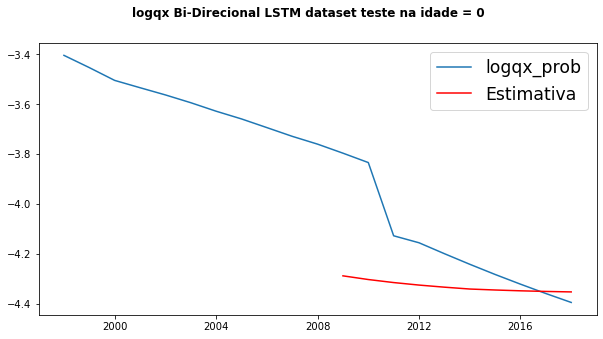

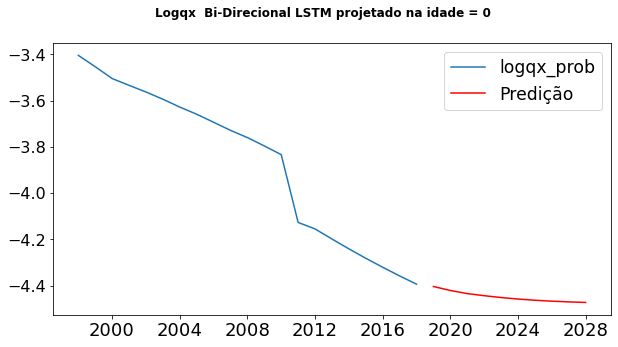

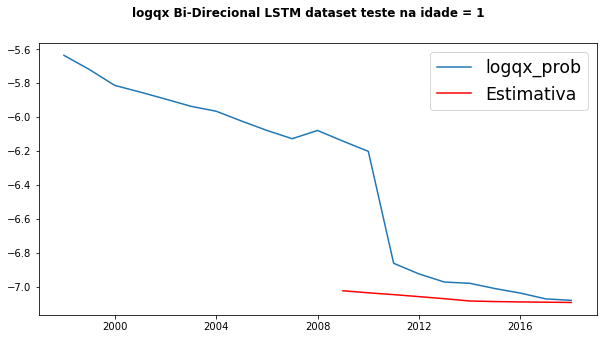

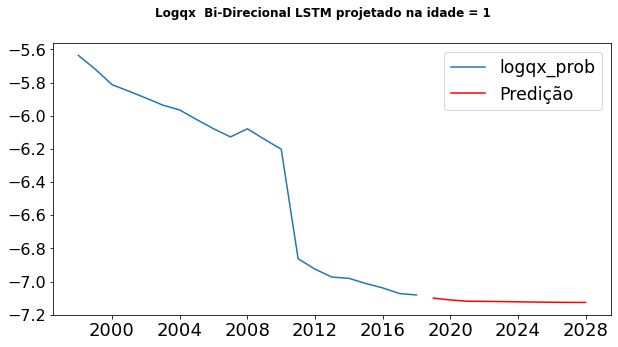

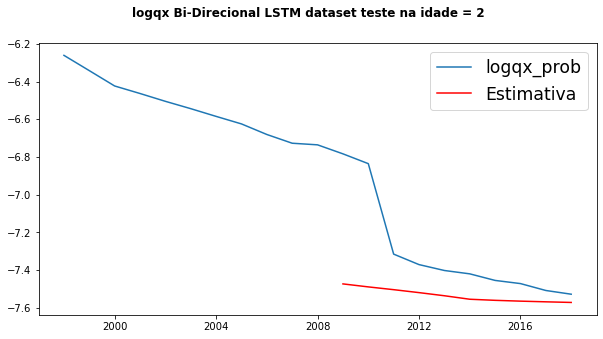

...

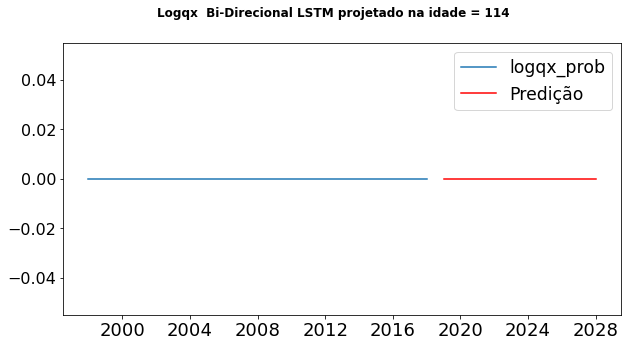

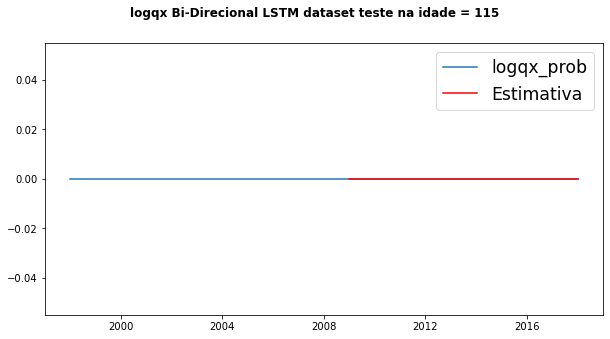

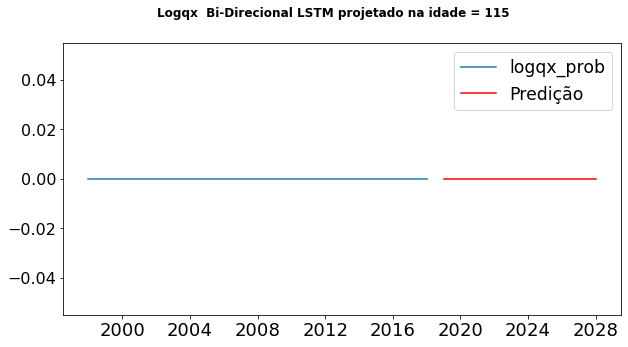

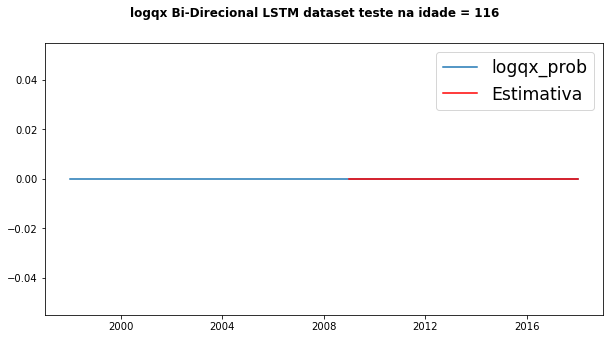

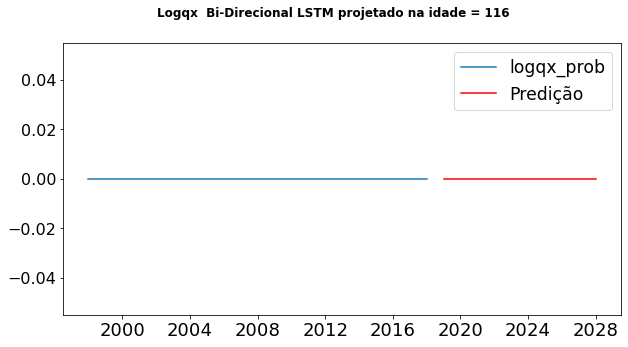

In [12]:
# proximos testes: n_epochs = 1000 e base teste de 3 anos. Sugestão. No programa em script. 
# Usar, também, o código para salvar o log do compilie
predict_res = []
pred_actual_rmse_res = []

w_max = max(df_dados['Age']) # definir maior idade nas tábuas. testes: 3

# inicio do cronometro do processamento
start = time.time()

n_input = 30 # 10 # Length of the output sequences (in number of timesteps). Corresponde ao número de dados 
# que usaremos para a rede. No caso, 10 anos na idade = 0, 10 anos na idade=1, etc.Vamos testar com 3 anos??
n_features = 1 # Número de features, variáveis. O modelo é univariavel (qx) para cada idade.
n_epochs = 500 # 1000 #500
n_batch = 2  # Number of timeseries samples in each batch (except maybe the last one).
n_neurons = 50
t_projecao = 30
# (#batch_size,#inputs,#features) 3D
for x in range(0, w_max+1):
    
    # Série para cada idade ao longo dos anos de 1998 a 2018
    #serie = df_lstm[df_lstm['idade']==x]['logqx_prob']
    serie = df_lstm[df_lstm['Age']==x]
    serie.drop(['Age', 'Year'], axis=1, inplace=True)

    # Separar base de treino e teste === preparar dados
    treino, teste = serie[:-30], serie[-30:]
    
    # Padronizar dados: Normalizar entre 0 e 1
    scaler = MinMaxScaler()
    scaler.fit(treino)
    treino = scaler.transform(treino)
    teste = scaler.transform(teste)
    
    #generator = TimeseriesGenerator(treino, treino, length=n_input, batch_size=n_batch)
    # length: The number of lag observations to use in the input portion of each sample (e.g. 3)
    # That is the desired number of lag observations to use as input = VAmos tentar 21: 2018-1998
    
    # batch_size: The number of samples to return on each iteration (e.g. 32)
    # The samples are not shuffled by default. This is useful for some recurrent neural networks
    # like LSTMs that maintain state across samples within a batch.
    # both the data and target for this generator is “treino”.
    
    generator = TimeseriesGenerator(treino, treino, length=n_input, batch_size=n_batch)
    
    # ============================ CAMADAS =========== CAMADAS =================================
    # A camada LSTM já possui, em sua construção, funções default de ativação:
    # activation="tanh",recurrent_activation="sigmoid",
    # três funções sigmoide e 1 tangente hiperbólica
    
    # Modelo bidirecional
    model = Sequential()
    model.add(Bidirectional(LSTM(n_neurons, return_sequences=True), input_shape=(n_input, n_features)))
    model.add(Bidirectional(LSTM(n_neurons)))
    model.add(Dropout(0.20))
    model.add(Dense(1))
    #model.add(Activation('softmax'))
    #model.compile(loss='categorical_crossentropy', optimizer='rmsprop')
    model.compile(optimizer='adam', loss='mse', metrics=["mae"])
    
    
    
    
    #model = Sequential()
    
    # #reshape the data into LSTM required (#batch,#timesteps,#features)
    #Adding the first LSTM layer and some Dropout regularisation
    
    #model.add(LSTM(n_neurons, activation='relu', input_shape=(n_input, n_features), return_sequences=True))
    #model.add(LSTM(n_neurons, activation='relu', input_shape=(n_input, n_features)))
    #model.add(Dropout(0.20))
    
    # Adding a second LSTM layer and some Dropout regularisation
    #model.add(LSTM(n_neurons))
    #model.add(Dropout(0.20))
    
    # Adding a third LSTM layer and some Dropout regularisation
    #model.add(LSTM(n_neurons, return_sequences=True))
    #model.add(Dropout(0.20))

    # Adding a fourth LSTM layer and some Dropout regularisation
    #model.add(LSTM(n_neurons))
    #model.add(Dropout(0.20))
    
    # Adding the output layer
    #model.add(Dense(1))
    
    # ============================ CAMADAS =========== CAMADAS =================================
    
    #model.add(Dense(y.shape[1], activation='sigmoid'))
    #model.compile(optimizer='adam', loss='mse', metrics=["mae"])
    
    
    # fit model
    #model.fit_generator(generator, epochs=n_epochs)
    
    # ADAPTADO PARA A ATUALIZAÇÃO DO KERAS (28/11/2020)
    csv_logger = CSVLogger('log_modelo_demography_bidirecional.csv', append=True, separator=';')
    model.fit(generator, epochs=n_epochs, callbacks=[csv_logger])
    # model.fit(X_train, Y_train, callbacks=[csv_logger])
    
    #Previsão
    pred_list = []
    batch = treino[-n_input:].reshape((1, n_input, n_features))

    for i in range(n_input):  # n_input
        pred_list.append(model.predict(batch)[0])
        batch = np.append(batch[:,1:,:], [[pred_list[i]]], axis=1)

    #inverse transform forecasts and test. Need to scale them back so we can compare the final results
    df_predict = pd.DataFrame(scaler.inverse_transform(pred_list), 
                            index=serie[-n_input:].index, columns=['Prediction'])
    
    df_teste = pd.concat([serie, df_predict], axis=1)

    # Gráfico da estimativa, com a base de teste
    #plt.figure(figsize=(10,5))
    fig = plt.figure(figsize=(10,5))
    ax = fig.add_subplot(111) # "111" means "1x1 grid, first subplot" 
    ax.plot(df_teste.index, df_teste['logqx'])
    ax.plot(df_teste.index, df_teste['Prediction'], color='r')
    #ax.legend(loc='best', fontsize='xx-large')
    ax.legend(loc='best', fontsize='xx-large', labels=['logqx', 'Estimativa'])
    fig.suptitle('logqx Bi-Direcional LSTM dataset teste na idade = %i' %x, fontweight="bold") # Título parametrizado com a idade
    plt.savefig(pasta_graficos + '/' + 'prev_Bi_Direcional_LSTM_test_idade'+str(x)+'.png')
    # plt.show()
    #plt.close(fig)
    
    
    pred_actual_rmse = rmse(df_teste.iloc[-n_input:, [0]], df_teste.iloc[-n_input:, [1]])
    print("idade:", x, "rmse: ", pred_actual_rmse)
    
    
    pred_actual_rmse_res.append(pred_actual_rmse)
    
    treino = serie
    
    scaler.fit(treino)
    treino = scaler.transform(treino)
    
    #generator = TimeseriesGenerator(treino, treino, length=n_input, batch_size=n_batch)
    #model.fit_generator(generator,epochs=n_epochs)
    # ADAPTADO PARA A ATUALIZAÇÃO DO KERAS (28/11/2020)
    # length: The number of lag observations to use in the input portion of each sample (e.g. 3)
    # batch_size: The number of samples to return on each iteration (e.g. 32)
    
    generator = TimeseriesGenerator(treino, treino, length=n_input, batch_size=n_batch)
    
    #model.fit(generator, epochs=n_epochs, batch_size=n_batch)
    model.fit(generator, epochs=n_epochs)
        
    pred_list = []

    batch = treino[-n_input:].reshape((1, n_input, n_features))

    for i in range(n_input):   
        pred_list.append(model.predict(batch)[0]) 
        batch = np.append(batch[:,1:,:],[[pred_list[i]]],axis=1)
          
    # prever para t_projecao anos
    add_dates = [serie.index[-1] + DateOffset(years=x) for x in range(0, t_projecao + 1)]
    #add_dates = [serie.index[-1] + pd.offsets.YearBegin(x) for x in range(0,6)]
    future_dates = pd.DataFrame(index=add_dates[1:],columns=serie.columns)
    
    
    #inverse transform forecasts and test. Need to scale them back so we can compare the final results
    df_predict = pd.DataFrame(scaler.inverse_transform(pred_list),
                          index=future_dates[-n_input:].index, columns=['Prediction'])

    
    predict_res.append(df_predict.values.tolist())
    
    df_proj = pd.concat([serie,df_predict], axis=1)
    
    
    # plt.figure(figsize=(10, 5))
    fig = plt.figure(figsize=(10,5))
    ax = fig.add_subplot(111)  # "111" means "1x1 grid, first subplot"
    ax.plot(df_proj.index, df_proj['logqx'])
    ax.plot(df_proj.index, df_proj['Prediction'], color='r')
    ax.legend(loc='best', fontsize='xx-large', labels=['logqx', 'Predição'])
    
    plt.xticks(fontsize=18)
    plt.yticks(fontsize=16)
    fig.suptitle('Logqx  Bi-Direcional LSTM projetado na idade = %i' %x, fontweight = "bold") # Título parametrizado com a idade
    # plt.title('Logqx projetado na idade = %i' %x) # Título parametrizado com a idade
    plt.savefig(pasta_graficos + '/' + 'proj_Bi_Direcional_LSTM_log_qx'+str(x)+'.png')
    # plt.show()


# fim do cronometro do processamento

end = time.time()
hours, rem = divmod(end-start, 3600)
minutes, seconds = divmod(rem, 60)
print()
print('Tempo de processamento:')
print('{:0>2}:{:0>2}:{:05.2f}'.format(int(hours), int(minutes), seconds))
print()



#### 5 - Valores de RMSE por idade

In [13]:
pd.DataFrame(pred_actual_rmse_res) # RMSE para cada idade

,0
0,0.236374
1,0.394586
2,0.319959
3,0.247065
4,0.209172
...,...
112,0.000000
113,0.000000
114,0.000000
115,0.000000


In [52]:
#### 5 - Base resultante dos anos de 2019 a 2028, por idade

In [14]:
df_lstm_res = pd.DataFrame(predict_res)

In [15]:
df_lstm_res.head()

,0,1,2,3,4,5,6,7,8,9
0,[-4.403406307283813],[-4.420667223070786],[-4.434184462046934],[-4.443174959747447],[-4.451123081757675],[-4.457658851053973],[-4.4628545999579305],[-4.466889080419605],[-4.469990199700954],[-4.472379908631417]
1,[-7.099551558189104],[-7.110622381119333],[-7.1183077233447225],[-7.119053870148585],[-7.120463995448462],[-7.121939062995842],[-7.123414604259882],[-7.124508975873627],[-7.125288476636833],[-7.125718783624262]
2,[-7.547929534327413],[-7.561142881019795],[-7.569592204720614],[-7.576304596628833],[-7.582364465461204],[-7.587572294825025],[-7.591798789180888],[-7.595132022141404],[-7.5976807349580096],[-7.599664696042439]
3,[-7.834499199267104],[-7.871331536680486],[-7.91087944848478],[-7.937693134871336],[-7.966129586593677],[-7.998318163990039],[-8.034477608573585],[-8.074204397355071],[-8.120397859332117],[-8.171561149025665]
4,[-8.069842381751565],[-8.117741800032464],[-8.17746880923445],[-8.224340161802303],[-8.278550739738753],[-8.347231567499914],[-8.431926445248829],[-8.53574595324722],[-8.67328801137279],[-8.842737272099853]


In [16]:
df_lstm_res[0][0][0]

-4.403406307283813

In [17]:
df_lstm_res.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117 entries, 0 to 116
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       117 non-null    object
 1   1       117 non-null    object
 2   2       117 non-null    object
 3   3       117 non-null    object
 4   4       117 non-null    object
 5   5       117 non-null    object
 6   6       117 non-null    object
 7   7       117 non-null    object
 8   8       117 non-null    object
 9   9       117 non-null    object
dtypes: object(10)
memory usage: 9.3+ KB


In [18]:
# Função para unir as listas em linha
def unirSeries(df, explode):
    idx = df.index.repeat(df[explode[0]].str.len())
    df1 = pd.concat([
        pd.DataFrame({x: np.concatenate(df[x].values)}) for x in explode], axis=1)
    df1.index = idx

    return df1.join(df.drop(explode, 1), how='left')

In [19]:
colunas = np.arange(2020, 2050)
df_temp = pd.DataFrame(predict_res, columns=colunas)
df_lstm_res = unirSeries(df_temp,colunas)
df_lstm_res = df_lstm_res.reset_index(drop=True)

In [20]:
df_lstm_res.head()

,2019,2020,2021,2022,2023,2024,2025,2026,2027,2028
0,-4.403406,-4.420667,-4.434184,-4.443175,-4.451123,-4.457659,-4.462855,-4.466889,-4.469990,-4.472380
1,-7.099552,-7.110622,-7.118308,-7.119054,-7.120464,-7.121939,-7.123415,-7.124509,-7.125288,-7.125719
2,-7.547930,-7.561143,-7.569592,-7.576305,-7.582364,-7.587572,-7.591799,-7.595132,-7.597681,-7.599665
3,-7.834499,-7.871332,-7.910879,-7.937693,-7.966130,-7.998318,-8.034478,-8.074204,-8.120398,-8.171561
4,-8.069842,-8.117742,-8.177469,-8.224340,-8.278551,-8.347232,-8.431926,-8.535746,-8.673288,-8.842737


In [21]:
df_forecast_res_exp = pd.DataFrame(np.exp(df_lstm_res))

In [22]:
df_forecast_res_exp.head()

,2019,2020,2021,2022,2023,2024,2025,2026,2027,2028
0,0.012236,0.012026,0.011865,0.011759,0.011665,0.011589,0.011529,0.011483,0.011447,0.011420
1,0.000825,0.000816,0.000810,0.000810,0.000808,0.000807,0.000806,0.000805,0.000805,0.000804
2,0.000527,0.000520,0.000516,0.000512,0.000509,0.000507,0.000505,0.000503,0.000502,0.000501
3,0.000396,0.000382,0.000367,0.000357,0.000347,0.000336,0.000324,0.000311,0.000297,0.000283
4,0.000313,0.000298,0.000281,0.000268,0.000254,0.000237,0.000218,0.000196,0.000171,0.000144


In [ ]:
# Gravar resultados

In [23]:
df_forecast_res_exp.to_csv(pasta_resultados + '/' + 'lstm_previsao_qx_500_Bi_Direcional_LSTM_demography.csv')

In [24]:
pd.DataFrame(pred_actual_rmse_res).to_csv(pasta_resultados + '/' + 'pred_actual_rmse_res_500_Bi_Direcional_LSTM_demography.csv', header=['RMSE'])